#### Imports and script-wide statements

In [123]:
import os
import h5py
import re
from scipy.io import loadmat
import numpy as np
from preproc import *
from sklearn.preprocessing import MinMaxScaler
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.decomposition import PCA
from dPCA import dPCA
from sklearn.manifold import Isomap
from sklearn.metrics import calinski_harabasz_score, davies_bouldin_score
from scipy.spatial.distance import directed_hausdorff
from itertools import combinations
from scipy.special import factorial
from scipy.stats import f_oneway
from statsmodels.stats.multicomp import pairwise_tukeyhsd
from scipy.stats import ttest_ind
from scipy.stats import ttest_1samp
from scipy.stats import mannwhitneyu
from statsmodels.multivariate.manova import MANOVA
import pandas as pd
import statsmodels.api as sm
from scipy.cluster.hierarchy import linkage, dendrogram, fcluster
from sklearn.cluster import KMeans
from scipy.signal import savgol_filter
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.animation import FuncAnimation
from matplotlib.gridspec import GridSpec
from matplotlib.ticker import StrMethodFormatter
from matplotlib.lines import Line2D
from matplotlib.patches import Rectangle
from matplotlib.colors import ListedColormap
from matplotlib.widgets import Slider
from IPython.display import HTML
import textwrap
import pickle

In [2]:
%matplotlib inline
plt.rcParams['font.size'] = 12

In [3]:
# Choose which days to include
# day_list = ['20181105', '20181102', '20181101']

# Or, read in list of days from txt file
day_list = list()
with open(f'data/combined/days.txt', 'r') as file:
    for line in file:
        day_list.append(line.strip())

In [4]:
# Directory to save figures
figsave_dir = 'figures'
to_save = True
save_name = 'Jul-Nov2018'

# Set name/annotation to use in plot titles
popl_name = '364 cells'

# Some common constants
num_sess = len(day_list)
num_goals = 6
tbin_size = 0.1

In [5]:
# Common functions
def group_by_trajectory(timeseries: np.array, trajectories: np.array) -> list:
    # num_goals = 6
    grouped = {(i+1, j+1): list() for j in range(num_goals) for i in range(num_goals) if i != j}
    for idx, traj in enumerate(trajectories):
        goal1, goal2 = int(traj[0]), int(traj[1])
        if goal1 == 0:
            continue
        grouped[(goal1, goal2)].append(timeseries[idx])
    return grouped

In [6]:
# Read in predefined list of cells
good_cell_labels = list()
# pattern = re.compile(r'/(\d{8})/session\d+/array0*\d+/channel0*(\d+)/cell0*(\d+)')
with open('data/cell_list_hm.txt', 'r') as file:
    for line in file:
        line = line.strip().split('/')
        good_cell_labels.append(f'{line[5]}ch{str(int(line[8][7:]))}c{str(int(line[9][4:]))}')
        # match = pattern.match(line.strip())
        # if match:
        #     date, channel, cell = match.groups()
        #     label = f'{date}ch{channel}c{cell}'
        #     good_cell_labels.append(f'{date}ch{channel}c{cell}')

In [7]:
# Import list of place + view cells
# Place cells
place_cell_labels = list()
with open('sigcells/place_cells.txt', 'r') as file:
    for line in file:
        line = line.strip().split('/')
        place_cell_labels.append(f'{line[5]}ch{str(int(line[8][7:]))}c{str(int(line[9][4:]))}')
# View cells
view_cell_labels = list()
with open('sigcells/view_cells.txt', 'r') as file:
    for line in file:
        line = line.strip().split('/')
        view_cell_labels.append(f'{line[5]}ch{str(int(line[8][7:]))}c{str(int(line[9][4:]))}')
# Merge and remove duplicates from both lists
pv_cell_labels = list(set(place_cell_labels).union(set(view_cell_labels)))

#### Information Gain

In [ ]:
all_cell_labels = list()
all_net_information_gain = list()
all_net_information_gain_scaled= list()

for day in day_list:
    with open(f'data/infogain/{day}_data.pkl', 'rb') as file:
        data = pickle.load(file)
        all_cell_labels.extend(data['cell_labels'])
        all_net_information_gain.append(data['net_information_gain'])
        all_net_information_gain_scaled.append(data['net_information_gain_scaled'])

all_net_information_gain = np.vstack(all_net_information_gain)
all_net_information_gain_scaled = np.vstack(all_net_information_gain_scaled)
num_all_cells = len(all_cell_labels)
for i, label in enumerate(all_cell_labels):
    all_cell_labels[i] = all_cell_labels[i][4:]

In [ ]:
plt.figure(figsize=(20, 5))
plt.rcParams['font.size'] = 12
plt.pcolormesh(all_net_information_gain.T, cmap='coolwarm')
cbar = plt.colorbar(pad=0.02)
cbar.set_label('Information gain', size=16)
plt.title(f'Goal information across cue phase - Nov', fontsize=18)
plt.xlabel('Cells', fontsize=16)
plt.ylabel('Time (s)', fontsize=16)
plt.xticks(np.arange(0.5, num_all_cells+0.5), all_cell_labels, rotation=60, ha='right', va='top')
plt.yticks(np.arange(int(1/tbin_size)+1), [f'{tbin_size * i:.1f}' for i in range(0, int(1/tbin_size)+1)], ha='right')
plt.show()

In [ ]:
plt.figure(figsize=(20, 5))
plt.rcParams['font.size'] = 12
plt.pcolormesh(all_net_information_gain_scaled.T, cmap='coolwarm')
cbar = plt.colorbar(pad=0.02)
cbar.set_label('Information gain (scaled per cell)', size=16)
plt.title(f'Goal information across cue phase - Nov', fontsize=18)
plt.xlabel('Cells', fontsize=16)
plt.ylabel('Time (s)', fontsize=16)
plt.xticks(np.arange(0.5, num_all_cells+0.5), all_cell_labels, rotation=60, ha='right', va='top')
plt.yticks(np.arange(int(1/tbin_size)+1), [f'{tbin_size * i:.1f}' for i in range(0, int(1/tbin_size)+1)], ha='right')
plt.show()

In [ ]:
# Plot distribution of information gain across the cue phase, collapsed across all cells
all_net_information_gain_scaled_mean = np.mean(all_net_information_gain_scaled, axis=0)
plt.figure(figsize=(5, 2))
colormap = plt.cm.coolwarm(all_net_information_gain_scaled_mean)
plt.bar(np.arange(0, 1, 0.1), all_net_information_gain_scaled_mean, width=0.095, align='edge', color=colormap)
plt.xlabel('Time (s)')
plt.ylabel('Information gain')
plt.xticks(np.arange(0, 1.1, 0.1))
plt.show()

/var/folders/x9/1nq85w8s11l0sv1yqg3364200000h2/T/ipykernel_26761/3189793482.py:6: MatplotlibDeprecationWarning: Starting from Matplotlib 3.6, colorbar() will steal space from the mappable's axes, rather than from the current axes, to place the colorbar.  To silence this warning, explicitly pass the 'ax' argument to colorbar().
  cbar = plt.colorbar(pcm, pad=0.08)


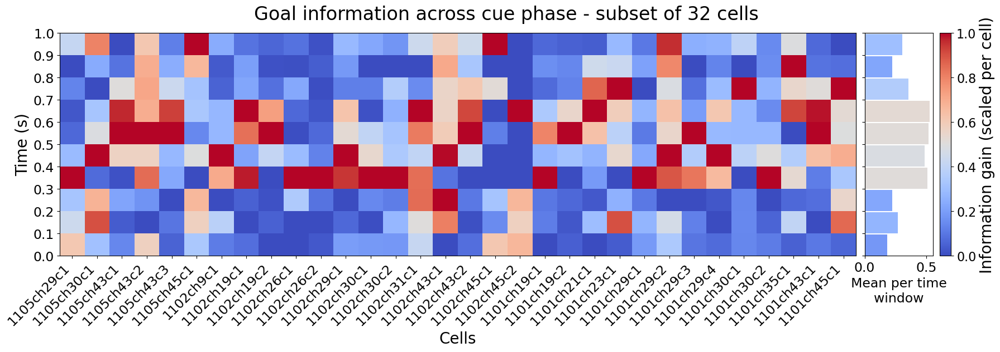

In [111]:
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(20, 5), sharey=True, gridspec_kw={'width_ratios': [9, 1]})
plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1, wspace=0.02, hspace=0)
plt.rcParams['font.size'] = 16

pcm = ax1.pcolormesh(all_net_information_gain_scaled.T, cmap='coolwarm')
cbar = plt.colorbar(pcm, pad=0.08)
cbar.set_label('Information gain (scaled per cell)', size=20)
plt.suptitle(f'Goal information across cue phase - {popl_name}', fontsize=24, y=1)
ax1.set_xlabel('Cells', fontsize=20)
ax1.set_ylabel('Time (s)', fontsize=20)
ax1.set_xticks(np.arange(0.5, num_all_cells+0.5), all_cell_labels, rotation=45, ha='right', va='top')
ax1.set_yticks(np.arange(int(1/tbin_size)+1), [f'{tbin_size * i:.1f}' for i in range(0, int(1/tbin_size)+1)], ha='right')

cm = plt.cm.coolwarm(all_net_information_gain_scaled_mean)
ax2.barh(np.arange(int(1/tbin_size)), all_net_information_gain_scaled_mean, height=0.95, align='edge', color=cm)
ax2.set_xlabel(textwrap.fill('Mean per time window', 15))

if to_save:
    if not os.path.exists(figsave_dir):
        os.makedirs(figsave_dir)
    plt.savefig(f'{figsave_dir}/infogain_{save_name}.eps', bbox_inches='tight')
plt.show()

#### Cue/Hint/Navend Cross-Temporal Decoding

In [19]:
class ResponseClassifier():
    def __init__(self, model):
        self.model = model

    def fit(self, X, y, thresh):
        self.model.fit(X, y)
        self.thresh = thresh

    def set_thresh(self, thresh):
        self.thresh = thresh

    def predict(self, X):
        classes = self.model.predict(X)
        probs = self.model.predict_proba(X)
        filt = np.where(np.max(probs, axis=1) < self.thresh)
        classes[filt] = 0
        return classes


def train_test_split(X: np.array, y: np.array, split: tuple) -> tuple:
    # itr: current iteration of k-fold validation
    # way: value of k in k-fold validation
    itr, way = split
    X_train, X_test = list(), list()
    y_train, y_test = list(), list()
    for num, obs in enumerate(X):
        if num % way == itr:
            X_test.append(obs)
            y_test.append(y[num])
        else:
            X_train.append(obs)
            y_train.append(y[num])
    # Return format: X_train, X_test, y_train, y_test   
    return np.array(X_train), np.array(X_test), np.array(y_train), np.array(y_test)

def confusion_matrix(y_pred: np.array, y_actl: np.array, num_classes: int) -> np.array:
    res = np.zeros((num_classes, num_classes), dtype=int)
    for pred, actl in zip(y_pred, y_actl):
        pred, actl = int(pred - 1), int(actl - 1)
        res[pred, actl] += 1
    return res

def prediction_accuracy(y_pred: np.array, y_actl: np.array) -> float:
    count, total = 0, y_actl.shape[0]
    for num, obs in enumerate(y_pred):
        if obs == y_actl[num]:
            count += 1
    return count / total

In [343]:
all_spikerates_cue, all_spikerates_hints, all_spikerates_navend = list(), list(), list()
all_goals_cue, all_goals_hints, all_goals_navend = list(), list(), list()
all_trajectories_cue, all_trajectories_hints, all_trajectories_navend = list(), list(), list()

'''
for day in day_list:
    with open(f'data/{day}_data.pkl', 'rb') as file:
        data = pickle.load(file)
        # Drop the first trial from each day's dataset
        all_spikerates_cue.append(data['raw_data']['spikerates_cue'][1:])
        all_spikerates_hints.append(data['raw_data']['spikerates_hints'][1:])
        all_spikerates_navend.append(data['raw_data']['spikerates_navend'][1:])

        all_goals_cue.append(data['raw_data']['goals_cue'][1:])
        all_goals_hints.append(data['raw_data']['goals_hints'][1:])
        all_goals_navend.append(data['raw_data']['goals_navend'][1:])

        all_trajectories_cue.append(data['raw_data']['trajectories_cue'][1:])
        all_trajectories_hints.append(data['raw_data']['trajectories_hints'][1:])
        all_trajectories_navend.append(data['raw_data']['trajectories_navend'][1:])
'''
        
for day in day_list:
    with open(f'data/combined/{day}_data.pkl', 'rb') as file:
        data = pickle.load(file)
        # Drop the first trial from each day's dataset
        all_spikerates_cue.append(data['cue_mean']['spikerates_cue'][1:])
        all_spikerates_hints.append(data['hint_mean']['spikerates_hints'][1:])
        all_spikerates_navend.append(data['navend_mean']['spikerates_navend'][1:])

        all_goals_cue.append(data['cue_mean']['goals_cue'][1:])
        all_goals_hints.append(data['hint_mean']['goals_hints'][1:])
        all_goals_navend.append(data['navend_mean']['goals_navend'][1:])

        all_trajectories_cue.append(data['cue_mean']['trajectories_cue'][1:])
        all_trajectories_hints.append(data['hint_mean']['trajectories_hints'][1:])
        all_trajectories_navend.append(data['navend_mean']['trajectories_navend'][1:])

In [344]:
# Append cells from each session to form a pseudopopulation, append in chronological order on responses grouped by (start, end) goals
# Cue phase spike rates
all_spikerates_cue_per_traj = list()
for i in range(num_sess):
    all_spikerates_cue_per_traj.append(group_by_trajectory(all_spikerates_cue[i], all_trajectories_cue[i]))
trajectories = list(all_spikerates_cue_per_traj[0].keys())
combined_spikerates_cue_per_traj = {key: list() for key in trajectories}
for traj in trajectories:
    trials_data = [sess[traj] for sess in all_spikerates_cue_per_traj]
    num_trials = min(map(len, trials_data))
    for trial in range(num_trials):
        combined_spikerates_cue_per_traj[traj].append(np.hstack([sess[trial] for sess in trials_data]))
    combined_spikerates_cue_per_traj[traj] = np.vstack(combined_spikerates_cue_per_traj[traj])

# Hint view spike rates
all_spikerates_hints_per_traj = list()
for i in range(num_sess):
    all_spikerates_hints_per_traj.append(group_by_trajectory(all_spikerates_hints[i], all_trajectories_hints[i]))
combined_spikerates_hints_per_traj = {key: list() for key in trajectories}
for traj in trajectories:
    trials_data = [sess[traj] for sess in all_spikerates_hints_per_traj]
    num_trials = min(map(len, trials_data))
    for trial in range(num_trials):
        combined_spikerates_hints_per_traj[traj].append(np.hstack([sess[trial] for sess in trials_data]))
    combined_spikerates_hints_per_traj[traj] = np.vstack(combined_spikerates_hints_per_traj[traj])

# Nav end phase spike rates
all_spikerates_navend_per_traj = list()
for i in range(num_sess):
    all_spikerates_navend_per_traj.append(group_by_trajectory(all_spikerates_navend[i], all_trajectories_navend[i]))
combined_spikerates_navend_per_traj = {key: list() for key in trajectories}
for traj in trajectories:
    trials_data = [sess[traj] for sess in all_spikerates_navend_per_traj]
    num_trials = min(map(len, trials_data))
    for trial in range(num_trials):
        combined_spikerates_navend_per_traj[traj].append(np.hstack([sess[trial] for sess in trials_data]))
    combined_spikerates_navend_per_traj[traj] = np.vstack(combined_spikerates_navend_per_traj[traj])

# Filter out cells not in good_cell_labels
cell_filter = np.array([idx for idx, cell in enumerate(all_cell_labels) if cell in set(good_cell_labels)])

for traj, data in combined_spikerates_cue_per_traj.items():
    for n, trial in enumerate(data):
        data[n] = trial[:,cell_filter]

for traj, data in combined_spikerates_hints_per_traj.items():
    for n, trial in enumerate(data):
        data[n] = trial[:,cell_filter]

for traj, data in combined_spikerates_navend_per_traj.items():
    for n, trial in enumerate(data):
        data[n] = trial[:,cell_filter]

# Collect spike rate data into single arrays for each phase
combined_spikerates_cue, combined_goals_cue = list(), list()
for traj, obs in combined_spikerates_cue_per_traj.items():
    combined_spikerates_cue.append(obs)
    combined_goals_cue.extend(obs.shape[0]*[traj[1]])
combined_spikerates_cue = np.vstack(combined_spikerates_cue)
combined_goals_cue = np.array(combined_goals_cue)

combined_spikerates_hints, combined_goals_hints = list(), list()
for traj, obs in combined_spikerates_hints_per_traj.items():
    combined_spikerates_hints.append(obs)
    combined_goals_hints.extend(obs.shape[0]*[traj[1]])
combined_spikerates_hints = np.vstack(combined_spikerates_hints)
combined_goals_hints = np.array(combined_goals_hints)

combined_spikerates_navend, combined_goals_navend = list(), list()
for traj, obs in combined_spikerates_navend_per_traj.items():
    combined_spikerates_navend.append(obs)
    combined_goals_navend.extend(obs.shape[0]*[traj[1]])
combined_spikerates_navend = np.vstack(combined_spikerates_navend)
combined_goals_navend = np.array(combined_goals_navend)

'''
# Shuffle the order of the observations
np.random.seed(0)
shuffle_order = np.random.permutation(combined_goals_cue.shape[0])
combined_spikerates_cue = combined_spikerates_cue[shuffle_order]
combined_goals_cue = combined_goals_cue[shuffle_order]

np.random.seed(0)
shuffle_order = np.random.permutation(combined_goals_hints.shape[0])
combined_spikerates_hints = combined_spikerates_hints[shuffle_order]
combined_goals_hints = combined_goals_hints[shuffle_order]

np.random.seed(0)
shuffle_order = np.random.permutation(combined_goals_navend.shape[0])
combined_spikerates_navend = combined_spikerates_navend[shuffle_order]
combined_goals_navend = combined_goals_navend[shuffle_order]
'''

'\n# Shuffle the order of the observations\nshuffle_order = np.random.permutation(combined_goals_cue.shape[0])\ncombined_spikerates_cue = combined_spikerates_cue[shuffle_order]\ncombined_goals_cue = combined_goals_cue[shuffle_order]\n\nshuffle_order = np.random.permutation(combined_goals_hints.shape[0])\ncombined_spikerates_hints = combined_spikerates_hints[shuffle_order]\ncombined_goals_hints = combined_goals_hints[shuffle_order]\n\nshuffle_order = np.random.permutation(combined_goals_navend.shape[0])\ncombined_spikerates_navend = combined_spikerates_navend[shuffle_order]\ncombined_goals_navend = combined_goals_navend[shuffle_order]\n'

In [345]:
# Clean up large memory variables
del all_spikerates_cue
del all_spikerates_hints
del all_spikerates_navend
del all_goals_cue
del all_goals_hints
del all_goals_navend
del all_trajectories_cue
del all_trajectories_hints
del all_trajectories_navend

In [ ]:
# Filter out place/view selective cells from pseudopopulation (optional)


Cue phase model

In [346]:
# Build decoder for 6+1 classes
k_fold = 10
ppop_probmins_goal = np.zeros(k_fold)
ppop_accuracy_goal_cue = np.zeros(k_fold)
ppop_confusion_goal_cue = np.zeros((num_goals, num_goals))
ppop_models_goal = list()
for i in range(k_fold):
    X_train, X_test, y_train, y_test = train_test_split(combined_spikerates_cue, combined_goals_cue, (i, k_fold))
    lda = LinearDiscriminantAnalysis()
    lda.fit(X_train, y_train)
    y_pred = lda.predict(X_test)
    y_pred_proba = lda.predict_proba(X_train)
    y_pred_proba = np.max(y_pred_proba, axis=1)
    ppop_probmins_goal[i] = np.min(y_pred_proba)
    ppop_accuracy_goal_cue[i] = prediction_accuracy(y_pred, y_test)
    ppop_confusion_goal_cue += confusion_matrix(y_pred, y_test, num_goals)
    ppop_models_goal.append(lda)

# Fit models using each fold of data
ppop_confusion_goal_hints, ppop_confusion_goal_navend = np.zeros((num_goals+1, num_goals+1)), np.zeros((num_goals+1, num_goals+1))
ppop_accuracy_goal_hints, ppop_accuracy_goal_navend = np.zeros(k_fold), np.zeros(k_fold)

for i, model in enumerate(ppop_models_goal):
    ppop_models_goal[i] = ResponseClassifier(model)
    ppop_models_goal[i].set_thresh(ppop_probmins_goal[i])

    # Prediction on hint views
    hints_preds = model.predict(combined_spikerates_hints)
    ppop_confusion_goal_hints += confusion_matrix(hints_preds, combined_goals_hints, num_goals+1)
    ppop_accuracy_goal_hints[i] = prediction_accuracy(hints_preds, combined_goals_hints)

    # Prediction on navend phases
    navend_preds = model.predict(combined_spikerates_navend)
    ppop_confusion_goal_navend += confusion_matrix(navend_preds, combined_goals_navend, num_goals+1)
    ppop_accuracy_goal_navend[i] = prediction_accuracy(navend_preds, combined_goals_navend)

Hint view model

In [347]:
# Build decoder for 6+1 classes
k_fold = 10
ppop_probmins_hint = np.zeros(k_fold)
ppop_accuracy_hint_hints = np.zeros(k_fold)
ppop_confusion_hint_hints = np.zeros((num_goals, num_goals))
ppop_models_hint = list()
for i in range(k_fold):
    X_train, X_test, y_train, y_test = train_test_split(combined_spikerates_hints, combined_goals_hints, (i, k_fold))
    lda = LinearDiscriminantAnalysis()
    lda.fit(X_train, y_train)
    y_pred = lda.predict(X_test)
    y_pred_proba = lda.predict_proba(X_train)
    y_pred_proba = np.max(y_pred_proba, axis=1)
    ppop_probmins_hint[i] = np.min(y_pred_proba)
    ppop_accuracy_hint_hints[i] = prediction_accuracy(y_pred, y_test)
    ppop_confusion_hint_hints += confusion_matrix(y_pred, y_test, num_goals)
    ppop_models_hint.append(lda)

# Fit models using each fold of data
ppop_confusion_hint_cue, ppop_confusion_hint_navend = np.zeros((num_goals+1, num_goals+1)), np.zeros((num_goals+1, num_goals+1))
ppop_accuracy_hint_cue, ppop_accuracy_hint_navend = np.zeros(k_fold), np.zeros(k_fold)

for i, model in enumerate(ppop_models_hint):
    ppop_models_hint[i] = ResponseClassifier(model)
    ppop_models_hint[i].set_thresh(ppop_probmins_hint[i])

    # Prediction on cue phases
    cue_preds = model.predict(combined_spikerates_cue)
    ppop_confusion_hint_cue += confusion_matrix(cue_preds, combined_goals_cue, num_goals+1)
    ppop_accuracy_hint_cue[i] = prediction_accuracy(cue_preds, combined_goals_cue)

    # Prediction on navend phases
    navend_preds = model.predict(combined_spikerates_navend)
    ppop_confusion_hint_navend += confusion_matrix(navend_preds, combined_goals_navend, num_goals+1)
    ppop_accuracy_hint_navend[i] = prediction_accuracy(navend_preds, combined_goals_navend)

Nav end model

In [348]:
# Build decoder for 6+1 classes
k_fold = 10
ppop_probmins_poster = np.zeros(k_fold)
ppop_accuracy_poster_navend = np.zeros(k_fold)
ppop_confusion_poster_navend = np.zeros((num_goals, num_goals))
ppop_models_poster = list()
for i in range(k_fold):
    X_train, X_test, y_train, y_test = train_test_split(combined_spikerates_navend, combined_goals_navend, (i, k_fold))
    lda = LinearDiscriminantAnalysis()
    lda.fit(X_train, y_train)
    y_pred = lda.predict(X_test)
    y_pred_proba = lda.predict_proba(X_train)
    y_pred_proba = np.max(y_pred_proba, axis=1)
    ppop_probmins_poster[i] = np.min(y_pred_proba)
    ppop_accuracy_poster_navend[i] = prediction_accuracy(y_pred, y_test)
    ppop_confusion_poster_navend += confusion_matrix(y_pred, y_test, num_goals)
    ppop_models_poster.append(lda)

# Fit models using each fold of data
ppop_confusion_poster_cue, ppop_confusion_poster_hints = np.zeros((num_goals+1, num_goals+1)), np.zeros((num_goals+1, num_goals+1))
ppop_accuracy_poster_cue, ppop_accuracy_poster_hints = np.zeros(k_fold), np.zeros(k_fold)

for i, model in enumerate(ppop_models_poster):
    ppop_models_poster[i] = ResponseClassifier(model)
    ppop_models_poster[i].set_thresh(ppop_probmins_poster[i])

    # Prediction on cue phases
    cue_preds = model.predict(combined_spikerates_cue)
    ppop_confusion_poster_cue += confusion_matrix(cue_preds, combined_goals_cue, num_goals+1)
    ppop_accuracy_poster_cue[i] = prediction_accuracy(cue_preds, combined_goals_cue)

    # Prediction on hitn views
    hints_preds = model.predict(combined_spikerates_hints)
    ppop_confusion_poster_hints += confusion_matrix(hints_preds, combined_goals_hints, num_goals+1)
    ppop_accuracy_poster_hints[i] = prediction_accuracy(hints_preds, combined_goals_hints)

Statistical tests between decoding performances

In [349]:
fstat_ppop_goal, pval_ppop_goal = f_oneway(ppop_accuracy_goal_cue, ppop_accuracy_goal_hints, ppop_accuracy_goal_navend)
tukey_ppop_goal = pairwise_tukeyhsd(np.concatenate([ppop_accuracy_goal_cue, ppop_accuracy_goal_hints, ppop_accuracy_goal_navend]), k_fold*['Cue'] + k_fold*['Hint'] + k_fold*['Nav_end'])

fstat_ppop_hint, pval_ppop_hint = f_oneway(ppop_accuracy_hint_cue, ppop_accuracy_hint_hints, ppop_accuracy_hint_navend)
tukey_ppop_hint = pairwise_tukeyhsd(np.concatenate([ppop_accuracy_hint_cue, ppop_accuracy_hint_hints, ppop_accuracy_hint_navend]), k_fold*['Cue'] + k_fold*['Hint'] + k_fold*['Nav_end'])

fstat_ppop_poster, pval_ppop_poster = f_oneway(ppop_accuracy_poster_cue, ppop_accuracy_poster_hints, ppop_accuracy_poster_navend)
tukey_ppop_poster = pairwise_tukeyhsd(np.concatenate([ppop_accuracy_poster_cue, ppop_accuracy_poster_hints, ppop_accuracy_poster_navend]), k_fold*['Cue'] + k_fold*['Hint'] + k_fold*['Nav_end'])

In [350]:
ppop_goal_stats = '\n'.join(['--- ANOVA results for Cue model ---', f'f-statistic: {fstat_ppop_goal}', f'p-value: {pval_ppop_goal}\n', str(tukey_ppop_goal)])
print(ppop_goal_stats)

--- ANOVA results for Cue model ---
f-statistic: 123.81970076741781
p-value: 2.5125367426012787e-14

 Multiple Comparison of Means - Tukey HSD, FWER=0.05 
group1  group2 meandiff p-adj   lower   upper  reject
-----------------------------------------------------
   Cue    Hint  -0.3444    0.0 -0.4142 -0.2747   True
   Cue Nav_end   -0.413    0.0 -0.4827 -0.3433   True
  Hint Nav_end  -0.0686 0.0547 -0.1383  0.0012  False
-----------------------------------------------------


In [351]:
ppop_hint_stats = '\n'.join(['--- ANOVA results for Hint model ---', f'f-statistic: {fstat_ppop_hint}', f'p-value: {pval_ppop_hint}\n', str(tukey_ppop_hint)])
print(ppop_hint_stats)

--- ANOVA results for Hint model ---
f-statistic: 9.996392190788828
p-value: 0.0005636245601221044

 Multiple Comparison of Means - Tukey HSD, FWER=0.05 
group1  group2 meandiff p-adj   lower   upper  reject
-----------------------------------------------------
   Cue    Hint   0.0337 0.7513 -0.0816   0.149  False
   Cue Nav_end  -0.1609  0.005 -0.2762 -0.0456   True
  Hint Nav_end  -0.1946 0.0008 -0.3099 -0.0792   True
-----------------------------------------------------


In [352]:
ppop_poster_stats = '\n'.join(['--- ANOVA results for Nav_end model ---', f'f-statistic: {fstat_ppop_poster}', f'p-value: {pval_ppop_poster}\n', str(tukey_ppop_poster)])
print(ppop_poster_stats)

--- ANOVA results for Nav_end model ---
f-statistic: 55.73171113730881
p-value: 2.6024805132281183e-10

Multiple Comparison of Means - Tukey HSD, FWER=0.05
group1  group2 meandiff p-adj  lower  upper  reject
---------------------------------------------------
   Cue    Hint  -0.0416 0.502 -0.1326 0.0494  False
   Cue Nav_end   0.3128   0.0  0.2218 0.4038   True
  Hint Nav_end   0.3544   0.0  0.2634 0.4454   True
---------------------------------------------------


Decoding plots

In [353]:
# Package variables
ppop_accuracies_goal = {'Cue': ppop_accuracy_goal_cue, 'Hint': ppop_accuracy_goal_hints, 'Nav end': ppop_accuracy_goal_navend}
ppop_accuracies_hint = {'Cue': ppop_accuracy_hint_cue, 'Hint': ppop_accuracy_hint_hints, 'Nav end': ppop_accuracy_hint_navend}
ppop_accuracies_poster = {'Cue': ppop_accuracy_poster_cue, 'Hint': ppop_accuracy_poster_hints, 'Nav end': ppop_accuracy_poster_navend}

ppop_confusion_matrices_goal = {'Cue': ppop_confusion_goal_cue, 'Hint': ppop_confusion_goal_hints, 'Nav end': ppop_confusion_goal_navend}
ppop_confusion_matrices_hint = {'Cue': ppop_confusion_hint_cue, 'Hint': ppop_confusion_hint_hints, 'Nav end': ppop_confusion_hint_navend}
ppop_confusion_matrices_poster = {'Cue': ppop_confusion_poster_cue, 'Hint': ppop_confusion_poster_hints, 'Nav end': ppop_confusion_poster_navend}

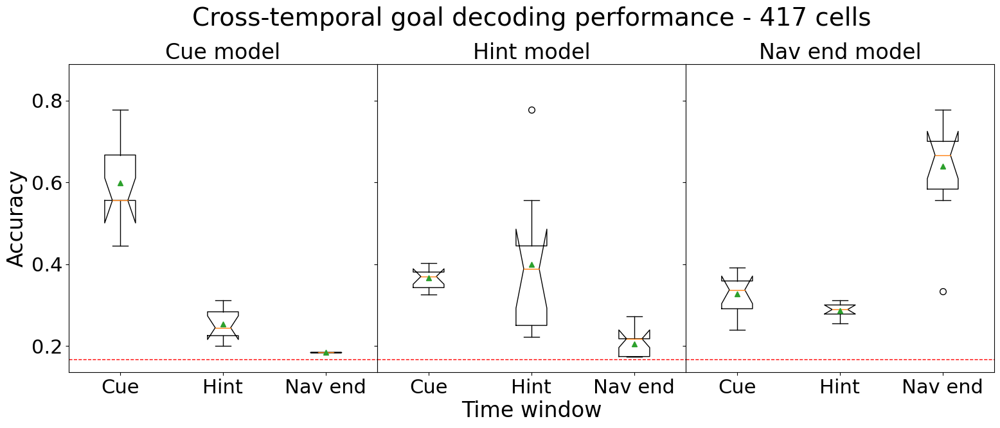

In [354]:
# Plot cross-temporal decoding accuracies for cue, hint and nav end models in a single plot
fig, axes = plt.subplots(1, 3, figsize=(18, 6), sharey=True)
plt.rcParams['font.size'] = 22
plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1, wspace=0, hspace=0.1)
plt.suptitle(f'Cross-temporal goal decoding performance - {popl_name}', fontsize=28, y=1.05)
model_names = ['Cue', 'Hint', 'Nav end']

for k, accuracies in enumerate([ppop_accuracies_goal, ppop_accuracies_hint, ppop_accuracies_poster]):
    axes[k].set_title(f'{model_names[k]} model', fontsize=24)
    axes[k].boxplot(accuracies.values(), showmeans=True, notch=True, flierprops={'marker': 'o', 'markersize': 7})
    # axes[k].violinplot(accuracies.values(), showextrema=False)
    axes[k].axhline(y=1/6, color='r', linewidth=1, linestyle='--')
    axes[k].set_xticks(np.arange(1, 4), labels=accuracies.keys())
axes[0].set_ylabel('Accuracy', fontsize=24)
axes[1].set_xlabel('Time window', fontsize=24)
axes[0].set_ylim([axes[0].get_ylim()[0], 1.1*axes[0].get_ylim()[1]])

# Manually add annotations for significant differences between groups
anno_colour = '#00008b'
arrowprops = {'arrowstyle': '-', 'lw': 1, 'color': anno_colour}

'''
axes[0].annotate('***', xy=(1, 0.59), xytext=(2, 0.59), arrowprops=arrowprops, ha='center', va='center', color=anno_colour)
axes[0].annotate('', xy=(3, 0.59), xytext=(2.12, 0.59), arrowprops=arrowprops)
axes[0].annotate('***', xy=(1, 0.57), xytext=(1.5, 0.57), arrowprops=arrowprops, ha='center', va='center', color=anno_colour)
axes[0].annotate('', xy=(2, 0.57), xytext=(1.62, 0.57), arrowprops=arrowprops)
axes[0].annotate('*', xy=(2, 0.34), xytext=(2.5, 0.34), arrowprops=arrowprops, ha='center', va='center', color=anno_colour)
axes[0].annotate('', xy=(3, 0.34), xytext=(2.56, 0.34), arrowprops=arrowprops)

axes[1].annotate('**', xy=(1, 0.485), xytext=(2, 0.485), arrowprops=arrowprops, ha='center', va='center', color=anno_colour)
axes[1].annotate('', xy=(3, 0.485), xytext=(2.09, 0.485), arrowprops=arrowprops)
axes[1].annotate('**', xy=(2, 0.465), xytext=(2.5, 0.465), arrowprops=arrowprops, ha='center', va='center', color=anno_colour)
axes[1].annotate('', xy=(3, 0.465), xytext=(2.59, 0.465), arrowprops=arrowprops)

axes[2].annotate('***', xy=(1, 0.65), xytext=(2, 0.65), arrowprops=arrowprops, ha='center', va='center', color=anno_colour)
axes[2].annotate('', xy=(3, 0.65), xytext=(2.12, 0.65), arrowprops=arrowprops)
axes[2].annotate('***', xy=(2, 0.63), xytext=(2.5, 0.63), arrowprops=arrowprops, ha='center', va='center', color=anno_colour)
axes[2].annotate('', xy=(3, 0.63), xytext=(2.62, 0.63), arrowprops=arrowprops)
axes[2].annotate('***', xy=(1, 0.33), xytext=(1.5, 0.33), arrowprops=arrowprops, ha='center', va='center', color=anno_colour)
axes[2].annotate('', xy=(2, 0.33), xytext=(1.62, 0.33), arrowprops=arrowprops)
'''

if to_save:
    if not os.path.exists(figsave_dir):
        os.makedirs(figsave_dir)
    plt.savefig(f'{figsave_dir}/decodeacc_{save_name}.eps', bbox_inches='tight')

/var/folders/x9/1nq85w8s11l0sv1yqg3364200000h2/T/ipykernel_26761/2669607798.py:15: RuntimeWarning: invalid value encountered in true_divide
  conf_mat_prop[:,col] = conf_mat[:,col] / val


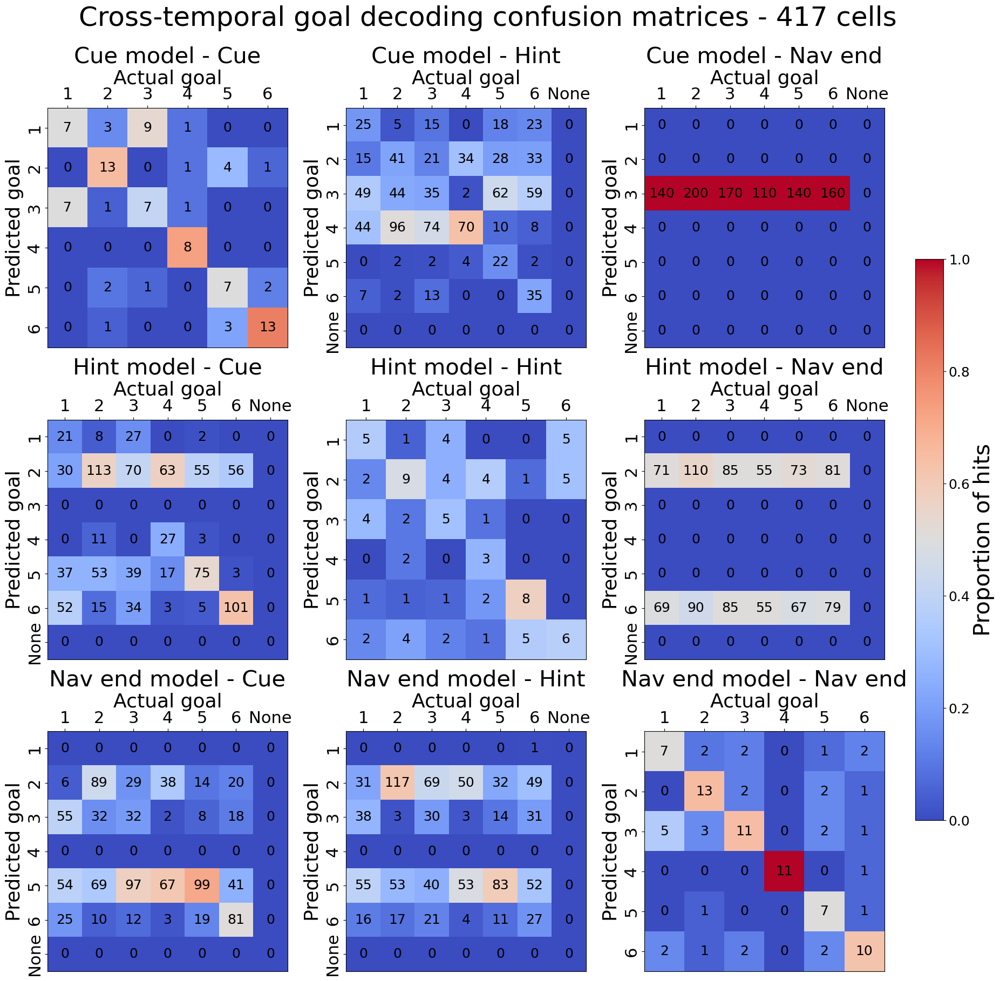

In [355]:
# Plot confusion matrices for all cross-temporal decoders in a single plot
fig, axes = plt.subplots(3, 3, figsize=(24, 20))
plt.rcParams['font.size'] = 18
plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1, wspace=0.18, hspace=0.3)
plt.suptitle(f'Cross-temporal goal decoding confusion matrices - {popl_name}', fontsize=36, y=0.995, x=0.45)
model_names = ['Cue', 'Hint', 'Nav end']

for k, confusion_matrices in enumerate([ppop_confusion_matrices_goal, ppop_confusion_matrices_hint, ppop_confusion_matrices_poster]):
    for i, entry in enumerate(confusion_matrices.items()):
        label, conf_mat = entry
        num_cats = conf_mat.shape[0]
        col_sums = np.sum(conf_mat, axis=0)
        conf_mat_prop = np.empty_like(conf_mat)
        for col, val in enumerate(col_sums):
            conf_mat_prop[:,col] = conf_mat[:,col] / val
        conf_mat_prop = np.nan_to_num(conf_mat_prop)

        ax = axes[k,i]
        ax.set_title(f'{model_names[k]} model - {label}', fontsize=30, y=1.17)
        im = ax.imshow(conf_mat_prop, cmap='coolwarm', vmin=0, vmax=1)

        class_labels = list(range(1, num_cats+1))
        if len(class_labels) > num_goals:
            class_labels.pop()
            class_labels.append('None')
        ax.set_xticks(np.arange(num_cats), labels=class_labels)
        ax.set_yticks(np.arange(num_cats), labels=class_labels, va='center', rotation=90)
        ax.tick_params(top=True, labeltop=True, bottom=False, labelbottom=False)
        ax.set_xlabel('Actual goal', fontsize=26)
        ax.set_ylabel('Predicted goal', fontsize=26)
        ax.xaxis.set_label_position('top')

        for i, row in enumerate(conf_mat):
            for j, val in enumerate(row):
                ax.text(j, i, f'{val:.0f}', ha='center', va='center', color='k')
cbar = plt.colorbar(im, ax=axes, pad=0.03, shrink=0.65)
cbar.set_label('Proportion of hits', size=30)

if to_save:
    if not os.path.exists(figsave_dir):
        os.makedirs(figsave_dir)
    plt.savefig(f'{figsave_dir}/decodecm_{save_name}.eps', bbox_inches='tight')

#### PCA Response Trajectories

In [8]:
class DiscreteFrechet(object):
    """
    Calculates the discrete Fréchet distance between two poly-lines using the
    original recursive algorithm
    """

    def __init__(self, dist_func):
        """
        Initializes the instance with a pairwise distance function.
        :param dist_func: The distance function. It must accept two NumPy
        arrays containing the point coordinates (x, y), (lat, long)
        """
        self.dist_func = dist_func
        self.ca = np.array([0.0])

    def distance(self, p: np.ndarray, q: np.ndarray) -> float:
        """
        Calculates the Fréchet distance between poly-lines p and q
        This function implements the algorithm described by Eiter & Mannila
        :param p: Poly-line p
        :param q: Poly-line q
        :return: Distance value
        """

        def calculate(i: int, j: int) -> float:
            """
            Calculates the distance between p[i] and q[i]
            :param i: Index into poly-line p
            :param j: Index into poly-line q
            :return: Distance value
            """
            if self.ca[i, j] > -1.0:
                return self.ca[i, j]

            d = self.dist_func(p[i], q[j])
            if i == 0 and j == 0:
                self.ca[i, j] = d
            elif i > 0 and j == 0:
                self.ca[i, j] = max(calculate(i-1, 0), d)
            elif i == 0 and j > 0:
                self.ca[i, j] = max(calculate(0, j-1), d)
            elif i > 0 and j > 0:
                self.ca[i, j] = max(min(calculate(i-1, j),
                                        calculate(i-1, j-1),
                                        calculate(i, j-1)), d)
            else:
                self.ca[i, j] = np.infty
            return self.ca[i, j]

        n_p = p.shape[0]
        n_q = q.shape[0]
        self.ca = np.zeros((n_p, n_q))
        self.ca.fill(-1.0)
        return calculate(n_p - 1, n_q - 1)
    
def mean_euclidean_distance(arr1, arr2):
    distances = np.zeros_like(arr1)
    for i in range(arr1.shape[0]):
        distances[i] = euclidean_distance(arr1[i,:], arr2[i,:])
    return np.mean(distances)

def euclidean_distance(point1, point2):
    return np.linalg.norm(point1 - point2)


def bootstrapping(sess_data, num_trials):
    # Bootstraps the session data in sess_data to meet the minimum number of required trials given by num_trials
    # sess_data is given as a list, so output a list as well
    # Set random seed for repeatable randomization
    np.random.seed(0)
    idxs = np.random.choice(np.arange(len(sess_data)), num_trials)
    res = list()
    for i in idxs:
        res.append(sess_data[i])
    return res

In [9]:
all_spikerates_cue = list()
all_spikerates_iti_cue = list()
# all_goals_cue = list()
all_trajectories_cue = list()
all_cell_labels = list()

'''
for day in day_list:
    with open(f'data/pcaview/{day}_data.pkl', 'rb') as file:
        data = pickle.load(file)
        # Drop the first trial from each day's dataset
        all_spikerates_cue.append(data['spikerates_cue'][1:])
        all_goals_cue.append(data['goals_cue'][1:])
        all_trajectories_cue.append(data['trajectories_cue'][1:])
'''

for day in day_list:
    with open(f'data/combined/{day}_data.pkl', 'rb') as file:
        data = pickle.load(file)
        # Drop the first trial from each day's dataset
        cue_data = data['cue_100ms']['spikerates_cue'][1:]
        all_spikerates_cue.append(cue_data)
        # Drop the last iti, tag itis to the next trial's cue phase
        iti_data = data['iti_100ms']['spikerates_iti'][:-1]
        # Drop the last navend, tag navends to the next trial's cue phase
        navend_data = data['navend_100ms']['spikerates_navend'][:-1]
        # Drop the first navst
        navst_data = data['navst_100ms']['spikerates_navst'][1:]
        for i in range(len(iti_data)):
            iti_data[i] = np.concatenate([navend_data[i], iti_data[i], cue_data[i], navst_data[i]], axis=0)
        all_spikerates_iti_cue.append(iti_data)
        # all_goals_cue.append(data['cue_100ms']['goals_cue'][1:])
        all_trajectories_cue.append(data['cue_100ms']['trajectories_cue'][1:])
        all_cell_labels.extend(data['cell_labels'])

# num_all_cells = len(all_cell_labels)
num_all_cells = len(good_cell_labels)

Assembly/Bootstrapping of Pseudopopulation

In [10]:
# Group trials within each session according to trajectory
all_spikerates_cue_per_traj = list()
for i in range(num_sess):
    all_spikerates_cue_per_traj.append(group_by_trajectory(all_spikerates_cue[i], all_trajectories_cue[i]))

all_spikerates_iti_cue_per_traj = list()
for i in range(num_sess):
    all_spikerates_iti_cue_per_traj.append(group_by_trajectory(all_spikerates_iti_cue[i], all_trajectories_cue[i]))

trajectories = list(all_spikerates_cue_per_traj[0].keys())

# Map out the number of trials per trajectory for each session
num_trials_per_trajectory = {traj: [] for traj in trajectories}
for sess in all_spikerates_cue_per_traj:
    for traj in trajectories:
        num_trials_per_trajectory[traj].append(len(sess[traj]))

num_trials_per_trajectory_per_sess = np.zeros((num_sess, len(trajectories)))
for i, traj in enumerate(trajectories):
    num_trials_per_trajectory_per_sess[:,i] = num_trials_per_trajectory[traj]

# Get target and lower bound (to drop sessions) of number of trials per trajectory
target_num_trials = np.percentile(num_trials_per_trajectory_per_sess, 25, axis=0).astype(int)
min_num_trials = (0.67 * target_num_trials).astype(int)

In [184]:
sum(map(min, num_trials_per_trajectory.values()))

92

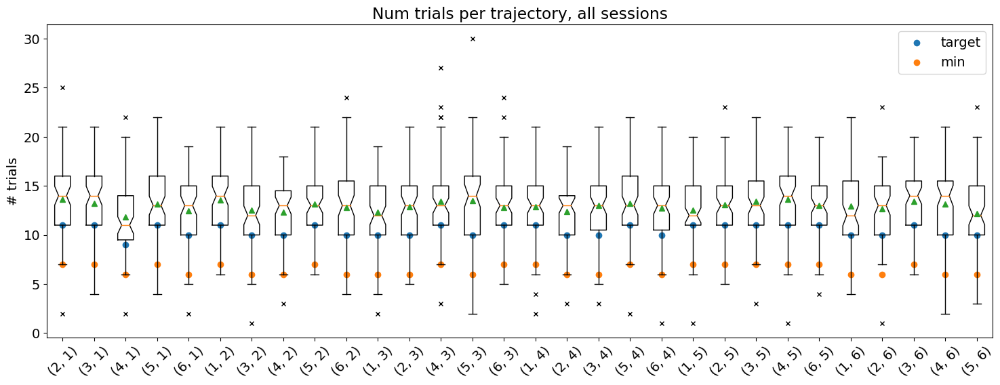

In [367]:
# Plot out distribution of number of trials per trajectory
plt.figure(figsize=(18, 6))
plt.title('Num trials per trajectory, all sessions')
plt.boxplot(num_trials_per_trajectory.values(), showmeans=True, notch=True, flierprops={'marker': 'x', 'markersize': 5})
# plt.violinplot(num_trials_per_trajectory.values(), showextrema=False)
plt.scatter(np.arange(1, len(trajectories)+1), target_num_trials, color='C0', label='target')
plt.scatter(np.arange(1, len(trajectories)+1), min_num_trials, color='C1', label='min')
plt.xticks(np.arange(1, len(trajectories)+1), labels=trajectories, rotation=45)
plt.ylabel('# trials')
plt.legend(loc='upper right')
plt.show()

In [ ]:
# Plot out distribution of number of trials per trajectory for one session
# Choose which session to plot
for sess_num in range(num_sess):
    plt.figure(figsize=(18, 6))
    plt.title(f'Num trials per trajectory, {day_list[sess_num]}')
    plt.bar(np.arange(len(trajectories)), num_trials_per_trajectory_per_sess[sess_num,:])
    plt.scatter(np.arange(len(trajectories)), target_num_trials, color='C2', label='target')
    plt.scatter(np.arange(len(trajectories)), min_num_trials, color='C1', label='min')
    plt.xticks(np.arange(len(trajectories)), labels=trajectories, rotation=45)
    plt.ylabel('# trials')
    plt.legend(loc='upper right')
    if to_save:
        if not os.path.exists(f'{figsave_dir}/trajectory_dist'):
            os.makedirs(f'{figsave_dir}/trajectory_dist')
        plt.savefig(f'{figsave_dir}/trajectory_dist/{day_list[sess_num]}.png', bbox_inches='tight')
    plt.show()
    plt.close()

In [11]:
### Assemble pseudopopulation responses, grouped by trials of the same trajectory

## Drop all trials beyond the least number of trials out of any session per trajectory
# # Append cells from each session to form a pseudopopulation, append in chronological order on responses grouped by (start, end) goals
# trajectories = list(all_spikerates_cue_per_traj[0].keys())
# combined_spikerates_cue_per_traj = {key: list() for key in trajectories}
# for traj in trajectories:
#     trials_data = [sess[traj] for sess in all_spikerates_cue_per_traj]
#     num_trials = min(map(len, trials_data))
#     for trial in range(num_trials):
#         for i, sess in enumerate(trials_data):
#             if sess[trial].shape[0] > 10:
#                 # Trim the length of the observation to 10x time bins (0 - 1000 ms)
#                 trials_data[i][trial] = sess[trial][:10,:]
#         combined_spikerates_cue_per_traj[traj].append(np.hstack([sess[trial] for sess in trials_data]))


## Bootstrap sessions to some minimum number of trials per trajectory

# Mark out sessions with at least 1 trajectory that falls below required min number of trials
sessions_to_keep = set()
for s in range(num_sess):
    if np.all(num_trials_per_trajectory_per_sess[s,:] >= min_num_trials):
        sessions_to_keep.add(s)

# Update all_cell_labels after dropping sessions
days_to_keep = set([day for d, day in enumerate(day_list) if d in sessions_to_keep])
new_cell_labels = list()
for cell in all_cell_labels:
    if cell[:8] in days_to_keep:
        new_cell_labels.append(cell)
all_cell_labels = new_cell_labels

# Append cells from each session to form a pseudopopulation, and append in chronological order on responses grouped by trajectories
# But rather than dropping trials to the minimum number of observations for the given trajectory type, try to bootstrap up to the same average number of trials per trajectory
combined_spikerates_cue_per_traj = {key: list() for key in trajectories}
num_timebins = 10
for t, traj in enumerate(trajectories):
    # Set number of average trials per trajectory to meet
    trials_data = [sess[traj] for s, sess in enumerate(all_spikerates_cue_per_traj) if s in sessions_to_keep]
    for i, sess in enumerate(trials_data):
        # num_trials_in_sess = len(sess)
        if len(sess) < target_num_trials[t]:
            # Bootstrap trials of this session if the number of obs is less than the required amount
            trials_data[i] = bootstrapping(sess, target_num_trials[t])
    for trial in range(target_num_trials[t]):
        for i, sess in enumerate(trials_data):
            if sess[trial].shape[0] > num_timebins:
                # Trim the length of the observation to 10x time bins (0 - 1000 ms)
                trials_data[i][trial] = sess[trial][:num_timebins,:]
        combined_spikerates_cue_per_traj[traj].append(np.hstack([sess[trial] for sess in trials_data]))

combined_spikerates_iti_cue_per_traj = {key: list() for key in trajectories}
num_timebins_ext = 50
for t, traj in enumerate(trajectories):
    # Set number of average trials per trajectory to meet
    trials_data = [sess[traj] for s, sess in enumerate(all_spikerates_iti_cue_per_traj) if s in sessions_to_keep]
    for i, sess in enumerate(trials_data):
        # num_trials_in_sess = len(sess)
        if len(sess) < target_num_trials[t]:
            # Bootstrap trials of this session if the number of obs is less than the required amount
            trials_data[i] = bootstrapping(sess, target_num_trials[t])
    for trial in range(target_num_trials[t]):
        for i, sess in enumerate(trials_data):
            if sess[trial].shape[0] > num_timebins_ext:
                # Trim the length of the observation to __ time bins
                trials_data[i][trial] = sess[trial][:num_timebins_ext,:]
        combined_spikerates_iti_cue_per_traj[traj].append(np.hstack([sess[trial] for sess in trials_data]))

In [321]:
sum(map(len, combined_spikerates_cue_per_traj.values()))

314

In [12]:
# Filter out cells not in good_cell_labels
cell_filter = np.array([idx for idx, cell in enumerate(all_cell_labels) if cell in set(good_cell_labels)])
for traj, data in combined_spikerates_cue_per_traj.items():
    for n, trial in enumerate(data):
        data[n] = trial[:,cell_filter]
for traj, data in combined_spikerates_iti_cue_per_traj.items():
    for n, trial in enumerate(data):
        data[n] = trial[:,cell_filter]

# Update num_all_cells and all_cell_labels to reflect number of cells in pseudopopulation
num_all_cells = cell_filter.shape[0]
all_cell_labels = [all_cell_labels[i] for i in cell_filter]

In [13]:
# Clean up large memory variables
del all_spikerates_cue
del all_spikerates_iti_cue
# del all_goals_cue
del all_trajectories_cue
del all_spikerates_cue_per_traj
del all_spikerates_iti_cue_per_traj

In [689]:
# Save list of cells in pseudopopulation as .txt file
with open('data/cell_list_pseudopop.txt', 'w') as file:
    for cell in all_cell_labels:
        file.write(f'{cell}\n')

PCA Dimensionality Reduction

In [14]:
# Combine trials into a pseudosession and fit PCA to all trials
combined_pcspikerates_cue = list()
combined_trajectories_cue = list()
for traj in trajectories:
    combined_pcspikerates_cue.extend(combined_spikerates_cue_per_traj[traj])
    combined_trajectories_cue.extend(len(combined_spikerates_cue_per_traj[traj]) * [traj])

n_dims = 3
pca = PCA(n_components=n_dims)
combined_pcspikerates_cue = pca.fit_transform(np.vstack(combined_pcspikerates_cue))

# Regroup into trajectories for plotting
num_timebins = 10
combined_pcspikerates_cue_per_traj = [[np.empty((0, num_timebins, n_dims)) for i in range(num_goals)] for j in range(num_goals)]
for k, (i, j) in enumerate(combined_trajectories_cue):
    i -= 1
    j -= 1
    combined_pcspikerates_cue_per_traj[i][j] = np.concatenate([combined_pcspikerates_cue_per_traj[i][j], combined_pcspikerates_cue[num_timebins*k:num_timebins*(k+1),:].reshape(-1, num_timebins, n_dims)])

'''
# Group cue phase responses according to trajectory, then group by same start goal and same end goal
combined_spikerates_cue_start_goals, combined_spikerates_cue_end_goals = [list() for _ in range(num_goals)], [list() for _ in range(num_goals)]
combined_start_goals_labels, combined_end_goals_labels = [list() for _ in range(num_goals)], [list() for _ in range(num_goals)]
for traj, responses in combined_spikerates_cue_per_traj.items():
    start_goal, end_goal = traj[0] - 1, traj[1] - 1
    combined_spikerates_cue_start_goals[start_goal].extend(responses)
    combined_start_goals_labels[start_goal].extend(len(responses) * [end_goal + 1])
    combined_spikerates_cue_end_goals[end_goal].extend(responses)
    combined_end_goals_labels[end_goal].extend(len(responses) * [start_goal + 1])

# Fit PCA within each group of same starting/same ending goal
pca = PCA(n_components=3)
combined_pcspikerates_cue_start_goals, combined_pcspikerates_cue_end_goals = list(), list()
for i in range(num_goals):
    pc_start_goals = pca.fit_transform(np.vstack(combined_spikerates_cue_start_goals[i]))
    pc_end_goals = pca.fit_transform(np.vstack(combined_spikerates_cue_end_goals[i]))
    combined_pcspikerates_cue_start_goals.append(np.array([pc_start_goals[10*j:10*(j+1),:] for j in range(pc_start_goals.shape[0]//10)]))
    combined_pcspikerates_cue_end_goals.append(np.array([pc_end_goals[10*j:10*(j+1),:] for j in range(pc_end_goals.shape[0]//10)]))

# Regroup into trajectories for plotting
combined_pcspikerates_cue_per_traj = [[np.empty((0, 10, 3)) for i in range(num_goals)] for j in range(num_goals)]
for i in range(num_goals):
    for j, data in enumerate(combined_pcspikerates_cue_start_goals[i]):
        k = combined_start_goals_labels[i][j] - 1
        combined_pcspikerates_cue_per_traj[i][k] = np.concatenate([combined_pcspikerates_cue_per_traj[i][k], data.reshape(-1, 10, 3)], axis=0)
'''

# Plot the average response per trajectory
combined_pcspikerates_cue_per_traj_avg = [[np.empty((0, num_timebins, n_dims)) for i in range(num_goals)] for j in range(num_goals)]
for i in range(num_goals):
    for j, data in enumerate(combined_pcspikerates_cue_per_traj[i]):
        if i == j:
            continue
        combined_pcspikerates_cue_per_traj_avg[i][j] = np.concatenate([combined_pcspikerates_cue_per_traj_avg[i][j], np.mean(data, axis=0).reshape(1, num_timebins, n_dims)], axis=0)

'''
# Subtract the first frame from all subsequent frames to get the displacement from start
combined_pcspikerates_cue_per_traj_ref = [[combined_pcspikerates_cue_per_traj_avg[i][j][:,0,:] for j in range(num_goals)] for i in range(num_goals)]
combined_pcspikerates_cue_per_traj_start = [[combined_pcspikerates_cue_per_traj_avg[i][j].copy() for j in range(num_goals)] for i in range(num_goals)]
for i in range(num_goals):
    for j in range(num_goals):
        if i == j:
            continue
        combined_pcspikerates_cue_per_traj_start[i][j] -= combined_pcspikerates_cue_per_traj_ref[i][j]

# Subtract the last frame from all previous frames to get the displacement from end
combined_pcspikerates_cue_per_traj_ref = [[combined_pcspikerates_cue_per_traj_avg[i][j][:,-1,:] for j in range(num_goals)] for i in range(num_goals)]
combined_pcspikerates_cue_per_traj_end = [[combined_pcspikerates_cue_per_traj_avg[i][j].copy() for j in range(num_goals)] for i in range(num_goals)]
for i in range(num_goals):
    for j in range(num_goals):
        if i == j:
            continue
        combined_pcspikerates_cue_per_traj_end[i][j] -= combined_pcspikerates_cue_per_traj_ref[i][j]
'''

# Calculate Frechet distances between each group, Euclidean distances between start points across groups,
# between end points across groups, and between start and end within group
frechet = DiscreteFrechet(euclidean_distance)
combined_pcspikerates_cue_per_traj_frechdist = [[dict(), dict()] for _ in range(num_goals)]
combined_pcspikerates_cue_per_traj_meaneucdist = [[dict(), dict()] for _ in range(num_goals)]
combined_pcspikerates_cue_per_traj_startdist = [[dict(), dict()] for _ in range(num_goals)]
combined_pcspikerates_cue_per_traj_enddist = [[dict(), dict()] for _ in range(num_goals)]
combined_pcspikerates_cue_per_traj_startenddist = [[dict(), dict()] for _ in range(num_goals)]
for i in range(num_goals):
    traj_pairs = list(range(num_goals))
    traj_pairs.remove(i)
    for j in traj_pairs:
        combined_pcspikerates_cue_per_traj_startenddist[i][0][j] = euclidean_distance(combined_pcspikerates_cue_per_traj_avg[i][j][0,0,:], combined_pcspikerates_cue_per_traj_avg[i][j][0,-1,:])
        combined_pcspikerates_cue_per_traj_startenddist[i][1][j] = euclidean_distance(combined_pcspikerates_cue_per_traj_avg[j][i][0,0,:], combined_pcspikerates_cue_per_traj_avg[j][i][0,-1,:])

    traj_pairs = list(combinations(traj_pairs, 2))
    for (j1, j2) in traj_pairs:
        combined_pcspikerates_cue_per_traj_frechdist[i][0][(j1, j2)] = frechet.distance(combined_pcspikerates_cue_per_traj_avg[i][j1][0,:,:], combined_pcspikerates_cue_per_traj_avg[i][j2][0,:,:])
        combined_pcspikerates_cue_per_traj_frechdist[i][1][(j1, j2)] = frechet.distance(combined_pcspikerates_cue_per_traj_avg[j1][i][0,:,:], combined_pcspikerates_cue_per_traj_avg[j2][i][0,:,:])
        combined_pcspikerates_cue_per_traj_meaneucdist[i][0][(j1, j2)] = mean_euclidean_distance(combined_pcspikerates_cue_per_traj_avg[i][j1][0,:,:], combined_pcspikerates_cue_per_traj_avg[i][j2][0,:,:])
        combined_pcspikerates_cue_per_traj_meaneucdist[i][1][(j1, j2)] = mean_euclidean_distance(combined_pcspikerates_cue_per_traj_avg[j1][i][0,:,:], combined_pcspikerates_cue_per_traj_avg[j2][i][0,:,:])

        combined_pcspikerates_cue_per_traj_startdist[i][0][(j1, j2)] = euclidean_distance(combined_pcspikerates_cue_per_traj_avg[i][j1][0,0,:], combined_pcspikerates_cue_per_traj_avg[i][j2][0,0,:])
        combined_pcspikerates_cue_per_traj_startdist[i][1][(j1, j2)] = euclidean_distance(combined_pcspikerates_cue_per_traj_avg[j1][i][0,0,:], combined_pcspikerates_cue_per_traj_avg[j2][i][0,0,:])
        combined_pcspikerates_cue_per_traj_enddist[i][0][(j1, j2)] = euclidean_distance(combined_pcspikerates_cue_per_traj_avg[i][j1][0,-1,:], combined_pcspikerates_cue_per_traj_avg[i][j2][0,-1,:])
        combined_pcspikerates_cue_per_traj_enddist[i][1][(j1, j2)] = euclidean_distance(combined_pcspikerates_cue_per_traj_avg[j1][i][0,-1,:], combined_pcspikerates_cue_per_traj_avg[j2][i][0,-1,:])


# Calculate separation between clusters per (100 ms) timestep in cue phase
combined_pcspikerates_cue_per_traj_vrc = [[np.zeros(num_timebins), np.zeros(num_timebins)] for _ in range(num_goals)]
combined_pcspikerates_cue_per_traj_dbi = [[np.zeros(num_timebins), np.zeros(num_timebins)] for _ in range(num_goals)]
for i in range(num_goals):
    pcspikerates_start, pcspikerates_end = np.zeros((0, num_timebins, n_dims)), np.zeros((0, num_timebins, n_dims))
    goals_start, goals_end = list(), list()
    for j in range(num_goals):
        if i == j:
            continue
        pcspikerates_start = np.concatenate([pcspikerates_start, combined_pcspikerates_cue_per_traj[i][j]], axis=0)
        pcspikerates_end = np.concatenate([pcspikerates_end, combined_pcspikerates_cue_per_traj[j][i]], axis=0)
        goals_start.extend(combined_pcspikerates_cue_per_traj[i][j].shape[0] * [j])
        goals_end.extend(combined_pcspikerates_cue_per_traj[j][i].shape[0] * [j])
    for t in range(10):
        combined_pcspikerates_cue_per_traj_vrc[i][0][t] = calinski_harabasz_score(pcspikerates_start[:,t,:], np.array(goals_start))
        combined_pcspikerates_cue_per_traj_vrc[i][1][t] = calinski_harabasz_score(pcspikerates_end[:,t,:], np.array(goals_end))
        combined_pcspikerates_cue_per_traj_dbi[i][0][t] = davies_bouldin_score(pcspikerates_start[:,t,:], np.array(goals_start))
        combined_pcspikerates_cue_per_traj_dbi[i][1][t] = davies_bouldin_score(pcspikerates_end[:,t,:], np.array(goals_end))

In [15]:
# Combine trials into a pseudosession and fit PCA to all trials
combined_pcspikerates_iti_cue = list()
for traj in trajectories:
    combined_pcspikerates_iti_cue.extend(combined_spikerates_iti_cue_per_traj[traj])

n_dims = 3
pca = PCA(n_components=n_dims)
combined_pcspikerates_iti_cue = pca.fit_transform(np.vstack(combined_pcspikerates_iti_cue))

# Regroup into trajectories for plotting
num_timebins_ext = 50
combined_pcspikerates_iti_cue_per_traj = [[np.empty((0, num_timebins_ext, n_dims)) for i in range(num_goals)] for j in range(num_goals)]
for k, (i, j) in enumerate(combined_trajectories_cue):
    i -= 1
    j -= 1
    combined_pcspikerates_iti_cue_per_traj[i][j] = np.concatenate([combined_pcspikerates_iti_cue_per_traj[i][j], combined_pcspikerates_iti_cue[num_timebins_ext*k:num_timebins_ext*(k+1),:].reshape(-1, num_timebins_ext, n_dims)])

Trajectory plots

In [16]:
# Rename plots to reflect number of cells in pseudopopulation
popl_name = f'{num_all_cells} cells'

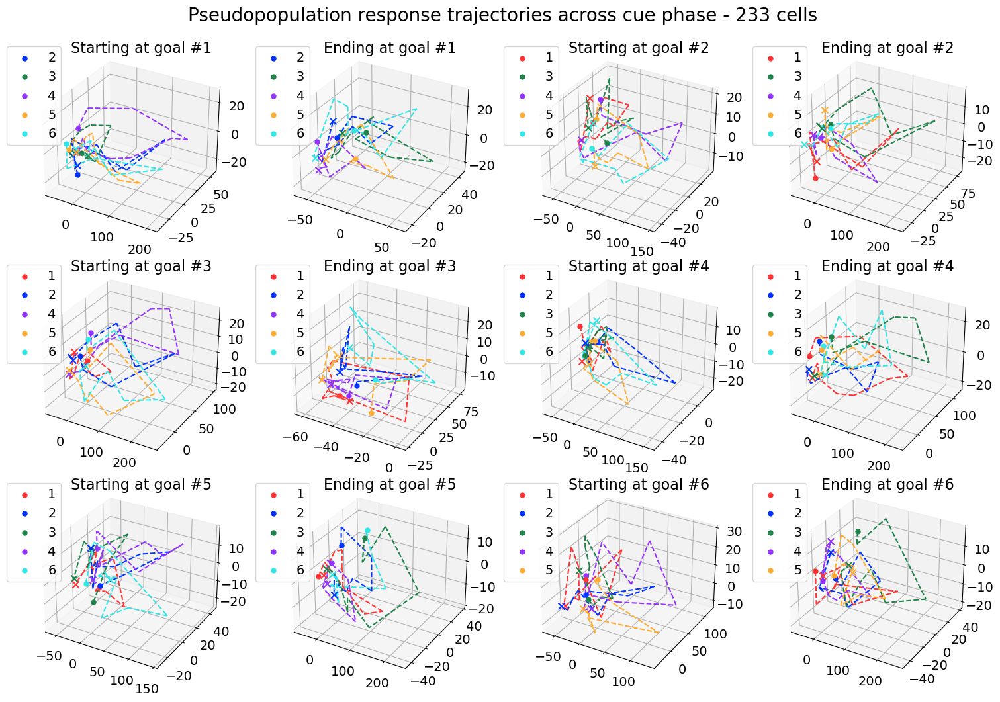

In [117]:
# Plots in PCA space for cue responses between different trajectories, mean of each group of points
fig = plt.figure(figsize=(18, 12))
plt.rcParams['font.size'] = 14
plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1, wspace=0.2, hspace=0.1)
plt.suptitle(f'Pseudopopulation response trajectories across cue phase - {popl_name}', fontsize=20, y=0.95)
colours = ['#ff3333', '#0033ff', '#1e8449', '#9333ff', '#ffac33', '#33e6e6']

for i in range(num_goals):
    ax = fig.add_subplot(3, 4, 2*i+1, projection='3d')
    ax.set_title(f'Starting at goal #{i+1}', fontsize=16, x=0.56, y=1.02)
    for j, data in enumerate(combined_pcspikerates_cue_per_traj_avg[i]):
        if data.shape[0] > 0:
            for k in range(data.shape[1]-1):
                ax.plot(data[0,k:k+2,0], data[0,k:k+2,1], data[0,k:k+2,2], linestyle='--', linewidth=1.5, color=colours[j])
            ax.scatter(data[0,0,0], data[0,0,1], data[0,0,2], marker='.', color=colours[j], s=100, label=j+1)
            ax.scatter(data[0,-1,0], data[0,-1,1], data[0,-1,2], marker='x', color=colours[j], s=50)
    ax.legend(loc=(-0.12, 0.5))

    ax = fig.add_subplot(3, 4, 2*i+2, projection='3d')
    ax.set_title(f'Ending at goal #{i+1}', fontsize=16, x=0.56, y=1.02)
    for j in range(num_goals):
        data = combined_pcspikerates_cue_per_traj_avg[j][i]
        if data.shape[0] > 0:
            for k in range(data.shape[1]-1):
                ax.plot(data[0,k:k+2,0], data[0,k:k+2,1], data[0,k:k+2,2], linestyle='--', linewidth=1.5, color=colours[j])
            ax.scatter(data[0,0,0], data[0,0,1], data[0,0,2], marker='.', color=colours[j], s=100, label=j+1)
            ax.scatter(data[0,-1,0], data[0,-1,1], data[0,-1,2], marker='x', color=colours[j], s=50)
    ax.legend(loc=(-0.12, 0.5))

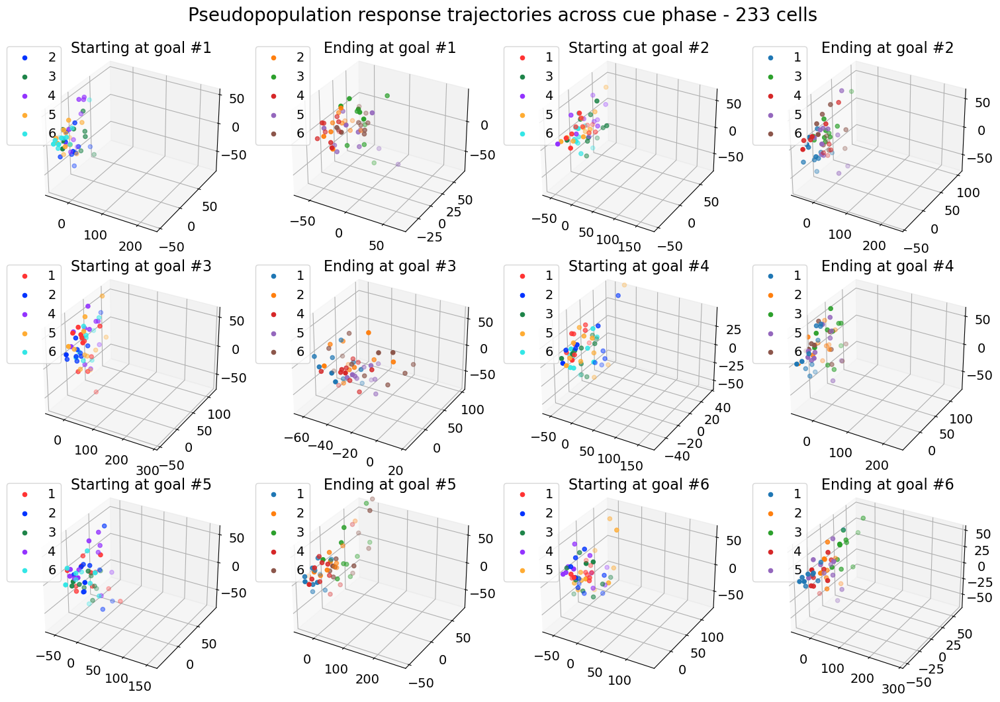

In [118]:
# Plots in PCA space for cue responses between different trajectories
fig = plt.figure(figsize=(18, 12))
plt.rcParams['font.size'] = 14
plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1, wspace=0.2, hspace=0.1)
plt.suptitle(f'Pseudopopulation response trajectories across cue phase - {popl_name}', fontsize=20, y=0.95)
colours = ['#ff3333', '#0033ff', '#1e8449', '#9333ff', '#ffac33', '#33e6e6']

sc_plots = dict()
for i in range(num_goals):
    ax = fig.add_subplot(3, 4, 2*i+1, projection='3d')
    ax.set_title(f'Starting at goal #{i+1}', fontsize=16, x=0.56, y=1.02)
    ax_lims = [[0, 0] for _ in range(3)]
    for j, data in enumerate(combined_pcspikerates_cue_per_traj[i]):
        if data.shape[0] > 0:
            sc = ax.scatter(data[:,0,0], data[:,0,1], data[:,0,2], color=colours[j], label=j+1)
            sc_plots[(i, j, 0)] = sc
            ax_lims[0][0] = min(ax_lims[0][0], np.percentile(data[:,:,0], 1, axis=None))
            ax_lims[0][1] = max(ax_lims[0][1], np.percentile(data[:,:,0], 99, axis=None))
            ax_lims[1][0] = min(ax_lims[1][0], np.percentile(data[:,:,1], 1, axis=None))
            ax_lims[1][1] = max(ax_lims[1][1], np.percentile(data[:,:,1], 99, axis=None))
            ax_lims[2][0] = min(ax_lims[2][0], np.percentile(data[:,:,2], 1, axis=None))
            ax_lims[2][1] = max(ax_lims[2][1], np.percentile(data[:,:,2], 99, axis=None))
    ax.legend(loc=(-0.12, 0.5))
    ax.set_xlim(ax_lims[0][0], ax_lims[0][1])
    ax.set_ylim(ax_lims[1][0], ax_lims[1][1])
    ax.set_zlim(ax_lims[2][0], ax_lims[2][1])

    ax = fig.add_subplot(3, 4, 2*i+2, projection='3d')
    ax.set_title(f'Ending at goal #{i+1}', fontsize=16, x=0.56, y=1.02)
    ax_lims = [[0, 0] for _ in range(3)]
    for j in range(num_goals):
        data = combined_pcspikerates_cue_per_traj[j][i]
        if data.shape[0] > 0:
            sc = ax.scatter(data[:,0,0], data[:,0,1], data[:,0,2], color=f'C{j}', label=j+1)
            sc_plots[(i, j, 1)] = sc
            ax_lims[0][0] = min(ax_lims[0][0], np.percentile(data[:,:,0], 1, axis=None))
            ax_lims[0][1] = max(ax_lims[0][1], np.percentile(data[:,:,0], 99, axis=None))
            ax_lims[1][0] = min(ax_lims[1][0], np.percentile(data[:,:,1], 1, axis=None))
            ax_lims[1][1] = max(ax_lims[1][1], np.percentile(data[:,:,1], 99, axis=None))
            ax_lims[2][0] = min(ax_lims[2][0], np.percentile(data[:,:,2], 1, axis=None))
            ax_lims[2][1] = max(ax_lims[2][1], np.percentile(data[:,:,2], 99, axis=None))
    ax.legend(loc=(-0.12, 0.5))
    ax.set_xlim(ax_lims[0][0], ax_lims[0][1])
    ax.set_ylim(ax_lims[1][0], ax_lims[1][1])
    ax.set_zlim(ax_lims[2][0], ax_lims[2][1])

def update(frame):
    for i in range(num_goals):
        for j in range(num_goals):
            data = combined_pcspikerates_cue_per_traj[i][j]
            if data.shape[0] > 0:
                sc_plots[(i, j, 0)]._offsets3d = (data[:,frame,0], data[:,frame,1], data[:,frame,2])
            data = combined_pcspikerates_cue_per_traj[j][i]
            if data.shape[0] > 0:
                sc_plots[(i, j, 1)]._offsets3d = (data[:,frame,0], data[:,frame,1], data[:,frame,2])

ani = FuncAnimation(fig, update, frames=10, interval=500, blit=False, repeat=True)
HTML(ani.to_html5_video())

if to_save:
    if not os.path.exists(figsave_dir):
        os.makedirs(figsave_dir)
    ani.save(f'{figsave_dir}/pcatraj_{save_name}.mp4', writer='ffmpeg')

In [119]:
# Set common axis limits for subsequent PCA plots/animations
ani_ax_lims = [[0, 0] for _ in range(3)]
for i in range(num_goals):
    data = np.concatenate([combined_pcspikerates_cue_per_traj[j][i] for j in range(num_goals)], axis=0)
    ani_ax_lims[0][0] = min(ax_lims[0][0], np.percentile(data[:,:,0], 1, axis=None))
    ani_ax_lims[0][1] = max(ax_lims[0][1], np.percentile(data[:,:,0], 99, axis=None))
    ani_ax_lims[1][0] = min(ax_lims[1][0], np.percentile(data[:,:,1], 1, axis=None))
    ani_ax_lims[1][1] = max(ax_lims[1][1], np.percentile(data[:,:,1], 99, axis=None))
    ani_ax_lims[2][0] = min(ax_lims[2][0], np.percentile(data[:,:,2], 1, axis=None))
    ani_ax_lims[2][1] = max(ax_lims[2][1], np.percentile(data[:,:,2], 99, axis=None))

In [ ]:
# Plots in PCA space for cue responses between different (end) goals, all in a single plot
fig = plt.figure(figsize=(12, 8))
plt.rcParams['font.size'] = 14
plt.suptitle(f'Pseudopopulation response trajectories across cue phase - {popl_name}')
colours = ['#ff3333', '#0033ff', '#1e8449', '#9333ff', '#ffac33', '#33e6e6']

# For plotting 3d spherical error bars
u = np.linspace(0, 2 * np.pi, 100)
v = np.linspace(0, np.pi, 100)
x_sphere = np.outer(np.cos(u), np.sin(v))
y_sphere = np.outer(np.sin(u), np.sin(v))
z_sphere = np.outer(np.ones(np.size(u)), np.cos(v))

ax = plt.gca()
ax.axis('off')
ax = fig.add_axes([0, 0, 1, 1], projection='3d')
for i in range(num_goals):
    data = np.mean(np.concatenate([combined_pcspikerates_cue_per_traj[j][i] for j in range(num_goals)], axis=0), axis=0)
    err = np.std(np.concatenate([combined_pcspikerates_cue_per_traj[j][i] for j in range(num_goals)], axis=0), axis=0)
    for k in range(data.shape[0]-1):
        ax.plot(data[k:k+2,0], data[k:k+2,1], data[k:k+2,2], linestyle='--', linewidth=1.5, color=colours[i])
        # ax.errorbar(data[k:k+2,0], data[k:k+2,1], data[k:k+2,2], xerr=err[k:k+2,0], yerr=err[k:k+2,1], zerr=err[k:k+2,2], linestyle='--', linewidth=1.5, color=colours[i], capsize=5)
    ax.scatter(data[0,0], data[0,1], data[0,2], marker='.', color=colours[i], s=100, label=i+1)
    ax.scatter(data[-1,0], data[-1,1], data[-1,2], marker='x', color=colours[i], s=50)
    for k in range(data.shape[0]):
        x_err = err[k,0] * x_sphere + data[k,0]
        y_err = err[k,1] * y_sphere + data[k,1]
        z_err = err[k,2] * z_sphere + data[k,2]
        ax.plot_surface(x_err, y_err, z_err, color=colours[i], alpha=0.03)
ax.legend(title='Goal', loc=(-0.05, 0.67))

In [ ]:
# Plots in PCA space for cue responses between different (end) goals, all in a single plot
fig = plt.figure(figsize=(12, 8))
plt.rcParams['font.size'] = 14
plt.suptitle(f'Pseudopopulation response trajectories across cue phase - {popl_name}')
colours = ['#ff3333', '#0033ff', '#1e8449', '#9333ff', '#ffac33', '#33e6e6']

# For plotting 3d spherical error bars
u = np.linspace(0, 2 * np.pi, 100)
v = np.linspace(0, np.pi, 100)
x_sphere = np.outer(np.cos(u), np.sin(v))
y_sphere = np.outer(np.sin(u), np.sin(v))
z_sphere = np.outer(np.ones(np.size(u)), np.cos(v))

ax = plt.gca()
ax.axis('off')
ax = fig.add_axes([0, 0, 1, 1], projection='3d')
ax_lims = [[0, 0] for _ in range(3)]
sc_plots = list()
surf_plots = list()
for i in range(num_goals):
    data = np.concatenate([combined_pcspikerates_iti_cue_per_traj[j][i] for j in range(num_goals)], axis=0)
    mean = np.mean(data, axis=0)
    err = np.std(data, axis=0)
    sc = ax.scatter([mean[0,0]], [mean[0,1]], [mean[0,2]], color=colours[i], label=i+1)
    x_err = err[0,0] * x_sphere + mean[0,0]
    y_err = err[0,1] * y_sphere + mean[0,1]
    z_err = err[0,2] * z_sphere + mean[0,2]
    surf = ax.plot_surface(x_err, y_err, z_err, color=colours[i], alpha=0.03)
    sc_plots.append(sc)
    surf_plots.append(surf)
    ax_lims[0][0] = min(ax_lims[0][0], np.min(data[:,:,0], axis=None))
    ax_lims[0][1] = max(ax_lims[0][1], np.max(data[:,:,0], axis=None))
    ax_lims[1][0] = min(ax_lims[1][0], np.min(data[:,:,1], axis=None))
    ax_lims[1][1] = max(ax_lims[1][1], np.max(data[:,:,1], axis=None))
    ax_lims[2][0] = min(ax_lims[2][0], np.min(data[:,:,2], axis=None))
    ax_lims[2][1] = max(ax_lims[2][1], np.max(data[:,:,2], axis=None))
    # ax_lims[0][0] = min(ax_lims[0][0], np.percentile(data[:,0], 1, axis=None))
    # ax_lims[0][1] = max(ax_lims[0][1], np.percentile(data[:,0], 99, axis=None))
    # ax_lims[1][0] = min(ax_lims[1][0], np.percentile(data[:,1], 1, axis=None))
    # ax_lims[1][1] = max(ax_lims[1][1], np.percentile(data[:,1], 99, axis=None))
    # ax_lims[2][0] = min(ax_lims[2][0], np.percentile(data[:,2], 1, axis=None))
    # ax_lims[2][1] = max(ax_lims[2][1], np.percentile(data[:,2], 99, axis=None))
ax.legend(title='Goal', loc=(-0.05, 0.67))
ax.set_xlim(ax_lims[0][0], ax_lims[0][1])
ax.set_ylim(ax_lims[1][0], ax_lims[1][1])
ax.set_zlim(ax_lims[2][0], ax_lims[2][1])
ax.set_xlim(ani_ax_lims[0][0], ani_ax_lims[0][1])
ax.set_ylim(ani_ax_lims[1][0], ani_ax_lims[1][1])
ax.set_zlim(ani_ax_lims[2][0], ani_ax_lims[2][1])

def update(frame):
    for i in range(num_goals):
        data = np.concatenate([combined_pcspikerates_iti_cue_per_traj[j][i] for j in range(num_goals)], axis=0)
        mean = np.mean(data, axis=0)
        err = np.std(data, axis=0)
        x_err = err[frame,0] * x_sphere + mean[frame,0]
        y_err = err[frame,1] * y_sphere + mean[frame,1]
        z_err = err[frame,2] * z_sphere + mean[frame,2]
        sc_plots[i]._offsets3d = ([mean[frame,0]], [mean[frame,1]], [mean[frame,2]])
        surf_plots[i].remove()
        surf_plots[i] = ax.plot_surface(x_err, y_err, z_err, color=colours[i], alpha=0.03)

ani = FuncAnimation(fig, update, frames=30, interval=500, blit=False, repeat=True)
HTML(ani.to_html5_video())

if to_save:
    if not os.path.exists(figsave_dir):
        os.makedirs(figsave_dir)
    ani.save(f'{figsave_dir}/pcatraj_goals_mean_{save_name}.mp4', writer='ffmpeg')

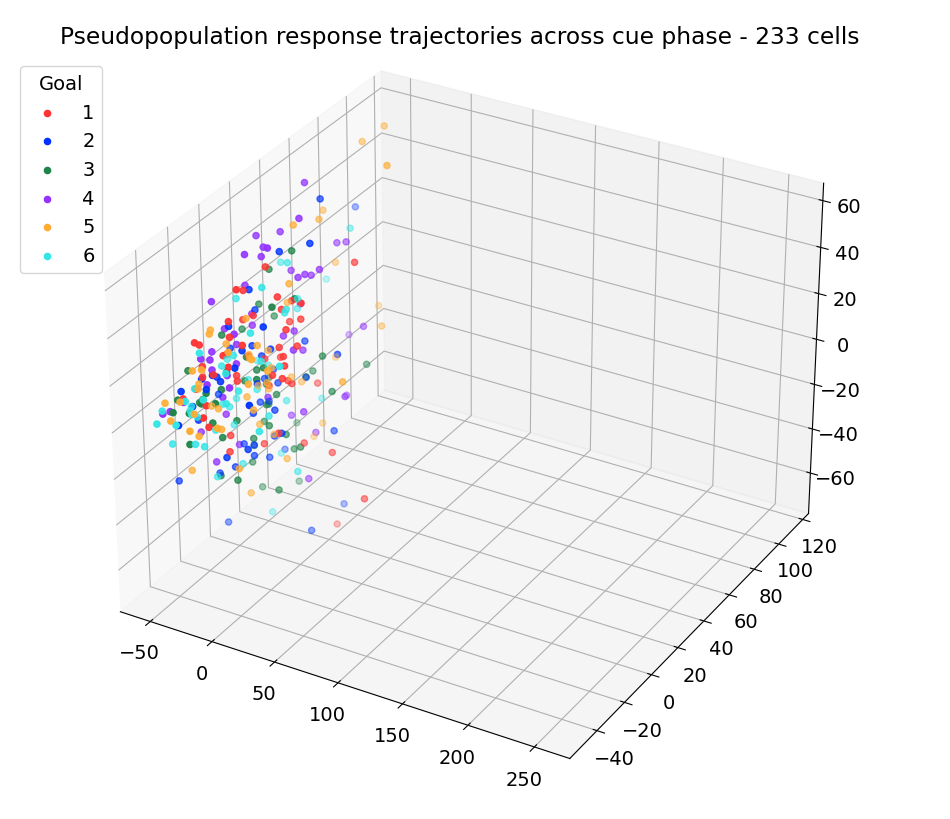

In [122]:
# Plots in PCA space for cue responses between different (end) goals, all in a single plot
fig = plt.figure(figsize=(12, 8))
plt.rcParams['font.size'] = 14
plt.suptitle(f'Pseudopopulation response trajectories across cue phase - {popl_name}')
colours = ['#ff3333', '#0033ff', '#1e8449', '#9333ff', '#ffac33', '#33e6e6']

ax = plt.gca()
ax.axis('off')
ax = fig.add_axes([0, 0, 1, 1], projection='3d')
ax_lims = [[0, 0] for _ in range(3)]
sc_plots = list()
# sc_means = list()
for i in range(num_goals):
    data = np.concatenate([combined_pcspikerates_cue_per_traj[j][i] for j in range(num_goals)], axis=0)
    # data_mean = np.mean(data, axis=0)
    sc = ax.scatter(data[:,0,0], data[:,0,1], data[:,0,2], color=colours[i], label=i+1)
    # sc2 = ax.scatter([data_mean[0,0]], [data_mean[0,1]], [data_mean[0,2]], color=colours[i], marker='x', s=40)
    sc_plots.append(sc)
    # sc_means.append(sc2)
    # ax_lims[0][0] = min(ax_lims[0][0], np.min(data[:,:,0], axis=None))
    # ax_lims[0][1] = max(ax_lims[0][1], np.max(data[:,:,0], axis=None))
    # ax_lims[1][0] = min(ax_lims[1][0], np.min(data[:,:,1], axis=None))
    # ax_lims[1][1] = max(ax_lims[1][1], np.max(data[:,:,1], axis=None))
    # ax_lims[2][0] = min(ax_lims[2][0], np.min(data[:,:,2], axis=None))
    # ax_lims[2][1] = max(ax_lims[2][1], np.max(data[:,:,2], axis=None))
    ax_lims[0][0] = min(ax_lims[0][0], np.percentile(data[:,:,0], 1, axis=None))
    ax_lims[0][1] = max(ax_lims[0][1], np.percentile(data[:,:,0], 99, axis=None))
    ax_lims[1][0] = min(ax_lims[1][0], np.percentile(data[:,:,1], 1, axis=None))
    ax_lims[1][1] = max(ax_lims[1][1], np.percentile(data[:,:,1], 99, axis=None))
    ax_lims[2][0] = min(ax_lims[2][0], np.percentile(data[:,:,2], 1, axis=None))
    ax_lims[2][1] = max(ax_lims[2][1], np.percentile(data[:,:,2], 99, axis=None))
ax.legend(title='Goal', loc=(-0.05, 0.67))
ax.set_xlim(ax_lims[0][0], ax_lims[0][1])
ax.set_ylim(ax_lims[1][0], ax_lims[1][1])
ax.set_zlim(ax_lims[2][0], ax_lims[2][1])

def update(frame):
    for i in range(num_goals):
        data = np.concatenate([combined_pcspikerates_cue_per_traj[j][i] for j in range(num_goals)], axis=0)
        # data_mean = np.mean(data, axis=0)
        sc_plots[i]._offsets3d = (data[:,frame,0], data[:,frame,1], data[:,frame,2])
        # sc_means[i]._offsets3d = ([data_mean[frame,0]], [data_mean[frame,1]], [data_mean[frame,2]])

ani = FuncAnimation(fig, update, frames=10, interval=500, blit=False, repeat=True)
HTML(ani.to_html5_video())

if to_save:
    if not os.path.exists(figsave_dir):
        os.makedirs(figsave_dir)
    ani.save(f'{figsave_dir}/pcatraj_goals_{save_name}.mp4', writer='ffmpeg')

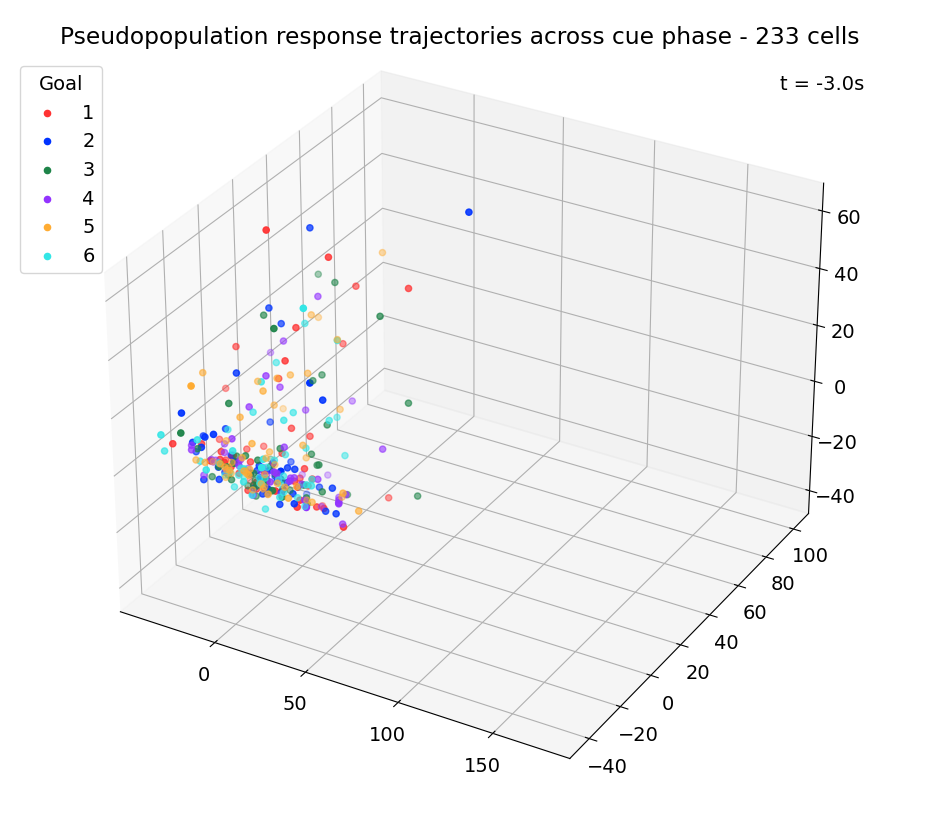

In [123]:
# Plots in PCA space for cue responses between different (end) goals, from start of iti to end of cue phase, all in a single plot
fig = plt.figure(figsize=(12, 8))
plt.rcParams['font.size'] = 14
plt.suptitle(f'Pseudopopulation response trajectories across cue phase - {popl_name}')
colours = ['#ff3333', '#0033ff', '#1e8449', '#9333ff', '#ffac33', '#33e6e6']

ax = plt.gca()
ax.axis('off')
ax = fig.add_axes([0, 0, 1, 1], projection='3d')
ax_lims = [[0, 0] for _ in range(3)]
sc_plots = list()
# sc_means = list()
for i in range(num_goals):
    data = np.concatenate([combined_pcspikerates_iti_cue_per_traj[j][i] for j in range(num_goals)], axis=0)
    # data_mean = np.mean(data, axis=0)
    sc = ax.scatter(data[:,0,0], data[:,0,1], data[:,0,2], color=colours[i], label=i+1)
    # sc2 = ax.scatter([data_mean[0,0]], [data_mean[0,1]], [data_mean[0,2]], color=colours[i], marker='x', s=40)
    sc_plots.append(sc)
    # sc_means.append(sc2)
    # ax_lims[0][0] = min(ax_lims[0][0], np.min(data[:,:,0], axis=None))
    # ax_lims[0][1] = max(ax_lims[0][1], np.max(data[:,:,0], axis=None))
    # ax_lims[1][0] = min(ax_lims[1][0], np.min(data[:,:,1], axis=None))
    # ax_lims[1][1] = max(ax_lims[1][1], np.max(data[:,:,1], axis=None))
    # ax_lims[2][0] = min(ax_lims[2][0], np.min(data[:,:,2], axis=None))
    # ax_lims[2][1] = max(ax_lims[2][1], np.max(data[:,:,2], axis=None))
    ax_lims[0][0] = min(ax_lims[0][0], np.percentile(data[:,:,0], 1, axis=None))
    ax_lims[0][1] = max(ax_lims[0][1], np.percentile(data[:,:,0], 99, axis=None))
    ax_lims[1][0] = min(ax_lims[1][0], np.percentile(data[:,:,1], 1, axis=None))
    ax_lims[1][1] = max(ax_lims[1][1], np.percentile(data[:,:,1], 99, axis=None))
    ax_lims[2][0] = min(ax_lims[2][0], np.percentile(data[:,:,2], 1, axis=None))
    ax_lims[2][1] = max(ax_lims[2][1], np.percentile(data[:,:,2], 99, axis=None))
ax.legend(title='Goal', loc=(-0.05, 0.67))
ax.set_xlim(ax_lims[0][0], ax_lims[0][1])
ax.set_ylim(ax_lims[1][0], ax_lims[1][1])
ax.set_zlim(ax_lims[2][0], ax_lims[2][1])
tstamp = ax.text2D(0.9, 0.9, '', transform=ax.transAxes)

def update(frame):
    for i in range(num_goals):
        data = np.concatenate([combined_pcspikerates_iti_cue_per_traj[j][i] for j in range(num_goals)], axis=0)
        # data_mean = np.mean(data, axis=0)
        sc_plots[i]._offsets3d = (data[:,frame,0], data[:,frame,1], data[:,frame,2])
        # sc_means[i]._offsets3d = ([data_mean[frame,0]], [data_mean[frame,1]], [data_mean[frame,2]])
        tstamp.set_text(f't = {0.1 * frame - 3:.1f}s')

ani = FuncAnimation(fig, update, frames=50, interval=500, blit=False, repeat=True)
HTML(ani.to_html5_video())

if to_save:
    if not os.path.exists(figsave_dir):
        os.makedirs(figsave_dir)
    ani.save(f'{figsave_dir}/pcatraj_goals_ext_{save_name}.mp4', writer='ffmpeg')

In [ ]:
# Plots in PCA space for cue responses between different starting locations, all in a single plot
fig = plt.figure(figsize=(12, 8))
plt.rcParams['font.size'] = 14
plt.suptitle(f'Pseudopopulation response trajectories across cue phase - {popl_name}')
colours = ['#ff3333', '#0033ff', '#1e8449', '#9333ff', '#ffac33', '#33e6e6']

# For plotting 3d spherical error bars
u = np.linspace(0, 2 * np.pi, 100)
v = np.linspace(0, np.pi, 100)
x_sphere = np.outer(np.cos(u), np.sin(v))
y_sphere = np.outer(np.sin(u), np.sin(v))
z_sphere = np.outer(np.ones(np.size(u)), np.cos(v))

ax = plt.gca()
ax.axis('off')
ax = fig.add_axes([0, 0, 1, 1], projection='3d')
for i in range(num_goals):
    data = np.mean(np.concatenate(combined_pcspikerates_cue_per_traj[i], axis=0), axis=0)
    err = np.std(np.concatenate(combined_pcspikerates_cue_per_traj[i], axis=0), axis=0)
    for k in range(data.shape[0]-1):
        ax.plot(data[k:k+2,0], data[k:k+2,1], data[k:k+2,2], linestyle='--', linewidth=1.5, color=colours[i])
    ax.scatter(data[0,0], data[0,1], data[0,2], marker='.', color=colours[i], s=100, label=i+1)
    ax.scatter(data[-1,0], data[-1,1], data[-1,2], marker='x', color=colours[i], s=50)
    for k in range(data.shape[0]):
        x_err = err[k,0] * x_sphere + data[k,0]
        y_err = err[k,1] * y_sphere + data[k,1]
        z_err = err[k,2] * z_sphere + data[k,2]
        ax.plot_surface(x_err, y_err, z_err, color=colours[i], alpha=0.03)
ax.legend(title='Start', loc=(-0.05, 0.67))

In [ ]:
# Plots in PCA space for cue responses between different starting locations, all in a single plot
fig = plt.figure(figsize=(12, 8))
plt.rcParams['font.size'] = 14
plt.suptitle(f'Pseudopopulation response trajectories across cue phase - {popl_name}')
colours = ['#ff3333', '#0033ff', '#1e8449', '#9333ff', '#ffac33', '#33e6e6']

# For plotting 3d spherical error bars
u = np.linspace(0, 2 * np.pi, 100)
v = np.linspace(0, np.pi, 100)
x_sphere = np.outer(np.cos(u), np.sin(v))
y_sphere = np.outer(np.sin(u), np.sin(v))
z_sphere = np.outer(np.ones(np.size(u)), np.cos(v))

ax = plt.gca()
ax.axis('off')
ax = fig.add_axes([0, 0, 1, 1], projection='3d')
ax_lims = [[0, 0] for _ in range(3)]
sc_plots = list()
surf_plots = list()
for i in range(num_goals):
    data = np.concatenate(combined_pcspikerates_iti_cue_per_traj[i], axis=0)
    mean = np.mean(data, axis=0)
    err = np.std(data, axis=0)
    sc = ax.scatter([mean[0,0]], [mean[0,1]], [mean[0,2]], color=colours[i], label=i+1)
    x_err = err[0,0] * x_sphere + mean[0,0]
    y_err = err[0,1] * y_sphere + mean[0,1]
    z_err = err[0,2] * z_sphere + mean[0,2]
    surf = ax.plot_surface(x_err, y_err, z_err, color=colours[i], alpha=0.03)
    sc_plots.append(sc)
    surf_plots.append(surf)
    ax_lims[0][0] = min(ax_lims[0][0], np.min(data[:,:,0], axis=None))
    ax_lims[0][1] = max(ax_lims[0][1], np.max(data[:,:,0], axis=None))
    ax_lims[1][0] = min(ax_lims[1][0], np.min(data[:,:,1], axis=None))
    ax_lims[1][1] = max(ax_lims[1][1], np.max(data[:,:,1], axis=None))
    ax_lims[2][0] = min(ax_lims[2][0], np.min(data[:,:,2], axis=None))
    ax_lims[2][1] = max(ax_lims[2][1], np.max(data[:,:,2], axis=None))
    # ax_lims[0][0] = min(ax_lims[0][0], np.percentile(data[:,0], 1, axis=None))
    # ax_lims[0][1] = max(ax_lims[0][1], np.percentile(data[:,0], 99, axis=None))
    # ax_lims[1][0] = min(ax_lims[1][0], np.percentile(data[:,1], 1, axis=None))
    # ax_lims[1][1] = max(ax_lims[1][1], np.percentile(data[:,1], 99, axis=None))
    # ax_lims[2][0] = min(ax_lims[2][0], np.percentile(data[:,2], 1, axis=None))
    # ax_lims[2][1] = max(ax_lims[2][1], np.percentile(data[:,2], 99, axis=None))
ax.legend(title='Start', loc=(-0.05, 0.67))
ax.set_xlim(ax_lims[0][0], ax_lims[0][1])
ax.set_ylim(ax_lims[1][0], ax_lims[1][1])
ax.set_zlim(ax_lims[2][0], ax_lims[2][1])

def update(frame):
    for i in range(num_goals):
        data = np.concatenate(combined_pcspikerates_iti_cue_per_traj[i], axis=0)
        mean = np.mean(data, axis=0)
        err = np.std(data, axis=0)
        x_err = err[frame,0] * x_sphere + mean[frame,0]
        y_err = err[frame,1] * y_sphere + mean[frame,1]
        z_err = err[frame,2] * z_sphere + mean[frame,2]
        sc_plots[i]._offsets3d = ([mean[frame,0]], [mean[frame,1]], [mean[frame,2]])
        surf_plots[i].remove()
        surf_plots[i] = ax.plot_surface(x_err, y_err, z_err, color=colours[i], alpha=0.03)

ani = FuncAnimation(fig, update, frames=30, interval=500, blit=False, repeat=True)
HTML(ani.to_html5_video())

if to_save:
    if not os.path.exists(figsave_dir):
        os.makedirs(figsave_dir)
    ani.save(f'{figsave_dir}/pcatraj_starts_mean_{save_name}.mp4', writer='ffmpeg')

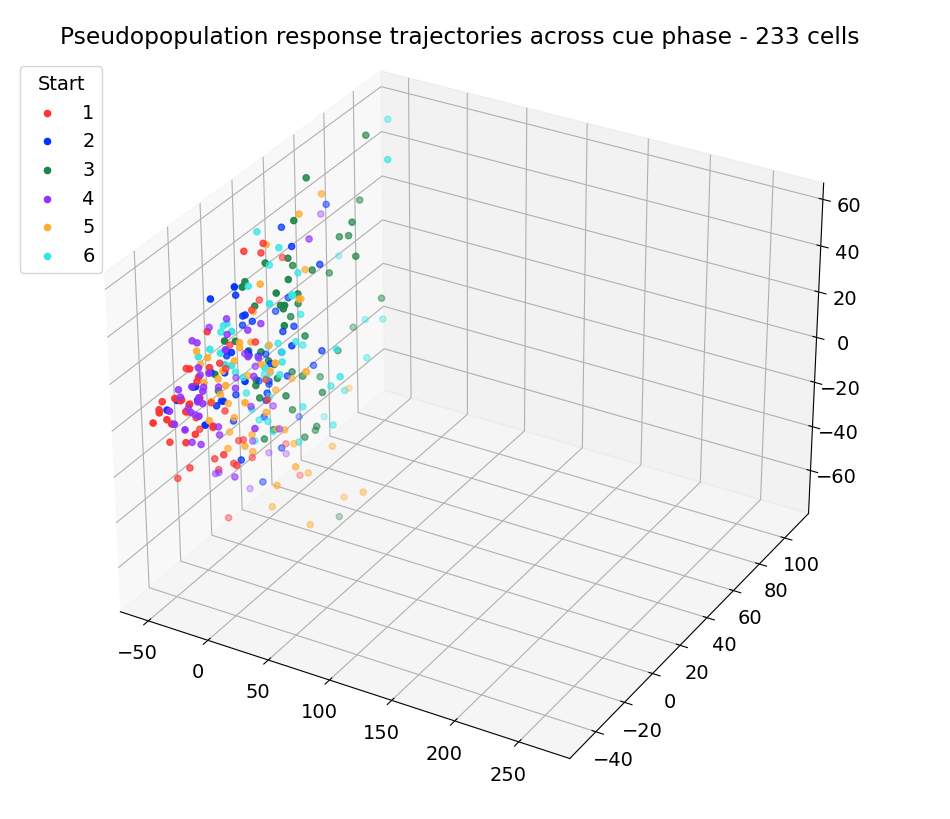

In [124]:
# Plots in PCA space for cue responses between different starting locations, all in a single plot
fig = plt.figure(figsize=(12, 8))
plt.rcParams['font.size'] = 14
plt.suptitle(f'Pseudopopulation response trajectories across cue phase - {popl_name}')
colours = ['#ff3333', '#0033ff', '#1e8449', '#9333ff', '#ffac33', '#33e6e6']

ax = plt.gca()
ax.axis('off')
ax = fig.add_axes([0, 0, 1, 1], projection='3d')
ax_lims = [[0, 0] for _ in range(3)]
sc_plots = list()
# sc_means = list()
for i in range(num_goals):
    data = np.concatenate(combined_pcspikerates_cue_per_traj[i], axis=0)
    # data_mean = np.mean(data, axis=0)
    sc = ax.scatter(data[:,0,0], data[:,0,1], data[:,0,2], color=colours[i], label=i+1)
    # sc2 = ax.scatter(data_mean[0,0], data_mean[0,1], data_mean[0,2], s=40, marker='x', color=colours[i])
    sc_plots.append(sc)
    # sc_means.append(sc2)
    # ax_lims[0][0] = min(ax_lims[0][0], np.min(data[:,:,0], axis=None))
    # ax_lims[0][1] = max(ax_lims[0][1], np.max(data[:,:,0], axis=None))
    # ax_lims[1][0] = min(ax_lims[1][0], np.min(data[:,:,1], axis=None))
    # ax_lims[1][1] = max(ax_lims[1][1], np.max(data[:,:,1], axis=None))
    # ax_lims[2][0] = min(ax_lims[2][0], np.min(data[:,:,2], axis=None))
    # ax_lims[2][1] = max(ax_lims[2][1], np.max(data[:,:,2], axis=None))
    ax_lims[0][0] = min(ax_lims[0][0], np.percentile(data[:,:,0], 1, axis=None))
    ax_lims[0][1] = max(ax_lims[0][1], np.percentile(data[:,:,0], 99, axis=None))
    ax_lims[1][0] = min(ax_lims[1][0], np.percentile(data[:,:,1], 1, axis=None))
    ax_lims[1][1] = max(ax_lims[1][1], np.percentile(data[:,:,1], 99, axis=None))
    ax_lims[2][0] = min(ax_lims[2][0], np.percentile(data[:,:,2], 1, axis=None))
    ax_lims[2][1] = max(ax_lims[2][1], np.percentile(data[:,:,2], 99, axis=None))
ax.legend(title='Start', loc=(-0.05, 0.67))
ax.set_xlim(ax_lims[0][0], ax_lims[0][1])
ax.set_ylim(ax_lims[1][0], ax_lims[1][1])
ax.set_zlim(ax_lims[2][0], ax_lims[2][1])

def update(frame):
    for i in range(num_goals):
        data = np.concatenate(combined_pcspikerates_cue_per_traj[i], axis=0)
        # data_mean = np.mean(data, axis=0)
        sc_plots[i]._offsets3d = (data[:,frame,0], data[:,frame,1], data[:,frame,2])
        # sc_means[i]._offsets3d = (data_mean[frame,0], data_mean[frame,1], data_mean[frame,2])

ani = FuncAnimation(fig, update, frames=10, interval=500, blit=False, repeat=True)
HTML(ani.to_html5_video())

if to_save:
    if not os.path.exists(figsave_dir):
        os.makedirs(figsave_dir)
    ani.save(f'{figsave_dir}/pcatraj_starts_{save_name}.mp4', writer='ffmpeg')

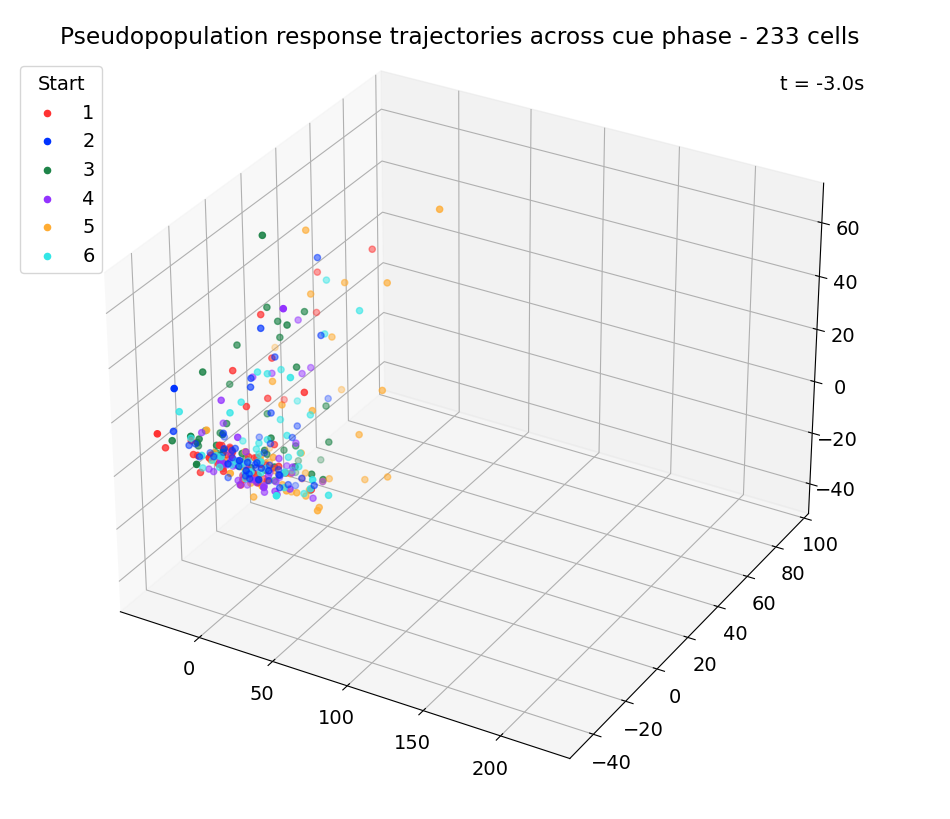

In [125]:
# Plots in PCA space for cue responses between different starting locations, from start of iti to end of cue phase, all in a single plot
fig = plt.figure(figsize=(12, 8))
plt.rcParams['font.size'] = 14
plt.suptitle(f'Pseudopopulation response trajectories across cue phase - {popl_name}')
colours = ['#ff3333', '#0033ff', '#1e8449', '#9333ff', '#ffac33', '#33e6e6']

ax = plt.gca()
ax.axis('off')
ax = fig.add_axes([0, 0, 1, 1], projection='3d')
ax_lims = [[0, 0] for _ in range(3)]
sc_plots = list()
# sc_means = list()
for i in range(num_goals):
    data = np.concatenate(combined_pcspikerates_iti_cue_per_traj[i], axis=0)
    # data_mean = np.mean(data, axis=0)
    sc = ax.scatter(data[:,0,0], data[:,0,1], data[:,0,2], color=colours[i], label=i+1)
    # sc2 = ax.scatter([data_mean[0,0]], [data_mean[0,1]], [data_mean[0,2]], color=colours[i], marker='x', s=40)
    sc_plots.append(sc)
    # sc_means.append(sc2)
    # ax_lims[0][0] = min(ax_lims[0][0], np.min(data[:,:,0], axis=None))
    # ax_lims[0][1] = max(ax_lims[0][1], np.max(data[:,:,0], axis=None))
    # ax_lims[1][0] = min(ax_lims[1][0], np.min(data[:,:,1], axis=None))
    # ax_lims[1][1] = max(ax_lims[1][1], np.max(data[:,:,1], axis=None))
    # ax_lims[2][0] = min(ax_lims[2][0], np.min(data[:,:,2], axis=None))
    # ax_lims[2][1] = max(ax_lims[2][1], np.max(data[:,:,2], axis=None))
    ax_lims[0][0] = min(ax_lims[0][0], np.percentile(data[:,:,0], 1, axis=None))
    ax_lims[0][1] = max(ax_lims[0][1], np.percentile(data[:,:,0], 99, axis=None))
    ax_lims[1][0] = min(ax_lims[1][0], np.percentile(data[:,:,1], 1, axis=None))
    ax_lims[1][1] = max(ax_lims[1][1], np.percentile(data[:,:,1], 99, axis=None))
    ax_lims[2][0] = min(ax_lims[2][0], np.percentile(data[:,:,2], 1, axis=None))
    ax_lims[2][1] = max(ax_lims[2][1], np.percentile(data[:,:,2], 99, axis=None))
ax.legend(title='Start', loc=(-0.05, 0.67))
ax.set_xlim(ax_lims[0][0], ax_lims[0][1])
ax.set_ylim(ax_lims[1][0], ax_lims[1][1])
ax.set_zlim(ax_lims[2][0], ax_lims[2][1])
tstamp = ax.text2D(0.9, 0.9, '', transform=ax.transAxes)

def update(frame):
    for i in range(num_goals):
        data = np.concatenate(combined_pcspikerates_iti_cue_per_traj[i], axis=0)
        # data_mean = np.mean(data, axis=0)
        sc_plots[i]._offsets3d = (data[:,frame,0], data[:,frame,1], data[:,frame,2])
        # sc_means[i]._offsets3d = ([data_mean[frame,0]], [data_mean[frame,1]], [data_mean[frame,2]])
        tstamp.set_text(f't = {0.1 * frame - 3:.1f}s')

ani = FuncAnimation(fig, update, frames=50, interval=500, blit=False, repeat=True)
HTML(ani.to_html5_video())

if to_save:
    if not os.path.exists(figsave_dir):
        os.makedirs(figsave_dir)
    ani.save(f'{figsave_dir}/pcatraj_starts_ext_{save_name}.mp4', writer='ffmpeg')

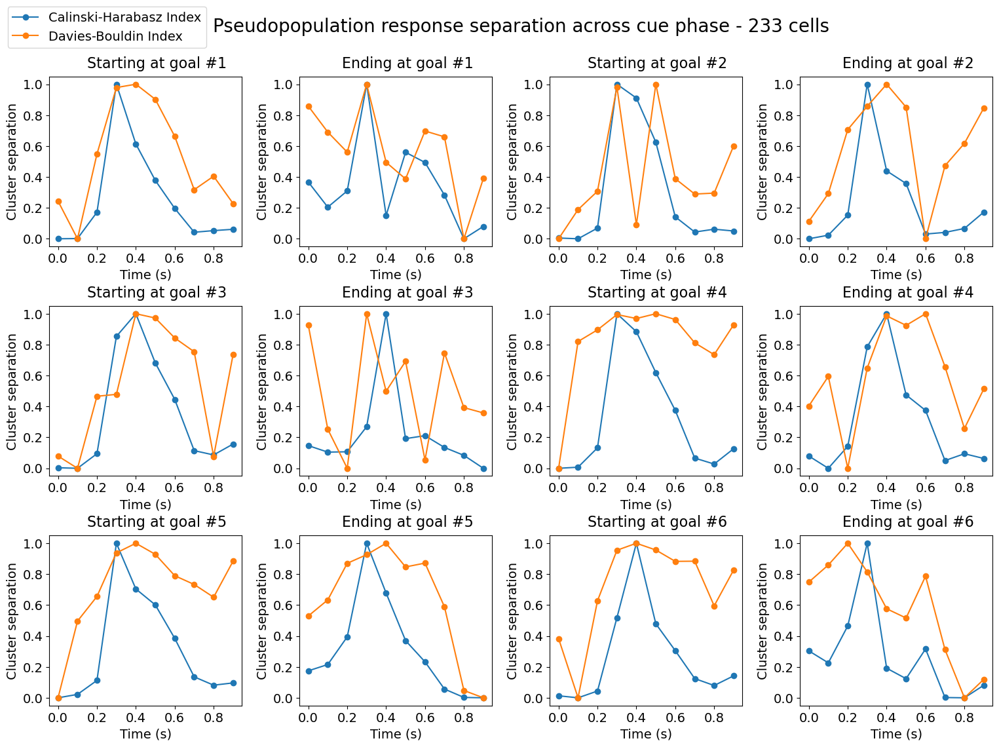

In [126]:
# Plots of cluster separation for cue responses between different trajectories
fig = plt.figure(figsize=(18, 12))
plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1, wspace=0.3, hspace=0.35)
plt.suptitle(f'Pseudopopulation response separation across cue phase - {popl_name}', fontsize=20, y=0.975)
scaler = MinMaxScaler()

for i in range(num_goals):
    ax = fig.add_subplot(3, 4, 2*i+1)
    ax.set_title(f'Starting at goal #{i+1}', fontsize=16, x=0.56, y=1.02)
    ax.plot(np.arange(0, 1, 0.1), scaler.fit_transform(combined_pcspikerates_cue_per_traj_vrc[i][0].reshape(-1,1)), 'o-', color='C0', label='Calinski-Harabasz Index')
    ax.plot(np.arange(0, 1, 0.1), 1-scaler.fit_transform(combined_pcspikerates_cue_per_traj_dbi[i][0].reshape(-1,1)), 'o-', color='C1', label='Davies-Bouldin Index')
    ax.set_xlabel('Time (s)')
    ax.set_ylabel('Cluster separation')

    ax = fig.add_subplot(3, 4, 2*i+2)
    ax.set_title(f'Ending at goal #{i+1}', fontsize=16, x=0.56, y=1.02)
    ax.plot(np.arange(0, 1, 0.1), scaler.fit_transform(combined_pcspikerates_cue_per_traj_vrc[i][1].reshape(-1,1)), 'o-', color='C0', label='Calinski-Harabasz Index')
    ax.plot(np.arange(0, 1, 0.1), 1-scaler.fit_transform(combined_pcspikerates_cue_per_traj_dbi[i][1].reshape(-1,1)), 'o-', color='C1', label='Davies-Bouldin Index')
    ax.set_xlabel('Time (s)')
    ax.set_ylabel('Cluster separation')

ax = plt.subplot(3, 4, 1)
ax.legend(loc='upper left', bbox_to_anchor=(-0.25, 1.45))

In [ ]:
fig = plt.figure(figsize=(1, 6))
ax = fig.gca()

for (a, b), val in combined_pcspikerates_cue_per_traj_frechdist[0][0].items():
    ax.scatter(0, val, marker='s', s=100, color=colours[a], linewidth=1)
    ax.scatter(0, val, marker='s', s=40, color=colours[b], linewidth=1)
    # ax.annotate(f'({a+1}, {b+1})', (0, val), textcoords="offset points", xytext=(-5, 5), ha='right', va='center', fontsize=10, rotation=15)

for (a, b), val in combined_pcspikerates_cue_per_traj_startdist[0][0].items():
    ax.scatter(0, val, marker='o', s=100, color=colours[a], linewidth=1)
    ax.scatter(0, val, marker='o', s=40, color=colours[b], linewidth=1)
    # ax.annotate(f'({a+1}, {b+1})', (0, val), textcoords="offset points", xytext=(-5, 5), ha='right', va='center', fontsize=10, rotation=15)

for (a, b), val in combined_pcspikerates_cue_per_traj_enddist[0][0].items():
    ax.scatter(0, val, marker='x', s=100, color=colours[a], linewidth=1)
    ax.scatter(0, val, marker='x', s=40, color=colours[b], linewidth=1)
    # ax.annotate(f'({a+1}, {b+1})', (0, val), textcoords="offset points", xytext=(-5, 5), ha='right', va='center', fontsize=10, rotation=15)

# for a, val in combined_pcspikerates_cue_per_traj_startenddist[0][0].items():
    # ax.scatter(0, val, marker='^', s=100, color=colours[a], linewidth=1)
    # ax.annotate(f'({a+1}, {b+1})', (0, val), textcoords="offset points", xytext=(-5, 5), ha='right', va='center', fontsize=10, rotation=15)

ax.set_xticks([])
# ax.set_xlim([-2,1])
ax.set_ylabel('Euclidean/Fréchet distance')
ax.yaxis.tick_right()
ax.yaxis.set_label_position("right")

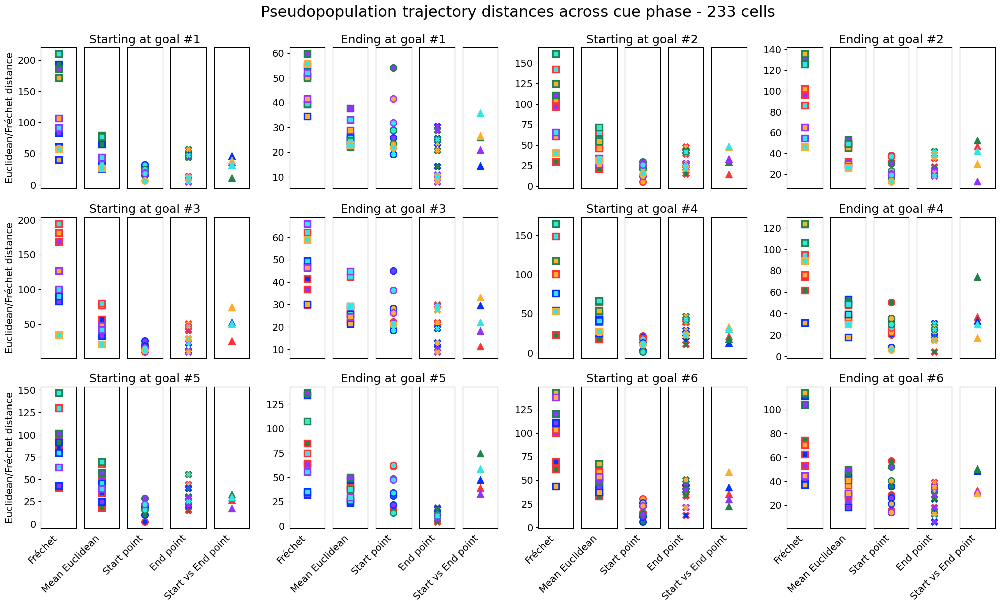

In [127]:
# Plots of distance metrics between different trajectories
fig = plt.figure(figsize=(24, 12))
outer_gs = GridSpec(3, 4)
plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1, wspace=0.15, hspace=0.2)
plt.suptitle(f'Pseudopopulation trajectory distances across cue phase - {popl_name}', fontsize=22, y=0.97)
colours = ['#ff3333', '#0033ff', '#1e8449', '#9333ff', '#ffac33', '#33e6e6']

for i in range(num_goals):
    for j in range(2):
        inner_gs = outer_gs[2*i+j].subgridspec(1, 5, wspace=0, width_ratios=5*[1])

        ax1 = fig.add_subplot(inner_gs[0])
        ax2 = fig.add_subplot(inner_gs[1], sharey=ax1)
        ax3 = fig.add_subplot(inner_gs[2], sharey=ax1)
        ax4 = fig.add_subplot(inner_gs[3], sharey=ax1)
        ax5 = fig.add_subplot(inner_gs[4], sharey=ax1)

        ax1.set_box_aspect(4)
        ax2.set_box_aspect(4)
        ax3.set_box_aspect(4)
        ax4.set_box_aspect(4)
        ax5.set_box_aspect(4)

        if j == 0:
            ax3.set_title(f'Starting at goal #{i+1}')
        else:
            ax3.set_title(f'Ending at goal #{i+1}')

        for (a, b), val in combined_pcspikerates_cue_per_traj_frechdist[i][j].items():
            ax1.scatter(0, val, marker='s', s=100, color=colours[a], linewidth=1)
            ax1.scatter(0, val, marker='s', s=40, color=colours[b], linewidth=1)
        ax1.set_xticks([])
        
        for (a, b), val in combined_pcspikerates_cue_per_traj_meaneucdist[i][j].items():
            ax2.scatter(0, val, marker='s', s=100, color=colours[a], linewidth=1)
            ax2.scatter(0, val, marker='s', s=40, color=colours[b], linewidth=1)
        ax2.set_xticks([])
        ax2.tick_params('y', left=False, labelleft=False)

        for (a, b), val in combined_pcspikerates_cue_per_traj_startdist[i][j].items():
            ax3.scatter(0, val, marker='o', s=100, color=colours[a], linewidth=1)
            ax3.scatter(0, val, marker='o', s=40, color=colours[b], linewidth=1)
        ax3.set_xticks([])
        ax3.tick_params('y', left=False, labelleft=False)

        for (a, b), val in combined_pcspikerates_cue_per_traj_enddist[i][j].items():
            ax4.scatter(0, val, marker='X', s=100, color=colours[a], linewidth=1)
            ax4.scatter(0, val, marker='X', s=40, color=colours[b], linewidth=1)
        ax4.set_xticks([])
        ax4.tick_params('y', left=False, labelleft=False)

        for a, val in combined_pcspikerates_cue_per_traj_startenddist[i][j].items():
            ax5.scatter(0, val, marker='^', s=100, color=colours[a], linewidth=1)
        ax5.set_xticks([])
        ax5.tick_params('y', left=False, labelleft=False)

        if (2*i+j) % 4 == 0:
            ax1.set_ylabel('Euclidean/Fréchet distance')

        if i >= 4:
            ax1.set_xlabel('Fréchet', rotation=45, ha='right', va='top')
            ax2.set_xlabel('Mean Euclidean', rotation=45, ha='right', va='top')
            ax3.set_xlabel('Start point', rotation=45, ha='right', va='top')
            ax4.set_xlabel('End point', rotation=45, ha='right', va='top')
            ax5.set_xlabel('Start vs End point', rotation=45, ha='right', va='top')

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


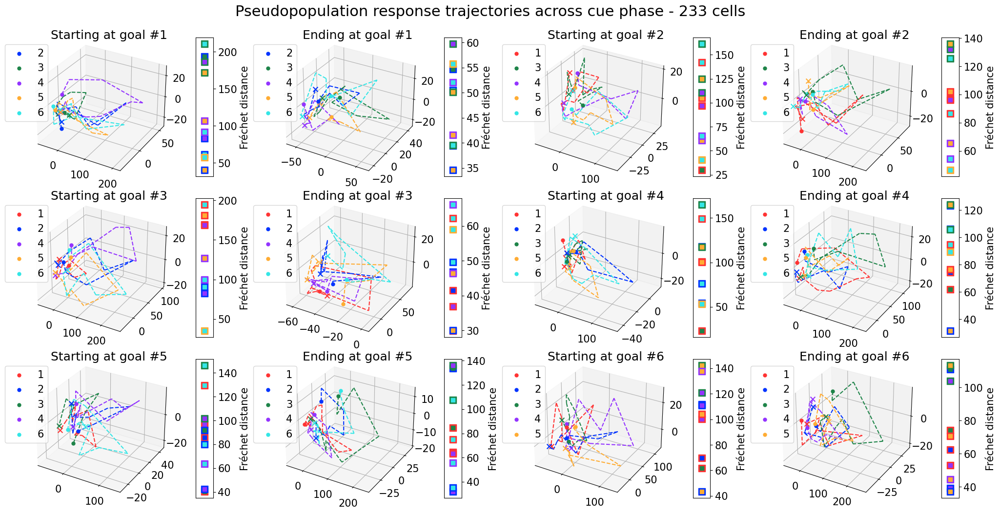

In [128]:
# Plots in PCA space for cue responses between different trajectories, mean of each group of points
fig = plt.figure(figsize=(24, 12))
outer_gs = GridSpec(3, 4)
plt.rcParams['font.size'] = 15
plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1, wspace=0.3, hspace=0.1)
plt.suptitle(f'Pseudopopulation response trajectories across cue phase - {popl_name}', fontsize=22, y=0.95)
colours = ['#ff3333', '#0033ff', '#1e8449', '#9333ff', '#ffac33', '#33e6e6']

for i in range(num_goals):
    inner_gs = outer_gs[2*i].subgridspec(1, 2, wspace=0.2, width_ratios=[9, 1])
    ax1 = fig.add_subplot(inner_gs[0], projection='3d')
    ax1.set_title(f'Starting at goal #{i+1}', fontsize=18, x=0.56, y=1.02)
    for j, data in enumerate(combined_pcspikerates_cue_per_traj_avg[i]):
        if data.shape[0] > 0:
            for k in range(data.shape[1]-1):
                ax1.plot(data[0,k:k+2,0], data[0,k:k+2,1], data[0,k:k+2,2], linestyle='--', linewidth=1.5, color=colours[j])
            ax1.scatter(data[0,0,0], data[0,0,1], data[0,0,2], marker='.', color=colours[j], s=100, label=j+1)
            ax1.scatter(data[0,-1,0], data[0,-1,1], data[0,-1,2], marker='x', color=colours[j], s=50)
    ax1.legend(loc=(-0.15, 0.4))

    ax2 = fig.add_subplot(inner_gs[1])
    ax2.set_box_aspect(8)
    for (a, b), val in combined_pcspikerates_cue_per_traj_frechdist[i][0].items():
        ax2.scatter(0, val, marker='s', s=100, color=colours[a], linewidth=1)
        ax2.scatter(0, val, marker='s', s=40, color=colours[b], linewidth=1)
        #ax2.annotate(f'({a+1}, {b+1})', (0, val), textcoords="offset points", xytext=(-5, 5), ha='right', va='center', fontsize=10, rotation=15)
    ax2.set_xticks([])
    #ax2.set_xlim([-2,1])
    ax2.set_ylabel('Fréchet distance')
    ax2.yaxis.tick_right()
    ax2.yaxis.set_label_position("right")
    #ax2.yaxis.set_major_formatter(StrMethodFormatter('{x:,.0f}'))

    inner_gs = outer_gs[2*i+1].subgridspec(1, 2, wspace=0.2, width_ratios=[9, 1])
    ax1 = fig.add_subplot(inner_gs[0], projection='3d')
    ax1.set_title(f'Ending at goal #{i+1}', fontsize=18, x=0.56, y=1.02)
    for j in range(num_goals):
        data = combined_pcspikerates_cue_per_traj_avg[j][i]
        if data.shape[0] > 0:
            for k in range(data.shape[1]-1):
                ax1.plot(data[0,k:k+2,0], data[0,k:k+2,1], data[0,k:k+2,2], linestyle='--', linewidth=1.5, color=colours[j])
            ax1.scatter(data[0,0,0], data[0,0,1], data[0,0,2], marker='.', color=colours[j], s=100, label=j+1)
            ax1.scatter(data[0,-1,0], data[0,-1,1], data[0,-1,2], marker='x', color=colours[j], s=50)
    ax1.legend(loc=(-0.15, 0.4))

    ax2 = fig.add_subplot(inner_gs[1])
    ax2.set_box_aspect(8)
    for (a, b), val in combined_pcspikerates_cue_per_traj_frechdist[i][1].items():
        ax2.scatter(0, val, marker='s', s=100, color=colours[a], linewidth=1)
        ax2.scatter(0, val, marker='s', s=40, color=colours[b], linewidth=1)
        #ax2.annotate(f'({a+1}, {b+1})', (0, val), textcoords="offset points", xytext=(-5, 5), ha='right', va='center', fontsize=10, rotation=15)
    ax2.set_xticks([])
    #ax2.set_xlim([-2,1])
    ax2.set_ylabel('Fréchet distance')
    ax2.yaxis.tick_right()
    ax2.yaxis.set_label_position("right")
    #ax2.yaxis.set_major_formatter(StrMethodFormatter('{x:,.0f}'))

if to_save:
    if not os.path.exists(figsave_dir):
        os.makedirs(figsave_dir)
    plt.savefig(f'{figsave_dir}/pcatraj_{save_name}.eps', bbox_inches='tight')

#### LDA Decoding/Response Trajectories

In [17]:
def symmetric_hausdorff(u: np.array, v: np.array) -> float:
    return max(directed_hausdorff(u, v)[0], directed_hausdorff(v, u)[0])

In [20]:
# Performance accuracy of LDA model on cue phase population responses
combined_ldspikerates_cue = list()
combined_trajectories_cue = list()
for traj in trajectories:
    combined_ldspikerates_cue.extend(combined_spikerates_cue_per_traj[traj])
    combined_trajectories_cue.extend(len(combined_spikerates_cue_per_traj[traj]) * [traj])

combined_ldspikerates_cue = np.vstack(combined_ldspikerates_cue)
combined_goals_cue_lda = np.array([item for sublist in map(lambda x: 10*[x[1]], combined_trajectories_cue) for item in sublist])

k_fold = 10
lda_accuracy_cue = np.zeros(k_fold)
lda_confusion_cue = np.zeros((num_goals, num_goals))
for i in range(k_fold):
    X_train, X_test, y_train, y_test = train_test_split(combined_ldspikerates_cue, combined_goals_cue_lda, (i, k_fold))
    lda = LinearDiscriminantAnalysis()
    lda.fit(X_train, y_train)
    y_pred = lda.predict(X_test)
    lda_accuracy_cue[i] = prediction_accuracy(y_pred, y_test)
    lda_confusion_cue += confusion_matrix(y_pred, y_test, num_goals)

# Random shuffle of trial order
shuffle_index = np.random.permutation(combined_ldspikerates_cue.shape[0])
combined_ldspikerates_cue = combined_ldspikerates_cue[shuffle_index,:]
combined_goals_cue_lda = combined_goals_cue_lda[shuffle_index]

lda_accuracy_cue_shuffled = np.zeros(k_fold)
lda_confusion_cue_shuffled = np.zeros((num_goals, num_goals))
for i in range(k_fold):
    X_train, X_test, y_train, y_test = train_test_split(combined_ldspikerates_cue, combined_goals_cue_lda, (i, k_fold))
    lda = LinearDiscriminantAnalysis()
    lda.fit(X_train, y_train)
    y_pred = lda.predict(X_test)
    lda_accuracy_cue_shuffled[i] = prediction_accuracy(y_pred, y_test)
    lda_confusion_cue_shuffled += confusion_matrix(y_pred, y_test, num_goals)

In [ ]:
# Visualize LDA model performance
plt.figure()
plt.title(f'LDA cue phase goal classification')
plt.scatter(np.ones_like(lda_accuracy_cue), lda_accuracy_cue, color='C0')
plt.scatter(np.ones_like(lda_accuracy_cue_shuffled) + 1, lda_accuracy_cue_shuffled, color='C0')
plt.boxplot([lda_accuracy_cue, lda_accuracy_cue_shuffled], showmeans=True, notch=True, flierprops={'marker': 'o', 'markersize': 5})
# plt.violinplot(lda_accuracy_cue, showextrema=False)
plt.axhline(y=1/6, color='r', linewidth=1, linestyle='--')
plt.xticks(np.arange(1, 3), labels=['Non-shuffled', 'Shuffled'])
plt.ylabel('Accuracy')

In [21]:
# Generate an indexing for trajectories
trajectory_index_labels = dict(enumerate(trajectories))
trajectory_indexing = {val: key for key, val in trajectory_index_labels.items()}

# Performance accuracy of LDA model across individual 100ms time windows of cue phase population responses
combined_ldspikerates_cue = list()
combined_trajectories_cue = list()
for traj in trajectories:
    combined_ldspikerates_cue.extend(combined_spikerates_cue_per_traj[traj])
    combined_trajectories_cue.extend(len(combined_spikerates_cue_per_traj[traj]) * [traj])

num_timebins = 10
combined_ldspikerates_cue_timebins = np.zeros((len(combined_ldspikerates_cue), num_timebins, num_all_cells))
for i, trial in enumerate(combined_ldspikerates_cue):
    for k in range(num_timebins):
        combined_ldspikerates_cue_timebins[i,k,:] = trial[k,:]
combined_goals_cue_lda_timebins = np.array(list(map(lambda x: x[1], combined_trajectories_cue)))
combined_starts_cue_lda_timebins = np.array(list(map(lambda x: x[0], combined_trajectories_cue)))
combined_trajs_cue_lda_timebins = np.array(list(map(lambda x: trajectory_indexing[x], combined_trajectories_cue)))

k_fold = 10
lda_goal_accuracy_cue_timebins = np.zeros((num_timebins, k_fold))
lda_goal_confusion_cue_timebins = np.zeros((num_timebins, num_goals, num_goals))
lda_start_accuracy_cue_timebins = np.zeros((num_timebins, k_fold))
lda_start_confusion_cue_timebins = np.zeros((num_timebins, num_goals, num_goals))
lda_traj_accuracy_cue_timebins = np.zeros((num_timebins, k_fold))
lda_traj_confusion_cue_timebins = np.zeros((num_timebins, len(trajectories), len(trajectories)))
lda_startgoal_accuracy_cue_timebins = np.zeros((num_timebins, k_fold))

for k in range(num_timebins):
    for i in range(k_fold):
        # Goal
        X_train, X_test, y_train, y_test = train_test_split(combined_ldspikerates_cue_timebins[:,k,:], combined_goals_cue_lda_timebins, (i, k_fold))
        lda = LinearDiscriminantAnalysis()
        lda.fit(X_train, y_train)
        y_pred = lda.predict(X_test)
        lda_goal_accuracy_cue_timebins[k,i] = prediction_accuracy(y_pred, y_test)
        lda_goal_confusion_cue_timebins[k,:,:] += confusion_matrix(y_pred, y_test, num_goals)
        goal_pred = y_pred

        # Start
        X_train, X_test, y_train, y_test = train_test_split(combined_ldspikerates_cue_timebins[:,k,:], combined_starts_cue_lda_timebins, (i, k_fold))
        lda = LinearDiscriminantAnalysis()
        lda.fit(X_train, y_train)
        y_pred = lda.predict(X_test)
        lda_start_accuracy_cue_timebins[k,i] = prediction_accuracy(y_pred, y_test)
        lda_start_confusion_cue_timebins[k,:,:] += confusion_matrix(y_pred, y_test, num_goals)
        start_pred = y_pred

        # Trajectory
        X_train, X_test, y_train, y_test = train_test_split(combined_ldspikerates_cue_timebins[:,k,:], combined_trajs_cue_lda_timebins, (i, k_fold))
        lda = LinearDiscriminantAnalysis()
        lda.fit(X_train, y_train)
        y_pred = lda.predict(X_test)
        lda_traj_accuracy_cue_timebins[k,i] = prediction_accuracy(y_pred, y_test)
        lda_traj_confusion_cue_timebins[k,:,:] += confusion_matrix(y_pred+1, y_test+1, len(trajectories))

        # Prediction accuracy of goal + start model on trajectory
        traj_pred = np.array(list(map(lambda x: trajectory_indexing.get(x, -1), zip(start_pred, goal_pred))))
        lda_startgoal_accuracy_cue_timebins[k,i] = prediction_accuracy(traj_pred, y_test)

In [22]:
# Performance accuracy of LDA model across individual 100ms time windows of cue phase population responses
combined_ldspikerates_iti_cue = list()
for traj in trajectories:
    combined_ldspikerates_iti_cue.extend(combined_spikerates_iti_cue_per_traj[traj])

# combined_ldspikerates_iti_cue = list()
# for traj in trajectories:
#     combined_ldspikerates_iti_cue.extend([trial for trial in combined_spikerates_iti_cue_filt_per_traj[traj]])

num_timebins_ext = 50
combined_ldspikerates_iti_cue_timebins = np.zeros((len(combined_ldspikerates_iti_cue), num_timebins_ext, num_all_cells))
# combined_ldspikerates_iti_cue_timebins = np.zeros((len(combined_ldspikerates_iti_cue), num_timebins_ext, num_cells_filt))
for i, trial in enumerate(combined_ldspikerates_iti_cue):
    for k in range(num_timebins_ext):
        combined_ldspikerates_iti_cue_timebins[i,k,:] = trial[k,:]

k_fold = 10

# Same-domain models
lda_goal_accuracy_iti_cue_timebins = np.zeros((num_timebins_ext, k_fold))
lda_goal_confusion_iti_cue_timebins = np.zeros((num_timebins_ext, num_goals, num_goals))
lda_start_accuracy_iti_cue_timebins = np.zeros((num_timebins_ext, k_fold))
lda_start_confusion_iti_cue_timebins = np.zeros((num_timebins_ext, num_goals, num_goals))
lda_traj_accuracy_iti_cue_timebins = np.zeros((num_timebins_ext, k_fold))
lda_traj_confusion_iti_cue_timebins = np.zeros((num_timebins_ext, len(trajectories), len(trajectories)))
# Cross-domain models
lda_trajgoal_accuracy_iti_cue_timebins = np.zeros((num_timebins_ext, k_fold))
lda_trajgoal_confusion_iti_cue_timebins = np.zeros((num_timebins_ext, num_goals, num_goals))
lda_trajstart_accuracy_iti_cue_timebins = np.zeros((num_timebins_ext, k_fold))
lda_trajstart_confusion_iti_cue_timebins = np.zeros((num_timebins_ext, num_goals, num_goals))
lda_startgoal_accuracy_iti_cue_timebins = np.zeros((num_timebins_ext, k_fold))
lda_startgoal_confusion_iti_cue_timebins = np.zeros((num_timebins_ext, len(trajectories), len(trajectories)))

num_preds_changed = 0

for k in range(num_timebins_ext):
    for i in range(k_fold):
        # Goal
        X_train, X_test, y_train, y_test = train_test_split(combined_ldspikerates_iti_cue_timebins[:,k,:], combined_goals_cue_lda_timebins, (i, k_fold))
        lda = LinearDiscriminantAnalysis()
        lda.fit(X_train, y_train)
        y_pred = lda.predict(X_test)
        lda_goal_accuracy_iti_cue_timebins[k,i] = prediction_accuracy(y_pred, y_test)
        lda_goal_confusion_iti_cue_timebins[k,:,:] += confusion_matrix(y_pred, y_test, num_goals)
        goal_pred, goal_actl = y_pred, y_test
        goal_prob = lda.predict_proba(X_test)

        # Start
        X_train, X_test, y_train, y_test = train_test_split(combined_ldspikerates_iti_cue_timebins[:,k,:], combined_starts_cue_lda_timebins, (i, k_fold))
        lda = LinearDiscriminantAnalysis()
        lda.fit(X_train, y_train)
        y_pred = lda.predict(X_test)
        lda_start_accuracy_iti_cue_timebins[k,i] = prediction_accuracy(y_pred, y_test)
        lda_start_confusion_iti_cue_timebins[k,:,:] += confusion_matrix(y_pred, y_test, num_goals)
        start_pred, start_actl = y_pred, y_test
        start_prob = lda.predict_proba(X_test)

        # Trajectory
        X_train, X_test, y_train, y_test = train_test_split(combined_ldspikerates_iti_cue_timebins[:,k,:], combined_trajs_cue_lda_timebins, (i, k_fold))
        lda = LinearDiscriminantAnalysis()
        lda.fit(X_train, y_train)
        y_pred = lda.predict(X_test)
        lda_traj_accuracy_iti_cue_timebins[k,i] = prediction_accuracy(y_pred, y_test)
        lda_traj_confusion_iti_cue_timebins[k,:,:] += confusion_matrix(y_pred+1, y_test+1, len(trajectories))

        # Prediction accuracy of trajectory model on goal and on start
        tgoal_pred = np.array(list(map(lambda x: trajectory_index_labels[x][1], y_pred)))
        lda_trajgoal_accuracy_iti_cue_timebins[k,i] = prediction_accuracy(tgoal_pred, goal_actl)
        lda_trajgoal_confusion_iti_cue_timebins[k,:,:] += confusion_matrix(tgoal_pred, goal_actl, num_goals)

        tstart_pred = np.array(list(map(lambda x: trajectory_index_labels[x][0], y_pred)))
        lda_trajstart_accuracy_iti_cue_timebins[k,i] = prediction_accuracy(tstart_pred, start_actl)
        lda_trajstart_confusion_iti_cue_timebins[k,:,:] += confusion_matrix(tstart_pred, start_actl, num_goals)


        # Prediction accuracy of goal + start model on trajectory
        # For each datapoint, check if goal and start models predicted the same identity, and if so resolve by changing one of them
        for t in range(goal_pred.shape[0]):
            if goal_pred[t] == start_pred[t]:
                goal_prob_t, start_prob_t = goal_prob[t,:], start_prob[t,:]
                gi, si = np.argsort(goal_prob_t)[::-1], np.argsort(start_prob_t)[::-1]
                if start_prob_t[si[0]] - start_prob_t[si[1]] > goal_prob_t[gi[0]] - goal_prob_t[gi[1]]:
                    # Change goal prediction if drop in start pred_proba (by switching to second choice) is larger than drop in goal pred_proba
                    goal_pred[t] = gi[1]+1
                else:
                    # Else change start prediction
                    start_pred[t] = si[1]+1
                num_preds_changed += 1
        traj_pred = np.array(list(map(lambda x: trajectory_indexing[x], zip(start_pred, goal_pred))))
        lda_startgoal_accuracy_iti_cue_timebins[k,i] = prediction_accuracy(traj_pred, y_test)
        lda_startgoal_confusion_iti_cue_timebins[k,:,:] += confusion_matrix(traj_pred+1, y_test+1, len(trajectories))

In [1541]:
num_preds_changed / 500

3.598

In [23]:
# Significance testing for decoding performance
lda_goal_sigtest_iti_cue_timebins = np.empty((num_timebins_ext, 2))
lda_start_sigtest_iti_cue_timebins = np.empty((num_timebins_ext, 2))
lda_traj_sigtest_iti_cue_timebins = np.empty((num_timebins_ext, 2))
lda_startgoal_sigtest_iti_cue_timebins = np.empty((num_timebins_ext, 2))
lda_trajgoal_sigcomp_iti_cue_timebins = np.empty((num_timebins_ext, 2))
lda_trajstart_sigcomp_iti_cue_timebins = np.empty((num_timebins_ext, 2))
lda_startgoal_sigcomp_iti_cue_timebins = np.empty((num_timebins_ext, 2))
chance_lvl = 1/6

for t in range(num_timebins_ext):
    # ## Using (normal distribution) t-tests
    # # Goal perf above chance
    # t_stat, p_val = ttest_1samp(lda_goal_accuracy_iti_cue_timebins[t,:], chance_lvl, alternative='greater')
    # lda_goal_sigtest_iti_cue_timebins[t,:] = np.array([t_stat, p_val])
    # # Start perf above chance
    # t_stat, p_val = ttest_1samp(lda_start_accuracy_iti_cue_timebins[t,:], chance_lvl, alternative='greater')
    # lda_start_sigtest_iti_cue_timebins[t,:] = np.array([t_stat, p_val])
    # # Traj perf above chance
    # t_stat, p_val = ttest_1samp(lda_traj_accuracy_iti_cue_timebins[t,:], chance_lvl/5, alternative='greater')
    # lda_traj_sigtest_iti_cue_timebins[t,:] = np.array([t_stat, p_val])
    # # Start + goal perf above chance
    # t_stat, p_val = ttest_1samp(lda_startgoal_accuracy_iti_cue_timebins[t,:], chance_lvl/5, alternative='greater')
    # lda_startgoal_sigtest_iti_cue_timebins[t,:] = np.array([t_stat, p_val])
    # # Goal vs traj, goal performance
    # t_stat, p_val = ttest_ind(lda_goal_accuracy_iti_cue_timebins[t,:], lda_trajgoal_accuracy_iti_cue_timebins[t,:], alternative='two-sided')
    # lda_trajgoal_sigcomp_iti_cue_timebins[t,:] = np.array([t_stat, p_val])
    # # Start vs traj, start performance
    # t_stat, p_val = ttest_ind(lda_start_accuracy_iti_cue_timebins[t,:], lda_trajstart_accuracy_iti_cue_timebins[t,:], alternative='two-sided')
    # lda_trajstart_sigcomp_iti_cue_timebins[t,:] = np.array([t_stat, p_val])
    # # Traj vs start + goal, traj performance
    # t_stat, p_val = ttest_ind(lda_traj_accuracy_iti_cue_timebins[t,:], lda_startgoal_accuracy_iti_cue_timebins[t,:], alternative='two-sided')
    # lda_startgoal_sigcomp_iti_cue_timebins[t,:] = np.array([t_stat, p_val])

    ## Using (non-parametric) mann-whitney u-tests
    # Goal perf above chance
    u_stat, p_val = mannwhitneyu(lda_goal_accuracy_iti_cue_timebins[t,:], k_fold*[chance_lvl], alternative='greater')
    lda_goal_sigtest_iti_cue_timebins[t,:] = np.array([u_stat, p_val])
    # Start perf above chance
    u_stat, p_val = mannwhitneyu(lda_start_accuracy_iti_cue_timebins[t,:], k_fold*[chance_lvl], alternative='greater')
    lda_start_sigtest_iti_cue_timebins[t,:] = np.array([u_stat, p_val])
    # Traj perf above chance
    u_stat, p_val = mannwhitneyu(lda_traj_accuracy_iti_cue_timebins[t,:], k_fold*[chance_lvl/5], alternative='greater')
    lda_traj_sigtest_iti_cue_timebins[t,:] = np.array([u_stat, p_val])
    # Start + goal perf above chance
    u_stat, p_val = mannwhitneyu(lda_startgoal_accuracy_iti_cue_timebins[t,:], k_fold*[chance_lvl/5], alternative='greater')
    lda_startgoal_sigtest_iti_cue_timebins[t,:] = np.array([u_stat, p_val])
    # Goal vs traj, goal performance
    u_stat, p_val = mannwhitneyu(lda_goal_accuracy_iti_cue_timebins[t,:], lda_trajgoal_accuracy_iti_cue_timebins[t,:], alternative='two-sided')
    lda_trajgoal_sigcomp_iti_cue_timebins[t,:] = np.array([u_stat, p_val])
    # Start vs traj, start performance
    u_stat, p_val = mannwhitneyu(lda_start_accuracy_iti_cue_timebins[t,:], lda_trajstart_accuracy_iti_cue_timebins[t,:], alternative='two-sided')
    lda_trajstart_sigcomp_iti_cue_timebins[t,:] = np.array([u_stat, p_val])
    # Traj vs start + goal, traj performance
    u_stat, p_val = mannwhitneyu(lda_traj_accuracy_iti_cue_timebins[t,:], lda_startgoal_accuracy_iti_cue_timebins[t,:], alternative='two-sided')
    lda_startgoal_sigcomp_iti_cue_timebins[t,:] = np.array([u_stat, p_val])

sig_lvl = 0.05

Decoding performance plots

In [24]:
def confusion_heatmap(conf_mat):
    col_sums = np.sum(conf_mat, axis=0)
    conf_mat_prop = np.empty_like(conf_mat)
    for col, val in enumerate(col_sums):
        conf_mat_prop[:,col] = conf_mat[:,col] / val
    return np.nan_to_num(conf_mat_prop)


def plot_confusion_matrix(conf_mat, title='', class_labels=[]):
    num_cats = conf_mat.shape[0]
    conf_mat_prop = confusion_heatmap(conf_mat)

    plt.figure()
    plt.title(title)
    ax = plt.gca()
    im = ax.imshow(conf_mat_prop, cmap='coolwarm', vmin=0, vmax=1)
    cbar = plt.colorbar(im, ax=ax, label='Proportion of hits')

    if not class_labels:
        class_labels = list(range(1, num_cats+1))
    plt.xticks(np.arange(num_cats), labels=class_labels)
    plt.yticks(np.arange(num_cats), labels=class_labels)
    plt.tick_params(top=True, labeltop=True, bottom=False, labelbottom=False)
    plt.xlabel('Actual goal')
    plt.ylabel('Predicted goal')
    ax.xaxis.set_label_position('top')

    for i, row in enumerate(conf_mat):
        for j, val in enumerate(row):
            ax.text(j, i, f'{val:.0f}', ha='center', va='center', color='k')

Text(0, 0.5, 'Accuracy')

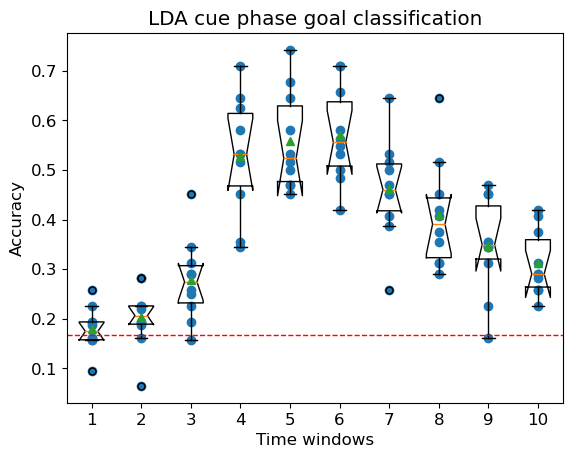

In [41]:
plt.figure()
plt.title(f'LDA cue phase goal classification')
for k in range(num_timebins):
    plt.scatter(np.ones_like(lda_goal_accuracy_cue_timebins[k,:]) + k, lda_goal_accuracy_cue_timebins[k,:], color='C0')
plt.boxplot(lda_goal_accuracy_cue_timebins.T, showmeans=True, notch=True, flierprops={'marker': 'o', 'markersize': 5})
# plt.violinplot(lda_accuracy_cue, showextrema=False)
plt.axhline(y=1/6, color='r', linewidth=1, linestyle='--')
plt.xlabel('Time windows')
plt.ylabel('Accuracy')

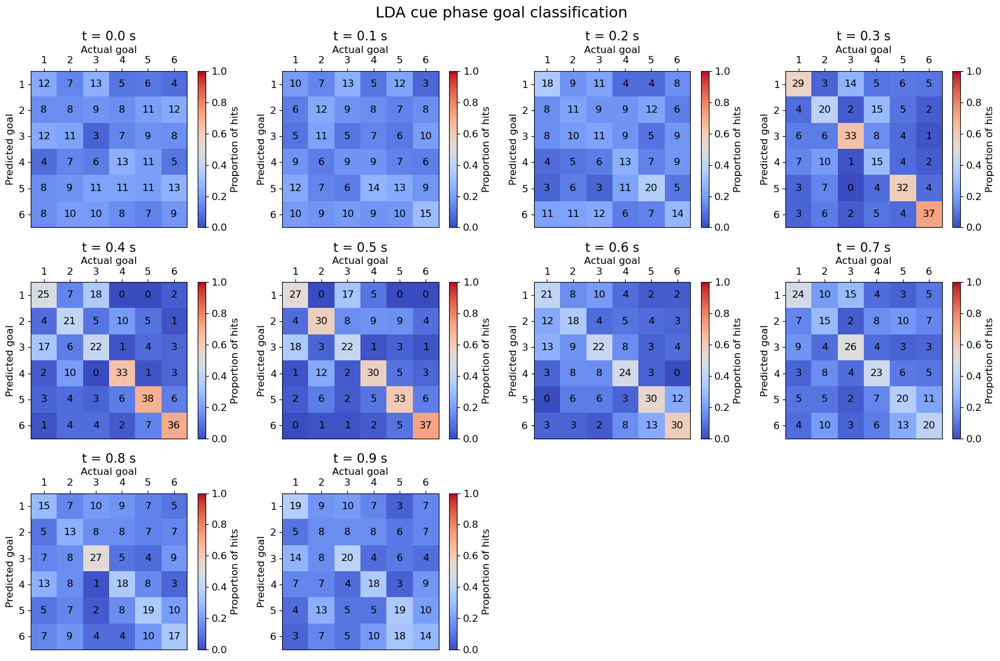

In [42]:
fig = plt.figure(figsize=(20, 12))
plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1, wspace=0.2, hspace=0.35)
plt.suptitle('LDA cue phase goal classification', y=0.99, fontsize=18)

for i in range(num_timebins):
    conf_mat = lda_goal_confusion_cue_timebins[i,:,:]
    num_cats = conf_mat.shape[0]
    col_sums = np.sum(conf_mat, axis=0)
    conf_mat_prop = np.empty_like(conf_mat)
    for col, val in enumerate(col_sums):
        conf_mat_prop[:,col] = conf_mat[:,col] / val
    conf_mat_prop = np.nan_to_num(conf_mat_prop)

    ax = fig.add_subplot(3, 4, i+1)
    ax.set_title(f't = {0.1*i:.1f} s', fontsize=15)
    im = ax.imshow(conf_mat_prop, cmap='coolwarm', vmin=0, vmax=1)
    cbar = plt.colorbar(im, ax=ax, label='Proportion of hits')

    ax.set_xticks(np.arange(num_cats), labels=list(range(1, num_cats+1)))
    ax.set_yticks(np.arange(num_cats), labels=list(range(1, num_cats+1)))
    ax.tick_params(top=True, labeltop=True, bottom=False, labelbottom=False)
    ax.set_xlabel('Actual goal')
    ax.set_ylabel('Predicted goal')
    ax.xaxis.set_label_position('top')

    for i, row in enumerate(conf_mat):
        for j, val in enumerate(row):
            ax.text(j, i, f'{val:.0f}', ha='center', va='center', color='k')

Text(0, 0.5, 'Accuracy')

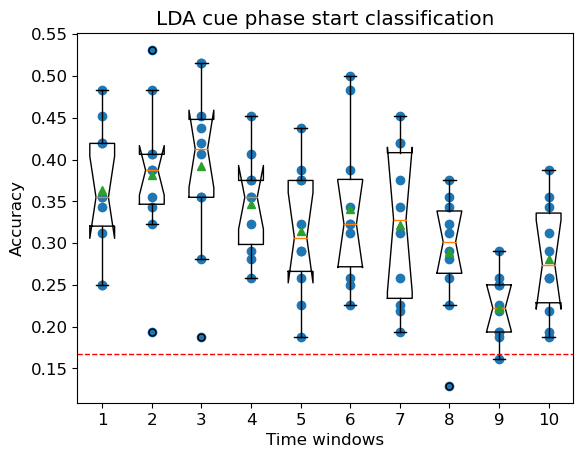

In [43]:
plt.figure()
plt.title(f'LDA cue phase start classification')
for k in range(num_timebins):
    plt.scatter(np.ones_like(lda_start_accuracy_cue_timebins[k,:]) + k, lda_start_accuracy_cue_timebins[k,:], color='C0')
plt.boxplot(lda_start_accuracy_cue_timebins.T, showmeans=True, notch=True, flierprops={'marker': 'o', 'markersize': 5})
# plt.violinplot(lda_accuracy_cue, showextrema=False)
plt.axhline(y=1/6, color='r', linewidth=1, linestyle='--')
plt.xlabel('Time windows')
plt.ylabel('Accuracy')

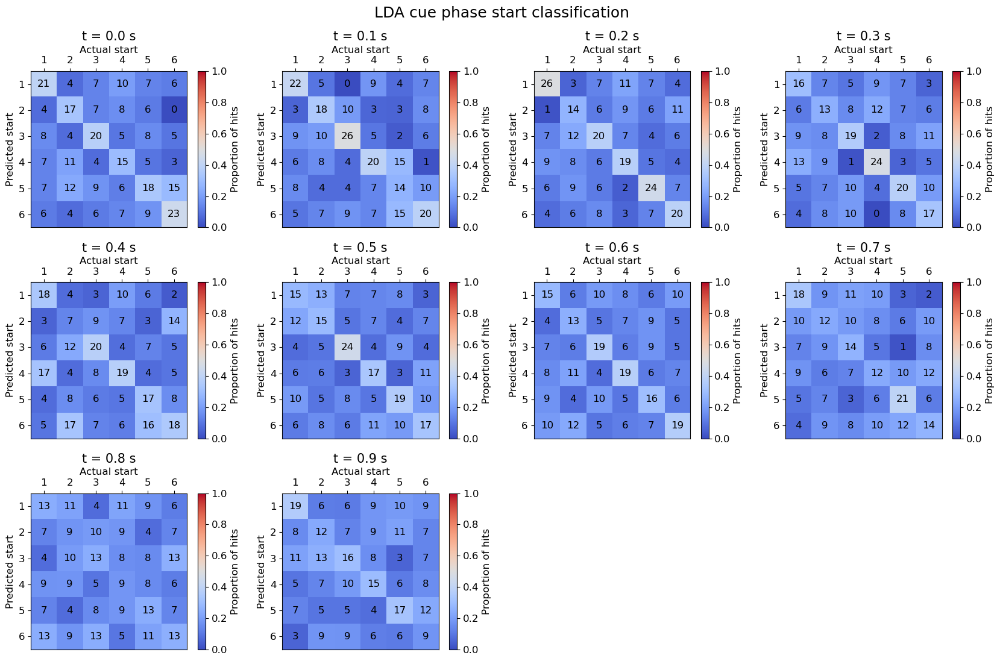

In [44]:
fig = plt.figure(figsize=(20, 12))
plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1, wspace=0.2, hspace=0.35)
plt.suptitle('LDA cue phase start classification', y=0.99, fontsize=18)

for i in range(num_timebins):
    conf_mat = lda_start_confusion_cue_timebins[i,:,:]
    num_cats = conf_mat.shape[0]
    col_sums = np.sum(conf_mat, axis=0)
    conf_mat_prop = np.empty_like(conf_mat)
    for col, val in enumerate(col_sums):
        conf_mat_prop[:,col] = conf_mat[:,col] / val
    conf_mat_prop = np.nan_to_num(conf_mat_prop)

    ax = fig.add_subplot(3, 4, i+1)
    ax.set_title(f't = {0.1*i:.1f} s', fontsize=15)
    im = ax.imshow(conf_mat_prop, cmap='coolwarm', vmin=0, vmax=1)
    cbar = plt.colorbar(im, ax=ax, label='Proportion of hits')

    ax.set_xticks(np.arange(num_cats), labels=list(range(1, num_cats+1)))
    ax.set_yticks(np.arange(num_cats), labels=list(range(1, num_cats+1)))
    ax.tick_params(top=True, labeltop=True, bottom=False, labelbottom=False)
    ax.set_xlabel('Actual start')
    ax.set_ylabel('Predicted start')
    ax.xaxis.set_label_position('top')

    for i, row in enumerate(conf_mat):
        for j, val in enumerate(row):
            ax.text(j, i, f'{val:.0f}', ha='center', va='center', color='k')

Text(0, 0.5, 'Accuracy')

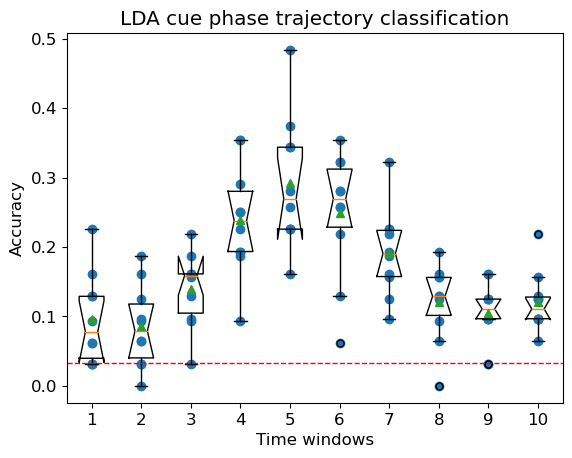

In [45]:
plt.figure()
plt.title(f'LDA cue phase trajectory classification')
for k in range(num_timebins):
    plt.scatter(np.ones_like(lda_traj_accuracy_cue_timebins[k,:]) + k, lda_traj_accuracy_cue_timebins[k,:], color='C0')
plt.boxplot(lda_traj_accuracy_cue_timebins.T, showmeans=True, notch=True, flierprops={'marker': 'o', 'markersize': 5})
# plt.violinplot(lda_accuracy_cue, showextrema=False)
plt.axhline(y=1/30, color='r', linewidth=1, linestyle='--')
plt.xlabel('Time windows')
plt.ylabel('Accuracy')

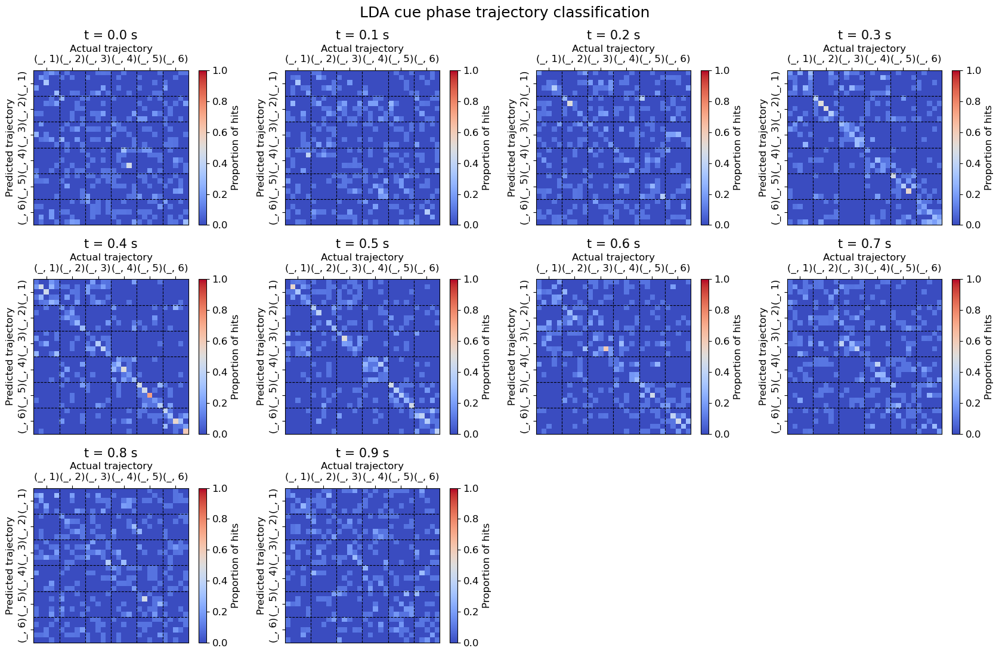

In [46]:
fig = plt.figure(figsize=(20, 12))
plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1, wspace=0.25, hspace=0.35)
plt.suptitle('LDA cue phase trajectory classification', y=0.99, fontsize=18)

for i in range(num_timebins):
    conf_mat = lda_traj_confusion_cue_timebins[i,:,:]
    num_cats = conf_mat.shape[0]
    col_sums = np.sum(conf_mat, axis=0)
    conf_mat_prop = np.empty_like(conf_mat)
    for col, val in enumerate(col_sums):
        conf_mat_prop[:,col] = conf_mat[:,col] / val
    conf_mat_prop = np.nan_to_num(conf_mat_prop)

    ax = fig.add_subplot(3, 4, i+1)
    ax.set_title(f't = {0.1*i:.1f} s', fontsize=15)
    im = ax.imshow(conf_mat_prop, cmap='coolwarm', vmin=0, vmax=1)
    cbar = plt.colorbar(im, ax=ax, label='Proportion of hits')

    ax.set_xticks(np.arange(2, num_cats, num_goals-1), labels=[f'(_, {i})' for i in range(1, num_goals+1)], fontsize=12)
    ax.set_yticks(np.arange(2, num_cats, num_goals-1), labels=[f'(_, {i})' for i in range(1, num_goals+1)], fontsize=12, rotation=90, va='center')
    # ax.set_xticks([])
    # ax.set_yticks([])
    ax.tick_params(top=True, labeltop=True, bottom=False, labelbottom=False)
    ax.set_xlabel('Actual trajectory')
    ax.set_ylabel('Predicted trajectory')
    ax.xaxis.set_label_position('top')

    for j in range(1, num_goals):
        ax.axhline(y=5*j-0.5, color='k', linewidth=0.8, linestyle='--')
        ax.axvline(x=5*j-0.5, color='k', linewidth=0.8, linestyle='--')

    # for i, row in enumerate(conf_mat):
    #     for j, val in enumerate(row):
    #         ax.text(j, i, f'{val:.0f}', ha='center', va='center', color='k')

Text(0.5, 0, 'Time windows')

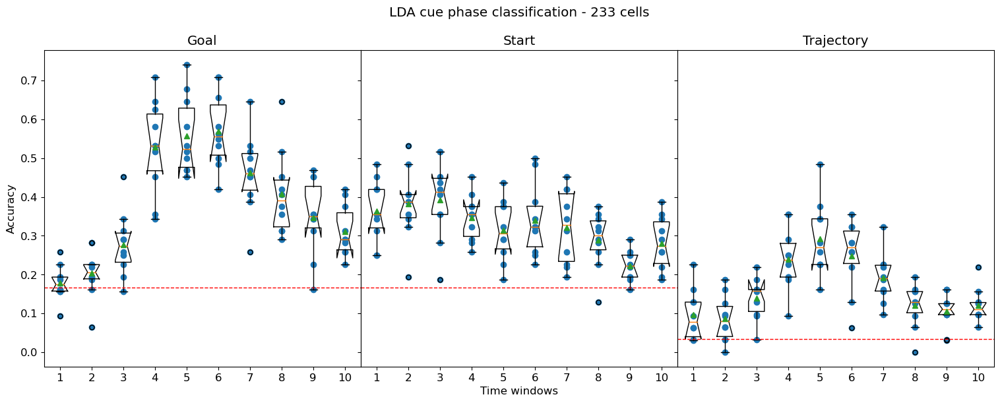

In [47]:
# Plot cross-temporal decoding accuracies for cue, hint and nav end models in a single plot
fig, axes = plt.subplots(1, 3, figsize=(18, 6), sharey=True)
plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1, wspace=0, hspace=0.1)
plt.suptitle(f'LDA cue phase classification - {popl_name}', y=1.01)
model_names = ['Goal', 'Start', 'Trajectory']

for k, accuracies in enumerate([lda_goal_accuracy_cue_timebins, lda_start_accuracy_cue_timebins, lda_traj_accuracy_cue_timebins]):
    axes[k].set_title(f'{model_names[k]}')
    for t in range(num_timebins):
        axes[k].scatter(np.ones_like(accuracies[t,:]) + t, accuracies[t,:], color='C0')
    axes[k].boxplot(accuracies.T, showmeans=True, notch=True, flierprops={'marker': 'o', 'markersize': 5})
    # axes[k].violinplot(accuracies, showextrema=False)
axes[0].axhline(y=1/6, color='r', linewidth=1, linestyle='--')
axes[1].axhline(y=1/6, color='r', linewidth=1, linestyle='--')
axes[2].axhline(y=1/30, color='r', linewidth=1, linestyle='--')
axes[0].set_ylabel('Accuracy')
axes[1].set_xlabel('Time windows')

Text(0, 0.5, 'Accuracy')

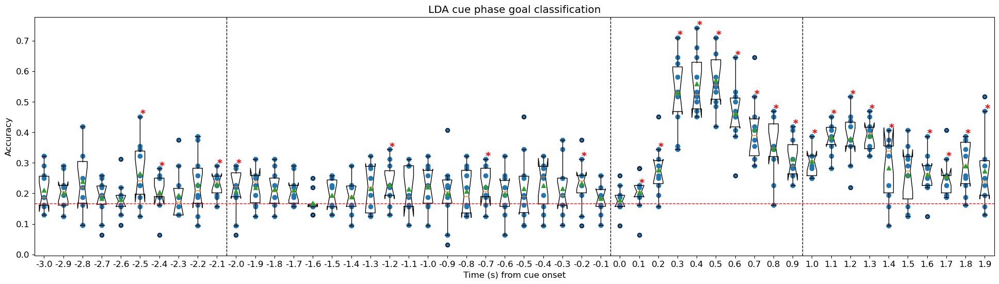

In [48]:
plt.figure(figsize=(24, 6))
plt.title(f'LDA cue phase goal classification')
bp = plt.boxplot(lda_goal_accuracy_iti_cue_timebins.T, showmeans=True, notch=True, flierprops={'marker': 'o', 'markersize': 5})
# plt.violinplot(lda_accuracy_cue, showextrema=False)
topcaps = [cap.get_ydata()[0] for i, cap in enumerate(bp['caps']) if i%2==1]
for k in range(num_timebins_ext):
    plt.scatter(np.ones_like(lda_goal_accuracy_iti_cue_timebins[k,:]) + k, lda_goal_accuracy_iti_cue_timebins[k,:], color='C0')
    p_val = lda_goal_sigtest_iti_cue_timebins[k,1]
    if p_val < sig_lvl:
        plt.annotate('*', xy=(k+1, topcaps[k]), xytext=(k+1, topcaps[k]), fontsize=14, fontweight='bold', color='r')
plt.axhline(y=1/6, color='r', linewidth=1, linestyle='--')
plt.axvline(x=10.5, color='k', linewidth=1, linestyle='--')
plt.axvline(x=30.5, color='k', linewidth=1, linestyle='--')
plt.axvline(x=40.5, color='k', linewidth=1, linestyle='--')
plt.xticks(np.arange(1, num_timebins_ext+1), labels=[f'{n:.1f}' for n in np.concatenate([np.arange(-3, 0, 0.1), np.arange(0, 2, 0.1)])])
plt.xlabel('Time (s) from cue onset')
plt.ylabel('Accuracy')

Text(0, 0.5, 'Accuracy')

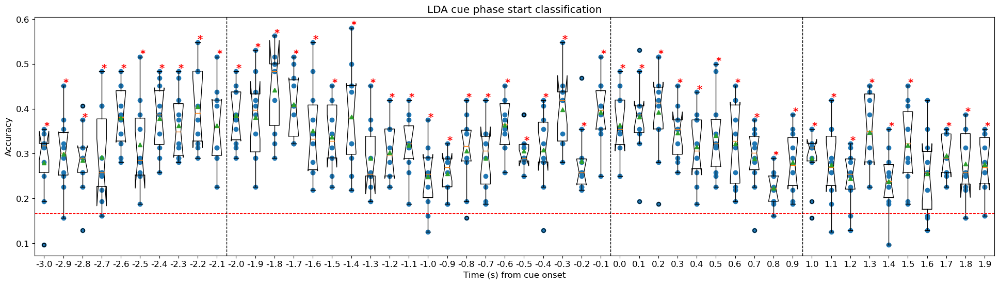

In [131]:
plt.figure(figsize=(24, 6))
plt.title(f'LDA cue phase start classification')
bp = plt.boxplot(lda_start_accuracy_iti_cue_timebins.T, showmeans=True, notch=True, flierprops={'marker': 'o', 'markersize': 5})
# plt.violinplot(lda_accuracy_cue, showextrema=False)
topcaps = [cap.get_ydata()[0] for i, cap in enumerate(bp['caps']) if i%2==1]
for k in range(num_timebins_ext):
    plt.scatter(np.ones_like(lda_start_accuracy_iti_cue_timebins[k,:]) + k, lda_start_accuracy_iti_cue_timebins[k,:], color='C0')
    p_val = lda_start_sigtest_iti_cue_timebins[k,1]
    if p_val < sig_lvl:
        plt.annotate('*', xy=(k+1, topcaps[k]), xytext=(k+1, topcaps[k]), fontsize=14, fontweight='bold', color='r')
plt.axhline(y=1/6, color='r', linewidth=1, linestyle='--')
plt.axvline(x=10.5, color='k', linewidth=1, linestyle='--')
plt.axvline(x=30.5, color='k', linewidth=1, linestyle='--')
plt.axvline(x=40.5, color='k', linewidth=1, linestyle='--')
plt.xticks(np.arange(1, num_timebins_ext+1), labels=[f'{n:.1f}' for n in np.concatenate([np.arange(-3, 0, 0.1), np.arange(0, 2, 0.1)])])
plt.xlabel('Time (s) from cue onset')
plt.ylabel('Accuracy')

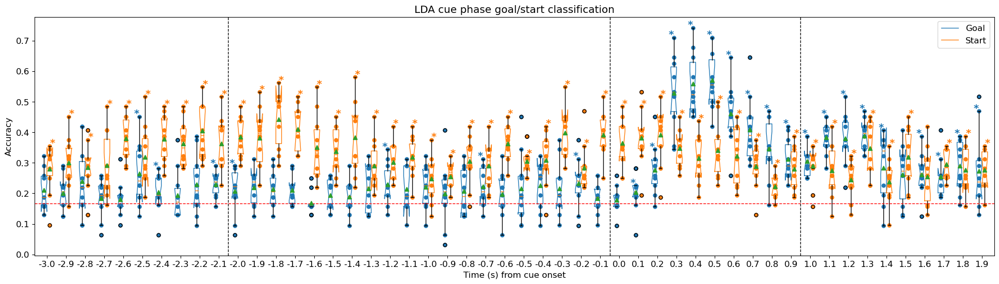

In [132]:
plt.figure(figsize=(24, 6))
plt.title(f'LDA cue phase goal/start classification')

# Plot as series of boxplots
bar_width = 0.3
bp1 = plt.boxplot(lda_goal_accuracy_iti_cue_timebins.T, positions=np.arange(1, num_timebins_ext+1)-bar_width/2, widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C0'}, flierprops={'marker': 'o', 'markersize': 5})
bp2 = plt.boxplot(lda_start_accuracy_iti_cue_timebins.T, positions=np.arange(1, num_timebins_ext+1)+bar_width/2, widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C1'}, flierprops={'marker': 'o', 'markersize': 5})
topcaps1 = [cap.get_ydata()[0] for i, cap in enumerate(bp1['caps']) if i%2==1]
topcaps2 = [cap.get_ydata()[0] for i, cap in enumerate(bp2['caps']) if i%2==1]
for k in range(num_timebins_ext):
    plt.scatter(np.ones_like(lda_goal_accuracy_iti_cue_timebins[k,:]) + k - bar_width/2, lda_goal_accuracy_iti_cue_timebins[k,:], s=25, color='C0')
    p_val = lda_goal_sigtest_iti_cue_timebins[k,1]
    if p_val < sig_lvl:
        plt.annotate('*', xy=(k+1-bar_width/2, topcaps1[k]), xytext=(k+1-bar_width/2, topcaps1[k]), horizontalalignment='right', fontsize=14, fontweight='bold', color='C0')
    plt.scatter(np.ones_like(lda_start_accuracy_iti_cue_timebins[k,:]) + k + bar_width/2, lda_start_accuracy_iti_cue_timebins[k,:], s=25, color='C1')
    p_val = lda_start_sigtest_iti_cue_timebins[k,1]
    if p_val < sig_lvl:
        plt.annotate('*', xy=(k+1+bar_width/2, topcaps2[k]), xytext=(k+1+bar_width/2, topcaps2[k]), fontsize=14, fontweight='bold', color='C1')

# for box in bp1['boxes']:
#     box.set_facecolor('C0')
# for box in bp2['boxes']:
#     box.set_facecolor('C0')

# Plot as series of bars
# plt.bar(np.arange(1, num_timebins_ext+1)-bar_width/2, np.mean(lda_goal_accuracy_iti_cue_timebins, axis=1), width=bar_width, color='C0', label='Trajectory')
# plt.bar(np.arange(1, num_timebins_ext+1)+bar_width/2, np.mean(lda_start_accuracy_iti_cue_timebins, axis=1), width=bar_width, color='C1', label='Start + Goal')

# Plot as line
# plt.plot(np.arange(1, num_timebins_ext+1)-bar_width/2, np.mean(lda_goal_accuracy_iti_cue_timebins, axis=1), '-', color='C0', label='Trajectory')
# plt.plot(np.arange(1, num_timebins_ext+1)+bar_width/2, np.mean(lda_start_accuracy_iti_cue_timebins, axis=1), '-', color='C1', label='Start + Goal')

plt.axhline(y=1/6, color='r', linewidth=1, linestyle='--')
plt.axvline(x=10.5, color='k', linewidth=1, linestyle='--')
plt.axvline(x=30.5, color='k', linewidth=1, linestyle='--')
plt.axvline(x=40.5, color='k', linewidth=1, linestyle='--')
plt.xticks(np.arange(1, num_timebins_ext+1), labels=[f'{n:.1f}' for n in np.concatenate([np.arange(-3, 0, 0.1), np.arange(0, 2, 0.1)])])
plt.xlabel('Time (s) from cue onset')
plt.ylabel('Accuracy')
plt.legend([bp1['boxes'][0], bp2['boxes'][0]], ['Goal', 'Start'])

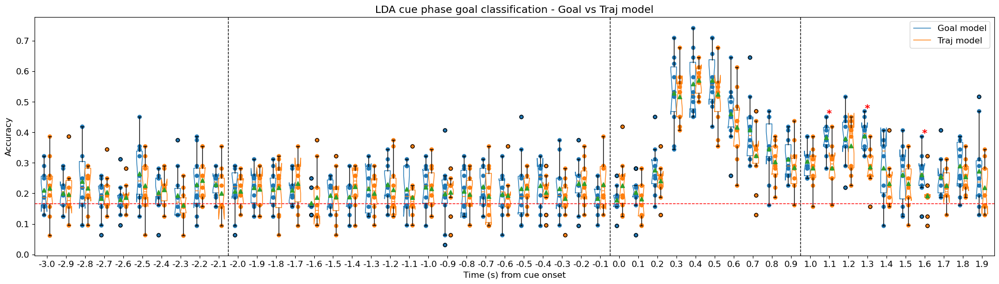

In [133]:
plt.figure(figsize=(24, 6))
plt.title(f'LDA cue phase goal classification - Goal vs Traj model')

bar_width = 0.3
bp1 = plt.boxplot(lda_goal_accuracy_iti_cue_timebins.T, positions=np.arange(1, num_timebins_ext+1)-bar_width/2, widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C0'}, flierprops={'marker': 'o', 'markersize': 5})
bp2 = plt.boxplot(lda_trajgoal_accuracy_iti_cue_timebins.T, positions=np.arange(1, num_timebins_ext+1)+bar_width/2, widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C1'}, flierprops={'marker': 'o', 'markersize': 5})
topcaps1 = [cap.get_ydata()[0] for i, cap in enumerate(bp1['caps']) if i%2==1]
topcaps2 = [cap.get_ydata()[0] for i, cap in enumerate(bp2['caps']) if i%2==1]
topcaps = [max(cap1, cap2) for cap1, cap2 in zip(topcaps1, topcaps2)]
for k in range(num_timebins_ext):
    plt.scatter(np.ones_like(lda_goal_accuracy_iti_cue_timebins[k,:]) + k - bar_width/2, lda_goal_accuracy_iti_cue_timebins[k,:], s=25, color='C0')
    plt.scatter(np.ones_like(lda_trajgoal_accuracy_iti_cue_timebins[k,:]) + k + bar_width/2, lda_trajgoal_accuracy_iti_cue_timebins[k,:], s=25, color='C1')
    p_val = lda_trajgoal_sigcomp_iti_cue_timebins[k,1]
    if p_val < sig_lvl:
        plt.annotate('*', xy=(k+1+bar_width/2, topcaps[k]), xytext=(k+1, topcaps[k]), horizontalalignment='center', fontsize=14, fontweight='bold', color='r')

plt.axhline(y=1/6, color='r', linewidth=1, linestyle='--')
plt.axvline(x=10.5, color='k', linewidth=1, linestyle='--')
plt.axvline(x=30.5, color='k', linewidth=1, linestyle='--')
plt.axvline(x=40.5, color='k', linewidth=1, linestyle='--')
plt.xticks(np.arange(1, num_timebins_ext+1), labels=[f'{n:.1f}' for n in np.concatenate([np.arange(-3, 0, 0.1), np.arange(0, 2, 0.1)])])
plt.xlabel('Time (s) from cue onset')
plt.ylabel('Accuracy')
plt.legend([bp1['boxes'][0], bp2['boxes'][0]], ['Goal model', 'Traj model'])

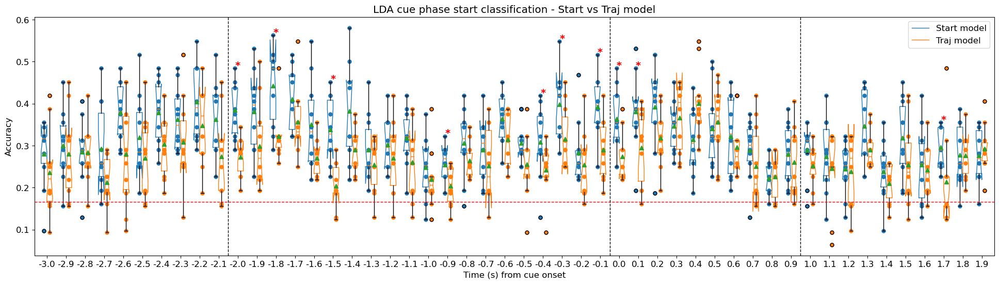

In [134]:
plt.figure(figsize=(24, 6))
plt.title(f'LDA cue phase start classification - Start vs Traj model')

bar_width = 0.3
bp1 = plt.boxplot(lda_start_accuracy_iti_cue_timebins.T, positions=np.arange(1, num_timebins_ext+1)-bar_width/2, widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C0'}, flierprops={'marker': 'o', 'markersize': 5})
bp2 = plt.boxplot(lda_trajstart_accuracy_iti_cue_timebins.T, positions=np.arange(1, num_timebins_ext+1)+bar_width/2, widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C1'}, flierprops={'marker': 'o', 'markersize': 5})
topcaps1 = [cap.get_ydata()[0] for i, cap in enumerate(bp1['caps']) if i%2==1]
topcaps2 = [cap.get_ydata()[0] for i, cap in enumerate(bp2['caps']) if i%2==1]
topcaps = [max(cap1, cap2) for cap1, cap2 in zip(topcaps1, topcaps2)]
for k in range(num_timebins_ext):
    plt.scatter(np.ones_like(lda_start_accuracy_iti_cue_timebins[k,:]) + k - bar_width/2, lda_start_accuracy_iti_cue_timebins[k,:], s=25, color='C0')
    plt.scatter(np.ones_like(lda_trajstart_accuracy_iti_cue_timebins[k,:]) + k + bar_width/2, lda_trajstart_accuracy_iti_cue_timebins[k,:], s=25, color='C1')
    p_val = lda_trajstart_sigcomp_iti_cue_timebins[k,1]
    if p_val < sig_lvl:
        plt.annotate('*', xy=(k+1+bar_width/2, topcaps[k]), xytext=(k+1, topcaps[k]), horizontalalignment='center', fontsize=14, fontweight='bold', color='r')

plt.axhline(y=1/6, color='r', linewidth=1, linestyle='--')
plt.axvline(x=10.5, color='k', linewidth=1, linestyle='--')
plt.axvline(x=30.5, color='k', linewidth=1, linestyle='--')
plt.axvline(x=40.5, color='k', linewidth=1, linestyle='--')
plt.xticks(np.arange(1, num_timebins_ext+1), labels=[f'{n:.1f}' for n in np.concatenate([np.arange(-3, 0, 0.1), np.arange(0, 2, 0.1)])])
plt.xlabel('Time (s) from cue onset')
plt.ylabel('Accuracy')
plt.legend([bp1['boxes'][0], bp2['boxes'][0]], ['Start model', 'Traj model'])

Text(0, 0.5, 'Accuracy')

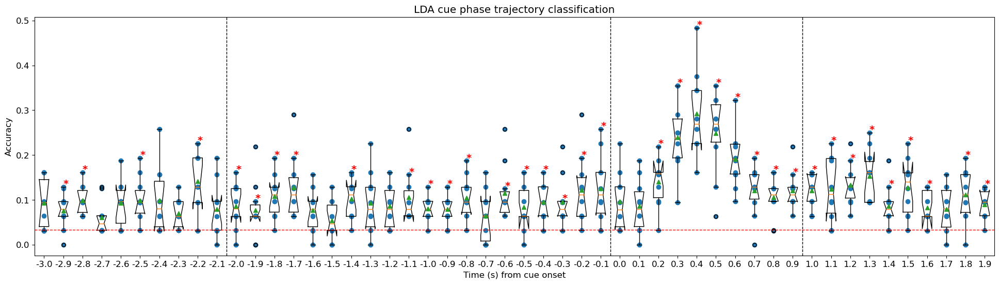

In [135]:
plt.figure(figsize=(24, 6))
plt.title(f'LDA cue phase trajectory classification')
bp = plt.boxplot(lda_traj_accuracy_iti_cue_timebins.T, showmeans=True, notch=True, flierprops={'marker': 'o', 'markersize': 5})
# plt.violinplot(lda_accuracy_cue, showextrema=False)
topcaps = [cap.get_ydata()[0] for i, cap in enumerate(bp['caps']) if i%2==1]
for k in range(num_timebins_ext):
    plt.scatter(np.ones_like(lda_traj_accuracy_iti_cue_timebins[k,:]) + k, lda_traj_accuracy_iti_cue_timebins[k,:], color='C0')
    p_val = lda_traj_sigtest_iti_cue_timebins[k,1]
    if p_val < sig_lvl:
        plt.annotate('*', xy=(k+1, topcaps[k]), xytext=(k+1, topcaps[k]), fontsize=14, fontweight='bold', color='r')
plt.axhline(y=1/30, color='r', linewidth=1, linestyle='--')
plt.axvline(x=10.5, color='k', linewidth=1, linestyle='--')
plt.axvline(x=30.5, color='k', linewidth=1, linestyle='--')
plt.axvline(x=40.5, color='k', linewidth=1, linestyle='--')
plt.xticks(np.arange(1, num_timebins_ext+1), labels=[f'{n:.1f}' for n in np.concatenate([np.arange(-3, 0, 0.1), np.arange(0, 2, 0.1)])])
plt.xlabel('Time (s) from cue onset')
plt.ylabel('Accuracy')

Text(0, 0.5, 'Accuracy')

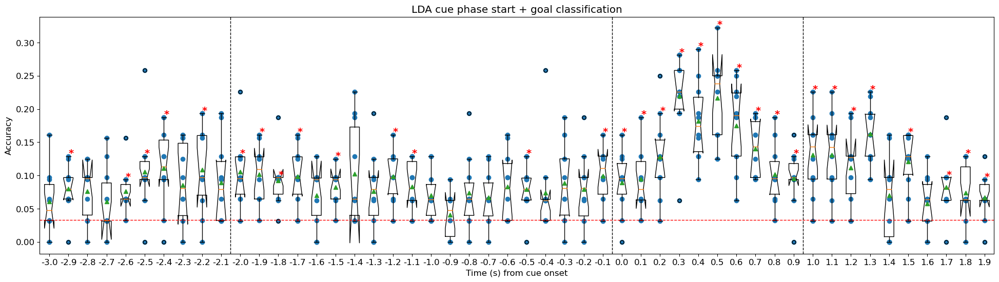

In [136]:
plt.figure(figsize=(24, 6))
plt.title(f'LDA cue phase start + goal classification')
bp = plt.boxplot(lda_startgoal_accuracy_iti_cue_timebins.T, showmeans=True, notch=True, flierprops={'marker': 'o', 'markersize': 5})
# plt.violinplot(lda_accuracy_cue, showextrema=False)
topcaps = [cap.get_ydata()[0] for i, cap in enumerate(bp['caps']) if i%2==1]
for k in range(num_timebins_ext):
    plt.scatter(np.ones_like(lda_startgoal_accuracy_iti_cue_timebins[k,:]) + k, lda_startgoal_accuracy_iti_cue_timebins[k,:], color='C0')
    p_val = lda_startgoal_sigtest_iti_cue_timebins[k,1]
    if p_val < sig_lvl:
        plt.annotate('*', xy=(k+1, topcaps[k]), xytext=(k+1, topcaps[k]), fontsize=14, fontweight='bold', color='r')
plt.axhline(y=1/30, color='r', linewidth=1, linestyle='--')
plt.axvline(x=10.5, color='k', linewidth=1, linestyle='--')
plt.axvline(x=30.5, color='k', linewidth=1, linestyle='--')
plt.axvline(x=40.5, color='k', linewidth=1, linestyle='--')
plt.xticks(np.arange(1, num_timebins_ext+1), labels=[f'{n:.1f}' for n in np.concatenate([np.arange(-3, 0, 0.1), np.arange(0, 2, 0.1)])])
plt.xlabel('Time (s) from cue onset')
plt.ylabel('Accuracy')

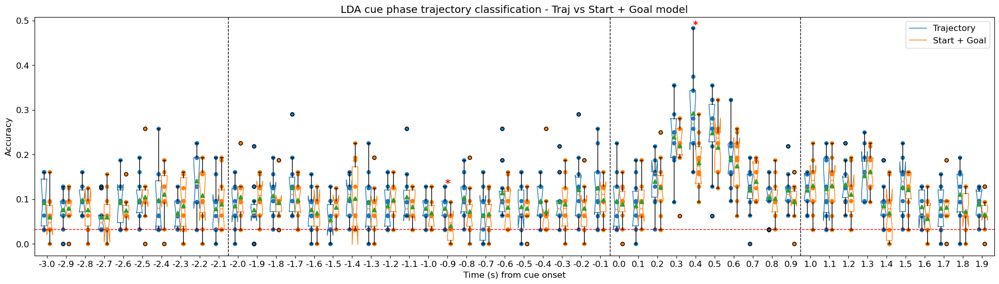

In [137]:
plt.figure(figsize=(24, 6))
plt.title(f'LDA cue phase trajectory classification - Traj vs Start + Goal model')

# Plot as series of boxplots
bar_width = 0.3
bp1 = plt.boxplot(lda_traj_accuracy_iti_cue_timebins.T, positions=np.arange(1, num_timebins_ext+1)-bar_width/2, widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C0'}, flierprops={'marker': 'o', 'markersize': 5})
bp2 = plt.boxplot(lda_startgoal_accuracy_iti_cue_timebins.T, positions=np.arange(1, num_timebins_ext+1)+bar_width/2, widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C1'}, flierprops={'marker': 'o', 'markersize': 5})
topcaps1 = [cap.get_ydata()[0] for i, cap in enumerate(bp1['caps']) if i%2==1]
topcaps2 = [cap.get_ydata()[0] for i, cap in enumerate(bp2['caps']) if i%2==1]
topcaps = [max(cap1, cap2) for cap1, cap2 in zip(topcaps1, topcaps2)]
for k in range(num_timebins_ext):
    plt.scatter(np.ones_like(lda_traj_accuracy_iti_cue_timebins[k,:]) + k - bar_width/2, lda_traj_accuracy_iti_cue_timebins[k,:], s=25, color='C0')
    plt.scatter(np.ones_like(lda_startgoal_accuracy_iti_cue_timebins[k,:]) + k + bar_width/2, lda_startgoal_accuracy_iti_cue_timebins[k,:], s=25, color='C1')
    p_val = lda_startgoal_sigcomp_iti_cue_timebins[k,1]
    if p_val < sig_lvl:
        plt.annotate('*', xy=(k+1+bar_width/2, topcaps[k]), xytext=(k+1, topcaps[k]), horizontalalignment='center', fontsize=14, fontweight='bold', color='r')

# for box in bp1['boxes']:
#     box.set_facecolor('C0')
# for box in bp2['boxes']:
#     box.set_facecolor('C0')

# Plot as series of bars
# plt.bar(np.arange(1, num_timebins_ext+1)-bar_width/2, np.mean(lda_traj_accuracy_iti_cue_timebins, axis=1), width=bar_width, color='C0', label='Trajectory')
# plt.bar(np.arange(1, num_timebins_ext+1)+bar_width/2, np.mean(lda_startgoal_accuracy_iti_cue_timebins, axis=1), width=bar_width, color='C1', label='Start + Goal')

# Plot as line
# plt.plot(np.arange(1, num_timebins_ext+1)-bar_width/2, np.mean(lda_traj_accuracy_iti_cue_timebins, axis=1), '-', color='C0', label='Trajectory')
# plt.plot(np.arange(1, num_timebins_ext+1)+bar_width/2, np.mean(lda_startgoal_accuracy_iti_cue_timebins, axis=1), '-', color='C1', label='Start + Goal')

plt.axhline(y=1/30, color='r', linewidth=1, linestyle='--')
plt.axvline(x=10.5, color='k', linewidth=1, linestyle='--')
plt.axvline(x=30.5, color='k', linewidth=1, linestyle='--')
plt.axvline(x=40.5, color='k', linewidth=1, linestyle='--')
plt.xticks(np.arange(1, num_timebins_ext+1), labels=[f'{n:.1f}' for n in np.concatenate([np.arange(-3, 0, 0.1), np.arange(0, 2, 0.1)])])
plt.xlabel('Time (s) from cue onset')
plt.ylabel('Accuracy')
plt.legend([bp1['boxes'][0], bp2['boxes'][0]], ['Trajectory', 'Start + Goal'])

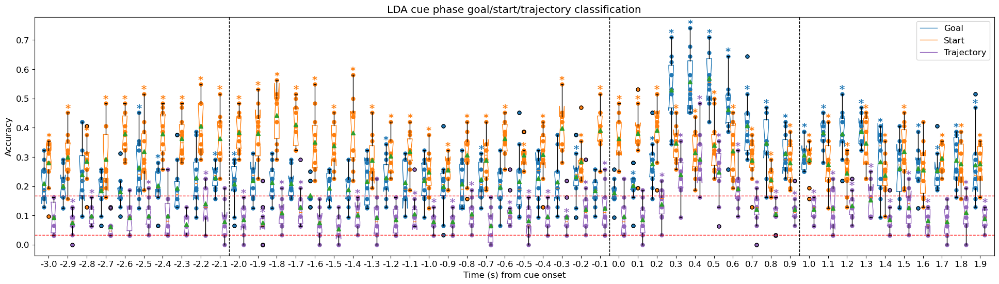

In [138]:
plt.figure(figsize=(24, 6))
plt.title(f'LDA cue phase goal/start/trajectory classification')

# Plot as series of boxplots
bar_width = 0.25
bp1 = plt.boxplot(lda_goal_accuracy_iti_cue_timebins.T, positions=np.arange(1, num_timebins_ext+1)-bar_width, widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C0'}, flierprops={'marker': 'o', 'markersize': 5})
bp2 = plt.boxplot(lda_start_accuracy_iti_cue_timebins.T, positions=np.arange(1, num_timebins_ext+1), widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C1'}, flierprops={'marker': 'o', 'markersize': 5})
bp3 = plt.boxplot(lda_traj_accuracy_iti_cue_timebins.T, positions=np.arange(1, num_timebins_ext+1)+bar_width, widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C4'}, flierprops={'marker': 'o', 'markersize': 5})
topcaps1 = [cap.get_ydata()[0] for i, cap in enumerate(bp1['caps']) if i%2==1]
topcaps2 = [cap.get_ydata()[0] for i, cap in enumerate(bp2['caps']) if i%2==1]
topcaps3 = [cap.get_ydata()[0] for i, cap in enumerate(bp3['caps']) if i%2==1]
for k in range(num_timebins_ext):
    plt.scatter(np.ones_like(lda_goal_accuracy_iti_cue_timebins[k,:]) + k - bar_width, lda_goal_accuracy_iti_cue_timebins[k,:], s=25, color='C0')
    p_val = lda_goal_sigtest_iti_cue_timebins[k,1]
    if p_val < sig_lvl:
        plt.annotate('*', xy=(k+1-bar_width/2, topcaps1[k]+0.005), xytext=(k+1-bar_width, topcaps1[k]+0.005), horizontalalignment='center', fontsize=14, fontweight='bold', color='C0')
    plt.scatter(np.ones_like(lda_start_accuracy_iti_cue_timebins[k,:]) + k, lda_start_accuracy_iti_cue_timebins[k,:], s=25, color='C1')
    p_val = lda_start_sigtest_iti_cue_timebins[k,1]
    if p_val < sig_lvl:
        plt.annotate('*', xy=(k+1+bar_width/2, topcaps2[k]+0.005), xytext=(k+1, topcaps2[k]+0.005), horizontalalignment='center', fontsize=14, fontweight='bold', color='C1')
    plt.scatter(np.ones_like(lda_traj_accuracy_iti_cue_timebins[k,:]) + k + bar_width, lda_traj_accuracy_iti_cue_timebins[k,:], s=25, color='C4')
    p_val = lda_traj_sigtest_iti_cue_timebins[k,1]
    if p_val < sig_lvl:
        plt.annotate('*', xy=(k+1+bar_width/2, topcaps3[k]+0.005), xytext=(k+1+bar_width, topcaps3[k]+0.005), horizontalalignment='center', fontsize=14, fontweight='bold', color='C4')

plt.axhline(y=1/6, color='r', linewidth=1, linestyle='--')
plt.axhline(y=1/30, color='r', linewidth=1, linestyle='--')
plt.axvline(x=10.5, color='k', linewidth=1, linestyle='--')
plt.axvline(x=30.5, color='k', linewidth=1, linestyle='--')
plt.axvline(x=40.5, color='k', linewidth=1, linestyle='--')
plt.xticks(np.arange(1, num_timebins_ext+1), labels=[f'{n:.1f}' for n in np.concatenate([np.arange(-3, 0, 0.1), np.arange(0, 2, 0.1)])])
plt.xlabel('Time (s) from cue onset')
plt.ylabel('Accuracy')
plt.legend([bp1['boxes'][0], bp2['boxes'][0], bp3['boxes'][0]], ['Goal', 'Start', 'Trajectory'])

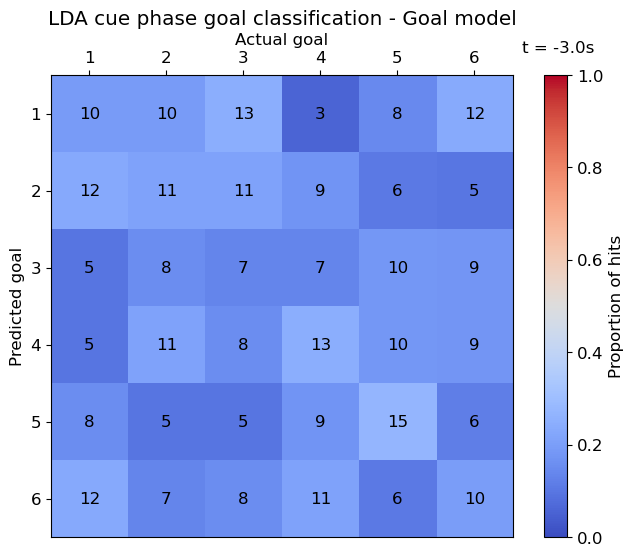

In [139]:
fig, ax = plt.subplots(figsize=(8, 6))
plt.title('LDA cue phase goal classification - Goal model')

conf_mat_prop = confusion_heatmap(lda_goal_confusion_iti_cue_timebins[0,:,:])
im = ax.imshow(conf_mat_prop, cmap='coolwarm', vmin=0, vmax=1)
cbar = plt.colorbar(im, ax=ax, label='Proportion of hits')

ax.set_xticks(np.arange(num_goals), labels=list(range(1, num_goals+1)))
ax.set_yticks(np.arange(num_goals), labels=list(range(1, num_goals+1)))
ax.tick_params(top=True, labeltop=True, bottom=False, labelbottom=False)
ax.set_xlabel('Actual goal')
ax.set_ylabel('Predicted goal')
ax.xaxis.set_label_position('top')

text_labels = dict()
for i, row in enumerate(lda_goal_confusion_iti_cue_timebins[0,:,:]):
    for j, val in enumerate(row):
        text_labels[(j, i)] = ax.text(j, i, f'{val:.0f}', ha='center', va='center', color='k')
tstamp = ax.text(1.02, 1.05, '', transform=ax.transAxes)

def update(frame):
    conf_mat_prop = confusion_heatmap(lda_goal_confusion_iti_cue_timebins[frame,:,:])
    im.set_array(conf_mat_prop)
    for i, row in enumerate(lda_goal_confusion_iti_cue_timebins[frame,:,:]):
        for j, val in enumerate(row):
            text_labels[(j, i)].set_text(f'{val:.0f}')
    tstamp.set_text(f't = {0.1 * frame - 3:.1f}s')

ani = FuncAnimation(fig, update, frames=50, interval=1000, blit=False, repeat=True)
HTML(ani.to_html5_video())

if to_save:
    if not os.path.exists(figsave_dir):
        os.makedirs(figsave_dir)
    ani.save(f'{figsave_dir}/goal_confmat_{save_name}.mp4', writer='ffmpeg')

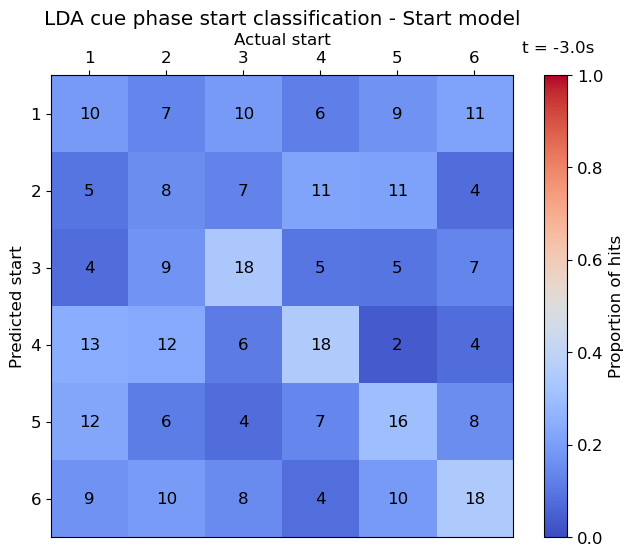

In [140]:
fig, ax = plt.subplots(figsize=(8, 6))
plt.title('LDA cue phase start classification - Start model')

conf_mat_prop = confusion_heatmap(lda_start_confusion_iti_cue_timebins[0,:,:])
im = ax.imshow(conf_mat_prop, cmap='coolwarm', vmin=0, vmax=1)
cbar = plt.colorbar(im, ax=ax, label='Proportion of hits')

ax.set_xticks(np.arange(num_goals), labels=list(range(1, num_goals+1)))
ax.set_yticks(np.arange(num_goals), labels=list(range(1, num_goals+1)))
ax.tick_params(top=True, labeltop=True, bottom=False, labelbottom=False)
ax.set_xlabel('Actual start')
ax.set_ylabel('Predicted start')
ax.xaxis.set_label_position('top')

text_labels = dict()
for i, row in enumerate(lda_start_confusion_iti_cue_timebins[0,:,:]):
    for j, val in enumerate(row):
        text_labels[(j, i)] = ax.text(j, i, f'{val:.0f}', ha='center', va='center', color='k')
tstamp = ax.text(1.02, 1.05, '', transform=ax.transAxes)

def update(frame):
    conf_mat_prop = confusion_heatmap(lda_start_confusion_iti_cue_timebins[frame,:,:])
    im.set_array(conf_mat_prop)
    for i, row in enumerate(lda_start_confusion_iti_cue_timebins[frame,:,:]):
        for j, val in enumerate(row):
            text_labels[(j, i)].set_text(f'{val:.0f}')
    tstamp.set_text(f't = {0.1 * frame - 3:.1f}s')

ani = FuncAnimation(fig, update, frames=50, interval=1000, blit=False, repeat=True)
HTML(ani.to_html5_video())

if to_save:
    if not os.path.exists(figsave_dir):
        os.makedirs(figsave_dir)
    ani.save(f'{figsave_dir}/start_confmat_{save_name}.mp4', writer='ffmpeg')

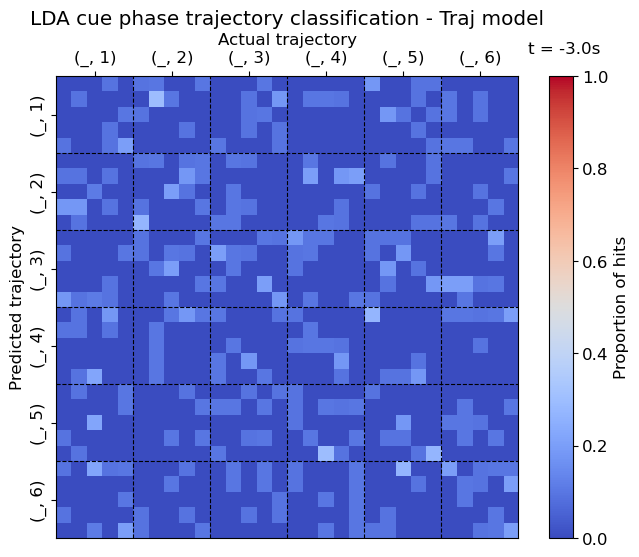

In [141]:
fig, ax = plt.subplots(figsize=(8, 6))
plt.title('LDA cue phase trajectory classification - Traj model')

conf_mat_prop = confusion_heatmap(lda_traj_confusion_iti_cue_timebins[0,:,:])
im = ax.imshow(conf_mat_prop, cmap='coolwarm', vmin=0, vmax=1)
cbar = plt.colorbar(im, ax=ax, label='Proportion of hits')

ax.set_xticks(np.arange(2, num_cats, num_goals-1), labels=[f'(_, {i})' for i in range(1, num_goals+1)], fontsize=12)
ax.set_yticks(np.arange(2, num_cats, num_goals-1), labels=[f'(_, {i})' for i in range(1, num_goals+1)], fontsize=12, rotation=90, va='center')
ax.tick_params(top=True, labeltop=True, bottom=False, labelbottom=False)
ax.set_xlabel('Actual trajectory')
ax.set_ylabel('Predicted trajectory')
ax.xaxis.set_label_position('top')
for j in range(1, num_goals):
    ax.axhline(y=5*j-0.5, color='k', linewidth=0.8, linestyle='--')
    ax.axvline(x=5*j-0.5, color='k', linewidth=0.8, linestyle='--')

tstamp = ax.text(1.02, 1.05, '', transform=ax.transAxes)

def update(frame):
    conf_mat_prop = confusion_heatmap(lda_traj_confusion_iti_cue_timebins[frame,:,:])
    im.set_array(conf_mat_prop)
    tstamp.set_text(f't = {0.1 * frame - 3:.1f}s')

ani = FuncAnimation(fig, update, frames=50, interval=1000, blit=False, repeat=True)
HTML(ani.to_html5_video())

if to_save:
    if not os.path.exists(figsave_dir):
        os.makedirs(figsave_dir)
    ani.save(f'{figsave_dir}/traj_confmat_{save_name}.mp4', writer='ffmpeg')

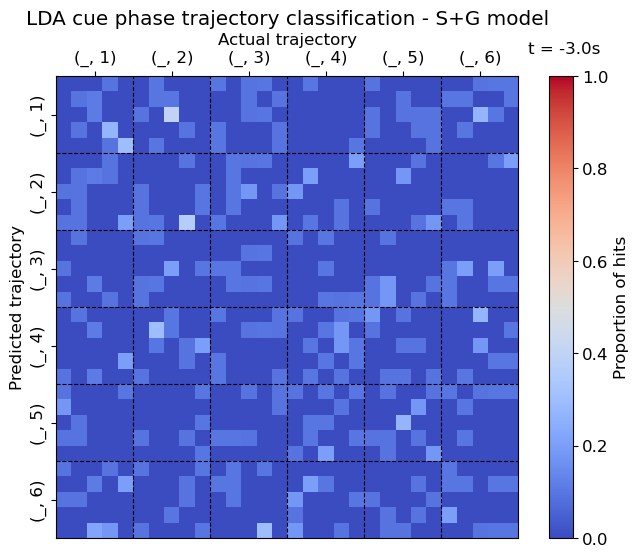

In [142]:
fig, ax = plt.subplots(figsize=(8, 6))
plt.title('LDA cue phase trajectory classification - S+G model')

conf_mat_prop = confusion_heatmap(lda_startgoal_confusion_iti_cue_timebins[0,:,:])
im = ax.imshow(conf_mat_prop, cmap='coolwarm', vmin=0, vmax=1)
cbar = plt.colorbar(im, ax=ax, label='Proportion of hits')

ax.set_xticks(np.arange(2, num_cats, num_goals-1), labels=[f'(_, {i})' for i in range(1, num_goals+1)], fontsize=12)
ax.set_yticks(np.arange(2, num_cats, num_goals-1), labels=[f'(_, {i})' for i in range(1, num_goals+1)], fontsize=12, rotation=90, va='center')
ax.tick_params(top=True, labeltop=True, bottom=False, labelbottom=False)
ax.set_xlabel('Actual trajectory')
ax.set_ylabel('Predicted trajectory')
ax.xaxis.set_label_position('top')
for j in range(1, num_goals):
    ax.axhline(y=5*j-0.5, color='k', linewidth=0.8, linestyle='--')
    ax.axvline(x=5*j-0.5, color='k', linewidth=0.8, linestyle='--')

tstamp = ax.text(1.02, 1.05, '', transform=ax.transAxes)

def update(frame):
    conf_mat_prop = confusion_heatmap(lda_startgoal_confusion_iti_cue_timebins[frame,:,:])
    im.set_array(conf_mat_prop)
    tstamp.set_text(f't = {0.1 * frame - 3:.1f}s')

ani = FuncAnimation(fig, update, frames=50, interval=1000, blit=False, repeat=True)
HTML(ani.to_html5_video())

if to_save:
    if not os.path.exists(figsave_dir):
        os.makedirs(figsave_dir)
    ani.save(f'{figsave_dir}/startgoal_confmat_{save_name}.mp4', writer='ffmpeg')

LDA Dimensionality Reduction

In [25]:
# Combine trials into a pseudosession and fit PCA to all trials
combined_ldspikerates_cue = list()
combined_trajectories_cue = list()
for traj in trajectories:
    combined_ldspikerates_cue.extend(combined_spikerates_cue_per_traj[traj])
    combined_trajectories_cue.extend(len(combined_spikerates_cue_per_traj[traj]) * [traj])
combined_goals_cue_lda = np.array([item for sublist in map(lambda x: 10*[x[1]], combined_trajectories_cue) for item in sublist])

n_dims = 3
lda = LinearDiscriminantAnalysis(n_components=n_dims)
combined_ldspikerates_cue = lda.fit_transform(np.vstack(combined_ldspikerates_cue), combined_goals_cue_lda)

# Regroup into trajectories for plotting
num_timebins = 10
combined_ldspikerates_cue_per_traj = [[np.empty((0, num_timebins, n_dims)) for i in range(num_goals)] for j in range(num_goals)]
for k, (i, j) in enumerate(combined_trajectories_cue):
    i -= 1
    j -= 1
    combined_ldspikerates_cue_per_traj[i][j] = np.concatenate([combined_ldspikerates_cue_per_traj[i][j], combined_ldspikerates_cue[10*k:10*(k+1),:].reshape(-1, num_timebins, n_dims)])

# Plot the average response per trajectory
combined_ldspikerates_cue_per_traj_avg = [[np.empty((0, num_timebins, n_dims)) for i in range(num_goals)] for j in range(num_goals)]
for i in range(num_goals):
    for j, data in enumerate(combined_ldspikerates_cue_per_traj[i]):
        if i == j:
            continue
        combined_ldspikerates_cue_per_traj_avg[i][j] = np.concatenate([combined_ldspikerates_cue_per_traj_avg[i][j], np.mean(data, axis=0).reshape(1, num_timebins, n_dims)], axis=0)

# Hausdorff distance for comparing separation between trajectories of different groups
combined_ldspikerates_cue_per_traj_hausdist = [[dict(), dict()] for _ in range(num_goals)]
for i in range(num_goals):
    traj_pairs = list(range(num_goals))
    traj_pairs.remove(i)
    traj_pairs = list(combinations(traj_pairs, 2))
    for (j1, j2) in traj_pairs:
        combined_ldspikerates_cue_per_traj_hausdist[i][0][(j1, j2)] = symmetric_hausdorff(combined_pcspikerates_cue_per_traj_avg[i][j1][0,:,:], combined_pcspikerates_cue_per_traj_avg[i][j2][0,:,:])
        combined_ldspikerates_cue_per_traj_hausdist[i][1][(j1, j2)] = symmetric_hausdorff(combined_pcspikerates_cue_per_traj_avg[j1][i][0,:,:], combined_pcspikerates_cue_per_traj_avg[j2][i][0,:,:])

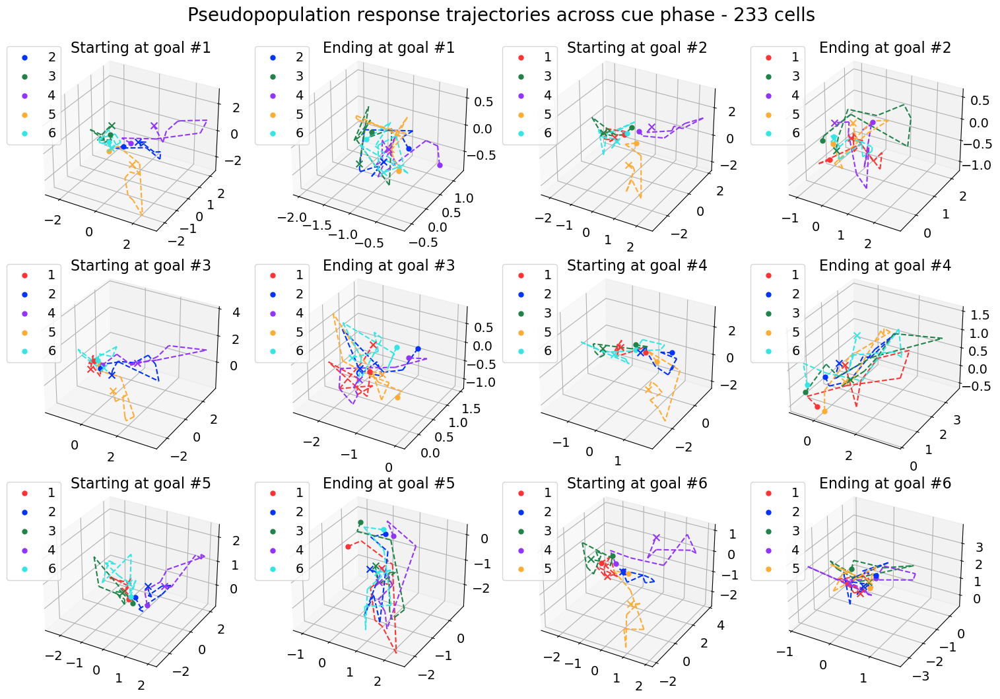

In [143]:
# LDA plots for cue responses between different trajectories, mean of each group of points
fig = plt.figure(figsize=(18, 12))
plt.rcParams['font.size'] = 14
plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1, wspace=0.2, hspace=0.1)
plt.suptitle(f'Pseudopopulation response trajectories across cue phase - {popl_name}', fontsize=20, y=0.95)
colours = ['#ff3333', '#0033ff', '#1e8449', '#9333ff', '#ffac33', '#33e6e6']

for i in range(num_goals):
    ax = fig.add_subplot(3, 4, 2*i+1, projection='3d')
    ax.set_title(f'Starting at goal #{i+1}', fontsize=16, x=0.56, y=1.02)
    for j in range(num_goals):
        if j == i:
            continue
        data = combined_ldspikerates_cue_per_traj_avg[i][j]
        for k in range(data.shape[1]-1):
            ax.plot(data[0,k:k+2,0], data[0,k:k+2,1], data[0,k:k+2,2], linestyle='--', linewidth=1.5, color=colours[j])
        ax.scatter(data[0,0,0], data[0,0,1], data[0,0,2], marker='.', color=colours[j], s=100, label=j+1)
        ax.scatter(data[0,-1,0], data[0,-1,1], data[0,-1,2], marker='x', color=colours[j], s=50)
    ax.legend(loc=(-0.12, 0.5))

    ax = fig.add_subplot(3, 4, 2*i+2, projection='3d')
    ax.set_title(f'Ending at goal #{i+1}', fontsize=16, x=0.56, y=1.02)
    for j in range(num_goals):
        if j == i:
            continue
        data = combined_ldspikerates_cue_per_traj_avg[j][i]
        for k in range(data.shape[1]-1):
            ax.plot(data[0,k:k+2,0], data[0,k:k+2,1], data[0,k:k+2,2], linestyle='--', linewidth=1.5, color=colours[j])
        ax.scatter(data[0,0,0], data[0,0,1], data[0,0,2], marker='.', color=colours[j], s=100, label=j+1)
        ax.scatter(data[0,-1,0], data[0,-1,1], data[0,-1,2], marker='x', color=colours[j], s=50)
    ax.legend(loc=(-0.12, 0.5))

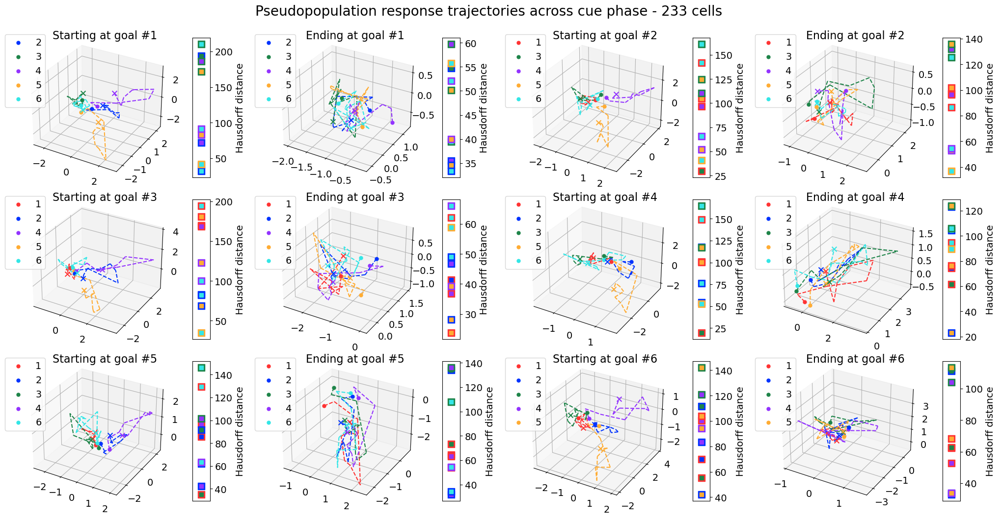

In [144]:
# LDA plots for cue responses between different trajectories, with hausdorff distance plots between trajectories in each group of same start/end goal
fig = plt.figure(figsize=(24, 12))
outer_gs = GridSpec(3, 4)
plt.rcParams['font.size'] = 14
plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1, wspace=0.3, hspace=0.1)
plt.suptitle(f'Pseudopopulation response trajectories across cue phase - {popl_name}', fontsize=20, y=0.95)
colours = ['#ff3333', '#0033ff', '#1e8449', '#9333ff', '#ffac33', '#33e6e6']

for i in range(num_goals):
    inner_gs = outer_gs[2*i].subgridspec(1, 2, wspace=0.2, width_ratios=[9, 1])
    ax1 = fig.add_subplot(inner_gs[0], projection='3d')
    ax1.set_title(f'Starting at goal #{i+1}', fontsize=16, x=0.56, y=1.02)
    for j in range(num_goals):
        if j == i:
            continue
        data = combined_ldspikerates_cue_per_traj_avg[i][j]
        for k in range(data.shape[1]-1):
            ax1.plot(data[0,k:k+2,0], data[0,k:k+2,1], data[0,k:k+2,2], linestyle='--', linewidth=1.5, color=colours[j])
        ax1.scatter(data[0,0,0], data[0,0,1], data[0,0,2], marker='.', color=colours[j], s=100, label=j+1)
        ax1.scatter(data[0,-1,0], data[0,-1,1], data[0,-1,2], marker='x', color=colours[j], s=50)
    ax1.legend(loc=(-0.12, 0.5))

    ax2 = fig.add_subplot(inner_gs[1])
    ax2.set_box_aspect(8)
    for (a, b), val in combined_ldspikerates_cue_per_traj_hausdist[i][0].items():
        ax2.scatter(0, val, marker='s', s=100, color=colours[a], linewidth=1)
        ax2.scatter(0, val, marker='s', s=40, color=colours[b], linewidth=1)
        #ax2.annotate(f'({a+1}, {b+1})', (0, val), textcoords="offset points", xytext=(-5, 5), ha='right', va='center', fontsize=10, rotation=15)
    ax2.set_xticks([])
    #ax2.set_xlim([-2,1])
    ax2.set_ylabel('Hausdorff distance')
    ax2.yaxis.tick_right()
    ax2.yaxis.set_label_position("right")
    #ax2.yaxis.set_major_formatter(StrMethodFormatter('{x:,.0f}'))

    inner_gs = outer_gs[2*i+1].subgridspec(1, 2, wspace=0.2, width_ratios=[9, 1])
    ax1 = fig.add_subplot(inner_gs[0], projection='3d')
    ax1.set_title(f'Ending at goal #{i+1}', fontsize=16, x=0.56, y=1.02)
    for j in range(num_goals):
        if j == i:
            continue
        data = combined_ldspikerates_cue_per_traj_avg[j][i]
        for k in range(data.shape[1]-1):
            ax1.plot(data[0,k:k+2,0], data[0,k:k+2,1], data[0,k:k+2,2], linestyle='--', linewidth=1.5, color=colours[j])
        ax1.scatter(data[0,0,0], data[0,0,1], data[0,0,2], marker='.', color=colours[j], s=100, label=j+1)
        ax1.scatter(data[0,-1,0], data[0,-1,1], data[0,-1,2], marker='x', color=colours[j], s=50)
    ax1.legend(loc=(-0.12, 0.5))

    ax2 = fig.add_subplot(inner_gs[1])
    ax2.set_box_aspect(8)
    for (a, b), val in combined_ldspikerates_cue_per_traj_hausdist[i][1].items():
        ax2.scatter(0, val, marker='s', s=100, color=colours[a], linewidth=1)
        ax2.scatter(0, val, marker='s', s=40, color=colours[b], linewidth=1)
        #ax2.annotate(f'({a+1}, {b+1})', (0, val), textcoords="offset points", xytext=(-5, 5), ha='right', va='center', fontsize=10, rotation=15)
    ax2.set_xticks([])
    #ax2.set_xlim([-2,1])
    ax2.set_ylabel('Hausdorff distance')
    ax2.yaxis.tick_right()
    ax2.yaxis.set_label_position("right")
    #ax2.yaxis.set_major_formatter(StrMethodFormatter('{x:,.0f}'))

#### Cross-Temporal Cue phase Decoding

In [26]:
# Cross-temporal goal decoding across 100ms time windows of cue phase population responses using LDA model
combined_ldspikerates_cue = list()
combined_trajectories_cue = list()
for traj in trajectories:
    combined_ldspikerates_cue.extend(combined_spikerates_cue_per_traj[traj])
    combined_trajectories_cue.extend(len(combined_spikerates_cue_per_traj[traj]) * [traj])

# Indexing as follows: (trial, timebin, cell) for population activity/spikerate array
num_timebins = 10
combined_ldspikerates_cue_timebins = np.zeros((len(combined_ldspikerates_cue), num_timebins, num_all_cells))
for i, trial in enumerate(combined_ldspikerates_cue):
    for k in range(num_timebins):
        combined_ldspikerates_cue_timebins[i,k,:] = trial[k,:]
combined_goals_cue_lda_timebins = np.array(list(map(lambda x: x[1], combined_trajectories_cue)))

# Indexing as follows: (train window, test window, fold) for accuracy array and (train window, test window, pred class, actl class) for confusion matrices
k_fold = 10
lda_goal_accuracy_cue_crosstemp = np.zeros((num_timebins, num_timebins, k_fold))
lda_goal_confusion_cue_crosstemp = np.zeros((num_timebins, num_timebins, num_goals, num_goals))

for k_tr in range(num_timebins):
    for i in range(k_fold):
        # Train and do same-temporal testing first
        X_train, X_test, y_train, y_test = train_test_split(combined_ldspikerates_cue_timebins[:,k_tr,:], combined_goals_cue_lda_timebins, (i, k_fold))
        lda = LinearDiscriminantAnalysis()
        lda.fit(X_train, y_train)
        y_pred = lda.predict(X_test)
        lda_goal_accuracy_cue_crosstemp[k_tr,k_tr,i] = prediction_accuracy(y_pred, y_test)
        lda_goal_confusion_cue_crosstemp[k_tr,k_tr,:,:] += confusion_matrix(y_pred, y_test, num_goals)

        # Cross-temporal decoding
        for k_ts in range(num_timebins):
            if k_tr == k_ts:
                continue
            X_test, y_test = combined_ldspikerates_cue_timebins[:,k_ts,:], combined_goals_cue_lda_timebins
            y_pred = lda.predict(X_test)
            lda_goal_accuracy_cue_crosstemp[k_tr,k_ts,i] = prediction_accuracy(y_pred, y_test)
            lda_goal_confusion_cue_crosstemp[k_tr,k_ts,:,:] += confusion_matrix(y_pred, y_test, num_goals)

lda_goal_mean_accuracy_cue_crosstemp = np.mean(lda_goal_accuracy_cue_crosstemp, axis=2)

In [27]:
# Cross-temporal goal decoding across 100ms time windows of preceding iti + cue phase population responses using LDA model
combined_ldspikerates_iti_cue = list()
for traj in trajectories:
    combined_ldspikerates_iti_cue.extend(combined_spikerates_iti_cue_per_traj[traj])

# combined_ldspikerates_iti_cue = list()
# for traj in trajectories:
#     combined_ldspikerates_iti_cue.extend([trial for trial in combined_spikerates_iti_cue_filt_per_traj[traj]])

# Indexing as follows: (trial, timebin, cell) for population activity/spikerate array
num_timebins_ext = 50
combined_ldspikerates_iti_cue_timebins = np.zeros((len(combined_ldspikerates_iti_cue), num_timebins_ext, num_all_cells))
# combined_ldspikerates_iti_cue_timebins = np.zeros((len(combined_ldspikerates_iti_cue), num_timebins_ext, num_cells_filt))
for i, trial in enumerate(combined_ldspikerates_iti_cue):
    for k in range(num_timebins_ext):
        combined_ldspikerates_iti_cue_timebins[i,k,:] = trial[k,:]

# Indexing as follows: (train window, test window, fold) for accuracy array and (train window, test window, pred class, actl class) for confusion matrices
k_fold = 10
lda_goal_accuracy_iti_cue_crosstemp = np.zeros((num_timebins_ext, num_timebins_ext, k_fold))
lda_goal_confusion_iti_cue_crosstemp = np.zeros((num_timebins_ext, num_timebins_ext, num_goals, num_goals))

for k_tr in range(num_timebins_ext):
    for i in range(k_fold):
        # Train and do same-temporal testing first
        X_train, X_test, y_train, y_test = train_test_split(combined_ldspikerates_iti_cue_timebins[:,k_tr,:], combined_goals_cue_lda_timebins, (i, k_fold))
        lda = LinearDiscriminantAnalysis()
        lda.fit(X_train, y_train)
        y_pred = lda.predict(X_test)
        lda_goal_accuracy_iti_cue_crosstemp[k_tr,k_tr,i] = prediction_accuracy(y_pred, y_test)
        lda_goal_confusion_iti_cue_crosstemp[k_tr,k_tr,:,:] += confusion_matrix(y_pred, y_test, num_goals)

        # Cross-temporal decoding
        for k_ts in range(num_timebins_ext):
            if k_tr == k_ts:
                continue
            X_test, y_test = combined_ldspikerates_iti_cue_timebins[:,k_ts,:], combined_goals_cue_lda_timebins
            y_pred = lda.predict(X_test)
            lda_goal_accuracy_iti_cue_crosstemp[k_tr,k_ts,i] = prediction_accuracy(y_pred, y_test)
            lda_goal_confusion_iti_cue_crosstemp[k_tr,k_ts,:,:] += confusion_matrix(y_pred, y_test, num_goals)

lda_goal_mean_accuracy_iti_cue_crosstemp = np.mean(lda_goal_accuracy_iti_cue_crosstemp, axis=2)

In [28]:
# Cross-temporal start decoding across 100ms time windows of preceding iti + cue phase population responses using LDA model
combined_starts_cue_lda_timebins = np.array(list(map(lambda x: x[0], combined_trajectories_cue)))

# Indexing as follows: (train window, test window, fold) for accuracy array and (train window, test window, pred class, actl class) for confusion matrices
k_fold = 10
lda_start_accuracy_iti_cue_crosstemp = np.zeros((num_timebins_ext, num_timebins_ext, k_fold))
lda_start_confusion_iti_cue_crosstemp = np.zeros((num_timebins_ext, num_timebins_ext, num_goals, num_goals))

for k_tr in range(num_timebins_ext):
    for i in range(k_fold):
        # Train and do same-temporal testing first
        X_train, X_test, y_train, y_test = train_test_split(combined_ldspikerates_iti_cue_timebins[:,k_tr,:], combined_starts_cue_lda_timebins, (i, k_fold))
        lda = LinearDiscriminantAnalysis()
        lda.fit(X_train, y_train)
        y_pred = lda.predict(X_test)
        lda_start_accuracy_iti_cue_crosstemp[k_tr,k_tr,i] = prediction_accuracy(y_pred, y_test)
        lda_start_confusion_iti_cue_crosstemp[k_tr,k_tr,:,:] += confusion_matrix(y_pred, y_test, num_goals)

        # Cross-temporal decoding
        for k_ts in range(num_timebins_ext):
            if k_tr == k_ts:
                continue
            X_test, y_test = combined_ldspikerates_iti_cue_timebins[:,k_ts,:], combined_starts_cue_lda_timebins
            y_pred = lda.predict(X_test)
            lda_start_accuracy_iti_cue_crosstemp[k_tr,k_ts,i] = prediction_accuracy(y_pred, y_test)
            lda_start_confusion_iti_cue_crosstemp[k_tr,k_ts,:,:] += confusion_matrix(y_pred, y_test, num_goals)

lda_start_mean_accuracy_iti_cue_crosstemp = np.mean(lda_start_accuracy_iti_cue_crosstemp, axis=2)

In [29]:
# Cross-temporal goal location decoding across 100ms time windows of preceding iti + cue phase population responses using LDA model
# Indexing as follows: (train window, test window, fold) for accuracy array and (train window, test window, pred class, actl class) for confusion matrices
k_fold = 10
lda_goalloc_accuracy_iti_cue_crosstemp = np.zeros((num_timebins_ext, num_timebins_ext, k_fold))
lda_goalloc_confusion_iti_cue_crosstemp = np.zeros((num_timebins_ext, num_timebins_ext, num_goals, num_goals))

for k_tr in range(num_timebins_ext):
    for i in range(k_fold):
        # Train and do same-temporal testing first
        if k_tr < 30:
            X_train, X_test, y_train, y_test = train_test_split(combined_ldspikerates_iti_cue_timebins[:,k_tr,:], combined_starts_cue_lda_timebins, (i, k_fold))
        else:
            X_train, X_test, y_train, y_test = train_test_split(combined_ldspikerates_iti_cue_timebins[:,k_tr,:], combined_goals_cue_lda_timebins, (i, k_fold))
        lda = LinearDiscriminantAnalysis()
        lda.fit(X_train, y_train)
        y_pred = lda.predict(X_test)
        lda_goalloc_accuracy_iti_cue_crosstemp[k_tr,k_tr,i] = prediction_accuracy(y_pred, y_test)
        lda_goalloc_confusion_iti_cue_crosstemp[k_tr,k_tr,:,:] += confusion_matrix(y_pred, y_test, num_goals)

        # Cross-temporal decoding
        for k_ts in range(num_timebins_ext):
            if k_tr == k_ts:
                continue
            if k_tr < 30:
                X_test, y_test = combined_ldspikerates_iti_cue_timebins[:,k_ts,:], combined_starts_cue_lda_timebins
            else:
                X_test, y_test = combined_ldspikerates_iti_cue_timebins[:,k_ts,:], combined_goals_cue_lda_timebins
            y_pred = lda.predict(X_test)
            lda_goalloc_accuracy_iti_cue_crosstemp[k_tr,k_ts,i] = prediction_accuracy(y_pred, y_test)
            lda_goalloc_confusion_iti_cue_crosstemp[k_tr,k_ts,:,:] += confusion_matrix(y_pred, y_test, num_goals)

lda_goalloc_mean_accuracy_iti_cue_crosstemp = np.mean(lda_goalloc_accuracy_iti_cue_crosstemp, axis=2)

In [ ]:
plt.figure(figsize=(8, 6))
plt.rcParams['font.size'] = 12
plt.pcolormesh(lda_goal_mean_accuracy_cue_crosstemp, cmap='coolwarm')
cbar = plt.colorbar(pad=0.02)
cbar.set_label('Accuracy')
plt.title(f'LDA cue phase cross-temporal goal decoding')
plt.xlabel('Train window (s)')
plt.ylabel('Test window (s)')
plt.xticks(np.arange(num_timebins+1), labels=[f'{n:.1f}' for n in 0.1*np.arange(num_timebins+1)])
plt.yticks(np.arange(num_timebins+1), labels=[f'{n:.1f}' for n in 0.1*np.arange(num_timebins+1)])
plt.show()

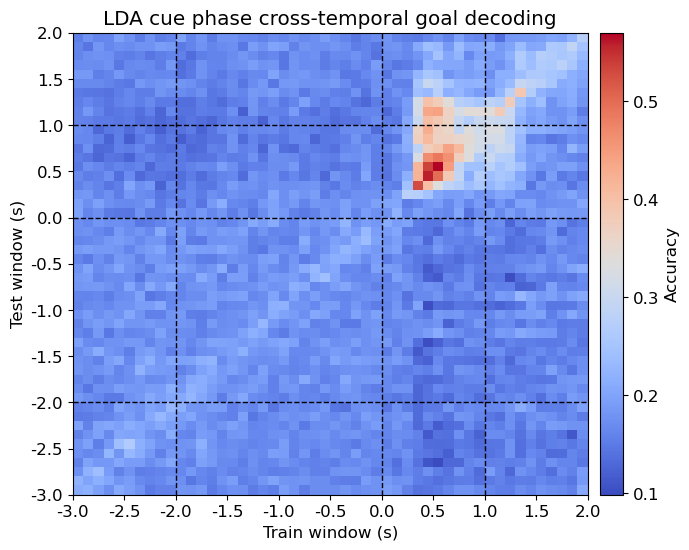

In [145]:
plt.figure(figsize=(8, 6))
plt.rcParams['font.size'] = 12
plt.pcolormesh(lda_goal_mean_accuracy_iti_cue_crosstemp, cmap='coolwarm')
cbar = plt.colorbar(pad=0.02)
cbar.set_label('Accuracy')
plt.title(f'LDA cue phase cross-temporal goal decoding')
plt.xlabel('Train window (s)')
plt.ylabel('Test window (s)')
tstep = 5
plt.xticks(np.arange(0, num_timebins_ext+1, tstep), labels=[f'{n:.1f}' for n in 0.1*np.arange(-num_timebins*3, num_timebins*2+1, tstep)])
plt.yticks(np.arange(0, num_timebins_ext+1, tstep), labels=[f'{n:.1f}' for n in 0.1*np.arange(-num_timebins*3, num_timebins*2+1, tstep)])
plt.axhline(10, color='k', linewidth=1, linestyle='--')
plt.axvline(10, color='k', linewidth=1, linestyle='--')
plt.axhline(30, color='k', linewidth=1, linestyle='--')
plt.axvline(30, color='k', linewidth=1, linestyle='--')
plt.axhline(40, color='k', linewidth=1, linestyle='--')
plt.axvline(40, color='k', linewidth=1, linestyle='--')
plt.show()

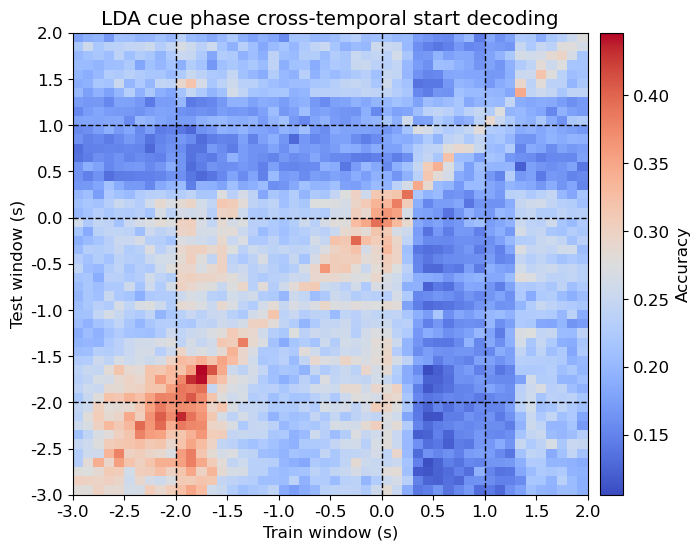

In [146]:
plt.figure(figsize=(8, 6))
plt.rcParams['font.size'] = 12
plt.pcolormesh(lda_start_mean_accuracy_iti_cue_crosstemp, cmap='coolwarm')
cbar = plt.colorbar(pad=0.02)
cbar.set_label('Accuracy')
plt.title(f'LDA cue phase cross-temporal start decoding')
plt.xlabel('Train window (s)')
plt.ylabel('Test window (s)')
tstep = 5
plt.xticks(np.arange(0, num_timebins_ext+1, tstep), labels=[f'{n:.1f}' for n in 0.1*np.arange(-num_timebins*3, num_timebins*2+1, tstep)])
plt.yticks(np.arange(0, num_timebins_ext+1, tstep), labels=[f'{n:.1f}' for n in 0.1*np.arange(-num_timebins*3, num_timebins*2+1, tstep)])
plt.axhline(10, color='k', linewidth=1, linestyle='--')
plt.axvline(10, color='k', linewidth=1, linestyle='--')
plt.axhline(30, color='k', linewidth=1, linestyle='--')
plt.axvline(30, color='k', linewidth=1, linestyle='--')
plt.axhline(40, color='k', linewidth=1, linestyle='--')
plt.axvline(40, color='k', linewidth=1, linestyle='--')
plt.show()

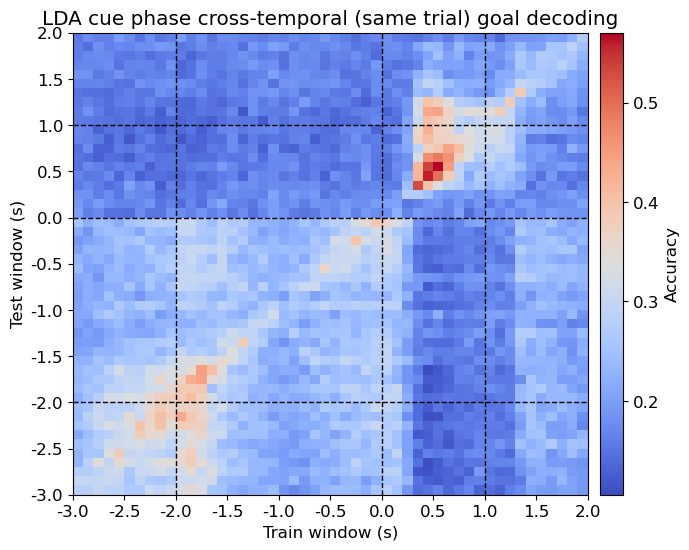

In [147]:
plt.figure(figsize=(8, 6))
plt.rcParams['font.size'] = 12
plt.pcolormesh(lda_goalloc_mean_accuracy_iti_cue_crosstemp, cmap='coolwarm')
cbar = plt.colorbar(pad=0.02)
cbar.set_label('Accuracy')
plt.title(f'LDA cue phase cross-temporal (same trial) goal decoding')
plt.xlabel('Train window (s)')
plt.ylabel('Test window (s)')
tstep = 5
plt.xticks(np.arange(0, num_timebins_ext+1, tstep), labels=[f'{n:.1f}' for n in 0.1*np.arange(-num_timebins*3, num_timebins*2+1, tstep)])
plt.yticks(np.arange(0, num_timebins_ext+1, tstep), labels=[f'{n:.1f}' for n in 0.1*np.arange(-num_timebins*3, num_timebins*2+1, tstep)])
plt.axhline(10, color='k', linewidth=1, linestyle='--')
plt.axvline(10, color='k', linewidth=1, linestyle='--')
plt.axhline(30, color='k', linewidth=1, linestyle='--')
plt.axvline(30, color='k', linewidth=1, linestyle='--')
plt.axhline(40, color='k', linewidth=1, linestyle='--')
plt.axvline(40, color='k', linewidth=1, linestyle='--')
plt.show()

#### Cell correlation matrix

In [30]:
# Array axes: observation, timebin, cell
combined_spikerates_iti_cue = np.empty((0, num_timebins_ext, num_all_cells))
for (s, g) in trajectories:
    combined_spikerates_iti_cue = np.concatenate([combined_spikerates_iti_cue, np.stack(combined_spikerates_iti_cue_per_traj[(s, g)])], axis=0)
combined_trajectories_iti_cue = np.array(combined_trajectories_cue)

# Compute correlation between cells
cell_correlation = list()
for timebin in range(num_timebins_ext):
    cell_correlation.append(np.corrcoef(combined_spikerates_iti_cue[:,timebin,:], rowvar=False))
cell_correlation = np.array(cell_correlation)

# Set correlation matrix diagonal to zero
for t in range(num_timebins_ext):
    for c in range(num_all_cells):
        cell_correlation[t,c,c] = 0

/Users/jcheng/miniconda3/envs/decoding/lib/python3.10/site-packages/numpy/lib/function_base.py:2829: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
/Users/jcheng/miniconda3/envs/decoding/lib/python3.10/site-packages/numpy/lib/function_base.py:2830: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]


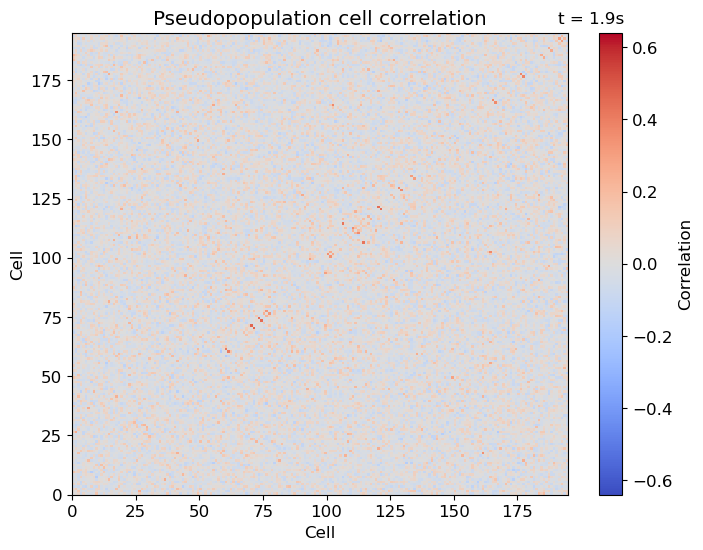

In [1948]:
fig, ax = plt.subplots(figsize=(8, 6))
plt.title('Pseudopopulation cell correlation')

# Set colormap axis limits to +- 99th percentile across all timebins
axlim = np.round(np.max([np.abs(np.max(np.nanpercentile(cell_correlation, 99, axis=0))), np.abs(np.min(np.nanpercentile(cell_correlation, 1, axis=0)))]), 2)

timebin = 0
im = ax.pcolormesh(cell_correlation[timebin], cmap='coolwarm', vmin=-axlim, vmax=axlim)
cbar = plt.colorbar(im, ax=ax, label='Correlation')

ax.set_xlabel('Cell')
ax.set_ylabel('Cell')

tstamp = ax.text(0.98, 1.02, '', transform=ax.transAxes)

def update(frame):
    im.set_array(cell_correlation[frame])
    tstamp.set_text(f't = {0.1 * frame - 3:.1f}s')

ani = FuncAnimation(fig, update, frames=50, interval=1000, blit=False, repeat=True)
HTML(ani.to_html5_video())

if to_save:
    if not os.path.exists(figsave_dir):
        os.makedirs(figsave_dir)
    ani.save(f'{figsave_dir}/cell_correlation_{save_name}.mp4', writer='ffmpeg')

In [31]:
# Filter out cells that have NaNs in the correlation matrix
cell_filter_2 = np.ones(num_all_cells).astype(bool)
for timebin in range(num_timebins_ext):
    idxs = np.where(np.isnan(cell_correlation[timebin,:,0]))
    cell_filter_2[idxs] = 0
num_cells_filt = np.sum(cell_filter_2, dtype=int)

combined_spikerates_iti_cue_filt = combined_spikerates_iti_cue[:,:,cell_filter_2]
combined_spikerates_iti_cue_filt_per_traj = {traj: list() for traj in trajectories}
for i, trial in enumerate(combined_spikerates_iti_cue_filt):
    traj = tuple(combined_trajectories_iti_cue[i])
    combined_spikerates_iti_cue_filt_per_traj[traj].append(trial)
for traj, trials in combined_spikerates_iti_cue_filt_per_traj.items():
    combined_spikerates_iti_cue_filt_per_traj[traj] = np.stack(trials)

filtered_cell_idxs = np.where(~cell_filter_2)[0]

# Rerun correlation between cells, this time without the cells producing NaNs
cell_correlation = list()
for timebin in range(num_timebins_ext):
    cell_correlation.append(np.corrcoef(combined_spikerates_iti_cue_filt[:,timebin,:], rowvar=False))
cell_correlation = np.array(cell_correlation)

# Set correlation matrix diagonal to zero
for t in range(num_timebins_ext):
    for c in range(num_cells_filt):
        cell_correlation[t,c,c] = 0

In [2225]:
np.sum(cell_filter_2)

195

In [ ]:
filtered_cell_idxs

array([  1,   3,   8,   9,  17,  18,  27,  31,  37,  42,  44,  47,  55,
        56,  57,  59,  80, 102, 105, 120, 122, 146, 165, 177, 178, 184,
       187, 192, 197, 199, 204, 207, 208, 213, 214, 219, 220, 228])

In [32]:
cell_variances = list()
for cell in range(num_all_cells):
    cell_variances.append(np.var(combined_spikerates_iti_cue[:,:,cell], axis=0))
cell_variances = np.array(cell_variances)

In [57]:
very_small_num = 1e-3
np.unique(np.where(cell_variances < very_small_num)[0]).shape

(38,)

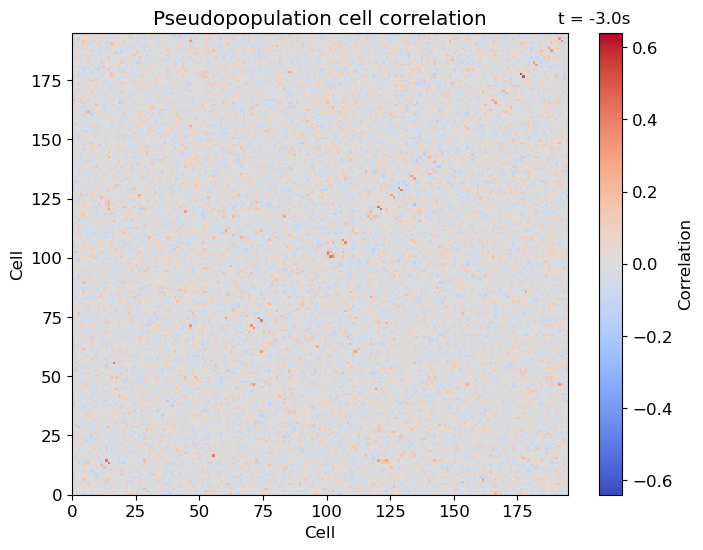

In [148]:
fig, ax = plt.subplots(figsize=(8, 6))
plt.title('Pseudopopulation cell correlation')

# Set colormap axis limits to +- 99th percentile across all timebins
axlim = np.round(np.max([np.abs(np.max(np.percentile(cell_correlation, 99, axis=0))), np.abs(np.min(np.percentile(cell_correlation, 1, axis=0)))]), 2)

timebin = 0
im = ax.pcolormesh(cell_correlation[timebin], cmap='coolwarm', vmin=-axlim, vmax=axlim)
cbar = plt.colorbar(im, ax=ax, label='Correlation')

ax.set_xlabel('Cell')
ax.set_ylabel('Cell')

tstamp = ax.text(0.98, 1.02, '', transform=ax.transAxes)

def update(frame):
    im.set_array(cell_correlation[frame])
    tstamp.set_text(f't = {0.1 * frame - 3:.1f}s')

ani = FuncAnimation(fig, update, frames=50, interval=1000, blit=False, repeat=True)
HTML(ani.to_html5_video())

if to_save:
    if not os.path.exists(figsave_dir):
        os.makedirs(figsave_dir)
    ani.save(f'{figsave_dir}/cell_correlation_{save_name}.mp4', writer='ffmpeg')

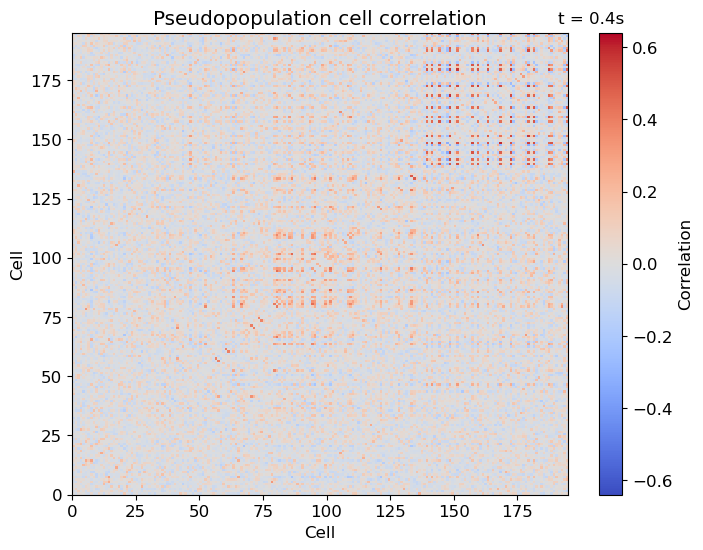

In [776]:
fig, ax = plt.subplots(figsize=(8, 6))
plt.title('Pseudopopulation cell correlation')

timebin = 34
im = ax.pcolormesh(cell_correlation[timebin], cmap='coolwarm', vmin=-axlim, vmax=axlim)
cbar = plt.colorbar(im, ax=ax, label='Correlation')

ax.set_xlabel('Cell')
ax.set_ylabel('Cell')

tstamp = ax.text(0.98, 1.02, f't = {0.1 * timebin - 3:.1f}s', transform=ax.transAxes)

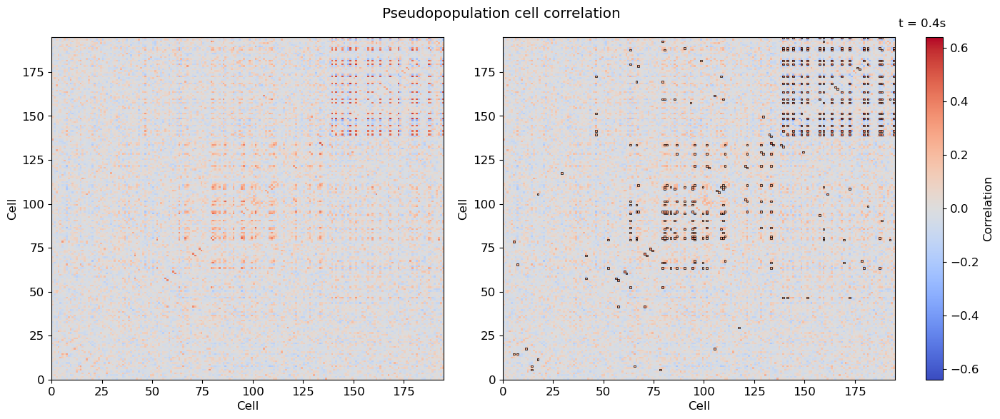

In [149]:
timebin = 34
corr_threshold = 0.25
correlated_cells = np.array(np.where((cell_correlation[timebin] >= corr_threshold) & (cell_correlation[timebin] < 0.9))).T

fig, ax = plt.subplots(1, 2, figsize=(18, 6))
plt.subplots_adjust(0.1, 0.1, 0.9, 0.9, wspace=0.15, hspace=0.1)
plt.suptitle('Pseudopopulation cell correlation', x=0.45, y=0.97)

im = ax[0].pcolormesh(cell_correlation[timebin], cmap='coolwarm', vmin=-axlim, vmax=axlim)
ax[0].set_xlabel('Cell')
ax[0].set_ylabel('Cell')

im = ax[1].pcolormesh(cell_correlation[timebin], cmap='coolwarm', vmin=-axlim, vmax=axlim)
ax[1].set_xlabel('Cell')
ax[1].set_ylabel('Cell')

cbar = plt.colorbar(im, ax=ax, label='Correlation', pad=0.03)
tstamp = ax[1].text(1.01, 1.03, f't = {0.1 * timebin - 3:.1f}s', transform=ax[1].transAxes)

for i, j in correlated_cells:
    ax[1].add_patch(Rectangle((j, i), 1, 1, linewidth=0.5, edgecolor='k', facecolor='none'))

Hierarchical clustering

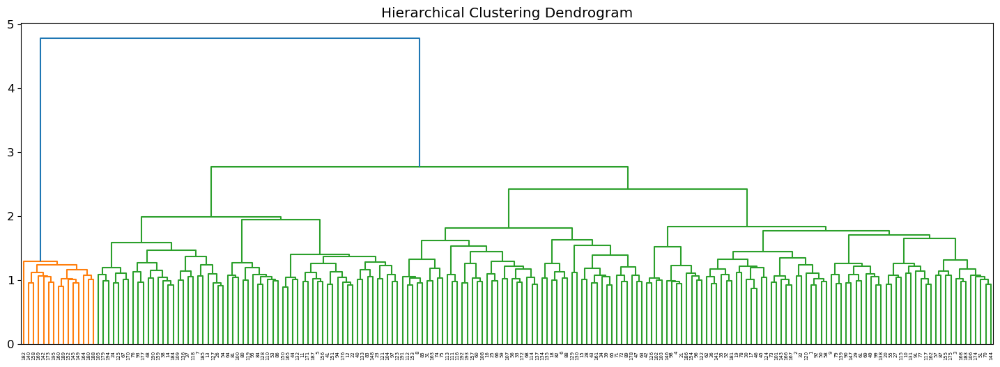

Cluster Assignments: [2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 1 2 1 2 2 1 2 2 2
 1 2 2 1 2 2 2 2 2 1 2 1 2 2 2 1 2 2 2 2 1 2 2 2 1 2 2 2 2 2 2 1 2 1 2 2 2
 2 2 1 1 2 2 2 2 2 1]


In [59]:
# Perform hierarchical clustering
timebin = 12  # -1.8 s timebin
linkage_matrix = linkage(cell_correlation[timebin], method='ward')

# Plot the dendrogram
plt.figure(figsize=(18, 6))
dendrogram(linkage_matrix, labels=np.arange(1, num_cells_filt + 1))
plt.title('Hierarchical Clustering Dendrogram')
plt.show()

# Set the number of clusters and cut the dendrogram to extract clusters
num_clusters = 2
clusters = fcluster(linkage_matrix, num_clusters, criterion='maxclust')

# Display the cluster assignments
print("Cluster Assignments:", clusters)

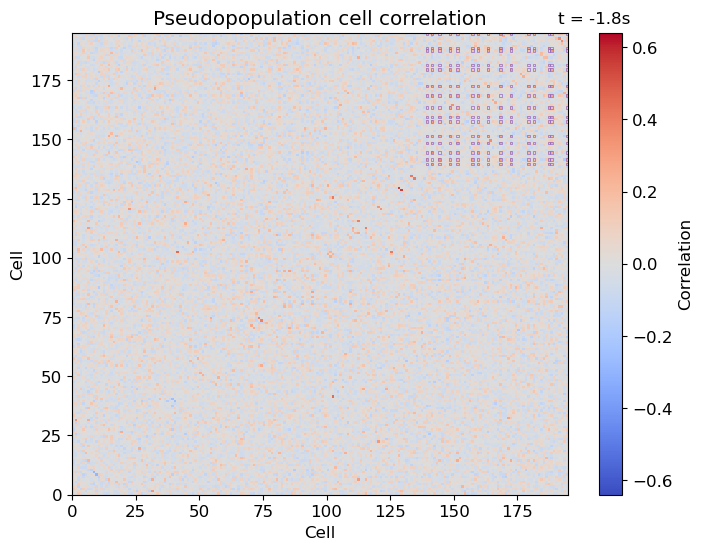

In [150]:
cluster_pairs = np.stack(np.meshgrid(clusters, clusters), axis=2)

fig, ax = plt.subplots(figsize=(8, 6))
plt.title('Pseudopopulation cell correlation')

timebin = 12
im = ax.pcolormesh(cell_correlation[timebin], cmap='coolwarm', vmin=-axlim, vmax=axlim)
cbar = plt.colorbar(im, ax=ax, label='Correlation')

ax.set_xlabel('Cell')
ax.set_ylabel('Cell')

tstamp = ax.text(0.98, 1.02, f't = {0.1 * timebin - 3:.1f}s', transform=ax.transAxes)

for i in range(num_cells_filt):
    for j in range(num_cells_filt):
        if np.all(cluster_pairs[i, j] == np.array([1, 1])):
            ax.add_patch(Rectangle((j, i), 1, 1, linewidth=0.5, edgecolor='C4', facecolor='none'))

In [61]:
cluster_1_cells = np.where(clusters == 1)[0]
cluster_1_cells

array([139, 141, 144, 148, 151, 157, 159, 163, 168, 172, 179, 181, 187,
       188, 194])

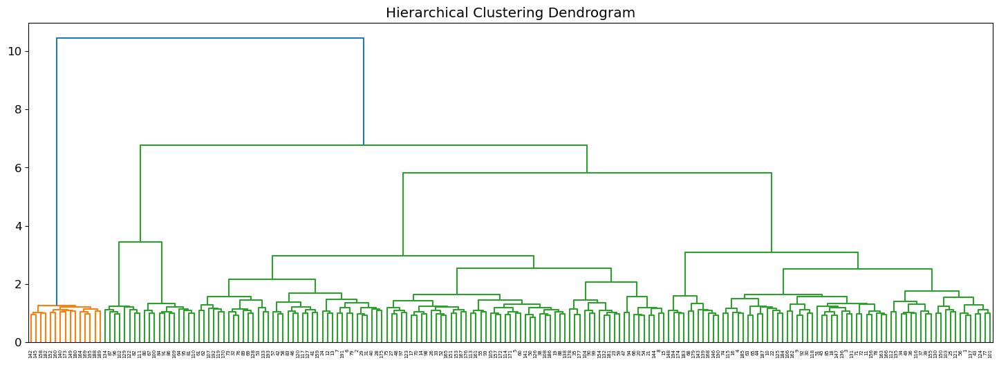

Cluster Assignments: [3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3
 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 2 3 3 2 3 3 3 3 3 3 3
 3 3 3 3 3 2 2 2 3 2 3 2 2 3 3 3 2 3 3 3 2 2 3 3 3 2 3 2 3 3 3 3 3 3 2 2 2
 3 3 3 3 3 3 3 3 3 3 2 3 3 3 3 3 3 2 3 3 3 3 2 3 3 3 3 3 1 3 1 3 3 1 3 3 3
 1 3 3 1 3 3 3 3 3 1 3 1 3 3 3 1 3 3 3 3 1 3 3 3 1 3 3 3 3 3 3 1 3 1 3 3 3
 3 3 1 1 3 3 3 3 3 1]


In [62]:
# Perform hierarchical clustering
timebin = 34  # 0.4 s timebin
linkage_matrix = linkage(cell_correlation[timebin], method='ward')

# Plot the dendrogram
plt.figure(figsize=(18, 6))
dendrogram(linkage_matrix, labels=np.arange(1, num_cells_filt + 1))
plt.title('Hierarchical Clustering Dendrogram')
plt.show()

# Set the number of clusters and cut the dendrogram to extract clusters
num_clusters = 3
clusters = fcluster(linkage_matrix, num_clusters, criterion='maxclust')

# Display the cluster assignments
print("Cluster Assignments:", clusters)

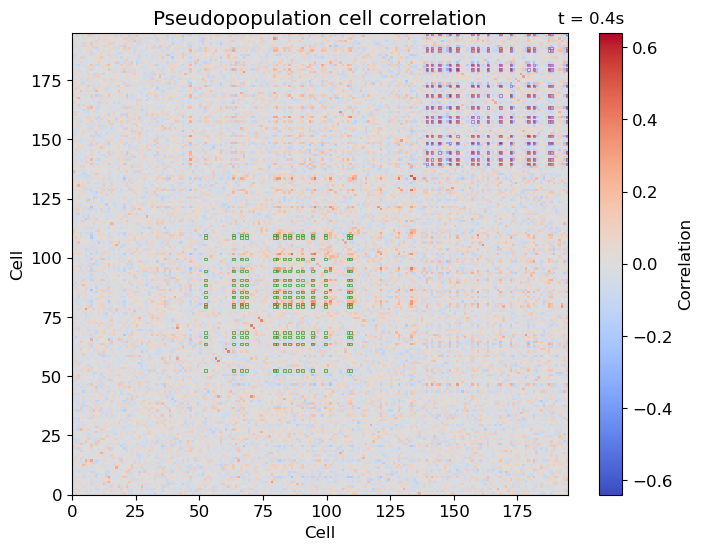

In [151]:
cluster_pairs = np.stack(np.meshgrid(clusters, clusters), axis=2)

fig, ax = plt.subplots(figsize=(8, 6))
plt.title('Pseudopopulation cell correlation')

timebin = 34
im = ax.pcolormesh(cell_correlation[timebin], cmap='coolwarm', vmin=-axlim, vmax=axlim)
cbar = plt.colorbar(im, ax=ax, label='Correlation')

ax.set_xlabel('Cell')
ax.set_ylabel('Cell')

tstamp = ax.text(0.98, 1.02, f't = {0.1 * timebin - 3:.1f}s', transform=ax.transAxes)

for i in range(num_cells_filt):
    for j in range(num_cells_filt):
        if np.all(cluster_pairs[i, j] == np.array([1, 1])):
            ax.add_patch(Rectangle((j, i), 1, 1, linewidth=0.5, edgecolor='C4', facecolor='none'))
        elif np.all(cluster_pairs[i, j] == np.array([2, 2])):
            ax.add_patch(Rectangle((j, i), 1, 1, linewidth=0.5, edgecolor='C2', facecolor='none'))
        # elif np.all(cluster_pairs[i, j] == np.array([1, 2])) or np.all(cluster_pairs[i, j] == np.array([2, 1])):
        #     ax.add_patch(Rectangle((j, i), 1, 1, linewidth=0.5, edgecolor='k', facecolor='none'))

In [64]:
cluster_1_cells = np.where(clusters == 1)[0]
cluster_1_cells

array([139, 141, 144, 148, 151, 157, 159, 163, 168, 172, 179, 181, 187,
       188, 194])

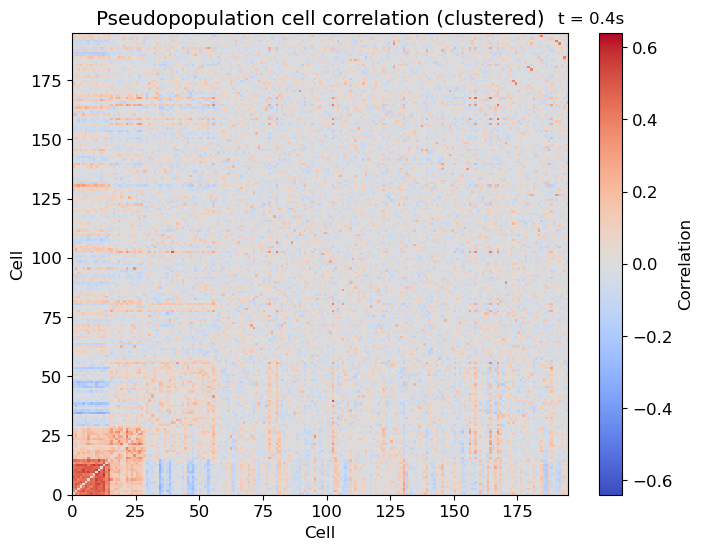

In [152]:
# Plot the original correlation matrix with clustered variables
sorted_indices = np.argsort(clusters)
cell_correlation_clustered = np.array([cell_correlation[t][sorted_indices][:, sorted_indices] for t in range(num_timebins_ext)])

fig, ax = plt.subplots(figsize=(8, 6))
plt.title('Pseudopopulation cell correlation (clustered)')

timebin = 34
im = ax.pcolormesh(cell_correlation_clustered[timebin], cmap='coolwarm', vmin=-axlim, vmax=axlim)
cbar = plt.colorbar(im, ax=ax, label='Correlation')

ax.set_xlabel('Cell')
ax.set_ylabel('Cell')

tstamp = ax.text(0.98, 1.02, f't = {0.1 * timebin - 3:.1f}s', transform=ax.transAxes)

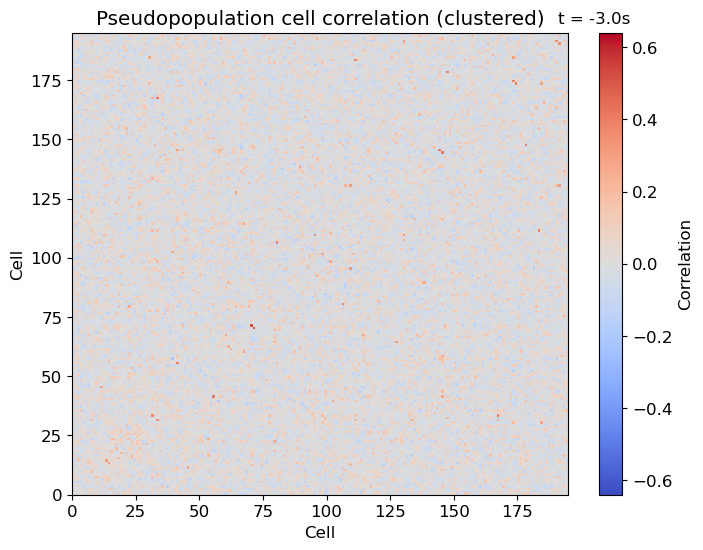

In [153]:
fig, ax = plt.subplots(figsize=(8, 6))
plt.title('Pseudopopulation cell correlation (clustered)')

# Set colormap axis limits to +- 99th percentile across all timebins
axlim = np.round(np.max([np.abs(np.max(np.percentile(cell_correlation_clustered, 99, axis=0))), np.abs(np.min(np.percentile(cell_correlation_clustered, 1, axis=0)))]), 2)

timebin = 0
im = ax.pcolormesh(cell_correlation_clustered[timebin], cmap='coolwarm', vmin=-axlim, vmax=axlim)
cbar = plt.colorbar(im, ax=ax, label='Correlation')

ax.set_xlabel('Cell')
ax.set_ylabel('Cell')

tstamp = ax.text(0.98, 1.02, '', transform=ax.transAxes)

def update(frame):
    im.set_array(cell_correlation_clustered[frame])
    tstamp.set_text(f't = {0.1 * frame - 3:.1f}s')

ani = FuncAnimation(fig, update, frames=50, interval=1000, blit=False, repeat=True)
HTML(ani.to_html5_video())

if to_save:
    if not os.path.exists(figsave_dir):
        os.makedirs(figsave_dir)
    ani.save(f'{figsave_dir}/cell_correlation_clustered_{save_name}.mp4', writer='ffmpeg')

K-means clustering

In [33]:
# Perform k-means clustering
num_clusters = 3
timebin = 34  # cluster based on the correlation matrix of t=0.4s

kmeans = KMeans(n_clusters=num_clusters)
kmeans.fit(cell_correlation[timebin])
clusters = kmeans.labels_

# Relabel clusters according to size (smallest cluster as 1, largest cluster as n), and convert labels to 1-indexing
cluster_sizes = np.bincount(clusters)
sorted_clusters = np.argsort(cluster_sizes)
cluster_remapping = {old_label: new_label for new_label, old_label in enumerate(sorted_clusters, start=1)}
clusters = np.array([cluster_remapping[label] for label in clusters])

In [34]:
# Do further sub-clustering of cluster 2 cells
cluster_2_cells = np.zeros(num_cells_filt).astype(bool)
cluster_2_cells[np.where(clusters == 2)] = 1

num_sub_clusters = 2
kmeans = KMeans(n_clusters=num_clusters)
kmeans.fit(cell_correlation[timebin][cluster_2_cells])
sub_clusters = kmeans.labels_

# # Relabel clusters according to size (smallest cluster as 1, largest cluster as n)
# cluster_sizes = np.bincount(sub_clusters)
# sorted_clusters = np.argsort(cluster_sizes)
# cluster_remapping = {old_label: new_label for new_label, old_label in enumerate(sorted_clusters)}
# sub_clusters = np.array([cluster_remapping[label] for label in sub_clusters])

# Relabel clusters based on sub-clustering results
clusters[np.where(clusters > 2)] += num_sub_clusters - 1
clusters[np.where(clusters == 2)] += sub_clusters

In [2252]:
clusters

array([4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 3, 4, 4, 4, 4, 4, 4, 4, 4, 4,
       4, 3, 4, 4, 4, 4, 4, 4, 4, 4, 4, 3, 4, 3, 3, 4, 3, 4, 4, 4, 3, 3,
       4, 4, 1, 4, 3, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 4, 4,
       2, 4, 3, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 2, 4, 4, 2, 4, 2, 4, 4,
       3, 4, 2, 4, 4, 4, 2, 4, 4, 4, 4, 2, 3, 4, 3, 4, 4, 4, 4, 4, 2, 2,
       4, 3, 4, 4, 4, 3, 4, 4, 4, 4, 3, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4,
       4, 4, 3, 4, 4, 4, 3, 1, 4, 1, 3, 4, 1, 3, 4, 3, 1, 4, 4, 1, 4, 4,
       3, 4, 4, 1, 4, 1, 4, 4, 4, 1, 4, 4, 4, 3, 1, 4, 4, 4, 1, 3, 4, 4,
       4, 4, 3, 1, 4, 1, 3, 4, 4, 4, 4, 1, 1, 3, 4, 4, 4, 3, 1])

In [2251]:
np.cumsum(np.bincount(clusters)[1:])

array([ 16,  27,  55, 195])

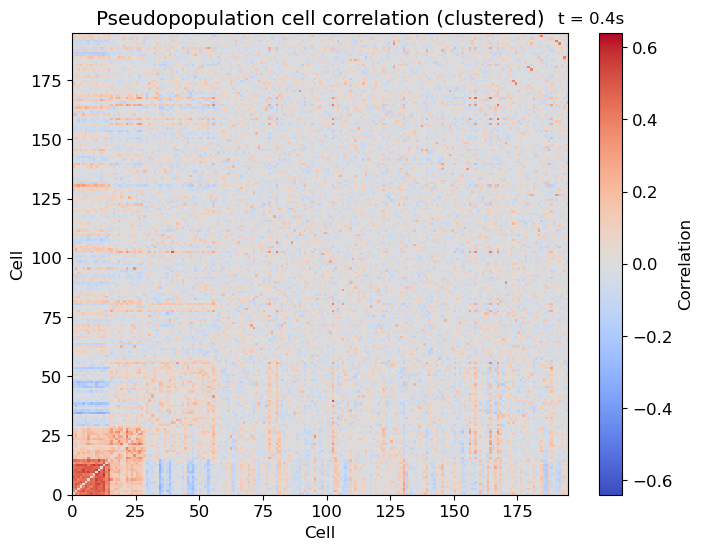

In [778]:
# Plot the original correlation matrix with clustered variables
sorted_indices = np.argsort(clusters)
cell_correlation_clustered = np.array([cell_correlation[t][sorted_indices][:,sorted_indices] for t in range(num_timebins_ext)])

fig, ax = plt.subplots(figsize=(8, 6))
plt.title('Pseudopopulation cell correlation (clustered)')

timebin = 34
im = ax.pcolormesh(cell_correlation_clustered[timebin], cmap='coolwarm', vmin=-axlim, vmax=axlim)
cbar = plt.colorbar(im, ax=ax, label='Correlation')

ax.set_xlabel('Cell')
ax.set_ylabel('Cell')

tstamp = ax.text(0.98, 1.02, f't = {0.1 * timebin - 3:.1f}s', transform=ax.transAxes)

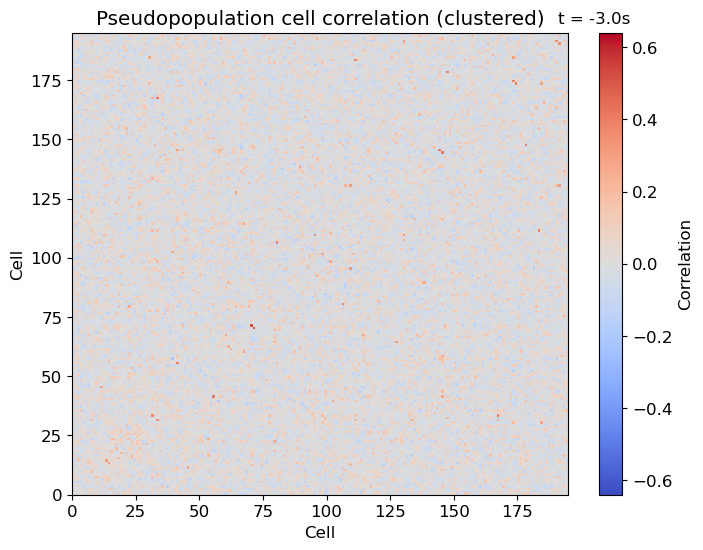

In [155]:
fig, ax = plt.subplots(figsize=(8, 6))
plt.title('Pseudopopulation cell correlation (clustered)')

# Set colormap axis limits to +- 99th percentile across all timebins
axlim = np.round(np.max([np.abs(np.max(np.percentile(cell_correlation_clustered, 99, axis=0))), np.abs(np.min(np.percentile(cell_correlation_clustered, 1, axis=0)))]), 2)

timebin = 0
im = ax.pcolormesh(cell_correlation_clustered[timebin], cmap='coolwarm', vmin=-axlim, vmax=axlim)
cbar = plt.colorbar(im, ax=ax, label='Correlation')

ax.set_xlabel('Cell')
ax.set_ylabel('Cell')

tstamp = ax.text(0.98, 1.02, '', transform=ax.transAxes)

def update(frame):
    im.set_array(cell_correlation_clustered[frame])
    tstamp.set_text(f't = {0.1 * frame - 3:.1f}s')

ani = FuncAnimation(fig, update, frames=50, interval=1000, blit=False, repeat=True)
HTML(ani.to_html5_video())

if to_save:
    if not os.path.exists(figsave_dir):
        os.makedirs(figsave_dir)
    ani.save(f'{figsave_dir}/cell_correlation_clustered_{save_name}.mp4', writer='ffmpeg')

Extracting clusters from pseudopopulation

In [35]:
# Take subset of cells from clusters 1 & 2 in the correlation matrix
cell_filter_3 = np.zeros(num_cells_filt)
cell_filter_3[np.where(clusters != 4)] = 1
num_cells_subset = np.sum(cell_filter_3, dtype=int)
num_cells_subset

55

In [36]:
# Take subset of cells from non-noise clusters in the correlation matrix
cell_filter_3 = np.zeros(num_cells_filt).astype(bool)
cell_filter_3[np.where(clusters != 3)] = 1
num_cells_subset = np.sum(cell_filter_3, dtype=int)

combined_spikerates_iti_cue_subset = combined_spikerates_iti_cue_filt[:,:,cell_filter_3]
combined_spikerates_iti_cue_subset_per_traj = {traj: list() for traj in trajectories}
for i, trial in enumerate(combined_spikerates_iti_cue_subset):
    traj = tuple(combined_trajectories_iti_cue[i])
    combined_spikerates_iti_cue_subset_per_traj[traj].append(trial)
for traj, trials in combined_spikerates_iti_cue_subset_per_traj.items():
    combined_spikerates_iti_cue_subset_per_traj[traj] = np.stack(trials)

subset_cell_idxs = np.where(cell_filter_3)[0]

In [37]:
# Get all other cells not in the subset
# remain_cell_idxs = np.delete(np.arange(num_all_cells), np.arange(num_all_cells)[cell_filter_2][cell_filter_3])
# cell_filter_remain = np.zeros(num_all_cells).astype(bool)
# cell_filter_remain[remain_cell_idxs] = 1
# num_cells_remain = remain_cell_idxs.shape[0]
num_cells_remain = num_cells_filt - num_cells_subset

# combined_spikerates_iti_cue_remain = combined_spikerates_iti_cue[:,:,cell_filter_remain]
combined_spikerates_iti_cue_remain = combined_spikerates_iti_cue_filt[:,:,~cell_filter_3]
combined_spikerates_iti_cue_remain_per_traj = {traj: list() for traj in trajectories}
for i, trial in enumerate(combined_spikerates_iti_cue_remain):
    traj = tuple(combined_trajectories_iti_cue[i])
    combined_spikerates_iti_cue_remain_per_traj[traj].append(trial)
for traj, trials in combined_spikerates_iti_cue_remain_per_traj.items():
    combined_spikerates_iti_cue_remain_per_traj[traj] = np.stack(trials)

In [38]:
# Get cells from cluster 1
cluster_1_cells = np.zeros(num_cells_filt).astype(bool)
cluster_1_cells[np.where(clusters == 1)] = 1
num_cells_clust1 = np.sum(cluster_1_cells, dtype=int)

combined_spikerates_iti_cue_clust1 = combined_spikerates_iti_cue_filt[:,:,cluster_1_cells]
combined_spikerates_iti_cue_clust1_per_traj = {traj: list() for traj in trajectories}
for i, trial in enumerate(combined_spikerates_iti_cue_clust1):
    traj = tuple(combined_trajectories_iti_cue[i])
    combined_spikerates_iti_cue_clust1_per_traj[traj].append(trial)
for traj, trials in combined_spikerates_iti_cue_clust1_per_traj.items():
    combined_spikerates_iti_cue_clust1_per_traj[traj] = np.stack(trials)

# Get cells from cluster 2
cluster_2_cells = np.zeros(num_cells_filt).astype(bool)
cluster_2_cells[np.where(clusters == 2)] = 1
num_cells_clust2 = np.sum(cluster_2_cells, dtype=int)

combined_spikerates_iti_cue_clust2 = combined_spikerates_iti_cue_filt[:,:,cluster_2_cells]
combined_spikerates_iti_cue_clust2_per_traj = {traj: list() for traj in trajectories}
for i, trial in enumerate(combined_spikerates_iti_cue_clust2):
    traj = tuple(combined_trajectories_iti_cue[i])
    combined_spikerates_iti_cue_clust2_per_traj[traj].append(trial)
for traj, trials in combined_spikerates_iti_cue_clust2_per_traj.items():
    combined_spikerates_iti_cue_clust2_per_traj[traj] = np.stack(trials)

# Get cells from cluster 3
cluster_3_cells = np.zeros(num_cells_filt).astype(bool)
cluster_3_cells[np.where(clusters == 3)] = 1
num_cells_clust3 = np.sum(cluster_3_cells, dtype=int)

combined_spikerates_iti_cue_clust3 = combined_spikerates_iti_cue_filt[:,:,cluster_3_cells]
combined_spikerates_iti_cue_clust3_per_traj = {traj: list() for traj in trajectories}
for i, trial in enumerate(combined_spikerates_iti_cue_clust3):
    traj = tuple(combined_trajectories_iti_cue[i])
    combined_spikerates_iti_cue_clust3_per_traj[traj].append(trial)
for traj, trials in combined_spikerates_iti_cue_clust3_per_traj.items():
    combined_spikerates_iti_cue_clust3_per_traj[traj] = np.stack(trials)

Trial-averaged, windowed firing rate correlation

In [73]:
### Reassemble pseudopopulation responses for 50 ms time bins
all_spikerates_iti_cue = list()
all_trajectories_cue = list()

for day in day_list:
    with open(f'data/combined_50ms/{day}_data.pkl', 'rb') as file:
        data = pickle.load(file)
        # Drop the first trial from each day's dataset
        cue_data = data['cue_50ms']['spikerates_cue'][1:]
        # Drop the last iti, tag itis to the next trial's cue phase
        iti_data = data['iti_50ms']['spikerates_iti'][:-1]
        # Drop the last navend, tag navends to the next trial's cue phase
        navend_data = data['navend_50ms']['spikerates_navend'][:-1]
        # Drop the first navst
        navst_data = data['navst_50ms']['spikerates_navst'][1:]
        for i in range(len(iti_data)):
            iti_data[i] = np.concatenate([navend_data[i], iti_data[i], cue_data[i], navst_data[i]], axis=0)
        all_spikerates_iti_cue.append(iti_data)
        all_trajectories_cue.append(data['cue_50ms']['trajectories_cue'][1:])

## Bootstrap sessions to some minimum number of trials per trajectory
# Get target and lower bound (to drop sessions) of number of trials per trajectory
target_num_trials = np.percentile(num_trials_per_trajectory_per_sess, 25, axis=0).astype(int)
min_num_trials = (0.67 * target_num_trials).astype(int)

# Mark out sessions with at least 1 trajectory that falls below required min number of trials
sessions_to_keep = set()
for s in range(num_sess):
    if np.all(num_trials_per_trajectory_per_sess[s,:] >= min_num_trials):
        sessions_to_keep.add(s)

# Append cells from each session to form a pseudopopulation, and append in chronological order on responses grouped by trajectories
# But rather than dropping trials to the minimum number of observations for the given trajectory type, try to bootstrap up to the same average number of trials per trajectory
all_spikerates_iti_cue_per_traj = list()
for i in range(num_sess):
    all_spikerates_iti_cue_per_traj.append(group_by_trajectory(all_spikerates_iti_cue[i], all_trajectories_cue[i]))

combined_spikerates_iti_cue_per_traj_50ms = {key: list() for key in trajectories}
num_timebins_ext_50ms = 100
for t, traj in enumerate(trajectories):
    # Set number of average trials per trajectory to meet
    trials_data = [sess[traj] for s, sess in enumerate(all_spikerates_iti_cue_per_traj) if s in sessions_to_keep]
    for i, sess in enumerate(trials_data):
        # num_trials_in_sess = len(sess)
        if len(sess) < target_num_trials[t]:
            # Bootstrap trials of this session if the number of obs is less than the required amount
            trials_data[i] = bootstrapping(sess, target_num_trials[t])
    for trial in range(target_num_trials[t]):
        for i, sess in enumerate(trials_data):
            if sess[trial].shape[0] > num_timebins_ext_50ms:
                # Trim the length of the observation to __ time bins
                trials_data[i][trial] = sess[trial][:num_timebins_ext_50ms,:]
        combined_spikerates_iti_cue_per_traj_50ms[traj].append(np.hstack([sess[trial] for sess in trials_data]))

# Filter out cells not in good_cell_labels
cell_filter = np.array([idx for idx, cell in enumerate(all_cell_labels) if cell in set(good_cell_labels)])
for traj, data in combined_spikerates_iti_cue_per_traj_50ms.items():
    for n, trial in enumerate(data):
        data[n] = trial[:,cell_filter]

# Array axes: observation, timebin, cell
combined_spikerates_iti_cue_50ms = np.empty((0, num_timebins_ext_50ms, num_all_cells))
for (s, g) in trajectories:
    combined_spikerates_iti_cue_50ms = np.concatenate([combined_spikerates_iti_cue_50ms, np.stack(combined_spikerates_iti_cue_per_traj_50ms[(s, g)])], axis=0)

# Clean up large memory variables
del all_spikerates_iti_cue
del all_trajectories_cue
del all_spikerates_iti_cue_per_traj

In [74]:
# Get trial-averaged firing rate per timebin per cell, then create time window of +- 1 timebin
combined_spikerates_iti_cue_trialavg = np.mean(combined_spikerates_iti_cue_50ms, axis=0)

window_size = 2  # number of timebins before/after to take
combined_spikerates_iti_cue_windowed = np.empty((2*window_size+1, num_timebins_ext-2*int(window_size/2), num_all_cells))
for t in range(int(window_size/2), num_timebins_ext-int(window_size/2)):
    combined_spikerates_iti_cue_windowed[:,t-int(window_size/2),:] = combined_spikerates_iti_cue_trialavg[2*t-window_size:2*t+window_size+1,:]

# Compute correlation between cells
cell_correlation_v2 = list()
for timebin in range(num_timebins_ext-2*int(window_size/2)):
    cell_correlation_v2.append(np.corrcoef(combined_spikerates_iti_cue_windowed[:,timebin,:], rowvar=False))
cell_correlation_v2 = np.array(cell_correlation_v2)

# Set correlation matrix diagonal to zero
for t in range(num_timebins_ext-2*int(window_size/2)):
    for c in range(num_all_cells):
        cell_correlation_v2[t,c,c] = 0

/Users/jcheng/miniconda3/envs/decoding/lib/python3.10/site-packages/numpy/lib/function_base.py:2829: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[:, None]
/Users/jcheng/miniconda3/envs/decoding/lib/python3.10/site-packages/numpy/lib/function_base.py:2830: RuntimeWarning: invalid value encountered in true_divide
  c /= stddev[None, :]


In [75]:
# Create time window of +- 1 timebin, compute correlation per trial and average correlations across trials
num_trials = combined_spikerates_iti_cue_50ms.shape[0]
window_size = 2  # number of timebins before/after to take
combined_spikerates_iti_cue_windowed = np.empty((num_trials, 2*window_size+1, num_timebins_ext-2*int(window_size/2), num_all_cells))
for t in range(int(window_size/2), num_timebins_ext-int(window_size/2)):
    combined_spikerates_iti_cue_windowed[:,:,t-int(window_size/2),:] = combined_spikerates_iti_cue_50ms[:,2*t-window_size:2*t+window_size+1,:]

# Compute correlation between cells for each trial
cell_correlation_v2 = list()
for trial in range(num_trials):
    cell_correlation_trial = list()
    for timebin in range(num_timebins_ext-2*int(window_size/2)):
        cell_correlation_trial.append(np.corrcoef(combined_spikerates_iti_cue_windowed[trial,:,timebin,:], rowvar=False))
    cell_correlation_v2.append(np.array(cell_correlation_trial))

# Take average cell correlation across all trials
cell_correlation_v2 = np.nanmean(np.array(cell_correlation_v2), axis=0)

# Set correlation matrix diagonal to zero
for t in range(num_timebins_ext-2*int(window_size/2)):
    for c in range(num_all_cells):
        cell_correlation_v2[t,c,c] = 0

/var/folders/x9/1nq85w8s11l0sv1yqg3364200000h2/T/ipykernel_10321/222028378.py:17: RuntimeWarning: Mean of empty slice
  cell_correlation_v2 = np.nanmean(np.array(cell_correlation_v2), axis=0)


/Users/jcheng/miniconda3/envs/decoding/lib/python3.10/site-packages/numpy/lib/nanfunctions.py:1584: RuntimeWarning: All-NaN slice encountered
  result = np.apply_along_axis(_nanquantile_1d, axis, a, q,


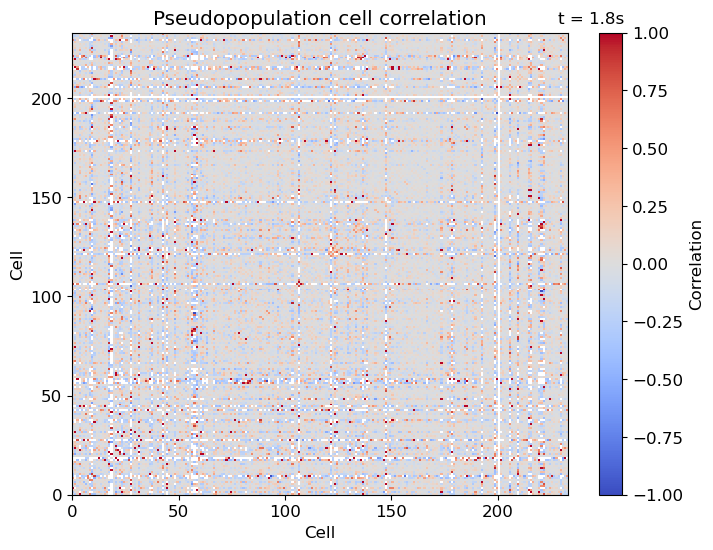

In [2282]:
fig, ax = plt.subplots(figsize=(8, 6))
plt.title('Pseudopopulation cell correlation')

# Set colormap axis limits to +- 99th percentile across all timebins
axlim = np.round(np.max([np.abs(np.max(np.nanpercentile(cell_correlation_v2, 99, axis=0))), np.abs(np.min(np.nanpercentile(cell_correlation_v2, 1, axis=0)))]), 2)

timebin = 0
im = ax.pcolormesh(cell_correlation_v2[timebin], cmap='coolwarm', vmin=-1, vmax=1)
cbar = plt.colorbar(im, ax=ax, label='Correlation')

ax.set_xlabel('Cell')
ax.set_ylabel('Cell')

tstamp = ax.text(0.98, 1.02, '', transform=ax.transAxes)

def update(frame):
    im.set_array(cell_correlation_v2[frame])
    tstamp.set_text(f't = {0.1 * frame - 2.9:.1f}s')

ani = FuncAnimation(fig, update, frames=48, interval=1000, blit=False, repeat=True)
HTML(ani.to_html5_video())

if to_save:
    if not os.path.exists(figsave_dir):
        os.makedirs(figsave_dir)
    ani.save(f'{figsave_dir}/cell_correlation_v2_{save_name}.mp4', writer='ffmpeg')

In [76]:
# Filter out cells that have NaNs in the correlation matrix
cell_filter_2 = np.ones(num_all_cells).astype(bool)
for timebin in range(num_timebins_ext-2*int(window_size/2)):
    idxs = np.where(np.isnan(cell_correlation_v2[timebin,:,0]))
    cell_filter_2[idxs] = 0
num_cells_filt_v2 = np.sum(cell_filter_2, dtype=int)

# combined_spikerates_iti_cue_windowed_filt = combined_spikerates_iti_cue_windowed[:,:,cell_filter_2]
combined_spikerates_iti_cue_windowed_filt = combined_spikerates_iti_cue_windowed[:,:,:,cell_filter_2]
combined_spikerates_iti_cue_filt_v2 = combined_spikerates_iti_cue[:,:,cell_filter_2]
filtered_cell_idxs = np.where(~cell_filter_2)[0]

# Rerun correlation between cells, this time without the cells producing NaNs
# cell_correlation_v2 = list()
# for timebin in range(num_timebins_ext-2*window_size):
#     cell_correlation_v2.append(np.corrcoef(combined_spikerates_iti_cue_windowed_filt[:,timebin,:], rowvar=False))
# cell_correlation_v2 = np.array(cell_correlation_v2)

cell_correlation_v2 = list()
for trial in range(num_trials):
    cell_correlation_trial = list()
    for timebin in range(num_timebins_ext-2*int(window_size/2)):
        cell_correlation_trial.append(np.corrcoef(combined_spikerates_iti_cue_windowed_filt[trial,:,timebin,:], rowvar=False))
    cell_correlation_v2.append(np.array(cell_correlation_trial))

# Take average cell correlation across all trials, replace remaining nans with zeros
cell_correlation_v2 = np.nan_to_num(np.nanmean(np.array(cell_correlation_v2), axis=0))

# Set correlation matrix diagonal to zero
for t in range(num_timebins_ext-2*int(window_size/2)):
    for c in range(num_cells_filt_v2):
        cell_correlation_v2[t,c,c] = 0

/var/folders/x9/1nq85w8s11l0sv1yqg3364200000h2/T/ipykernel_10321/3311811565.py:27: RuntimeWarning: Mean of empty slice
  cell_correlation_v2 = np.nan_to_num(np.nanmean(np.array(cell_correlation_v2), axis=0))


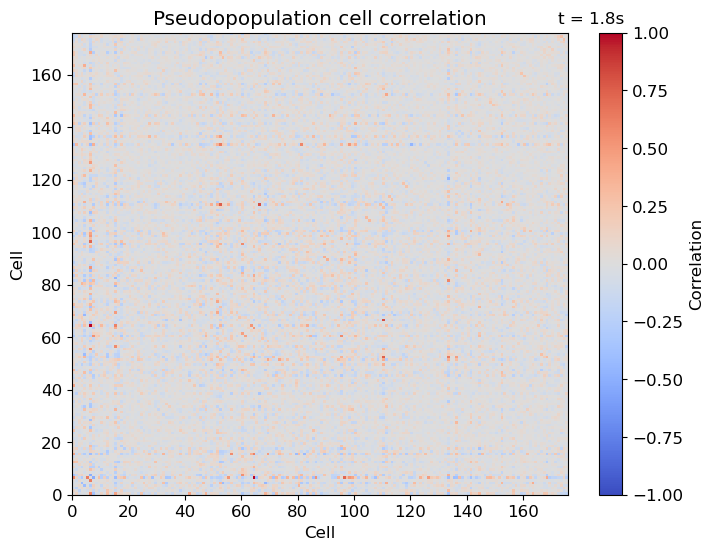

In [2284]:
fig, ax = plt.subplots(figsize=(8, 6))
plt.title('Pseudopopulation cell correlation')

# Set colormap axis limits to +- 99th percentile across all timebins
axlim = np.round(np.max([np.abs(np.max(np.percentile(cell_correlation_v2, 99, axis=0))), np.abs(np.min(np.percentile(cell_correlation_v2, 1, axis=0)))]), 2)

timebin = 0
im = ax.pcolormesh(cell_correlation_v2[timebin], cmap='coolwarm', vmin=-1, vmax=1)
cbar = plt.colorbar(im, ax=ax, label='Correlation')

ax.set_xlabel('Cell')
ax.set_ylabel('Cell')

tstamp = ax.text(0.98, 1.02, '', transform=ax.transAxes)

def update(frame):
    im.set_array(cell_correlation_v2[frame])
    tstamp.set_text(f't = {0.1 * frame - 2.9:.1f}s')

ani = FuncAnimation(fig, update, frames=48, interval=1000, blit=False, repeat=True)
HTML(ani.to_html5_video())

if to_save:
    if not os.path.exists(figsave_dir):
        os.makedirs(figsave_dir)
    ani.save(f'{figsave_dir}/cell_correlation_v2_{save_name}.mp4', writer='ffmpeg')

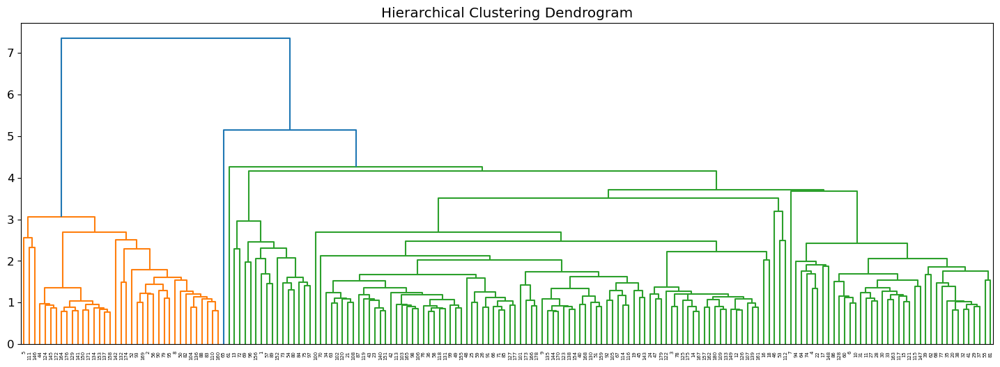

Cluster Assignments: [2 1 2 2 1 2 2 1 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2 2
 2 2 2 2 2 2 1 2 2 2 2 2 1 2 1 2 2 2 1 2 2 2 2 2 2 2 2 3 2 2 2 2 2 2 2 2 2
 2 2 2 2 1 2 2 1 1 2 2 2 2 1 2 1 2 2 1 2 1 2 2 2 2 2 2 2 2 1 2 2 2 2 2 1 1
 2 2 2 2 2 2 2 2 2 2 2 2 1 2 2 2 2 1 2 2 1 2 1 2 1 1 2 2 2 1 1 2 2 1 1 2 2
 2 1 2 2 1 2 2 2 2 1 2 1 2 2 2 1 2 2 2 2 1 2 1 1 2 1 2 1 2 2 2 2]


In [77]:
# Perform hierarchical clustering
timebin = 32  # 0.4 s timebin
linkage_matrix = linkage(cell_correlation_v2[timebin], method='ward')

# Plot the dendrogram
plt.figure(figsize=(18, 6))
dendrogram(linkage_matrix, labels=np.arange(1, num_cells_filt_v2 + 1))
plt.title('Hierarchical Clustering Dendrogram')
plt.show()

# Set the number of clusters and cut the dendrogram to extract clusters
num_clusters = 3
clusters_v2 = fcluster(linkage_matrix, num_clusters, criterion='maxclust')

# Display the cluster assignments
print("Cluster Assignments:", clusters_v2)

In [78]:
# Perform k-means clustering
num_clusters = 2
timebin = 32  # cluster based on the correlation matrix of t=0.4s

kmeans = KMeans(n_clusters=num_clusters)
kmeans.fit(cell_correlation_v2[timebin])
clusters_v2 = kmeans.labels_

# Relabel clusters according to size (smallest cluster as 1, largest cluster as 3), and convert labels to 1-indexing
cluster_sizes = np.bincount(clusters_v2)
sorted_clusters = np.argsort(cluster_sizes)
cluster_remapping = {old_label: new_label for new_label, old_label in enumerate(sorted_clusters, start=1)}
clusters_v2 = np.array([cluster_remapping[label] for label in clusters_v2])

In [2273]:
clusters_v2

array([2, 1, 2, 2, 1, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1,
       2, 2, 1, 2, 2, 1, 2, 1, 2, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
       2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 1, 1, 2, 2, 2, 2, 1,
       2, 2, 2, 2, 1, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 2, 2, 1, 1,
       1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 1, 2, 1, 1, 2, 2, 2,
       1, 1, 2, 1, 1, 2, 2, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 2, 2, 1, 1,
       1, 2, 2, 2, 1, 2, 1, 2, 2, 1, 1, 2, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2])

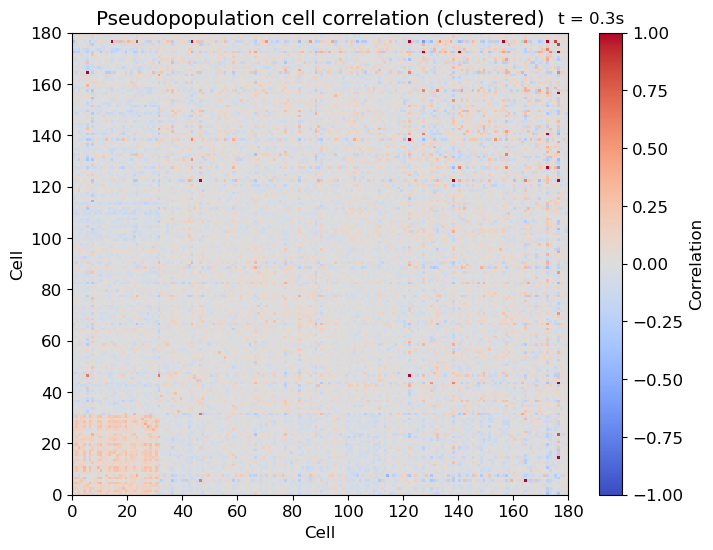

In [79]:
# Plot the original correlation matrix with clustered variables
sorted_indices = np.argsort(clusters_v2)
cell_correlation_v2_clustered = np.array([cell_correlation_v2[t][sorted_indices][:, sorted_indices] for t in range(num_timebins_ext-2*int(window_size/2))])

fig, ax = plt.subplots(figsize=(8, 6))
plt.title('Pseudopopulation cell correlation (clustered)')

# Set colormap axis limits to +- 99th percentile across all timebins
axlim = np.round(np.max([np.abs(np.max(np.percentile(cell_correlation_v2, 99, axis=0))), np.abs(np.min(np.percentile(cell_correlation_v2, 1, axis=0)))]), 2)

timebin = 32
im = ax.pcolormesh(cell_correlation_v2_clustered[timebin], cmap='coolwarm', vmin=-axlim, vmax=axlim)
cbar = plt.colorbar(im, ax=ax, label='Correlation')

ax.set_xlabel('Cell')
ax.set_ylabel('Cell')

tstamp = ax.text(0.98, 1.02, f't = {0.1 * timebin - 2.9:.1f}s', transform=ax.transAxes)

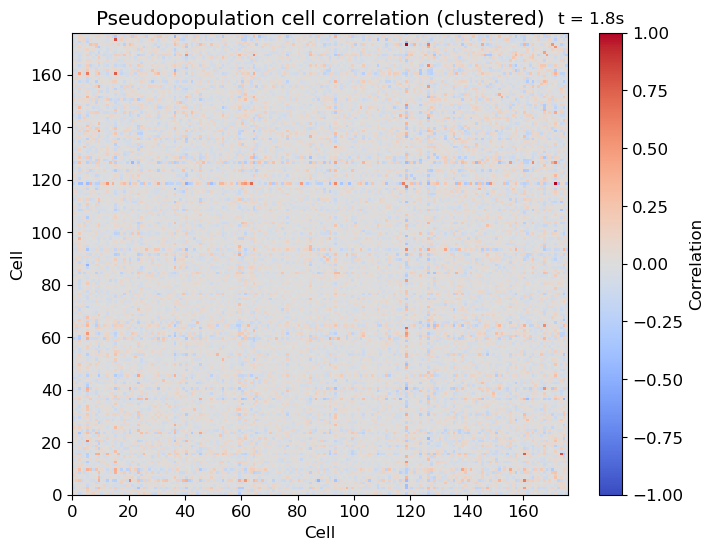

In [2287]:
fig, ax = plt.subplots(figsize=(8, 6))
plt.title('Pseudopopulation cell correlation (clustered)')

# Set colormap axis limits to +- 99th percentile across all timebins
axlim = np.round(np.max([np.abs(np.max(np.percentile(cell_correlation_v2, 99, axis=0))), np.abs(np.min(np.percentile(cell_correlation_v2, 1, axis=0)))]), 2)

timebin = 0
im = ax.pcolormesh(cell_correlation_v2_clustered[timebin], cmap='coolwarm', vmin=-1, vmax=1)
cbar = plt.colorbar(im, ax=ax, label='Correlation')

ax.set_xlabel('Cell')
ax.set_ylabel('Cell')

tstamp = ax.text(0.98, 1.02, '', transform=ax.transAxes)

def update(frame):
    im.set_array(cell_correlation_v2_clustered[frame])
    tstamp.set_text(f't = {0.1 * frame - 2.9:.1f}s')

ani = FuncAnimation(fig, update, frames=48, interval=1000, blit=False, repeat=True)
HTML(ani.to_html5_video())

if to_save:
    if not os.path.exists(figsave_dir):
        os.makedirs(figsave_dir)
    ani.save(f'{figsave_dir}/cell_correlation_v2_clustered_{save_name}.mp4', writer='ffmpeg')

In [80]:
# Get cells from cluster 1
cluster_1_cells = np.zeros(num_cells_filt_v2).astype(bool)
cluster_1_cells[np.where(clusters_v2 == 1)] = 1
num_cells_clust1 = np.sum(cluster_1_cells, dtype=int)

combined_spikerates_iti_cue_clust1 = combined_spikerates_iti_cue_filt_v2[:,:,cluster_1_cells]
combined_spikerates_iti_cue_clust1_per_traj = {traj: list() for traj in trajectories}
for i, trial in enumerate(combined_spikerates_iti_cue_clust1):
    traj = tuple(combined_trajectories_iti_cue[i])
    combined_spikerates_iti_cue_clust1_per_traj[traj].append(trial)
for traj, trials in combined_spikerates_iti_cue_clust1_per_traj.items():
    combined_spikerates_iti_cue_clust1_per_traj[traj] = np.stack(trials)

# Get cells from cluster 2 (remaining cells)
cluster_2_cells = np.zeros(num_cells_filt_v2).astype(bool)
cluster_2_cells[np.where(clusters_v2 != 1)] = 1
num_cells_clust2 = np.sum(cluster_2_cells, dtype=int)

combined_spikerates_iti_cue_clust2 = combined_spikerates_iti_cue_filt_v2[:,:,cluster_2_cells]
combined_spikerates_iti_cue_clust2_per_traj = {traj: list() for traj in trajectories}
for i, trial in enumerate(combined_spikerates_iti_cue_clust2):
    traj = tuple(combined_trajectories_iti_cue[i])
    combined_spikerates_iti_cue_clust2_per_traj[traj].append(trial)
for traj, trials in combined_spikerates_iti_cue_clust2_per_traj.items():
    combined_spikerates_iti_cue_clust2_per_traj[traj] = np.stack(trials)

#### Cell subset goal & start decoding

In [39]:
# Rerun LDA decoding on cluster 1 cells
lda_goal_accuracy_iti_cue_clust1_timebins = np.zeros((num_timebins_ext, k_fold))
lda_goal_confusion_iti_cue_clust1_timebins = np.zeros((num_timebins_ext, num_goals, num_goals))
lda_start_accuracy_iti_cue_clust1_timebins = np.zeros((num_timebins_ext, k_fold))
lda_start_confusion_iti_cue_clust1_timebins = np.zeros((num_timebins_ext, num_goals, num_goals))
lda_traj_accuracy_iti_cue_clust1_timebins = np.zeros((num_timebins_ext, k_fold))
lda_traj_confusion_iti_cue_clust1_timebins = np.zeros((num_timebins_ext, len(trajectories), len(trajectories)))

k_fold = 10
for k in range(num_timebins_ext):
    for i in range(k_fold):
        # Goal
        X_train, X_test, y_train, y_test = train_test_split(combined_spikerates_iti_cue_clust1[:,k,:], combined_goals_cue_lda_timebins, (i, k_fold))
        lda = LinearDiscriminantAnalysis()
        lda.fit(X_train, y_train)
        y_pred = lda.predict(X_test)
        lda_goal_accuracy_iti_cue_clust1_timebins[k,i] = prediction_accuracy(y_pred, y_test)
        lda_goal_confusion_iti_cue_clust1_timebins[k,:,:] += confusion_matrix(y_pred, y_test, num_goals)

        # Start
        X_train, X_test, y_train, y_test = train_test_split(combined_spikerates_iti_cue_clust1[:,k,:], combined_starts_cue_lda_timebins, (i, k_fold))
        lda = LinearDiscriminantAnalysis()
        lda.fit(X_train, y_train)
        y_pred = lda.predict(X_test)
        lda_start_accuracy_iti_cue_clust1_timebins[k,i] = prediction_accuracy(y_pred, y_test)
        lda_start_confusion_iti_cue_clust1_timebins[k,:,:] += confusion_matrix(y_pred, y_test, num_goals)

        # Trajectory
        X_train, X_test, y_train, y_test = train_test_split(combined_spikerates_iti_cue_clust1[:,k,:], combined_trajs_cue_lda_timebins, (i, k_fold))
        lda = LinearDiscriminantAnalysis()
        lda.fit(X_train, y_train)
        y_pred = lda.predict(X_test)
        lda_traj_accuracy_iti_cue_clust1_timebins[k,i] = prediction_accuracy(y_pred, y_test)
        lda_traj_confusion_iti_cue_clust1_timebins[k,:,:] += confusion_matrix(y_pred+1, y_test+1, len(trajectories))


# Rerun LDA decoding on cluster 2 cells
lda_goal_accuracy_iti_cue_clust2_timebins = np.zeros((num_timebins_ext, k_fold))
lda_goal_confusion_iti_cue_clust2_timebins = np.zeros((num_timebins_ext, num_goals, num_goals))
lda_start_accuracy_iti_cue_clust2_timebins = np.zeros((num_timebins_ext, k_fold))
lda_start_confusion_iti_cue_clust2_timebins = np.zeros((num_timebins_ext, num_goals, num_goals))
lda_traj_accuracy_iti_cue_clust2_timebins = np.zeros((num_timebins_ext, k_fold))
lda_traj_confusion_iti_cue_clust2_timebins = np.zeros((num_timebins_ext, len(trajectories), len(trajectories)))

k_fold = 10
for k in range(num_timebins_ext):
    for i in range(k_fold):
        # Goal
        X_train, X_test, y_train, y_test = train_test_split(combined_spikerates_iti_cue_clust2[:,k,:], combined_goals_cue_lda_timebins, (i, k_fold))
        lda = LinearDiscriminantAnalysis()
        lda.fit(X_train, y_train)
        y_pred = lda.predict(X_test)
        lda_goal_accuracy_iti_cue_clust2_timebins[k,i] = prediction_accuracy(y_pred, y_test)
        lda_goal_confusion_iti_cue_clust2_timebins[k,:,:] += confusion_matrix(y_pred, y_test, num_goals)

        # Start
        X_train, X_test, y_train, y_test = train_test_split(combined_spikerates_iti_cue_clust2[:,k,:], combined_starts_cue_lda_timebins, (i, k_fold))
        lda = LinearDiscriminantAnalysis()
        lda.fit(X_train, y_train)
        y_pred = lda.predict(X_test)
        lda_start_accuracy_iti_cue_clust2_timebins[k,i] = prediction_accuracy(y_pred, y_test)
        lda_start_confusion_iti_cue_clust2_timebins[k,:,:] += confusion_matrix(y_pred, y_test, num_goals)

        # Trajectory
        X_train, X_test, y_train, y_test = train_test_split(combined_spikerates_iti_cue_clust2[:,k,:], combined_trajs_cue_lda_timebins, (i, k_fold))
        lda = LinearDiscriminantAnalysis()
        lda.fit(X_train, y_train)
        y_pred = lda.predict(X_test)
        lda_traj_accuracy_iti_cue_clust2_timebins[k,i] = prediction_accuracy(y_pred, y_test)
        lda_traj_confusion_iti_cue_clust2_timebins[k,:,:] += confusion_matrix(y_pred+1, y_test+1, len(trajectories))


# Rerun LDA decoding on cluster 3 cells
lda_goal_accuracy_iti_cue_clust3_timebins = np.zeros((num_timebins_ext, k_fold))
lda_goal_confusion_iti_cue_clust3_timebins = np.zeros((num_timebins_ext, num_goals, num_goals))
lda_start_accuracy_iti_cue_clust3_timebins = np.zeros((num_timebins_ext, k_fold))
lda_start_confusion_iti_cue_clust3_timebins = np.zeros((num_timebins_ext, num_goals, num_goals))
lda_traj_accuracy_iti_cue_clust3_timebins = np.zeros((num_timebins_ext, k_fold))
lda_traj_confusion_iti_cue_clust3_timebins = np.zeros((num_timebins_ext, len(trajectories), len(trajectories)))

k_fold = 10
for k in range(num_timebins_ext):
    for i in range(k_fold):
        # Goal
        X_train, X_test, y_train, y_test = train_test_split(combined_spikerates_iti_cue_clust3[:,k,:], combined_goals_cue_lda_timebins, (i, k_fold))
        lda = LinearDiscriminantAnalysis()
        lda.fit(X_train, y_train)
        y_pred = lda.predict(X_test)
        lda_goal_accuracy_iti_cue_clust3_timebins[k,i] = prediction_accuracy(y_pred, y_test)
        lda_goal_confusion_iti_cue_clust3_timebins[k,:,:] += confusion_matrix(y_pred, y_test, num_goals)

        # Start
        X_train, X_test, y_train, y_test = train_test_split(combined_spikerates_iti_cue_clust3[:,k,:], combined_starts_cue_lda_timebins, (i, k_fold))
        lda = LinearDiscriminantAnalysis()
        lda.fit(X_train, y_train)
        y_pred = lda.predict(X_test)
        lda_start_accuracy_iti_cue_clust3_timebins[k,i] = prediction_accuracy(y_pred, y_test)
        lda_start_confusion_iti_cue_clust3_timebins[k,:,:] += confusion_matrix(y_pred, y_test, num_goals)

        # Trajectory
        X_train, X_test, y_train, y_test = train_test_split(combined_spikerates_iti_cue_clust3[:,k,:], combined_trajs_cue_lda_timebins, (i, k_fold))
        lda = LinearDiscriminantAnalysis()
        lda.fit(X_train, y_train)
        y_pred = lda.predict(X_test)
        lda_traj_accuracy_iti_cue_clust3_timebins[k,i] = prediction_accuracy(y_pred, y_test)
        lda_traj_confusion_iti_cue_clust3_timebins[k,:,:] += confusion_matrix(y_pred+1, y_test+1, len(trajectories))

In [40]:
axlims = (0, 1)

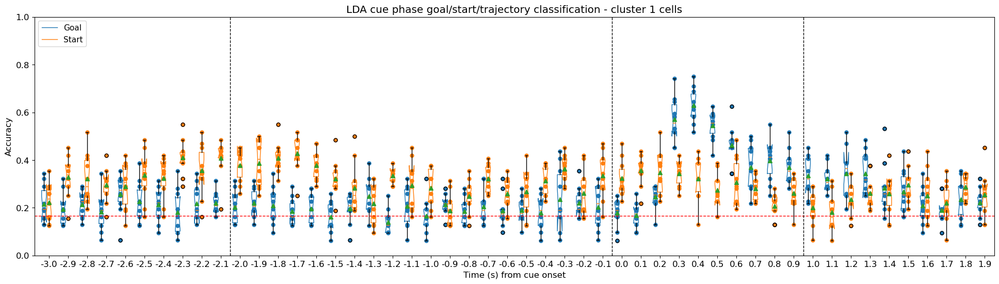

In [156]:
plt.figure(figsize=(24, 6))
plt.title(f'LDA cue phase goal/start/trajectory classification - cluster 1 cells')

# Plot as series of boxplots
bar_width = 0.25
bp1 = plt.boxplot(lda_goal_accuracy_iti_cue_clust1_timebins.T, positions=np.arange(1, num_timebins_ext+1)-bar_width, widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C0'}, flierprops={'marker': 'o', 'markersize': 5})
bp2 = plt.boxplot(lda_start_accuracy_iti_cue_clust1_timebins.T, positions=np.arange(1, num_timebins_ext+1), widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C1'}, flierprops={'marker': 'o', 'markersize': 5})
topcaps1 = [cap.get_ydata()[0] for i, cap in enumerate(bp1['caps']) if i%2==1]
topcaps2 = [cap.get_ydata()[0] for i, cap in enumerate(bp2['caps']) if i%2==1]
topcaps = [max(caps) for caps in zip(topcaps1, topcaps2)]
for k in range(num_timebins_ext):
    plt.scatter(np.ones_like(lda_goal_accuracy_iti_cue_clust1_timebins[k,:]) + k - bar_width, lda_goal_accuracy_iti_cue_clust1_timebins[k,:], s=25, color='C0')
    plt.scatter(np.ones_like(lda_start_accuracy_iti_cue_clust1_timebins[k,:]) + k, lda_start_accuracy_iti_cue_clust1_timebins[k,:], s=25, color='C1')

plt.ylim(axlims)
plt.axhline(y=1/6, color='r', linewidth=1, linestyle='--')
plt.axvline(x=10.5, color='k', linewidth=1, linestyle='--')
plt.axvline(x=30.5, color='k', linewidth=1, linestyle='--')
plt.axvline(x=40.5, color='k', linewidth=1, linestyle='--')
plt.xticks(np.arange(1, num_timebins_ext+1), labels=[f'{n:.1f}' for n in np.concatenate([np.arange(-3, 0, 0.1), np.arange(0, 2, 0.1)])])
plt.xlabel('Time (s) from cue onset')
plt.ylabel('Accuracy')
plt.legend([bp1['boxes'][0], bp2['boxes'][0]], ['Goal', 'Start'], loc='upper left', fontsize=11)

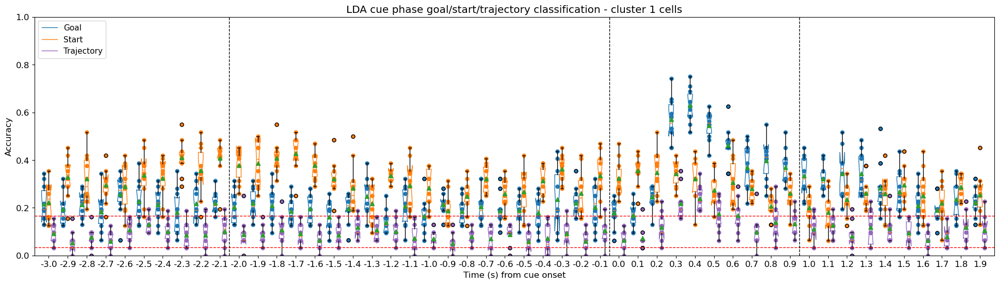

In [157]:
plt.figure(figsize=(24, 6))
plt.title(f'LDA cue phase goal/start/trajectory classification - cluster 1 cells')

# Plot as series of boxplots
bar_width = 0.25
bp1 = plt.boxplot(lda_goal_accuracy_iti_cue_clust1_timebins.T, positions=np.arange(1, num_timebins_ext+1)-bar_width, widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C0'}, flierprops={'marker': 'o', 'markersize': 5})
bp2 = plt.boxplot(lda_start_accuracy_iti_cue_clust1_timebins.T, positions=np.arange(1, num_timebins_ext+1), widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C1'}, flierprops={'marker': 'o', 'markersize': 5})
bp3 = plt.boxplot(lda_traj_accuracy_iti_cue_clust1_timebins.T, positions=np.arange(1, num_timebins_ext+1)+bar_width, widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C4'}, flierprops={'marker': 'o', 'markersize': 5})
topcaps1 = [cap.get_ydata()[0] for i, cap in enumerate(bp1['caps']) if i%2==1]
topcaps2 = [cap.get_ydata()[0] for i, cap in enumerate(bp2['caps']) if i%2==1]
topcaps3 = [cap.get_ydata()[0] for i, cap in enumerate(bp3['caps']) if i%2==1]
topcaps = [max(caps) for caps in zip(topcaps1, topcaps2, topcaps3)]
for k in range(num_timebins_ext):
    plt.scatter(np.ones_like(lda_goal_accuracy_iti_cue_clust1_timebins[k,:]) + k - bar_width, lda_goal_accuracy_iti_cue_clust1_timebins[k,:], s=25, color='C0')
    plt.scatter(np.ones_like(lda_start_accuracy_iti_cue_clust1_timebins[k,:]) + k, lda_start_accuracy_iti_cue_clust1_timebins[k,:], s=25, color='C1')
    plt.scatter(np.ones_like(lda_traj_accuracy_iti_cue_clust1_timebins[k,:]) + k + bar_width, lda_traj_accuracy_iti_cue_clust1_timebins[k,:], s=25, color='C4')

plt.ylim(axlims)
plt.axhline(y=1/6, color='r', linewidth=1, linestyle='--')
plt.axhline(y=1/30, color='r', linewidth=1, linestyle='--')
plt.axvline(x=10.5, color='k', linewidth=1, linestyle='--')
plt.axvline(x=30.5, color='k', linewidth=1, linestyle='--')
plt.axvline(x=40.5, color='k', linewidth=1, linestyle='--')
plt.xticks(np.arange(1, num_timebins_ext+1), labels=[f'{n:.1f}' for n in np.concatenate([np.arange(-3, 0, 0.1), np.arange(0, 2, 0.1)])])
plt.xlabel('Time (s) from cue onset')
plt.ylabel('Accuracy')
plt.legend([bp1['boxes'][0], bp2['boxes'][0], bp3['boxes'][0]], ['Goal', 'Start', 'Trajectory'], loc='upper left', fontsize=11)

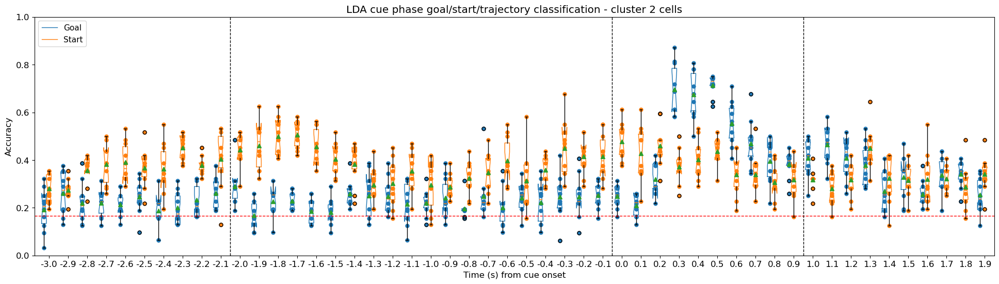

In [158]:
plt.figure(figsize=(24, 6))
plt.title(f'LDA cue phase goal/start/trajectory classification - cluster 2 cells')

# Plot as series of boxplots
bar_width = 0.25
bp1 = plt.boxplot(lda_goal_accuracy_iti_cue_clust2_timebins.T, positions=np.arange(1, num_timebins_ext+1)-bar_width, widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C0'}, flierprops={'marker': 'o', 'markersize': 5})
bp2 = plt.boxplot(lda_start_accuracy_iti_cue_clust2_timebins.T, positions=np.arange(1, num_timebins_ext+1), widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C1'}, flierprops={'marker': 'o', 'markersize': 5})
topcaps1 = [cap.get_ydata()[0] for i, cap in enumerate(bp1['caps']) if i%2==1]
topcaps2 = [cap.get_ydata()[0] for i, cap in enumerate(bp2['caps']) if i%2==1]
topcaps = [max(caps) for caps in zip(topcaps1, topcaps2)]
for k in range(num_timebins_ext):
    plt.scatter(np.ones_like(lda_goal_accuracy_iti_cue_clust2_timebins[k,:]) + k - bar_width, lda_goal_accuracy_iti_cue_clust2_timebins[k,:], s=25, color='C0')
    plt.scatter(np.ones_like(lda_start_accuracy_iti_cue_clust2_timebins[k,:]) + k, lda_start_accuracy_iti_cue_clust2_timebins[k,:], s=25, color='C1')

plt.ylim(axlims)
plt.axhline(y=1/6, color='r', linewidth=1, linestyle='--')
plt.axvline(x=10.5, color='k', linewidth=1, linestyle='--')
plt.axvline(x=30.5, color='k', linewidth=1, linestyle='--')
plt.axvline(x=40.5, color='k', linewidth=1, linestyle='--')
plt.xticks(np.arange(1, num_timebins_ext+1), labels=[f'{n:.1f}' for n in np.concatenate([np.arange(-3, 0, 0.1), np.arange(0, 2, 0.1)])])
plt.xlabel('Time (s) from cue onset')
plt.ylabel('Accuracy')
plt.legend([bp1['boxes'][0], bp2['boxes'][0]], ['Goal', 'Start'], loc='upper left', fontsize=11)

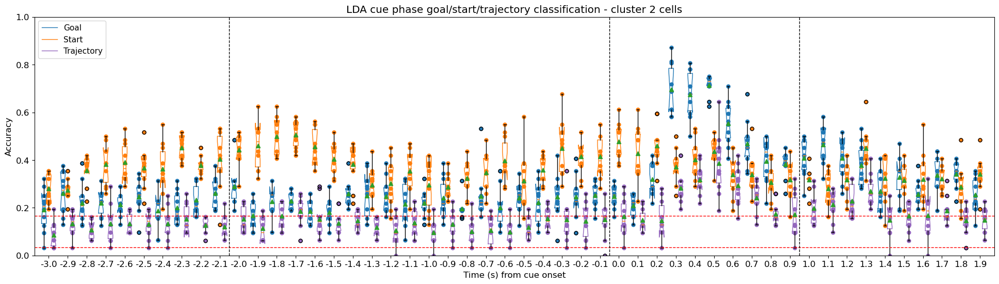

In [159]:
plt.figure(figsize=(24, 6))
plt.title(f'LDA cue phase goal/start/trajectory classification - cluster 2 cells')

# Plot as series of boxplots
bar_width = 0.25
bp1 = plt.boxplot(lda_goal_accuracy_iti_cue_clust2_timebins.T, positions=np.arange(1, num_timebins_ext+1)-bar_width, widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C0'}, flierprops={'marker': 'o', 'markersize': 5})
bp2 = plt.boxplot(lda_start_accuracy_iti_cue_clust2_timebins.T, positions=np.arange(1, num_timebins_ext+1), widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C1'}, flierprops={'marker': 'o', 'markersize': 5})
bp3 = plt.boxplot(lda_traj_accuracy_iti_cue_clust2_timebins.T, positions=np.arange(1, num_timebins_ext+1)+bar_width, widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C4'}, flierprops={'marker': 'o', 'markersize': 5})
topcaps1 = [cap.get_ydata()[0] for i, cap in enumerate(bp1['caps']) if i%2==1]
topcaps2 = [cap.get_ydata()[0] for i, cap in enumerate(bp2['caps']) if i%2==1]
topcaps3 = [cap.get_ydata()[0] for i, cap in enumerate(bp3['caps']) if i%2==1]
topcaps = [max(caps) for caps in zip(topcaps1, topcaps2, topcaps3)]
for k in range(num_timebins_ext):
    plt.scatter(np.ones_like(lda_goal_accuracy_iti_cue_clust2_timebins[k,:]) + k - bar_width, lda_goal_accuracy_iti_cue_clust2_timebins[k,:], s=25, color='C0')
    plt.scatter(np.ones_like(lda_start_accuracy_iti_cue_clust2_timebins[k,:]) + k, lda_start_accuracy_iti_cue_clust2_timebins[k,:], s=25, color='C1')
    plt.scatter(np.ones_like(lda_traj_accuracy_iti_cue_clust2_timebins[k,:]) + k + bar_width, lda_traj_accuracy_iti_cue_clust2_timebins[k,:], s=25, color='C4')

plt.ylim(axlims)
plt.axhline(y=1/6, color='r', linewidth=1, linestyle='--')
plt.axhline(y=1/30, color='r', linewidth=1, linestyle='--')
plt.axvline(x=10.5, color='k', linewidth=1, linestyle='--')
plt.axvline(x=30.5, color='k', linewidth=1, linestyle='--')
plt.axvline(x=40.5, color='k', linewidth=1, linestyle='--')
plt.xticks(np.arange(1, num_timebins_ext+1), labels=[f'{n:.1f}' for n in np.concatenate([np.arange(-3, 0, 0.1), np.arange(0, 2, 0.1)])])
plt.xlabel('Time (s) from cue onset')
plt.ylabel('Accuracy')
plt.legend([bp1['boxes'][0], bp2['boxes'][0], bp3['boxes'][0]], ['Goal', 'Start', 'Trajectory'], loc='upper left', fontsize=11)

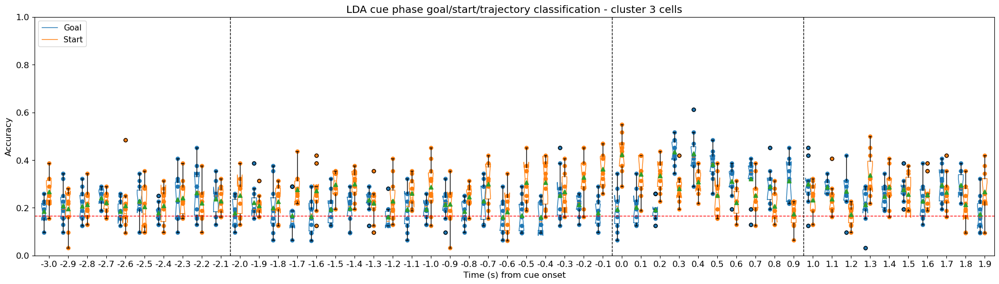

In [161]:
plt.figure(figsize=(24, 6))
plt.title(f'LDA cue phase goal/start/trajectory classification - cluster 3 cells')

# Plot as series of boxplots
bar_width = 0.25
bp1 = plt.boxplot(lda_goal_accuracy_iti_cue_clust3_timebins.T, positions=np.arange(1, num_timebins_ext+1)-bar_width, widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C0'}, flierprops={'marker': 'o', 'markersize': 5})
bp2 = plt.boxplot(lda_start_accuracy_iti_cue_clust3_timebins.T, positions=np.arange(1, num_timebins_ext+1), widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C1'}, flierprops={'marker': 'o', 'markersize': 5})
topcaps1 = [cap.get_ydata()[0] for i, cap in enumerate(bp1['caps']) if i%2==1]
topcaps2 = [cap.get_ydata()[0] for i, cap in enumerate(bp2['caps']) if i%2==1]
topcaps = [max(caps) for caps in zip(topcaps1, topcaps2)]
for k in range(num_timebins_ext):
    plt.scatter(np.ones_like(lda_goal_accuracy_iti_cue_clust3_timebins[k,:]) + k - bar_width, lda_goal_accuracy_iti_cue_clust3_timebins[k,:], s=25, color='C0')
    plt.scatter(np.ones_like(lda_start_accuracy_iti_cue_clust3_timebins[k,:]) + k, lda_start_accuracy_iti_cue_clust3_timebins[k,:], s=25, color='C1')

plt.ylim(axlims)
plt.axhline(y=1/6, color='r', linewidth=1, linestyle='--')
plt.axvline(x=10.5, color='k', linewidth=1, linestyle='--')
plt.axvline(x=30.5, color='k', linewidth=1, linestyle='--')
plt.axvline(x=40.5, color='k', linewidth=1, linestyle='--')
plt.xticks(np.arange(1, num_timebins_ext+1), labels=[f'{n:.1f}' for n in np.concatenate([np.arange(-3, 0, 0.1), np.arange(0, 2, 0.1)])])
plt.xlabel('Time (s) from cue onset')
plt.ylabel('Accuracy')
plt.legend([bp1['boxes'][0], bp2['boxes'][0]], ['Goal', 'Start'], loc='upper left', fontsize=11)

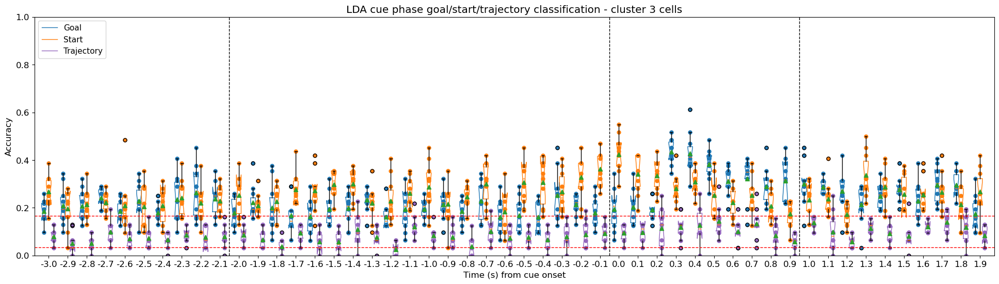

In [160]:
plt.figure(figsize=(24, 6))
plt.title(f'LDA cue phase goal/start/trajectory classification - cluster 3 cells')

# Plot as series of boxplots
bar_width = 0.25
bp1 = plt.boxplot(lda_goal_accuracy_iti_cue_clust3_timebins.T, positions=np.arange(1, num_timebins_ext+1)-bar_width, widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C0'}, flierprops={'marker': 'o', 'markersize': 5})
bp2 = plt.boxplot(lda_start_accuracy_iti_cue_clust3_timebins.T, positions=np.arange(1, num_timebins_ext+1), widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C1'}, flierprops={'marker': 'o', 'markersize': 5})
bp3 = plt.boxplot(lda_traj_accuracy_iti_cue_clust3_timebins.T, positions=np.arange(1, num_timebins_ext+1)+bar_width, widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C4'}, flierprops={'marker': 'o', 'markersize': 5})
topcaps1 = [cap.get_ydata()[0] for i, cap in enumerate(bp1['caps']) if i%2==1]
topcaps2 = [cap.get_ydata()[0] for i, cap in enumerate(bp2['caps']) if i%2==1]
topcaps3 = [cap.get_ydata()[0] for i, cap in enumerate(bp3['caps']) if i%2==1]
topcaps = [max(caps) for caps in zip(topcaps1, topcaps2, topcaps3)]
for k in range(num_timebins_ext):
    plt.scatter(np.ones_like(lda_goal_accuracy_iti_cue_clust3_timebins[k,:]) + k - bar_width, lda_goal_accuracy_iti_cue_clust3_timebins[k,:], s=25, color='C0')
    plt.scatter(np.ones_like(lda_start_accuracy_iti_cue_clust3_timebins[k,:]) + k, lda_start_accuracy_iti_cue_clust3_timebins[k,:], s=25, color='C1')
    plt.scatter(np.ones_like(lda_traj_accuracy_iti_cue_clust3_timebins[k,:]) + k + bar_width, lda_traj_accuracy_iti_cue_clust3_timebins[k,:], s=25, color='C4')

plt.ylim(axlims)
plt.axhline(y=1/6, color='r', linewidth=1, linestyle='--')
plt.axhline(y=1/30, color='r', linewidth=1, linestyle='--')
plt.axvline(x=10.5, color='k', linewidth=1, linestyle='--')
plt.axvline(x=30.5, color='k', linewidth=1, linestyle='--')
plt.axvline(x=40.5, color='k', linewidth=1, linestyle='--')
plt.xticks(np.arange(1, num_timebins_ext+1), labels=[f'{n:.1f}' for n in np.concatenate([np.arange(-3, 0, 0.1), np.arange(0, 2, 0.1)])])
plt.xlabel('Time (s) from cue onset')
plt.ylabel('Accuracy')
plt.legend([bp1['boxes'][0], bp2['boxes'][0], bp3['boxes'][0]], ['Goal', 'Start', 'Trajectory'], loc='upper left', fontsize=11)

#### 2-way ANOVA for interaction effects between goal & start

In [41]:
# # Array axes: outer list of goals, each element is a np.array(observation, timebin, cell)
# combined_spikerates_iti_cue_per_goal = [np.empty((0, num_timebins_ext, num_all_cells)) for _ in range(num_goals)]
# combined_spikerates_iti_cue_per_start = [np.empty((0, num_timebins_ext, num_all_cells)) for _ in range(num_goals)]
# for (s, g) in trajectories:
#     combined_spikerates_iti_cue_per_goal[g-1] = np.concatenate([combined_spikerates_iti_cue_per_goal[g-1], np.stack(combined_spikerates_iti_cue_per_traj[(s, g)])], axis=0)
#     combined_spikerates_iti_cue_per_start[s-1] = np.concatenate([combined_spikerates_iti_cue_per_start[s-1], np.stack(combined_spikerates_iti_cue_per_traj[(s, g)])], axis=0)
# # To slice arrays along timebin axis: time_slice = [arr[:,time,:] for arr in combined_spikerates_iti_cue_per_goal]

# Array axes: observation, timebin, cell
# Traj labels are given by: start, goal
combined_spikerates_iti_cue = np.empty((0, num_timebins_ext, num_all_cells))
for (s, g) in trajectories:
    combined_spikerates_iti_cue = np.concatenate([combined_spikerates_iti_cue, np.stack(combined_spikerates_iti_cue_per_traj[(s, g)])], axis=0)
combined_pcspikerates_iti_cue = combined_pcspikerates_iti_cue.reshape(-1, num_timebins_ext, n_dims)
combined_trajectories_iti_cue = np.array(combined_trajectories_cue)

Text(0, 0.5, '% Variance Explained')

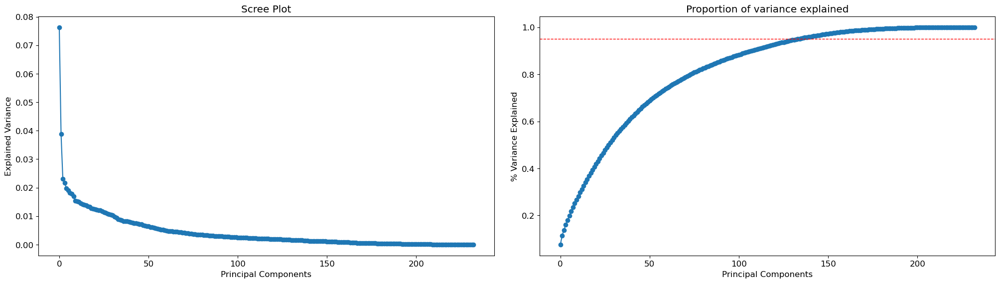

In [43]:
# Figure out how many dimensions to fit PCA for
combined_ext_pcspikerates_iti_cue = list()
for traj in trajectories:
    combined_ext_pcspikerates_iti_cue.extend(combined_spikerates_iti_cue_per_traj[traj])

pca = PCA()
combined_ext_pcspikerates_iti_cue = pca.fit_transform(np.vstack(combined_ext_pcspikerates_iti_cue))
cumulative_variance_explained = np.cumsum(pca.explained_variance_ratio_)

# Scree plot and proportion of variance explained
fig, axes = plt.subplots(1, 2, figsize=(24, 6))
plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1, wspace=0.1, hspace=0.1)

axes[0].set_title('Scree Plot')
axes[0].plot(np.arange(pca.n_components_), pca.explained_variance_ratio_, 'o-')
# axes[0].set_xticks(np.arange(pca.n_components_), labels=np.arange(1, pca.n_components_+1))
axes[0].set_xlabel('Principal Components')
axes[0].set_ylabel('Explained Variance')

axes[1].set_title('Proportion of variance explained')
axes[1].plot(np.arange(pca.n_components_), cumulative_variance_explained, 'o-')
axes[1].axhline(y=0.95, color='r', linestyle='--', linewidth=1)
# axes[1].set_xticks(np.arange(pca.n_components_), labels=np.arange(1, pca.n_components_+1))
axes[1].set_xlabel('Principal Components')
axes[1].set_ylabel('% Variance Explained')

In [44]:
# Redo PCA to fit appropriate number of dimensions
combined_ext_pcspikerates_iti_cue = list()
for traj in trajectories:
    combined_ext_pcspikerates_iti_cue.extend(combined_spikerates_iti_cue_per_traj[traj])

n_dims_ext = np.argmax(cumulative_variance_explained >= 0.95) + 1
# n_dims_ext = num_all_cells
pca = PCA(n_components=n_dims_ext)
combined_ext_pcspikerates_iti_cue = pca.fit_transform(np.vstack(combined_ext_pcspikerates_iti_cue))
combined_ext_pcspikerates_iti_cue = combined_ext_pcspikerates_iti_cue.reshape(-1, num_timebins_ext, n_dims_ext)

ANOVA on filtered cells

In [45]:
manova_results = list()
manova_formula = ' + '.join([f'c{i}' for i in range(1, num_cells_filt+1)])
# manova_formula = ' + '.join([f'c{i}' for i in range(1, n_dims_ext+1)])
manova_formula += ' ~ Start * Goal'
# manova_formula = 'PC1 + PC2 + PC3 ~ Start * Goal'

for timebin in range(num_timebins_ext):
    df = pd.DataFrame(combined_spikerates_iti_cue_filt[:,timebin,:], columns=[f'c{i}' for i in range(1, num_cells_filt+1)])
    # df = pd.DataFrame(combined_ext_pcspikerates_iti_cue[:,timebin,:], columns=[f'c{i}' for i in range(1, n_dims_ext+1)])
    # df = pd.DataFrame(combined_pcspikerates_iti_cue[:,timebin,:], columns=['PC1', 'PC2', 'PC3'])
    df['Start'] = combined_trajectories_iti_cue[:,0]
    df['Goal'] = combined_trajectories_iti_cue[:,1]
    manova = MANOVA.from_formula(manova_formula, data=df)
    manova_results.append(manova.mv_test().summary())

# Extract p-values for each timebin for start, goal and start x goal (interaction) effects
manova_pvals = np.empty((num_timebins_ext, 3))
for timebin in range(num_timebins_ext):
    # Using p-value of Wilks' lambda
    manova_pvals[timebin,0] = manova_results[timebin].tables[3]['Pr > F'][0]
    manova_pvals[timebin,1] = manova_results[timebin].tables[5]['Pr > F'][0]
    manova_pvals[timebin,2] = manova_results[timebin].tables[7]['Pr > F'][0]

In [46]:
# Rerun LDA decoding on filtered cells for plotting
# Same-domain models
lda_goal_accuracy_iti_cue_filt_timebins = np.zeros((num_timebins_ext, k_fold))
lda_goal_confusion_iti_cue_filt_timebins = np.zeros((num_timebins_ext, num_goals, num_goals))
lda_start_accuracy_iti_cue_filt_timebins = np.zeros((num_timebins_ext, k_fold))
lda_start_confusion_iti_cue_filt_timebins = np.zeros((num_timebins_ext, num_goals, num_goals))
lda_traj_accuracy_iti_cue_filt_timebins = np.zeros((num_timebins_ext, k_fold))
lda_traj_confusion_iti_cue_filt_timebins = np.zeros((num_timebins_ext, len(trajectories), len(trajectories)))

k_fold = 10
for k in range(num_timebins_ext):
    for i in range(k_fold):
        # Goal
        X_train, X_test, y_train, y_test = train_test_split(combined_spikerates_iti_cue_filt[:,k,:], combined_goals_cue_lda_timebins, (i, k_fold))
        lda = LinearDiscriminantAnalysis()
        lda.fit(X_train, y_train)
        y_pred = lda.predict(X_test)
        lda_goal_accuracy_iti_cue_filt_timebins[k,i] = prediction_accuracy(y_pred, y_test)
        lda_goal_confusion_iti_cue_filt_timebins[k,:,:] += confusion_matrix(y_pred, y_test, num_goals)

        # Start
        X_train, X_test, y_train, y_test = train_test_split(combined_spikerates_iti_cue_filt[:,k,:], combined_starts_cue_lda_timebins, (i, k_fold))
        lda = LinearDiscriminantAnalysis()
        lda.fit(X_train, y_train)
        y_pred = lda.predict(X_test)
        lda_start_accuracy_iti_cue_filt_timebins[k,i] = prediction_accuracy(y_pred, y_test)
        lda_start_confusion_iti_cue_filt_timebins[k,:,:] += confusion_matrix(y_pred, y_test, num_goals)

        # Trajectory
        X_train, X_test, y_train, y_test = train_test_split(combined_spikerates_iti_cue_filt[:,k,:], combined_trajs_cue_lda_timebins, (i, k_fold))
        lda = LinearDiscriminantAnalysis()
        lda.fit(X_train, y_train)
        y_pred = lda.predict(X_test)
        lda_traj_accuracy_iti_cue_filt_timebins[k,i] = prediction_accuracy(y_pred, y_test)
        lda_traj_confusion_iti_cue_filt_timebins[k,:,:] += confusion_matrix(y_pred+1, y_test+1, len(trajectories))

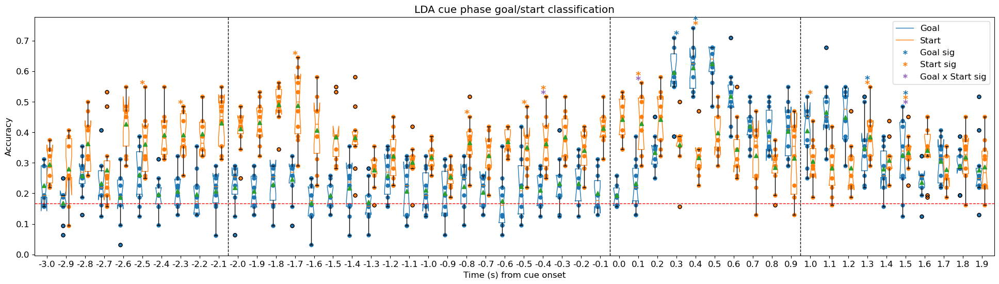

In [162]:
plt.figure(figsize=(24, 6))
plt.title(f'LDA cue phase goal/start classification')

# Plot as series of boxplots
bar_width = 0.3
bp1 = plt.boxplot(lda_goal_accuracy_iti_cue_filt_timebins.T, positions=np.arange(1, num_timebins_ext+1)-bar_width/2, widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C0'}, flierprops={'marker': 'o', 'markersize': 5})
bp2 = plt.boxplot(lda_start_accuracy_iti_cue_filt_timebins.T, positions=np.arange(1, num_timebins_ext+1)+bar_width/2, widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C1'}, flierprops={'marker': 'o', 'markersize': 5})
topcaps1 = [cap.get_ydata()[0] for i, cap in enumerate(bp1['caps']) if i%2==1]
topcaps2 = [cap.get_ydata()[0] for i, cap in enumerate(bp2['caps']) if i%2==1]
topcaps = [max(caps) for caps in zip(topcaps1, topcaps2)]

for k in range(num_timebins_ext):
    plt.scatter(np.ones_like(lda_goal_accuracy_iti_cue_filt_timebins[k,:]) + k - bar_width/2, lda_goal_accuracy_iti_cue_filt_timebins[k,:], s=25, color='C0')
    plt.scatter(np.ones_like(lda_start_accuracy_iti_cue_filt_timebins[k,:]) + k + bar_width/2, lda_start_accuracy_iti_cue_filt_timebins[k,:], s=25, color='C1')
    p_vals = manova_pvals[k,:]
    offset = 0
    if p_vals[2] < sig_lvl/num_timebins_ext: # Start x Goal interaction effect significance
        plt.annotate('*', xy=(k+1+bar_width/2, topcaps[k]), xytext=(k+1, topcaps[k]), horizontalalignment='center', fontsize=14, fontweight='bold', color='C4')
        offset += 1
    if p_vals[0] < sig_lvl/num_timebins_ext: # Start effect significance
        plt.annotate('*', xy=(k+1+bar_width/2, topcaps[k]+0.015*offset), xytext=(k+1, topcaps[k]+0.015*offset), horizontalalignment='center', fontsize=14, fontweight='bold', color='C1')
        offset += 1
    if p_vals[1] < sig_lvl/num_timebins_ext: # Goal effect significance
        plt.annotate('*', xy=(k+1+bar_width/2, topcaps[k]+0.015*offset), xytext=(k+1, topcaps[k]+0.015*offset), horizontalalignment='center', fontsize=14, fontweight='bold', color='C0')

plt.axhline(y=1/6, color='r', linewidth=1, linestyle='--')
plt.axvline(x=10.5, color='k', linewidth=1, linestyle='--')
plt.axvline(x=30.5, color='k', linewidth=1, linestyle='--')
plt.axvline(x=40.5, color='k', linewidth=1, linestyle='--')
plt.xticks(np.arange(1, num_timebins_ext+1), labels=[f'{n:.1f}' for n in np.concatenate([np.arange(-3, 0, 0.1), np.arange(0, 2, 0.1)])])
plt.xlabel('Time (s) from cue onset')
plt.ylabel('Accuracy')
plt.legend([bp1['boxes'][0], bp2['boxes'][0], Line2D([0], [0], marker='$\u2217$', color='C0', markersize=7, markeredgewidth=0.3, linestyle='None'), Line2D([0], [0], marker='$\u2217$', color='C1', markersize=7, markeredgewidth=0.3, linestyle='None'),\
            Line2D([0], [0], marker='$\u2217$', color='C4', markersize=7, markeredgewidth=0.3, linestyle='None')], ['Goal', 'Start', 'Goal sig', 'Start sig', 'Goal x Start sig'])

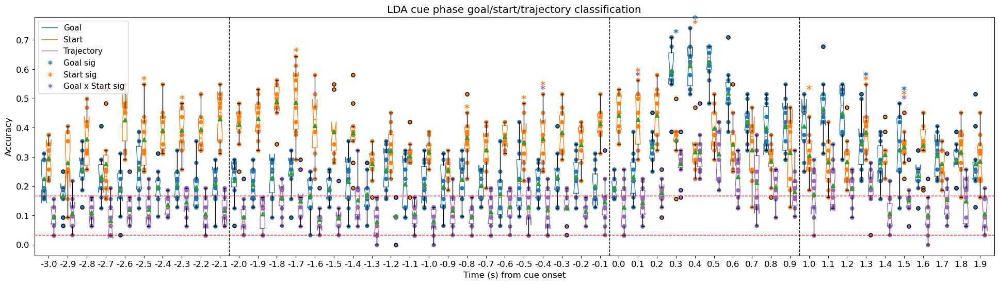

In [163]:
plt.figure(figsize=(24, 6))
plt.title(f'LDA cue phase goal/start/trajectory classification')

# Plot as series of boxplots
bar_width = 0.25
bp1 = plt.boxplot(lda_goal_accuracy_iti_cue_filt_timebins.T, positions=np.arange(1, num_timebins_ext+1)-bar_width, widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C0'}, flierprops={'marker': 'o', 'markersize': 5})
bp2 = plt.boxplot(lda_start_accuracy_iti_cue_filt_timebins.T, positions=np.arange(1, num_timebins_ext+1), widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C1'}, flierprops={'marker': 'o', 'markersize': 5})
bp3 = plt.boxplot(lda_traj_accuracy_iti_cue_filt_timebins.T, positions=np.arange(1, num_timebins_ext+1)+bar_width, widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C4'}, flierprops={'marker': 'o', 'markersize': 5})
topcaps1 = [cap.get_ydata()[0] for i, cap in enumerate(bp1['caps']) if i%2==1]
topcaps2 = [cap.get_ydata()[0] for i, cap in enumerate(bp2['caps']) if i%2==1]
topcaps3 = [cap.get_ydata()[0] for i, cap in enumerate(bp3['caps']) if i%2==1]
topcaps = [max(caps) for caps in zip(topcaps1, topcaps2, topcaps3)]
for k in range(num_timebins_ext):
    plt.scatter(np.ones_like(lda_goal_accuracy_iti_cue_filt_timebins[k,:]) + k - bar_width, lda_goal_accuracy_iti_cue_filt_timebins[k,:], s=25, color='C0')
    plt.scatter(np.ones_like(lda_start_accuracy_iti_cue_filt_timebins[k,:]) + k, lda_start_accuracy_iti_cue_filt_timebins[k,:], s=25, color='C1')
    plt.scatter(np.ones_like(lda_traj_accuracy_iti_cue_filt_timebins[k,:]) + k + bar_width, lda_traj_accuracy_iti_cue_filt_timebins[k,:], s=25, color='C4')
    p_vals = manova_pvals[k,:]
    offset = 0
    if p_vals[2] < sig_lvl/num_timebins_ext: # Start x Goal interaction effect significance
        plt.annotate('*', xy=(k+1+bar_width/2, topcaps[k]+0.005), xytext=(k+1, topcaps[k]+0.005), horizontalalignment='center', fontsize=14, fontweight='bold', color='C4')
        offset += 1
    if p_vals[0] < sig_lvl/num_timebins_ext: # Start effect significance
        plt.annotate('*', xy=(k+1+bar_width/2, topcaps[k]+0.005+0.015*offset), xytext=(k+1, topcaps[k]+0.005+0.015*offset), horizontalalignment='center', fontsize=14, fontweight='bold', color='C1')
        offset += 1
    if p_vals[1] < sig_lvl/num_timebins_ext: # Goal effect significance
        plt.annotate('*', xy=(k+1+bar_width/2, topcaps[k]+0.005+0.015*offset), xytext=(k+1, topcaps[k]+0.005+0.015*offset), horizontalalignment='center', fontsize=14, fontweight='bold', color='C0')

plt.axhline(y=1/6, color='r', linewidth=1, linestyle='--')
plt.axhline(y=1/30, color='r', linewidth=1, linestyle='--')
plt.axvline(x=10.5, color='k', linewidth=1, linestyle='--')
plt.axvline(x=30.5, color='k', linewidth=1, linestyle='--')
plt.axvline(x=40.5, color='k', linewidth=1, linestyle='--')
plt.xticks(np.arange(1, num_timebins_ext+1), labels=[f'{n:.1f}' for n in np.concatenate([np.arange(-3, 0, 0.1), np.arange(0, 2, 0.1)])])
plt.xlabel('Time (s) from cue onset')
plt.ylabel('Accuracy')
plt.legend([bp1['boxes'][0], bp2['boxes'][0], bp3['boxes'][0], Line2D([0], [0], marker='$\u2217$', color='C0', markersize=7, markeredgewidth=0.3, linestyle='None'),\
            Line2D([0], [0], marker='$\u2217$', color='C1', markersize=7, markeredgewidth=0.3, linestyle='None'), Line2D([0], [0], marker='$\u2217$', color='C4', markersize=7, markeredgewidth=0.3, linestyle='None')],\
            ['Goal', 'Start', 'Trajectory', 'Goal sig', 'Start sig', 'Goal x Start sig'], loc='upper left', fontsize=11)

ANOVA on cell subset

In [88]:
manova_results_2 = list()
manova_formula = ' + '.join([f'c{i}' for i in range(1, num_cells_subset+1)])
# manova_formula = ' + '.join([f'c{i}' for i in range(1, n_dims_ext+1)])
manova_formula += ' ~ Start * Goal'
# manova_formula = 'PC1 + PC2 + PC3 ~ Start * Goal'

for timebin in range(num_timebins_ext):
    df = pd.DataFrame(combined_spikerates_iti_cue_subset[:,timebin,:], columns=[f'c{i}' for i in range(1, num_cells_subset+1)])
    # df = pd.DataFrame(combined_ext_pcspikerates_iti_cue[:,timebin,:], columns=[f'c{i}' for i in range(1, n_dims_ext+1)])
    # df = pd.DataFrame(combined_pcspikerates_iti_cue[:,timebin,:], columns=['PC1', 'PC2', 'PC3'])
    df['Start'] = combined_trajectories_iti_cue[:,0]
    df['Goal'] = combined_trajectories_iti_cue[:,1]
    manova = MANOVA.from_formula(manova_formula, data=df)
    manova_results_2.append(manova.mv_test().summary())

# Extract p-values for each timebin for start, goal and start x goal (interaction) effects
manova_pvals_2 = np.empty((num_timebins_ext, 3))
for timebin in range(num_timebins_ext):
    # Using p-value of Wilks' lambda
    manova_pvals_2[timebin,0] = manova_results_2[timebin].tables[3]['Pr > F'][0]
    manova_pvals_2[timebin,1] = manova_results_2[timebin].tables[5]['Pr > F'][0]
    manova_pvals_2[timebin,2] = manova_results_2[timebin].tables[7]['Pr > F'][0]

In [89]:
# Rerun LDA decoding on current subset of cells for plotting
# Same-domain models
lda_goal_accuracy_iti_cue_subset_timebins = np.zeros((num_timebins_ext, k_fold))
lda_goal_confusion_iti_cue_subset_timebins = np.zeros((num_timebins_ext, num_goals, num_goals))
lda_start_accuracy_iti_cue_subset_timebins = np.zeros((num_timebins_ext, k_fold))
lda_start_confusion_iti_cue_subset_timebins = np.zeros((num_timebins_ext, num_goals, num_goals))
lda_traj_accuracy_iti_cue_subset_timebins = np.zeros((num_timebins_ext, k_fold))
lda_traj_confusion_iti_cue_subset_timebins = np.zeros((num_timebins_ext, len(trajectories), len(trajectories)))

k_fold = 10
for k in range(num_timebins_ext):
    for i in range(k_fold):
        # Goal
        X_train, X_test, y_train, y_test = train_test_split(combined_spikerates_iti_cue_subset[:,k,:], combined_goals_cue_lda_timebins, (i, k_fold))
        lda = LinearDiscriminantAnalysis()
        lda.fit(X_train, y_train)
        y_pred = lda.predict(X_test)
        lda_goal_accuracy_iti_cue_subset_timebins[k,i] = prediction_accuracy(y_pred, y_test)
        lda_goal_confusion_iti_cue_subset_timebins[k,:,:] += confusion_matrix(y_pred, y_test, num_goals)

        # Start
        X_train, X_test, y_train, y_test = train_test_split(combined_spikerates_iti_cue_subset[:,k,:], combined_starts_cue_lda_timebins, (i, k_fold))
        lda = LinearDiscriminantAnalysis()
        lda.fit(X_train, y_train)
        y_pred = lda.predict(X_test)
        lda_start_accuracy_iti_cue_subset_timebins[k,i] = prediction_accuracy(y_pred, y_test)
        lda_start_confusion_iti_cue_subset_timebins[k,:,:] += confusion_matrix(y_pred, y_test, num_goals)

        # Trajectory
        X_train, X_test, y_train, y_test = train_test_split(combined_spikerates_iti_cue_subset[:,k,:], combined_trajs_cue_lda_timebins, (i, k_fold))
        lda = LinearDiscriminantAnalysis()
        lda.fit(X_train, y_train)
        y_pred = lda.predict(X_test)
        lda_traj_accuracy_iti_cue_subset_timebins[k,i] = prediction_accuracy(y_pred, y_test)
        lda_traj_confusion_iti_cue_subset_timebins[k,:,:] += confusion_matrix(y_pred+1, y_test+1, len(trajectories))

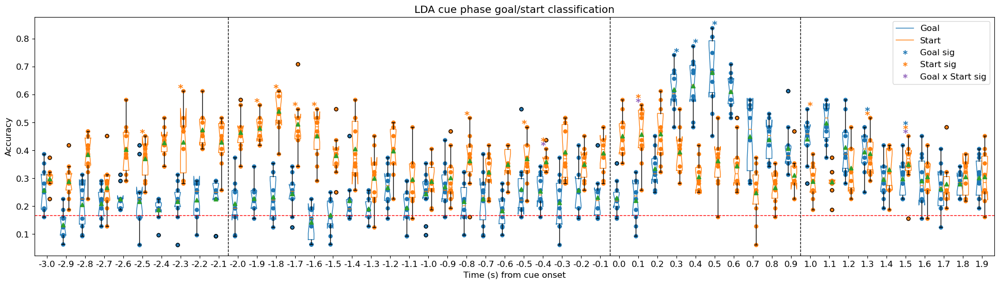

In [164]:
plt.figure(figsize=(24, 6))
plt.title(f'LDA cue phase goal/start classification')

# Plot as series of boxplots
bar_width = 0.3
bp1 = plt.boxplot(lda_goal_accuracy_iti_cue_subset_timebins.T, positions=np.arange(1, num_timebins_ext+1)-bar_width/2, widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C0'}, flierprops={'marker': 'o', 'markersize': 5})
bp2 = plt.boxplot(lda_start_accuracy_iti_cue_subset_timebins.T, positions=np.arange(1, num_timebins_ext+1)+bar_width/2, widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C1'}, flierprops={'marker': 'o', 'markersize': 5})
topcaps1 = [cap.get_ydata()[0] for i, cap in enumerate(bp1['caps']) if i%2==1]
topcaps2 = [cap.get_ydata()[0] for i, cap in enumerate(bp2['caps']) if i%2==1]
topcaps = [max(caps) for caps in zip(topcaps1, topcaps2)]

for k in range(num_timebins_ext):
    plt.scatter(np.ones_like(lda_goal_accuracy_iti_cue_subset_timebins[k,:]) + k - bar_width/2, lda_goal_accuracy_iti_cue_subset_timebins[k,:], s=25, color='C0')
    plt.scatter(np.ones_like(lda_start_accuracy_iti_cue_subset_timebins[k,:]) + k + bar_width/2, lda_start_accuracy_iti_cue_subset_timebins[k,:], s=25, color='C1')
    p_vals = manova_pvals_2[k,:]
    offset = 0
    if p_vals[2] < sig_lvl/num_timebins_ext: # Start x Goal interaction effect significance
        plt.annotate('*', xy=(k+1+bar_width/2, topcaps[k]), xytext=(k+1, topcaps[k]), horizontalalignment='center', fontsize=14, fontweight='bold', color='C4')
        offset += 1
    if p_vals[0] < sig_lvl/num_timebins_ext: # Start effect significance
        plt.annotate('*', xy=(k+1+bar_width/2, topcaps[k]+0.015*offset), xytext=(k+1, topcaps[k]+0.015*offset), horizontalalignment='center', fontsize=14, fontweight='bold', color='C1')
        offset += 1
    if p_vals[1] < sig_lvl/num_timebins_ext: # Goal effect significance
        plt.annotate('*', xy=(k+1+bar_width/2, topcaps[k]+0.015*offset), xytext=(k+1, topcaps[k]+0.015*offset), horizontalalignment='center', fontsize=14, fontweight='bold', color='C0')

plt.axhline(y=1/6, color='r', linewidth=1, linestyle='--')
plt.axvline(x=10.5, color='k', linewidth=1, linestyle='--')
plt.axvline(x=30.5, color='k', linewidth=1, linestyle='--')
plt.axvline(x=40.5, color='k', linewidth=1, linestyle='--')
plt.xticks(np.arange(1, num_timebins_ext+1), labels=[f'{n:.1f}' for n in np.concatenate([np.arange(-3, 0, 0.1), np.arange(0, 2, 0.1)])])
plt.xlabel('Time (s) from cue onset')
plt.ylabel('Accuracy')
plt.legend([bp1['boxes'][0], bp2['boxes'][0], Line2D([0], [0], marker='$\u2217$', color='C0', markersize=7, markeredgewidth=0.3, linestyle='None'), Line2D([0], [0], marker='$\u2217$', color='C1', markersize=7, markeredgewidth=0.3, linestyle='None'),\
            Line2D([0], [0], marker='$\u2217$', color='C4', markersize=7, markeredgewidth=0.3, linestyle='None')], ['Goal', 'Start', 'Goal sig', 'Start sig', 'Goal x Start sig'])

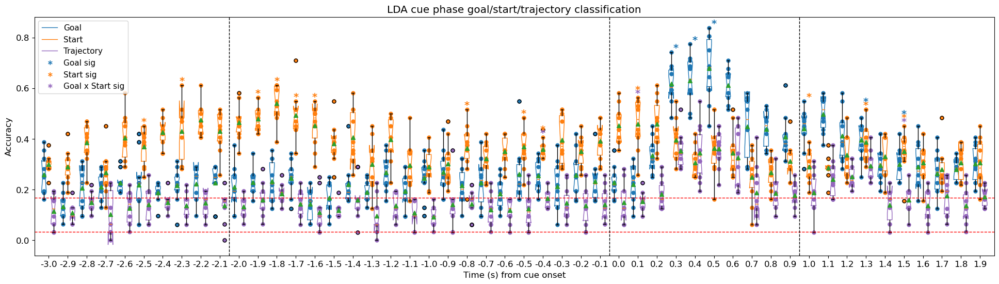

In [165]:
plt.figure(figsize=(24, 6))
plt.title(f'LDA cue phase goal/start/trajectory classification')

# Plot as series of boxplots
bar_width = 0.25
bp1 = plt.boxplot(lda_goal_accuracy_iti_cue_subset_timebins.T, positions=np.arange(1, num_timebins_ext+1)-bar_width, widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C0'}, flierprops={'marker': 'o', 'markersize': 5})
bp2 = plt.boxplot(lda_start_accuracy_iti_cue_subset_timebins.T, positions=np.arange(1, num_timebins_ext+1), widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C1'}, flierprops={'marker': 'o', 'markersize': 5})
bp3 = plt.boxplot(lda_traj_accuracy_iti_cue_subset_timebins.T, positions=np.arange(1, num_timebins_ext+1)+bar_width, widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C4'}, flierprops={'marker': 'o', 'markersize': 5})
topcaps1 = [cap.get_ydata()[0] for i, cap in enumerate(bp1['caps']) if i%2==1]
topcaps2 = [cap.get_ydata()[0] for i, cap in enumerate(bp2['caps']) if i%2==1]
topcaps3 = [cap.get_ydata()[0] for i, cap in enumerate(bp3['caps']) if i%2==1]
topcaps = [max(caps) for caps in zip(topcaps1, topcaps2, topcaps3)]
for k in range(num_timebins_ext):
    plt.scatter(np.ones_like(lda_goal_accuracy_iti_cue_subset_timebins[k,:]) + k - bar_width, lda_goal_accuracy_iti_cue_subset_timebins[k,:], s=25, color='C0')
    plt.scatter(np.ones_like(lda_start_accuracy_iti_cue_subset_timebins[k,:]) + k, lda_start_accuracy_iti_cue_subset_timebins[k,:], s=25, color='C1')
    plt.scatter(np.ones_like(lda_traj_accuracy_iti_cue_subset_timebins[k,:]) + k + bar_width, lda_traj_accuracy_iti_cue_subset_timebins[k,:], s=25, color='C4')
    p_vals = manova_pvals_2[k,:]
    offset = 0
    if p_vals[2] < sig_lvl/num_timebins_ext: # Start x Goal interaction effect significance
        plt.annotate('*', xy=(k+1+bar_width/2, topcaps[k]+0.005), xytext=(k+1, topcaps[k]+0.005), horizontalalignment='center', fontsize=14, fontweight='bold', color='C4')
        offset += 1
    if p_vals[0] < sig_lvl/num_timebins_ext: # Start effect significance
        plt.annotate('*', xy=(k+1+bar_width/2, topcaps[k]+0.005+0.015*offset), xytext=(k+1, topcaps[k]+0.005+0.015*offset), horizontalalignment='center', fontsize=14, fontweight='bold', color='C1')
        offset += 1
    if p_vals[1] < sig_lvl/num_timebins_ext: # Goal effect significance
        plt.annotate('*', xy=(k+1+bar_width/2, topcaps[k]+0.005+0.015*offset), xytext=(k+1, topcaps[k]+0.005+0.015*offset), horizontalalignment='center', fontsize=14, fontweight='bold', color='C0')

plt.axhline(y=1/6, color='r', linewidth=1, linestyle='--')
plt.axhline(y=1/30, color='r', linewidth=1, linestyle='--')
plt.axvline(x=10.5, color='k', linewidth=1, linestyle='--')
plt.axvline(x=30.5, color='k', linewidth=1, linestyle='--')
plt.axvline(x=40.5, color='k', linewidth=1, linestyle='--')
plt.xticks(np.arange(1, num_timebins_ext+1), labels=[f'{n:.1f}' for n in np.concatenate([np.arange(-3, 0, 0.1), np.arange(0, 2, 0.1)])])
plt.xlabel('Time (s) from cue onset')
plt.ylabel('Accuracy')
plt.legend([bp1['boxes'][0], bp2['boxes'][0], bp3['boxes'][0], Line2D([0], [0], marker='$\u2217$', color='C0', markersize=7, markeredgewidth=0.3, linestyle='None'),\
            Line2D([0], [0], marker='$\u2217$', color='C1', markersize=7, markeredgewidth=0.3, linestyle='None'), Line2D([0], [0], marker='$\u2217$', color='C4', markersize=7, markeredgewidth=0.3, linestyle='None')],\
            ['Goal', 'Start', 'Trajectory', 'Goal sig', 'Start sig', 'Goal x Start sig'], loc='upper left', fontsize=11)

ANOVA on remaining cells

In [90]:
manova_results_3 = list()
manova_formula = ' + '.join([f'c{i}' for i in range(1, num_cells_remain+1)])
# manova_formula = ' + '.join([f'c{i}' for i in range(1, n_dims_ext+1)])
manova_formula += ' ~ Start * Goal'
# manova_formula = 'PC1 + PC2 + PC3 ~ Start * Goal'

for timebin in range(num_timebins_ext):
    df = pd.DataFrame(combined_spikerates_iti_cue_remain[:,timebin,:], columns=[f'c{i}' for i in range(1, num_cells_remain+1)])
    # df = pd.DataFrame(combined_ext_pcspikerates_iti_cue[:,timebin,:], columns=[f'c{i}' for i in range(1, n_dims_ext+1)])
    # df = pd.DataFrame(combined_pcspikerates_iti_cue[:,timebin,:], columns=['PC1', 'PC2', 'PC3'])
    df['Start'] = combined_trajectories_iti_cue[:,0]
    df['Goal'] = combined_trajectories_iti_cue[:,1]
    manova = MANOVA.from_formula(manova_formula, data=df)
    manova_results_3.append(manova.mv_test().summary())

# Extract p-values for each timebin for start, goal and start x goal (interaction) effects
manova_pvals_3 = np.empty((num_timebins_ext, 3))
for timebin in range(num_timebins_ext):
    # Using p-value of Wilks' lambda
    manova_pvals_3[timebin,0] = manova_results_3[timebin].tables[3]['Pr > F'][0]
    manova_pvals_3[timebin,1] = manova_results_3[timebin].tables[5]['Pr > F'][0]
    manova_pvals_3[timebin,2] = manova_results_3[timebin].tables[7]['Pr > F'][0]

In [91]:
# Rerun LDA decoding on current subset of cells for plotting
# Same-domain models
lda_goal_accuracy_iti_cue_remain_timebins = np.zeros((num_timebins_ext, k_fold))
lda_goal_confusion_iti_cue_remain_timebins = np.zeros((num_timebins_ext, num_goals, num_goals))
lda_start_accuracy_iti_cue_remain_timebins = np.zeros((num_timebins_ext, k_fold))
lda_start_confusion_iti_cue_remain_timebins = np.zeros((num_timebins_ext, num_goals, num_goals))
lda_traj_accuracy_iti_cue_remain_timebins = np.zeros((num_timebins_ext, k_fold))
lda_traj_confusion_iti_cue_remain_timebins = np.zeros((num_timebins_ext, len(trajectories), len(trajectories)))

k_fold = 10
for k in range(num_timebins_ext):
    for i in range(k_fold):
        # Goal
        X_train, X_test, y_train, y_test = train_test_split(combined_spikerates_iti_cue_remain[:,k,:], combined_goals_cue_lda_timebins, (i, k_fold))
        lda = LinearDiscriminantAnalysis()
        lda.fit(X_train, y_train)
        y_pred = lda.predict(X_test)
        lda_goal_accuracy_iti_cue_remain_timebins[k,i] = prediction_accuracy(y_pred, y_test)
        lda_goal_confusion_iti_cue_remain_timebins[k,:,:] += confusion_matrix(y_pred, y_test, num_goals)

        # Start
        X_train, X_test, y_train, y_test = train_test_split(combined_spikerates_iti_cue_remain[:,k,:], combined_starts_cue_lda_timebins, (i, k_fold))
        lda = LinearDiscriminantAnalysis()
        lda.fit(X_train, y_train)
        y_pred = lda.predict(X_test)
        lda_start_accuracy_iti_cue_remain_timebins[k,i] = prediction_accuracy(y_pred, y_test)
        lda_start_confusion_iti_cue_remain_timebins[k,:,:] += confusion_matrix(y_pred, y_test, num_goals)

        # Trajectory
        X_train, X_test, y_train, y_test = train_test_split(combined_spikerates_iti_cue_remain[:,k,:], combined_trajs_cue_lda_timebins, (i, k_fold))
        lda = LinearDiscriminantAnalysis()
        lda.fit(X_train, y_train)
        y_pred = lda.predict(X_test)
        lda_traj_accuracy_iti_cue_remain_timebins[k,i] = prediction_accuracy(y_pred, y_test)
        lda_traj_confusion_iti_cue_remain_timebins[k,:,:] += confusion_matrix(y_pred+1, y_test+1, len(trajectories))

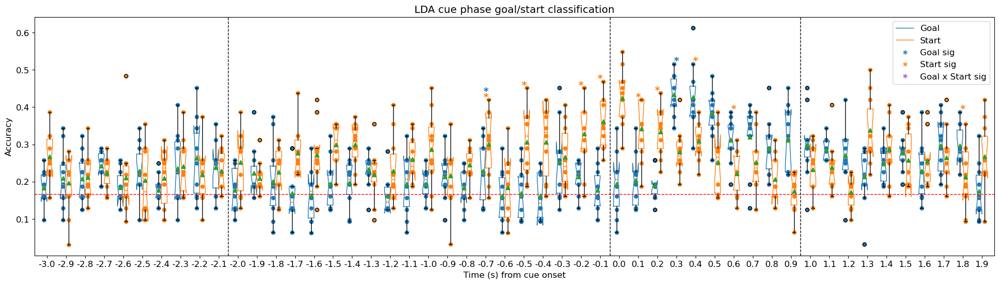

In [166]:
plt.figure(figsize=(24, 6))
plt.title(f'LDA cue phase goal/start classification')

# Plot as series of boxplots
bar_width = 0.3
bp1 = plt.boxplot(lda_goal_accuracy_iti_cue_remain_timebins.T, positions=np.arange(1, num_timebins_ext+1)-bar_width/2, widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C0'}, flierprops={'marker': 'o', 'markersize': 5})
bp2 = plt.boxplot(lda_start_accuracy_iti_cue_remain_timebins.T, positions=np.arange(1, num_timebins_ext+1)+bar_width/2, widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C1'}, flierprops={'marker': 'o', 'markersize': 5})
topcaps1 = [cap.get_ydata()[0] for i, cap in enumerate(bp1['caps']) if i%2==1]
topcaps2 = [cap.get_ydata()[0] for i, cap in enumerate(bp2['caps']) if i%2==1]
topcaps = [max(caps) for caps in zip(topcaps1, topcaps2)]

for k in range(num_timebins_ext):
    plt.scatter(np.ones_like(lda_goal_accuracy_iti_cue_remain_timebins[k,:]) + k - bar_width/2, lda_goal_accuracy_iti_cue_remain_timebins[k,:], s=25, color='C0')
    plt.scatter(np.ones_like(lda_start_accuracy_iti_cue_remain_timebins[k,:]) + k + bar_width/2, lda_start_accuracy_iti_cue_remain_timebins[k,:], s=25, color='C1')
    p_vals = manova_pvals_3[k,:]
    offset = 0
    if p_vals[2] < sig_lvl/num_timebins_ext: # Start x Goal interaction effect significance
        plt.annotate('*', xy=(k+1+bar_width/2, topcaps[k]), xytext=(k+1, topcaps[k]), horizontalalignment='center', fontsize=14, fontweight='bold', color='C4')
        offset += 1
    if p_vals[0] < sig_lvl/num_timebins_ext: # Start effect significance
        plt.annotate('*', xy=(k+1+bar_width/2, topcaps[k]+0.015*offset), xytext=(k+1, topcaps[k]+0.015*offset), horizontalalignment='center', fontsize=14, fontweight='bold', color='C1')
        offset += 1
    if p_vals[1] < sig_lvl/num_timebins_ext: # Goal effect significance
        plt.annotate('*', xy=(k+1+bar_width/2, topcaps[k]+0.015*offset), xytext=(k+1, topcaps[k]+0.015*offset), horizontalalignment='center', fontsize=14, fontweight='bold', color='C0')

plt.axhline(y=1/6, color='r', linewidth=1, linestyle='--')
plt.axvline(x=10.5, color='k', linewidth=1, linestyle='--')
plt.axvline(x=30.5, color='k', linewidth=1, linestyle='--')
plt.axvline(x=40.5, color='k', linewidth=1, linestyle='--')
plt.xticks(np.arange(1, num_timebins_ext+1), labels=[f'{n:.1f}' for n in np.concatenate([np.arange(-3, 0, 0.1), np.arange(0, 2, 0.1)])])
plt.xlabel('Time (s) from cue onset')
plt.ylabel('Accuracy')
plt.legend([bp1['boxes'][0], bp2['boxes'][0], Line2D([0], [0], marker='$\u2217$', color='C0', markersize=7, markeredgewidth=0.3, linestyle='None'), Line2D([0], [0], marker='$\u2217$', color='C1', markersize=7, markeredgewidth=0.3, linestyle='None'),\
            Line2D([0], [0], marker='$\u2217$', color='C4', markersize=7, markeredgewidth=0.3, linestyle='None')], ['Goal', 'Start', 'Goal sig', 'Start sig', 'Goal x Start sig'])

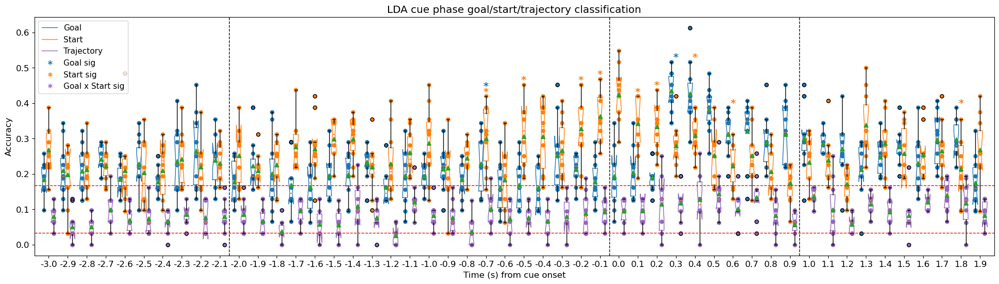

In [167]:
plt.figure(figsize=(24, 6))
plt.title(f'LDA cue phase goal/start/trajectory classification')

# Plot as series of boxplots
bar_width = 0.25
bp1 = plt.boxplot(lda_goal_accuracy_iti_cue_remain_timebins.T, positions=np.arange(1, num_timebins_ext+1)-bar_width, widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C0'}, flierprops={'marker': 'o', 'markersize': 5})
bp2 = plt.boxplot(lda_start_accuracy_iti_cue_remain_timebins.T, positions=np.arange(1, num_timebins_ext+1), widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C1'}, flierprops={'marker': 'o', 'markersize': 5})
bp3 = plt.boxplot(lda_traj_accuracy_iti_cue_remain_timebins.T, positions=np.arange(1, num_timebins_ext+1)+bar_width, widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C4'}, flierprops={'marker': 'o', 'markersize': 5})
topcaps1 = [cap.get_ydata()[0] for i, cap in enumerate(bp1['caps']) if i%2==1]
topcaps2 = [cap.get_ydata()[0] for i, cap in enumerate(bp2['caps']) if i%2==1]
topcaps3 = [cap.get_ydata()[0] for i, cap in enumerate(bp3['caps']) if i%2==1]
topcaps = [max(caps) for caps in zip(topcaps1, topcaps2, topcaps3)]
for k in range(num_timebins_ext):
    plt.scatter(np.ones_like(lda_goal_accuracy_iti_cue_remain_timebins[k,:]) + k - bar_width, lda_goal_accuracy_iti_cue_remain_timebins[k,:], s=25, color='C0')
    plt.scatter(np.ones_like(lda_start_accuracy_iti_cue_remain_timebins[k,:]) + k, lda_start_accuracy_iti_cue_remain_timebins[k,:], s=25, color='C1')
    plt.scatter(np.ones_like(lda_traj_accuracy_iti_cue_remain_timebins[k,:]) + k + bar_width, lda_traj_accuracy_iti_cue_remain_timebins[k,:], s=25, color='C4')
    p_vals = manova_pvals_3[k,:]
    offset = 0
    if p_vals[2] < sig_lvl/num_timebins_ext: # Start x Goal interaction effect significance
        plt.annotate('*', xy=(k+1+bar_width/2, topcaps[k]+0.005), xytext=(k+1, topcaps[k]+0.005), horizontalalignment='center', fontsize=14, fontweight='bold', color='C4')
        offset += 1
    if p_vals[0] < sig_lvl/num_timebins_ext: # Start effect significance
        plt.annotate('*', xy=(k+1+bar_width/2, topcaps[k]+0.005+0.015*offset), xytext=(k+1, topcaps[k]+0.005+0.015*offset), horizontalalignment='center', fontsize=14, fontweight='bold', color='C1')
        offset += 1
    if p_vals[1] < sig_lvl/num_timebins_ext: # Goal effect significance
        plt.annotate('*', xy=(k+1+bar_width/2, topcaps[k]+0.005+0.015*offset), xytext=(k+1, topcaps[k]+0.005+0.015*offset), horizontalalignment='center', fontsize=14, fontweight='bold', color='C0')

plt.axhline(y=1/6, color='r', linewidth=1, linestyle='--')
plt.axhline(y=1/30, color='r', linewidth=1, linestyle='--')
plt.axvline(x=10.5, color='k', linewidth=1, linestyle='--')
plt.axvline(x=30.5, color='k', linewidth=1, linestyle='--')
plt.axvline(x=40.5, color='k', linewidth=1, linestyle='--')
plt.xticks(np.arange(1, num_timebins_ext+1), labels=[f'{n:.1f}' for n in np.concatenate([np.arange(-3, 0, 0.1), np.arange(0, 2, 0.1)])])
plt.xlabel('Time (s) from cue onset')
plt.ylabel('Accuracy')
plt.legend([bp1['boxes'][0], bp2['boxes'][0], bp3['boxes'][0], Line2D([0], [0], marker='$\u2217$', color='C0', markersize=7, markeredgewidth=0.3, linestyle='None'),\
            Line2D([0], [0], marker='$\u2217$', color='C1', markersize=7, markeredgewidth=0.3, linestyle='None'), Line2D([0], [0], marker='$\u2217$', color='C4', markersize=7, markeredgewidth=0.3, linestyle='None')],\
            ['Goal', 'Start', 'Trajectory', 'Goal sig', 'Start sig', 'Goal x Start sig'], loc='upper left', fontsize=11)

#### GLM start & goal encoding model

In [1079]:
combined_spikerates_iti_cue.shape

(314, 50, 233)

In [47]:
num_trials = combined_spikerates_iti_cue.shape[0]

# for traj, trials in combined_spikerates_iti_cue_per_traj.items():
#     combined_spikerates_iti_cue_per_traj[traj] = np.stack(trials)

# # To convert back to previous format
# for traj, trials in combined_spikerates_iti_cue_per_traj.items():
#     combined_spikerates_iti_cue_per_traj[traj] = [trials[i] for i in range(trials.shape[0])]

# # Regroup into trajectories for plotting
# combined_ext_pcspikerates_iti_cue_per_traj = {traj: list() for traj in trajectories}
# for k, traj in enumerate(combined_trajectories_cue):
#     combined_ext_pcspikerates_iti_cue_per_traj[traj].append(combined_ext_pcspikerates_iti_cue[k,:,:])

In [48]:
# Normalize (z-score) firing rates within each cell
combined_spikerates_iti_cue_zscored = (combined_spikerates_iti_cue - np.mean(np.mean(combined_spikerates_iti_cue, axis=0), axis=0)) / np.std(np.std(combined_spikerates_iti_cue, axis=0), axis=0)

Fitting across timebins for individual cells, Trajectory vs No Trajectory LNP Model

In [2337]:
def design_matrix(traj, num_obs=1):
    # Generates a design matrix of num_obs * num_timebins_ext (concatenating all timebins from all trials back-to-back) rows
    # by start (6) + goal (6) + traj (30) columns

    # Input 'traj' is a tuple of (start, end), 1-indexed i.e. 1 - 6
    s, g = traj
    t = trajectory_indexing[(s, g)] + 6 + 6
    s = int(s - 1)
    g = int(g - 1 + 6)

    dm = np.zeros((num_timebins_ext, 6 + 6 + 30))
    dm[:40,s] = 1
    dm[30:,g] = 1
    dm[:,t] = dm[:,s] * dm[:,g]

    return np.repeat(dm, num_obs, axis=0)


def poisson_obj(params, X, y, beta):
    # poisson LLH + ridge (L2) regularization
    u = X @ params
    return np.sum(y * u - np.exp(u)) - beta * np.dot(params, params)

def poisson_jac(params, X, y, beta):
    u = X @ params
    return X * (y - np.exp(u)) - 2 * beta * params

def poisson_hess(params, X, y, beta):
    u = X @ params
    return -X.T @ X * np.exp(u) - 2 * beta


def poisson_LLH(y_pred, y_actl):
    return np.sum(y_actl * np.log(y_pred) - y_pred - np.log(factorial(y_actl)))

def poisson_aic(y_pred, y_actl, k):
    return 2 * (k - poisson_LLH(y_pred, y_actl))

def poisson_bic(y_pred, y_actl, k):
    n = y_actl.shape[0]
    return k * np.log(n) - 2 * poisson_LLH(y_pred, y_actl)

In [1604]:
# Do 10-fold cross validation, fit 1 model per fold
k_fold = 10
poisson_glm_traj_models = list()
poisson_glm_notraj_models = list()

for cell in range(num_all_cells):
    cell_traj_models = list()
    cell_notraj_models = list()

    for i in range(k_fold):
        # Train-test split
        spike_train, spike_test, trial_train, trial_test = train_test_split(combined_spikerates_iti_cue[:,:,cell], np.arange(num_trials), (i, k_fold))

        ### Model with traj variable
        # Fit GLM with traj variable
        dm_train = list()
        for trial in trial_train:
            dm = design_matrix(combined_trajectories_iti_cue[trial])
            r_hist = np.zeros((num_timebins_ext, 1))
            r_hist[1:] = combined_trajectories_iti_cue[trial][:-1]
            dm = np.concatenate([dm, r_hist], axis=1)  # add in spike history (1 timebin behind) as last column
            dm_train.append(dm)
        dm_train = np.concatenate(dm_train)
        glm = sm.GLM(endog=spike_train.flatten(), exog=dm_train, family=sm.families.Poisson())
        fold_model = glm.fit(max_iter=100, tol=1e-6, tol_criterion='params')
        cell_traj_models.append(fold_model.params)

        ### Model w/o traj variable
        # Fit GLM w/o traj variable
        col_idxs = np.array(list(range(12)) + [-1])  # take start, goal vars and spike hist col
        dm_train = dm_train[:,col_idxs]
        glm = sm.GLM(endog=spike_train.flatten(), exog=dm_train, family=sm.families.Poisson())
        fold_model = glm.fit(max_iter=100, tol=1e-6, tol_criterion='params')
        cell_notraj_models.append(fold_model.params)

    poisson_glm_traj_models.append(np.stack(cell_traj_models))
    poisson_glm_notraj_models.append(np.stack(cell_notraj_models))

# Dimensions for model params array: (cells, folds, params)
poisson_glm_traj_models = np.stack(poisson_glm_traj_models)
poisson_glm_notraj_models = np.stack(poisson_glm_notraj_models)

/var/folders/x9/1nq85w8s11l0sv1yqg3364200000h2/T/ipykernel_5030/118852476.py:2: RuntimeWarning: divide by zero encountered in log
  return np.sum(y_actl * np.log(y_pred) - y_pred - np.log(factorial(y_actl)))
/var/folders/x9/1nq85w8s11l0sv1yqg3364200000h2/T/ipykernel_5030/118852476.py:2: RuntimeWarning: invalid value encountered in multiply
  return np.sum(y_actl * np.log(y_pred) - y_pred - np.log(factorial(y_actl)))


In [1628]:
# Calculate LLHs based on testing set for each fold
k_fold = 10
poisson_aic_traj = list()
poisson_aic_notraj = list()
poisson_aic_baseline = list()
poisson_bic_traj = list()
poisson_bic_notraj = list()
poisson_bic_baseline = list()

for cell in range(num_all_cells):
    cell_traj_aic = list()
    cell_notraj_aic = list()
    cell_baseline_aic = list()
    cell_traj_bic = list()
    cell_notraj_bic = list()
    cell_baseline_bic = list()

    for i in range(k_fold):
        # Train-test split
        spike_train, spike_test, trial_train, trial_test = train_test_split(combined_spikerates_iti_cue[:,:,cell], np.arange(num_trials), (i, k_fold))
        n = spike_test.flatten().shape[0]

        ### Model with traj variable
        # Generate GLM prediction
        dm_test = list()
        for trial in trial_test:
            dm = design_matrix(combined_trajectories_iti_cue[trial])
            r_hist = np.zeros((num_timebins_ext, 1))
            r_hist[1:] = combined_trajectories_iti_cue[trial][:-1]
            dm = np.concatenate([dm, r_hist], axis=1)  # add in spike history (1 timebin behind) as last column
            dm_test.append(dm)
        dm_test = np.concatenate(dm_test)
        spike_pred = np.exp(dm_test @ poisson_glm_traj_models[cell,i,:])

        # Compute LLH between prediction and data
        fold_aic = poisson_aic(spike_pred, spike_test.flatten(), 4)  # 4 vars used in GLM - start, goal, traj, spike hist
        fold_bic = poisson_bic(spike_pred, spike_test.flatten(), 4)
        cell_traj_aic.append(fold_aic)
        cell_traj_bic.append(fold_bic)

        ### Model w/o traj variable
        # Generate GLM prediction
        col_idxs = np.array(list(range(12)) + [-1])  # take start, goal vars and spike hist col
        dm_test = dm_test[:,col_idxs]
        spike_pred = np.exp(dm_test @ poisson_glm_notraj_models[cell,i,:])

        # Compute LLH between prediction and data
        fold_aic = poisson_aic(spike_pred, spike_test.flatten(), 3)  # 3 vars used in GLM - start, goal, spike hist
        fold_bic = poisson_bic(spike_pred, spike_test.flatten(), 3)
        cell_notraj_aic.append(fold_aic)
        cell_notraj_bic.append(fold_bic)

        ### Baseline model (mean FR)
        # Compute LLH between mean FR model and data
        spike_mean = np.repeat(np.mean(spike_test, axis=1).reshape(-1,1), num_timebins_ext, axis=1)
        fold_aic = poisson_aic(spike_mean.flatten(), spike_test.flatten(), 0)  # 0 vars used in model
        fold_bic = poisson_bic(spike_mean.flatten(), spike_test.flatten(), 0)
        cell_baseline_aic.append(fold_aic)
        cell_baseline_bic.append(fold_bic)
    
    poisson_aic_traj.append(np.stack(cell_traj_aic))
    poisson_aic_notraj.append(np.stack(cell_notraj_aic))
    poisson_aic_baseline.append(np.stack(cell_baseline_aic))
    poisson_bic_traj.append(np.stack(cell_traj_bic))
    poisson_bic_notraj.append(np.stack(cell_notraj_bic))
    poisson_bic_baseline.append(np.stack(cell_baseline_bic))

# Dimensions for aic array: (cells, folds)
poisson_aic_traj = np.stack(poisson_aic_traj)
poisson_aic_notraj = np.stack(poisson_aic_notraj)
poisson_aic_baseline = np.stack(poisson_aic_baseline)
poisson_bic_traj = np.stack(poisson_bic_traj)
poisson_bic_notraj = np.stack(poisson_bic_notraj)
poisson_bic_baseline = np.stack(poisson_bic_baseline)

/var/folders/x9/1nq85w8s11l0sv1yqg3364200000h2/T/ipykernel_5030/3795436859.py:2: RuntimeWarning: divide by zero encountered in log
  return np.sum(y_actl * np.log(y_pred) - y_pred - np.log(factorial(y_actl)))
/var/folders/x9/1nq85w8s11l0sv1yqg3364200000h2/T/ipykernel_5030/3795436859.py:2: RuntimeWarning: invalid value encountered in multiply
  return np.sum(y_actl * np.log(y_pred) - y_pred - np.log(factorial(y_actl)))


In [1631]:
# Perform statistical testing on LLH values between the 2 models for each cell
# Indexing for columns: (1) traj baseline (vs mean fr), (2) notraj baseline (vs mean fr), (3) traj vs notraj
poisson_glm_aic_sigtest = np.empty((num_all_cells, 3))
for cell in range(num_all_cells):
    # traj vs baseline
    u_stat, p_val = mannwhitneyu(poisson_aic_traj[cell], poisson_aic_baseline[cell], alternative='less')
    poisson_glm_aic_sigtest[cell,0] = p_val
    # notraj vs baseline
    u_stat, p_val = mannwhitneyu(poisson_aic_notraj[cell], poisson_aic_baseline[cell], alternative='less')
    poisson_glm_aic_sigtest[cell,1] = p_val
    # traj vs notraj comparison
    u_stat, p_val = mannwhitneyu(poisson_aic_traj[cell], poisson_aic_notraj[cell], alternative='less')
    poisson_glm_aic_sigtest[cell,2] = p_val

poisson_glm_bic_sigtest = np.empty((num_all_cells, 3))
for cell in range(num_all_cells):
    # traj vs baseline
    u_stat, p_val = mannwhitneyu(poisson_bic_traj[cell], poisson_bic_baseline[cell], alternative='less')
    poisson_glm_bic_sigtest[cell,0] = p_val
    # notraj vs baseline
    u_stat, p_val = mannwhitneyu(poisson_bic_notraj[cell], poisson_bic_baseline[cell], alternative='less')
    poisson_glm_bic_sigtest[cell,1] = p_val
    # traj vs notraj comparison
    u_stat, p_val = mannwhitneyu(poisson_bic_traj[cell], poisson_bic_notraj[cell], alternative='less')
    poisson_glm_bic_sigtest[cell,2] = p_val

In [1643]:
def is_subset(a, b):
    return np.in1d(a, b).all()

True

In [1645]:
# Cells where traj model is above baseline performance
np.where(poisson_glm_bic_sigtest[:,0] < sig_lvl)[0]

array([  4,  11,  12,  13,  16,  28,  30,  33,  35,  38,  39,  41,  43,
        45,  46,  49,  51,  63,  64,  67,  69,  74,  75,  76,  81,  82,
        84,  86,  88,  89,  90,  92,  94, 106, 107, 110, 115, 116, 119,
       124, 138, 139, 142, 143, 144, 145, 152, 153, 154, 155, 157, 158,
       162, 166, 169, 173, 179, 181, 186, 189, 193, 194, 201, 206, 209,
       210, 215, 222, 223, 229, 230, 231])

In [1652]:
# Number of cells where traj model is above baseline performance
np.where(poisson_glm_bic_sigtest[:,0] < sig_lvl)[0].shape[0]

72

In [1644]:
# Cells where notraj model is above baseline performance
np.where(poisson_glm_bic_sigtest[:,1] < sig_lvl)[0]

array([  4,   7,  11,  12,  13,  14,  16,  19,  28,  30,  33,  35,  38,
        39,  41,  43,  45,  46,  49,  50,  51,  54,  58,  63,  64,  67,
        68,  69,  74,  75,  76,  81,  82,  84,  86,  88,  89,  90,  92,
        94,  98, 106, 107, 114, 115, 116, 119, 121, 124, 127, 131, 138,
       139, 140, 142, 143, 144, 145, 147, 150, 152, 153, 154, 155, 157,
       158, 160, 161, 162, 163, 164, 166, 167, 168, 169, 170, 171, 173,
       174, 179, 180, 181, 182, 185, 186, 189, 190, 193, 194, 195, 196,
       201, 202, 203, 206, 209, 210, 211, 212, 215, 216, 217, 222, 223,
       224, 225, 226, 229, 230, 231])

In [1654]:
# Number of cells where notraj model is above baseline performance
np.where(poisson_glm_bic_sigtest[:,1] < sig_lvl)[0].shape[0]

110

In [1647]:
is_subset(np.where(poisson_glm_bic_sigtest[:,0] < sig_lvl)[0], np.where(poisson_glm_bic_sigtest[:,1] < sig_lvl)[0])

False

In [1633]:
# Cells where traj model is better than notraj model
np.where(poisson_glm_bic_sigtest[:,2] < sig_lvl)[0]

array([  3,   9,  17,  22,  27,  31,  37,  44,  59,  80, 102, 105, 228])

In [1655]:
# Number of cells where traj model is better than notraj model
np.where(poisson_glm_bic_sigtest[:,2] < sig_lvl)[0].shape[0]

13

Fit across population for individual timebins: start, goal, trajectory, start + goal, all variable models

In [2161]:
def design_matrix(traj, timebin, var, num_obs=1):
    # traj is tuple of (start, goal), start & goal are 1-indexed
    # var is either 'start', 'goal', or 'traj'
    
    s, g = traj
    t = trajectory_indexing[(s, g)] + 6 + 6
    s = int(s - 1)
    g = int(g - 1 + 6)

    dm = np.zeros((num_all_cells, 6 + 6 + 30))
    if timebin < 40:
        dm[:,s] = 1
    if timebin >= 30:
        dm[:,g] = 1
    dm[:,t] = dm[:,s] * dm[:,g]

    match var:
        case 'start':
            dm = dm[:,:6]
            dm = np.concatenate([np.ones((num_all_cells, 1)), dm], axis=1)  # add column for offset/bias term in front
        case 'goal':
            dm = dm[:,6:12]
            dm = np.concatenate([np.ones((num_all_cells, 1)), dm], axis=1)  # add column for offset/bias term in front
        case 'traj':
            dm = dm[:,12:]
            dm = np.concatenate([np.ones((num_all_cells, 1)), dm], axis=1)  # add column for offset/bias term in front
        case 'sg':
            dm = dm[:,:12]
        case 'sgt':
            pass
    # dm = np.concatenate([np.ones((num_all_cells, 1)), dm], axis=1)  # add column for offset/bias term in front
    
    return np.repeat(dm, num_obs, axis=0)

In [2339]:
# Inputting decoding performance for variables as weights into the design matrix
def design_matrix(traj, timebin, var, num_obs=1):
    # traj is tuple of (start, goal), start & goal are 1-indexed
    # var is either 'start', 'goal', or 'traj'
    
    s, g = traj
    t = trajectory_indexing[(s, g)] + 6 + 6
    s = int(s - 1)
    g = int(g - 1 + 6)

    dm = np.zeros((num_all_cells, 6 + 6 + 30))
    dm[:,s] = np.mean(lda_goal_accuracy_iti_cue_timebins[timebin])
    dm[:,g] = np.mean(lda_start_accuracy_iti_cue_timebins[timebin])
    dm[:,t] = np.mean(lda_traj_accuracy_iti_cue_timebins[timebin])
    # dm[:,s] = (6/5) * (np.mean(lda_goal_accuracy_iti_cue_timebins[timebin]) - 1/6)
    # dm[:,g] = (6/5) * (np.mean(lda_start_accuracy_iti_cue_timebins[timebin]) - 1/6)
    # dm[:,t] = (30/29) * (np.mean(lda_traj_accuracy_iti_cue_timebins[timebin]) - 1/30)

    match var:
        case 'start':
            dm = dm[:,:6]
            # dm = np.concatenate([np.ones((num_all_cells, 1)), dm], axis=1)  # add column for offset/bias term in front
        case 'goal':
            dm = dm[:,6:12]
            # dm = np.concatenate([np.ones((num_all_cells, 1)), dm], axis=1)  # add column for offset/bias term in front
        case 'traj':
            dm = dm[:,12:]
            # dm = np.concatenate([np.ones((num_all_cells, 1)), dm], axis=1)  # add column for offset/bias term in front
        case 'sg':
            dm = dm[:,:12]
        case 'sgt':
            pass
    dm = np.concatenate([np.ones((num_all_cells, 1)), dm], axis=1)  # add column for offset/bias term in front
    
    return np.repeat(dm, num_obs, axis=0)

In [2346]:
# Do 10-fold cross validation, fit 1 model per fold
k_fold = 10
poisson_glm_start_models = list()
poisson_glm_goal_models = list()
poisson_glm_traj_models = list()
poisson_glm_sg_models = list()
poisson_glm_sgt_models = list()

for timebin in range(num_timebins_ext):
    timebin_start_models = list()
    timebin_goal_models = list()
    timebin_traj_models = list()
    timebin_sg_models = list()
    timebin_sgt_models = list()

    for i in range(k_fold):
        # Train-test split
        spike_train, spike_test, trial_train, trial_test = train_test_split(combined_spikerates_iti_cue[:,timebin,:], np.arange(num_trials), (i, k_fold))

        ### Model for start variable
        # Fit GLM with start variable
        dm_train = list()
        for trial in trial_train:
            dm = design_matrix(combined_trajectories_iti_cue[trial], timebin, 'start')
            dm_train.append(dm)
        dm_train = np.concatenate(dm_train)
        glm = sm.GLM(endog=spike_train.flatten(), exog=dm_train, family=sm.families.Poisson())
        fold_model = glm.fit(max_iter=100, tol=1e-6, tol_criterion='params')
        timebin_start_models.append(fold_model.params)

        ### Model for goal variable
        # Fit GLM with goal variable
        dm_train = list()
        for trial in trial_train:
            dm = design_matrix(combined_trajectories_iti_cue[trial], timebin, 'goal')
            dm_train.append(dm)
        dm_train = np.concatenate(dm_train)
        glm = sm.GLM(endog=spike_train.flatten(), exog=dm_train, family=sm.families.Poisson())
        fold_model = glm.fit(max_iter=100, tol=1e-6, tol_criterion='params')
        timebin_goal_models.append(fold_model.params)

        ### Model for traj (only) variable
        # Fit GLM with traj (only) variable
        dm_train = list()
        for trial in trial_train:
            dm = design_matrix(combined_trajectories_iti_cue[trial], timebin, 'traj')
            dm_train.append(dm)
        dm_train = np.concatenate(dm_train)
        glm = sm.GLM(endog=spike_train.flatten(), exog=dm_train, family=sm.families.Poisson())
        fold_model = glm.fit(max_iter=100, tol=1e-6, tol_criterion='params')
        timebin_traj_models.append(fold_model.params)

        ### Model for start + goal variables
        # Fit GLM with start + goal variables
        dm_train = list()
        for trial in trial_train:
            dm = design_matrix(combined_trajectories_iti_cue[trial], timebin, 'sg')
            dm_train.append(dm)
        dm_train = np.concatenate(dm_train)
        glm = sm.GLM(endog=spike_train.flatten(), exog=dm_train, family=sm.families.Poisson())
        fold_model = glm.fit(max_iter=100, tol=1e-6, tol_criterion='params')
        timebin_sg_models.append(fold_model.params)

        ### Model for start + goal + traj variables
        # Fit GLM with start + goal + traj variables
        dm_train = list()
        for trial in trial_train:
            dm = design_matrix(combined_trajectories_iti_cue[trial], timebin, 'sgt')
            dm_train.append(dm)
        dm_train = np.concatenate(dm_train)
        glm = sm.GLM(endog=spike_train.flatten(), exog=dm_train, family=sm.families.Poisson())
        fold_model = glm.fit(max_iter=100, tol=1e-6, tol_criterion='params')
        timebin_sgt_models.append(fold_model.params)

    poisson_glm_start_models.append(np.stack(timebin_start_models))
    poisson_glm_goal_models.append(np.stack(timebin_goal_models))
    poisson_glm_traj_models.append(np.stack(timebin_traj_models))
    poisson_glm_sg_models.append(np.stack(timebin_sg_models))
    poisson_glm_sgt_models.append(np.stack(timebin_sgt_models))

# Dimensions for model params array: (timebin, folds, params)
poisson_glm_start_models = np.stack(poisson_glm_start_models)
poisson_glm_goal_models = np.stack(poisson_glm_goal_models)
poisson_glm_traj_models = np.stack(poisson_glm_traj_models)
poisson_glm_sg_models = np.stack(poisson_glm_sg_models)
poisson_glm_sgt_models = np.stack(poisson_glm_sgt_models)

In [2347]:
# Calculate LLHs based on testing set for each fold
poisson_aic_start = list()
poisson_aic_goal = list()
poisson_aic_traj = list()
poisson_aic_sg = list()
poisson_aic_sgt = list()
poisson_aic_baseline = list()

poisson_bic_start = list()
poisson_bic_goal = list()
poisson_bic_traj = list()
poisson_bic_sg = list()
poisson_bic_sgt = list()
poisson_bic_baseline = list()

for timebin in range(num_timebins_ext):
    timebin_start_aic = list()
    timebin_goal_aic = list()
    timebin_traj_aic = list()
    timebin_sg_aic = list()
    timebin_sgt_aic = list()
    timebin_baseline_aic = list()

    timebin_start_bic = list()
    timebin_goal_bic = list()
    timebin_traj_bic = list()
    timebin_sg_bic = list()
    timebin_sgt_bic = list()
    timebin_baseline_bic = list()

    for i in range(k_fold):
        # Train-test split
        spike_train, spike_test, trial_train, trial_test = train_test_split(combined_spikerates_iti_cue[:,timebin,:], np.arange(num_trials), (i, k_fold))
        n = spike_test.shape[0]

        ### Model with start variable
        # Generate GLM prediction
        dm_test = list()
        for trial in trial_test:
            dm = design_matrix(combined_trajectories_iti_cue[trial], timebin, 'start')
            dm_test.append(dm)
        dm_test = np.concatenate(dm_test)
        spike_pred = np.exp(dm_test @ poisson_glm_start_models[timebin,i,:])

        # Compute LLH between prediction and data
        fold_aic = poisson_aic(spike_pred, spike_test.flatten(), 2)  # 2 vars used in GLM - start, offset/bias
        fold_bic = poisson_bic(spike_pred, spike_test.flatten(), 2)
        timebin_start_aic.append(fold_aic)
        timebin_start_bic.append(fold_bic)

        ### Model with goal variable
        # Generate GLM prediction
        dm_test = list()
        for trial in trial_test:
            dm = design_matrix(combined_trajectories_iti_cue[trial], timebin, 'goal')
            dm_test.append(dm)
        dm_test = np.concatenate(dm_test)
        spike_pred = np.exp(dm_test @ poisson_glm_goal_models[timebin,i,:])

        # Compute LLH between prediction and data
        fold_aic = poisson_aic(spike_pred, spike_test.flatten(), 2)  # 2 vars used in GLM - goal, offset/bias
        fold_bic = poisson_bic(spike_pred, spike_test.flatten(), 2)
        timebin_goal_aic.append(fold_aic)
        timebin_goal_bic.append(fold_bic)

        ### Model with traj (only) variable
        # Generate GLM prediction
        dm_test = list()
        for trial in trial_test:
            dm = design_matrix(combined_trajectories_iti_cue[trial], timebin, 'traj')
            dm_test.append(dm)
        dm_test = np.concatenate(dm_test)
        spike_pred = np.exp(dm_test @ poisson_glm_traj_models[timebin,i,:])

        # Compute LLH between prediction and data
        fold_aic = poisson_aic(spike_pred, spike_test.flatten(), 2)  # 2 vars used in GLM - traj, offset/bias
        fold_bic = poisson_bic(spike_pred, spike_test.flatten(), 2)
        timebin_traj_aic.append(fold_aic)
        timebin_traj_bic.append(fold_bic)

        ### Model with start + goal variables
        # Generate GLM prediction
        dm_test = list()
        for trial in trial_test:
            dm = design_matrix(combined_trajectories_iti_cue[trial], timebin, 'sg')
            dm_test.append(dm)
        dm_test = np.concatenate(dm_test)
        spike_pred = np.exp(dm_test @ poisson_glm_sg_models[timebin,i,:])

        # Compute LLH between prediction and data
        fold_aic = poisson_aic(spike_pred, spike_test.flatten(), 3)  # 3 vars used in GLM - start, goal, offset/bias
        fold_bic = poisson_bic(spike_pred, spike_test.flatten(), 3)
        timebin_sg_aic.append(fold_aic)
        timebin_sg_bic.append(fold_bic)

        ### Model with start + goal + traj variables
        # Generate GLM prediction
        dm_test = list()
        for trial in trial_test:
            dm = design_matrix(combined_trajectories_iti_cue[trial], timebin, 'sgt')
            dm_test.append(dm)
        dm_test = np.concatenate(dm_test)
        spike_pred = np.exp(dm_test @ poisson_glm_sgt_models[timebin,i,:])

        # Compute LLH between prediction and data
        fold_aic = poisson_aic(spike_pred, spike_test.flatten(), 4)  # 4 vars used in GLM - start, goal, traj, offset/bias
        fold_bic = poisson_bic(spike_pred, spike_test.flatten(), 4)
        timebin_sgt_aic.append(fold_aic)
        timebin_sgt_bic.append(fold_bic)

        ### Baseline model (mean FR)
        # Compute LLH between mean FR model and data
        spike_mean = np.repeat(np.mean(spike_test, axis=0).reshape(1,-1), n, axis=0)
        spike_mean[spike_mean == 0] = very_small_num
        fold_aic = poisson_aic(spike_mean.flatten(), spike_test.flatten(), 0)  # 0 vars used in model
        fold_bic = poisson_bic(spike_mean.flatten(), spike_test.flatten(), 0)
        timebin_baseline_aic.append(fold_aic)
        timebin_baseline_bic.append(fold_bic)
    
    poisson_aic_start.append(np.stack(timebin_start_aic))
    poisson_aic_goal.append(np.stack(timebin_goal_aic))
    poisson_aic_traj.append(np.stack(timebin_traj_aic))
    poisson_aic_sg.append(np.stack(timebin_sg_aic))
    poisson_aic_sgt.append(np.stack(timebin_sgt_aic))
    poisson_aic_baseline.append(np.stack(timebin_baseline_aic))

    poisson_bic_start.append(np.stack(timebin_start_bic))
    poisson_bic_goal.append(np.stack(timebin_goal_bic))
    poisson_bic_traj.append(np.stack(timebin_traj_bic))
    poisson_bic_sg.append(np.stack(timebin_sg_bic))
    poisson_bic_sgt.append(np.stack(timebin_sgt_bic))
    poisson_bic_baseline.append(np.stack(timebin_baseline_bic))

# Dimensions for aic/bic array: (timebin, folds)
poisson_aic_start = np.stack(poisson_aic_start)
poisson_aic_goal = np.stack(poisson_aic_goal)
poisson_aic_traj = np.stack(poisson_aic_traj)
poisson_aic_sg = np.stack(poisson_aic_sg)
poisson_aic_sgt = np.stack(poisson_aic_sgt)
poisson_aic_baseline = np.stack(poisson_aic_baseline)

poisson_bic_start = np.stack(poisson_bic_start)
poisson_bic_goal = np.stack(poisson_bic_goal)
poisson_bic_traj = np.stack(poisson_bic_traj)
poisson_bic_sg = np.stack(poisson_bic_sg)
poisson_bic_sgt = np.stack(poisson_bic_sgt)
poisson_bic_baseline = np.stack(poisson_bic_baseline)

In [2348]:
# Perform statistical testing on LLH values between the 2 models for each cell
# Indexing for columns: (1) start baseline (vs mean fr), (2) goal baseline (vs mean fr), (3) traj only baseline (vs mean fr),
# (4) start + goal vs start only, (5) start + goal vs goal only, (6) start + goal vs traj only, (7) start + goal + traj vs start + goal

poisson_glm_aic_sigtest = np.empty((num_timebins_ext, 7))
for timebin in range(num_timebins_ext):
    # start vs baseline
    u_stat, p_val = mannwhitneyu(poisson_aic_start[timebin], poisson_aic_baseline[timebin], alternative='less')
    poisson_glm_aic_sigtest[timebin,0] = p_val
    # goal vs baseline
    u_stat, p_val = mannwhitneyu(poisson_aic_goal[timebin], poisson_aic_baseline[timebin], alternative='less')
    poisson_glm_aic_sigtest[timebin,1] = p_val
    # traj only vs baseline
    u_stat, p_val = mannwhitneyu(poisson_aic_traj[timebin], poisson_aic_baseline[timebin], alternative='less')
    poisson_glm_aic_sigtest[timebin,2] = p_val
    # start + goal vs start
    u_stat, p_val = mannwhitneyu(poisson_aic_sg[timebin], poisson_aic_start[timebin], alternative='less')
    poisson_glm_aic_sigtest[timebin,3] = p_val
    # start + goal vs goal
    u_stat, p_val = mannwhitneyu(poisson_aic_sg[timebin], poisson_aic_goal[timebin], alternative='less')
    poisson_glm_aic_sigtest[timebin,4] = p_val
    # start + goal vs traj only
    u_stat, p_val = mannwhitneyu(poisson_aic_sg[timebin], poisson_aic_traj[timebin], alternative='less')
    poisson_glm_aic_sigtest[timebin,5] = p_val
    # start + goal + traj vs start + goal
    u_stat, p_val = mannwhitneyu(poisson_aic_sgt[timebin], poisson_aic_sg[timebin], alternative='less')
    poisson_glm_aic_sigtest[timebin,6] = p_val

poisson_glm_bic_sigtest = np.empty((num_timebins_ext, 7))
for timebin in range(num_timebins_ext):
    # start vs baseline
    u_stat, p_val = mannwhitneyu(poisson_bic_start[timebin], poisson_bic_baseline[timebin], alternative='less')
    poisson_glm_bic_sigtest[timebin,0] = p_val
    # goal vs baseline
    u_stat, p_val = mannwhitneyu(poisson_bic_goal[timebin], poisson_bic_baseline[timebin], alternative='less')
    poisson_glm_bic_sigtest[timebin,1] = p_val
    # traj only vs baseline
    u_stat, p_val = mannwhitneyu(poisson_bic_traj[timebin], poisson_bic_baseline[timebin], alternative='less')
    poisson_glm_bic_sigtest[timebin,2] = p_val
    # start + goal vs start
    u_stat, p_val = mannwhitneyu(poisson_bic_sg[timebin], poisson_bic_start[timebin], alternative='less')
    poisson_glm_bic_sigtest[timebin,3] = p_val
    # start + goal vs goal
    u_stat, p_val = mannwhitneyu(poisson_bic_sg[timebin], poisson_bic_goal[timebin], alternative='less')
    poisson_glm_bic_sigtest[timebin,4] = p_val
    # start + goal vs traj only
    u_stat, p_val = mannwhitneyu(poisson_bic_sg[timebin], poisson_bic_traj[timebin], alternative='less')
    poisson_glm_bic_sigtest[timebin,5] = p_val
    # start + goal + traj vs start + goal
    u_stat, p_val = mannwhitneyu(poisson_bic_sgt[timebin], poisson_bic_sg[timebin], alternative='less')
    poisson_glm_bic_sigtest[timebin,6] = p_val

In [2197]:
# Timebins where start model is better than baseline
np.where(poisson_glm_bic_sigtest[:,0] < sig_lvl)[0]

array([], dtype=int64)

In [1980]:
# Timebins where goal model is better than baseline
np.where(poisson_glm_bic_sigtest[:,1] < sig_lvl)[0]

array([], dtype=int64)

In [1981]:
# Timebins where traj only model is better than baseline
np.where(poisson_glm_bic_sigtest[:,2] < sig_lvl)[0]

array([], dtype=int64)

In [1985]:
# Timebins where start + goal model is better than start
np.where(poisson_glm_bic_sigtest[:,3] < sig_lvl)[0]

array([], dtype=int64)

In [1983]:
# Timebins where start + goal model is better than goal
np.where(poisson_glm_bic_sigtest[:,4] < sig_lvl)[0]

array([], dtype=int64)

In [1984]:
# Timebins where start + goal model is better than traj only
np.where(poisson_glm_bic_sigtest[:,5] < sig_lvl)[0]

array([], dtype=int64)

In [1986]:
# Timebins where start + goal + traj model is better than start + goal
np.where(poisson_glm_bic_sigtest[:,6] < sig_lvl)[0]

array([], dtype=int64)

In [2198]:
np.mean(poisson_bic_baseline, axis=1)

array([71468.53057127,            inf, 73207.56358704, 73144.53203058,
       73607.22487659, 73120.93114044, 73891.04762114, 72824.01776458,
       72140.04993401, 72483.20400121,            inf, 71733.96569881,
       73234.64492225,            inf, 67593.14140285, 66979.54458324,
       66674.62009618, 67420.58625819, 67060.6063355 , 66944.23989251,
       66635.68683918, 64748.01915301, 66107.14777324, 67934.33930758,
       68339.30338263, 68421.83973831, 68046.79516152, 67861.92156644,
       67037.75448609, 67291.65836411, 67689.6831949 , 68321.28930521,
                  inf,            inf, 82071.37529748,            inf,
       75735.60364286, 74997.24167061, 74883.83483709, 73809.61580077,
       73871.70882273,            inf, 74134.88266434,            inf,
       77146.43887597,            inf, 74995.9852423 , 74513.16557571,
       75122.58956505, 74345.47030549])

In [2199]:
np.mean(poisson_bic_start, axis=1)

array([113193.36073004,             inf, 117235.68205144, 117921.63042778,
       120283.64014364, 119531.36124474, 120856.24420785, 119557.17876991,
       118890.12268958, 118067.0213581 ,             inf, 119933.43146413,
       120812.16477519,             inf, 101325.41733254, 100191.2009722 ,
        98740.32216689,  97848.51076481,  97753.15468566,  98141.9829171 ,
       101947.06368798,  94287.68613405,  97088.87398417, 100286.49899842,
       100438.30892952, 102364.09385915, 103227.38782567, 103094.17744972,
       103752.24634109, 104150.12313862, 106122.78188264, 107374.7070883 ,
                   inf,             inf, 136050.78784063,             inf,
       115123.58459858, 110274.61792015, 109742.10069736, 108733.45567106,
       109587.17879109,             inf, 115630.64384174,             inf,
       121081.37228901,             inf, 118353.97997276, 116354.21355534,
       117102.16789294, 114471.48217727])

In [2200]:
np.mean(poisson_bic_goal, axis=1)

array([113235.86218431,             inf, 117282.0929569 , 117960.07044605,
       120373.63256405, 119640.52436433, 120950.17047214, 119680.6667435 ,
       119071.32420614, 118303.54479426,             inf, 120396.28181687,
       121173.5569802 ,             inf, 101401.0071408 , 100226.67109156,
        98758.9192631 ,  97832.3816753 ,  97748.14173328,  98156.11337174,
       101995.43158652,  94297.4058645 ,  97070.61376176, 100273.06167915,
       100477.76088251, 102376.60842818, 103239.51224099, 103115.53112066,
       103793.11267489, 104238.17926684, 106294.03247241, 107473.38385498,
                   inf,             inf, 135043.82654564,             inf,
       114929.23000064, 110171.27943072, 109626.50413497, 108632.92329652,
       109447.8036471 ,             inf, 115524.95673147,             inf,
       121044.55197596,             inf, 118374.04751734, 116334.55414891,
       117125.85254223, 114492.81331509])

In [2201]:
np.mean(poisson_bic_traj, axis=1)

array([1.13253867e+05,            inf, 1.17296198e+05, 1.17974552e+05,
       1.20318953e+05, 1.19552692e+05, 1.20882865e+05, 1.22468249e+05,
       1.18973870e+05, 1.18113123e+05,            inf, 2.17576728e+33,
       1.20863392e+05,            inf, 1.01384180e+05, 1.00191559e+05,
       9.87625171e+04, 9.78983250e+04, 9.77892385e+04, 9.81934667e+04,
       1.01961208e+05, 9.42968349e+04, 9.71123053e+04, 1.00341270e+05,
       1.01544118e+05, 1.02414432e+05, 1.03277364e+05, 1.03159666e+05,
       1.03787796e+05, 1.04190390e+05, 1.06151448e+05, 1.07417345e+05,
                  inf,            inf, 1.34624056e+05,            inf,
       1.14793914e+05, 7.12214307e+99, 1.09553679e+05, 1.08598586e+05,
       1.09415169e+05,            inf, 1.15479501e+05,            inf,
       1.20928258e+05,            inf, 1.18369992e+05, 1.16351137e+05,
       1.17095646e+05, 1.14503390e+05])

Linear Regression Model

In [2338]:
def design_matrix(traj, timebin, var, num_obs=1):
    # traj is tuple of (start, goal), start & goal are 1-indexed
    # var is one of {'start', 'goal', 'traj', 'sg', 'sgt'}
    
    s, g = traj
    t = trajectory_indexing[(s, g)] + 6 + 6
    s = int(s - 1)
    g = int(g - 1 + 6)

    dm = np.zeros((num_all_cells, 6 + 6 + 30))
    if timebin < 40:
        dm[:,s] = 1
    if timebin >= 30:
        dm[:,g] = 1
    dm[:,t] = dm[:,s] * dm[:,g]

    match var:
        case 'start':
            dm = dm[:,:6]
            # dm = np.concatenate([np.ones((num_all_cells, 1)), dm], axis=1)  # add column for offset/bias term in front
        case 'goal':
            dm = dm[:,6:12]
            # dm = np.concatenate([np.ones((num_all_cells, 1)), dm], axis=1)  # add column for offset/bias term in front
        case 'traj':
            dm = dm[:,12:]
            # dm = np.concatenate([np.ones((num_all_cells, 1)), dm], axis=1)  # add column for offset/bias term in front
        case 'sg':
            dm = dm[:,:12]
        case 'sgt':
            pass
    dm = np.concatenate([np.ones((num_all_cells, 1)), dm], axis=1)  # add column for offset/bias term in front
    
    return np.repeat(dm, num_obs, axis=0)


def gaussian_LLH(y_pred, y_actl):
    n = y_actl.shape[0]
    sse = np.sum((y_pred - y_actl) * (y_pred - y_actl))
    sig_2 = sse/n
    return -((n/2)*np.log(2*np.pi*sig_2) + sse/(2*sig_2))

def gaussian_aic(y_pred, y_actl, k):
    return 2 * (k - gaussian_LLH(y_pred, y_actl))

def gaussian_bic(y_pred, y_actl, k):
    n = y_actl.shape[0]
    return k * np.log(n) - 2 * gaussian_LLH(y_pred, y_actl)

In [2343]:
# Do 10-fold cross validation, fit 1 model per fold
k_fold = 10
linear_glm_start_models = list()
linear_glm_goal_models = list()
linear_glm_traj_models = list()
linear_glm_sg_models = list()
linear_glm_sgt_models = list()

for timebin in range(num_timebins_ext):
    timebin_start_models = list()
    timebin_goal_models = list()
    timebin_traj_models = list()
    timebin_sg_models = list()
    timebin_sgt_models = list()

    for i in range(k_fold):
        # Train-test split
        spike_train, spike_test, trial_train, trial_test = train_test_split(combined_spikerates_iti_cue_zscored[:,timebin,:], np.arange(num_trials), (i, k_fold))

        ### Model for start variable
        # Fit GLM with start variable
        dm_train = list()
        for trial in trial_train:
            dm = design_matrix(combined_trajectories_iti_cue[trial], timebin, 'start')
            dm_train.append(dm)
        dm_train = np.concatenate(dm_train)
        glm = sm.GLM(endog=spike_train.flatten(), exog=dm_train, family=sm.families.Gaussian())
        fold_model = glm.fit(max_iter=100, tol=1e-6, tol_criterion='params')
        timebin_start_models.append(fold_model.params)

        ### Model for goal variable
        # Fit GLM with goal variable
        dm_train = list()
        for trial in trial_train:
            dm = design_matrix(combined_trajectories_iti_cue[trial], timebin, 'goal')
            dm_train.append(dm)
        dm_train = np.concatenate(dm_train)
        glm = sm.GLM(endog=spike_train.flatten(), exog=dm_train, family=sm.families.Gaussian())
        fold_model = glm.fit(max_iter=100, tol=1e-6, tol_criterion='params')
        timebin_goal_models.append(fold_model.params)

        ### Model for traj (only) variable
        # Fit GLM with traj (only) variable
        dm_train = list()
        for trial in trial_train:
            dm = design_matrix(combined_trajectories_iti_cue[trial], timebin, 'traj')
            dm_train.append(dm)
        dm_train = np.concatenate(dm_train)
        glm = sm.GLM(endog=spike_train.flatten(), exog=dm_train, family=sm.families.Gaussian())
        fold_model = glm.fit(max_iter=100, tol=1e-6, tol_criterion='params')
        timebin_traj_models.append(fold_model.params)

        ### Model for start + goal variables
        # Fit GLM with start + goal variables
        dm_train = list()
        for trial in trial_train:
            dm = design_matrix(combined_trajectories_iti_cue[trial], timebin, 'sg')
            dm_train.append(dm)
        dm_train = np.concatenate(dm_train)
        glm = sm.GLM(endog=spike_train.flatten(), exog=dm_train, family=sm.families.Gaussian())
        fold_model = glm.fit(max_iter=100, tol=1e-6, tol_criterion='params')
        timebin_sg_models.append(fold_model.params)

        ### Model for start + goal + traj variables
        # Fit GLM with start + goal + traj variables
        dm_train = list()
        for trial in trial_train:
            dm = design_matrix(combined_trajectories_iti_cue[trial], timebin, 'sgt')
            dm_train.append(dm)
        dm_train = np.concatenate(dm_train)
        glm = sm.GLM(endog=spike_train.flatten(), exog=dm_train, family=sm.families.Gaussian())
        fold_model = glm.fit(max_iter=100, tol=1e-6, tol_criterion='params')
        timebin_sgt_models.append(fold_model.params)

    linear_glm_start_models.append(np.stack(timebin_start_models))
    linear_glm_goal_models.append(np.stack(timebin_goal_models))
    linear_glm_traj_models.append(np.stack(timebin_traj_models))
    linear_glm_sg_models.append(np.stack(timebin_sg_models))
    linear_glm_sgt_models.append(np.stack(timebin_sgt_models))

# Dimensions for model params array: (timebin, folds, params)
linear_glm_start_models = np.stack(linear_glm_start_models)
linear_glm_goal_models = np.stack(linear_glm_goal_models)
linear_glm_traj_models = np.stack(linear_glm_traj_models)
linear_glm_sg_models = np.stack(linear_glm_sg_models)
linear_glm_sgt_models = np.stack(linear_glm_sgt_models)

In [2344]:
# Calculate LLHs based on testing set for each fold
linear_aic_start = list()
linear_aic_goal = list()
linear_aic_traj = list()
linear_aic_sg = list()
linear_aic_sgt = list()
linear_aic_baseline = list()

linear_bic_start = list()
linear_bic_goal = list()
linear_bic_traj = list()
linear_bic_sg = list()
linear_bic_sgt = list()
linear_bic_baseline = list()

for timebin in range(num_timebins_ext):
    timebin_start_aic = list()
    timebin_goal_aic = list()
    timebin_traj_aic = list()
    timebin_sg_aic = list()
    timebin_sgt_aic = list()
    timebin_baseline_aic = list()

    timebin_start_bic = list()
    timebin_goal_bic = list()
    timebin_traj_bic = list()
    timebin_sg_bic = list()
    timebin_sgt_bic = list()
    timebin_baseline_bic = list()

    for i in range(k_fold):
        # Train-test split
        spike_train, spike_test, trial_train, trial_test = train_test_split(combined_spikerates_iti_cue_zscored[:,timebin,:], np.arange(num_trials), (i, k_fold))
        n = spike_test.shape[0]

        ### Model with start variable
        # Generate GLM prediction
        dm_test = list()
        for trial in trial_test:
            dm = design_matrix(combined_trajectories_iti_cue[trial], timebin, 'start')
            dm_test.append(dm)
        dm_test = np.concatenate(dm_test)
        spike_pred = dm_test @ linear_glm_start_models[timebin,i,:]

        # Compute LLH between prediction and data
        fold_aic = gaussian_aic(spike_pred, spike_test.flatten(), 2)  # 2 vars used in GLM - start, offset/bias
        fold_bic = gaussian_bic(spike_pred, spike_test.flatten(), 2)
        timebin_start_aic.append(fold_aic)
        timebin_start_bic.append(fold_bic)

        ### Model with goal variable
        # Generate GLM prediction
        dm_test = list()
        for trial in trial_test:
            dm = design_matrix(combined_trajectories_iti_cue[trial], timebin, 'goal')
            dm_test.append(dm)
        dm_test = np.concatenate(dm_test)
        spike_pred = dm_test @ linear_glm_goal_models[timebin,i,:]

        # Compute LLH between prediction and data
        fold_aic = gaussian_aic(spike_pred, spike_test.flatten(), 2)  # 2 vars used in GLM - goal, offset/bias
        fold_bic = gaussian_bic(spike_pred, spike_test.flatten(), 2)
        timebin_goal_aic.append(fold_aic)
        timebin_goal_bic.append(fold_bic)

        ### Model with traj (only) variable
        # Generate GLM prediction
        dm_test = list()
        for trial in trial_test:
            dm = design_matrix(combined_trajectories_iti_cue[trial], timebin, 'traj')
            dm_test.append(dm)
        dm_test = np.concatenate(dm_test)
        spike_pred = dm_test @ linear_glm_traj_models[timebin,i,:]

        # Compute LLH between prediction and data
        fold_aic = gaussian_aic(spike_pred, spike_test.flatten(), 2)  # 2 vars used in GLM - traj, offset/bias
        fold_bic = gaussian_bic(spike_pred, spike_test.flatten(), 2)
        timebin_traj_aic.append(fold_aic)
        timebin_traj_bic.append(fold_bic)

        ### Model with start + goal variables
        # Generate GLM prediction
        dm_test = list()
        for trial in trial_test:
            dm = design_matrix(combined_trajectories_iti_cue[trial], timebin, 'sg')
            dm_test.append(dm)
        dm_test = np.concatenate(dm_test)
        spike_pred = dm_test @ linear_glm_sg_models[timebin,i,:]

        # Compute LLH between prediction and data
        fold_aic = gaussian_aic(spike_pred, spike_test.flatten(), 3)  # 3 vars used in GLM - start, goal, offset/bias
        fold_bic = gaussian_bic(spike_pred, spike_test.flatten(), 3)
        timebin_sg_aic.append(fold_aic)
        timebin_sg_bic.append(fold_bic)

        ### Model with start + goal + traj variables
        # Generate GLM prediction
        dm_test = list()
        for trial in trial_test:
            dm = design_matrix(combined_trajectories_iti_cue[trial], timebin, 'sgt')
            dm_test.append(dm)
        dm_test = np.concatenate(dm_test)
        spike_pred = dm_test @ linear_glm_sgt_models[timebin,i,:]

        # Compute LLH between prediction and data
        fold_aic = gaussian_aic(spike_pred, spike_test.flatten(), 4)  # 4 vars used in GLM - start, goal, traj, offset/bias
        fold_bic = gaussian_bic(spike_pred, spike_test.flatten(), 4)
        timebin_sgt_aic.append(fold_aic)
        timebin_sgt_bic.append(fold_bic)

        ### Baseline model (mean FR)
        # Compute LLH between mean FR model and data
        spike_mean = np.repeat(np.mean(spike_test, axis=0).reshape(1,-1), n, axis=0)
        spike_mean[spike_mean == 0] = very_small_num
        fold_aic = gaussian_aic(spike_mean.flatten(), spike_test.flatten(), 0)  # 0 vars used in model
        fold_bic = gaussian_bic(spike_mean.flatten(), spike_test.flatten(), 0)
        timebin_baseline_aic.append(fold_aic)
        timebin_baseline_bic.append(fold_bic)
    
    linear_aic_start.append(np.stack(timebin_start_aic))
    linear_aic_goal.append(np.stack(timebin_goal_aic))
    linear_aic_traj.append(np.stack(timebin_traj_aic))
    linear_aic_sg.append(np.stack(timebin_sg_aic))
    linear_aic_sgt.append(np.stack(timebin_sgt_aic))
    linear_aic_baseline.append(np.stack(timebin_baseline_aic))

    linear_bic_start.append(np.stack(timebin_start_bic))
    linear_bic_goal.append(np.stack(timebin_goal_bic))
    linear_bic_traj.append(np.stack(timebin_traj_bic))
    linear_bic_sg.append(np.stack(timebin_sg_bic))
    linear_bic_sgt.append(np.stack(timebin_sgt_bic))
    linear_bic_baseline.append(np.stack(timebin_baseline_bic))

# Dimensions for aic array: (timebin, folds)
linear_aic_start = np.stack(linear_aic_start)
linear_aic_goal = np.stack(linear_aic_goal)
linear_aic_traj = np.stack(linear_aic_traj)
linear_aic_sg = np.stack(linear_aic_sg)
linear_aic_sgt = np.stack(linear_aic_sgt)
linear_aic_baseline = np.stack(linear_aic_baseline)

linear_bic_start = np.stack(linear_bic_start)
linear_bic_goal = np.stack(linear_bic_goal)
linear_bic_traj = np.stack(linear_bic_traj)
linear_bic_sg = np.stack(linear_bic_sg)
linear_bic_sgt = np.stack(linear_bic_sgt)
linear_bic_baseline = np.stack(linear_bic_baseline)

In [2345]:
# Perform statistical testing on LLH values between the 2 models for each cell
# Indexing for columns: (1) start baseline (vs mean fr), (2) goal baseline (vs mean fr), (3) traj only baseline (vs mean fr),
# (4) start + goal vs start only, (5) start + goal vs goal only, (6) start + goal vs traj only, (7) start + goal + traj vs start + goal

linear_glm_aic_sigtest = np.empty((num_timebins_ext, 7))
for timebin in range(num_timebins_ext):
    # start vs baseline
    u_stat, p_val = mannwhitneyu(linear_aic_start[timebin], linear_aic_baseline[timebin], alternative='less')
    linear_glm_aic_sigtest[timebin,0] = p_val
    # goal vs baseline
    u_stat, p_val = mannwhitneyu(linear_aic_goal[timebin], linear_aic_baseline[timebin], alternative='less')
    linear_glm_aic_sigtest[timebin,1] = p_val
    # traj only vs baseline
    u_stat, p_val = mannwhitneyu(linear_aic_traj[timebin], linear_aic_baseline[timebin], alternative='less')
    linear_glm_aic_sigtest[timebin,2] = p_val
    # start + goal vs start
    u_stat, p_val = mannwhitneyu(linear_aic_sg[timebin], linear_aic_start[timebin], alternative='less')
    linear_glm_aic_sigtest[timebin,3] = p_val
    # start + goal vs goal
    u_stat, p_val = mannwhitneyu(linear_aic_sg[timebin], linear_aic_goal[timebin], alternative='less')
    linear_glm_aic_sigtest[timebin,4] = p_val
    # start + goal vs traj only
    u_stat, p_val = mannwhitneyu(linear_aic_sg[timebin], linear_aic_traj[timebin], alternative='less')
    linear_glm_aic_sigtest[timebin,5] = p_val
    # start + goal + traj vs start + goal
    u_stat, p_val = mannwhitneyu(linear_aic_sgt[timebin], linear_aic_sg[timebin], alternative='less')
    linear_glm_aic_sigtest[timebin,6] = p_val

linear_glm_bic_sigtest = np.empty((num_timebins_ext, 7))
for timebin in range(num_timebins_ext):
    # start vs baseline
    u_stat, p_val = mannwhitneyu(linear_bic_start[timebin], linear_bic_baseline[timebin], alternative='less')
    linear_glm_bic_sigtest[timebin,0] = p_val
    # goal vs baseline
    u_stat, p_val = mannwhitneyu(linear_bic_goal[timebin], linear_bic_baseline[timebin], alternative='less')
    linear_glm_bic_sigtest[timebin,1] = p_val
    # traj only vs baseline
    u_stat, p_val = mannwhitneyu(linear_bic_traj[timebin], linear_bic_baseline[timebin], alternative='less')
    linear_glm_bic_sigtest[timebin,2] = p_val
    # start + goal vs start
    u_stat, p_val = mannwhitneyu(linear_bic_sg[timebin], linear_bic_start[timebin], alternative='less')
    linear_glm_bic_sigtest[timebin,3] = p_val
    # start + goal vs goal
    u_stat, p_val = mannwhitneyu(linear_bic_sg[timebin], linear_bic_goal[timebin], alternative='less')
    linear_glm_bic_sigtest[timebin,4] = p_val
    # start + goal vs traj only
    u_stat, p_val = mannwhitneyu(linear_bic_sg[timebin], linear_bic_traj[timebin], alternative='less')
    linear_glm_bic_sigtest[timebin,5] = p_val
    # start + goal + traj vs start + goal
    u_stat, p_val = mannwhitneyu(linear_bic_sgt[timebin], linear_bic_sg[timebin], alternative='less')
    linear_glm_bic_sigtest[timebin,6] = p_val

In [2365]:
np.mean(linear_bic_start, axis=1)

array([46818.62951518, 46935.21194073, 46880.9496301 , 46870.26330046,
       47031.86490245, 46856.37446969, 47047.17293987, 46790.72661568,
       46743.22542886, 46828.08589738, 46715.72611242, 46561.40663703,
       47129.29414056, 46937.01366467, 46914.69381026, 46723.17780772,
       46555.42284154, 46614.7190034 , 46489.67284267, 46372.71364047,
       46312.76233587, 45954.22399599, 46263.19324546, 46265.4002638 ,
       46247.96232943, 46472.33458351, 46538.75756223, 46450.9349808 ,
       46450.68863038, 46502.54631717, 46351.81384558, 46533.13602372,
       46609.19097009, 48096.63630525, 47844.58343206, 47785.96822519,
       47394.15168598, 47294.22747987, 47070.2604383 , 46931.0847782 ,
       46967.56470964, 46981.98783594, 46754.10933093, 47532.31693287,
       47433.76006053, 47074.23171307, 47384.01697957, 47135.99320478,
       47262.92063775, 47370.69396379])

In [2366]:
np.mean(linear_bic_goal, axis=1)

array([46820.40456457, 46935.95501896, 46883.62034084, 46871.47959387,
       47032.53484819, 46856.74070892, 47048.85997366, 46791.26428873,
       46745.72359   , 46829.72367877, 46716.99684391, 46563.79095095,
       47134.23767921, 46939.84984424, 46919.01988749, 46725.26632049,
       46554.97363126, 46613.79060219, 46489.576068  , 46373.55837521,
       46314.5868761 , 45954.61202868, 46262.23754516, 46265.13916131,
       46249.56661841, 46472.38268024, 46539.0403961 , 46451.01008558,
       46451.0848801 , 46506.0446375 , 46357.80118719, 46534.95636612,
       46607.22581662, 48085.53274635, 47822.2036412 , 47771.27686503,
       47386.16353783, 47285.60770447, 47066.55493632, 46925.67043035,
       46964.95226062, 46978.71620997, 46750.88576281, 47530.45772941,
       47434.47836141, 47077.67891297, 47385.56484122, 47136.18456374,
       47263.38453636, 47370.93491227])

In [2367]:
np.mean(linear_bic_traj, axis=1)

array([46821.81109661, 46937.90707201, 46884.4312188 , 46872.53970917,
       47035.68917532, 46857.8677649 , 47048.44353778, 46792.68991005,
       46746.3131775 , 46829.98841738, 46717.07857641, 46566.14383542,
       47132.69628789, 46938.29173152, 46918.88905363, 46724.0096378 ,
       46557.72200771, 46614.89420351, 46491.99222484, 46375.5842603 ,
       46313.69294117, 45954.81560234, 46264.87673579, 46265.19642299,
       46251.00581054, 46476.47547945, 46540.48362473, 46453.50521538,
       46452.54022873, 46504.18512292, 46352.70529811, 46536.12362091,
       46604.18854594, 48075.89873551, 47811.09704415, 47768.23213206,
       47384.57716612, 47284.15816397, 47066.64705583, 46927.75213822,
       46963.20508921, 46979.64962363, 46753.1234269 , 47530.95442492,
       47431.35312395, 47076.32536013, 47386.46026352, 47136.31008472,
       47264.65897568, 47371.74102829])

In [2368]:
np.mean(linear_bic_baseline, axis=1)

array([46477.15327788, 46581.69765305, 46556.63065776, 46504.42910272,
       46674.39909061, 46507.36336043, 46666.92207784, 46449.40537055,
       46341.85924832, 46400.60555447, 46263.197458  , 46071.95082369,
       46600.79928001, 46485.49542664, 46528.77308817, 46311.0693248 ,
       46165.02351326, 46256.99991848, 46094.66605134, 45989.20041858,
       45677.45266558, 45533.7337468 , 45910.12514455, 45932.92325701,
       45915.1163623 , 46167.52918251, 46181.81928146, 46124.81326429,
       46107.75723553, 46156.39487063, 45954.76570608, 46111.58766226,
       46080.62694307, 46712.258975  , 47293.13958481, 47245.16434801,
       46937.70134888, 46862.87640567, 46677.25980894, 46538.27727796,
       46582.70119058, 46609.24719166, 46405.55919993, 47040.11804159,
       46972.51760166, 46577.29188995, 46973.8407627 , 46782.67643772,
       46940.68593106, 47050.6680751 ])

Multivariate Linear Regression, [0, 1] start/goal encoding

In [2573]:
def design_matrix(traj):
    # traj is tuple of (start, goal), start & goal are 1-indexed
    s, g = traj
    t = trajectory_indexing[(s, g)] / 29
    s = (s - 1) / 5
    g = (g - 1) / 5

    dm = np.ones((num_all_cells, 4))
    dm[:,1] = s
    dm[:,2] = g
    dm[:,3] = t
    return dm

In [2574]:
# Fit multivar linear model to all data
dm = list()
for trial in range(num_trials):
    dm.append(design_matrix(combined_trajectories_iti_cue[trial]))
dm = np.concatenate(dm)

linear_glm_multivar_models = list()
for timebin in range(num_timebins_ext):
    timebin_model = sm.OLS(combined_spikerates_iti_cue_zscored[:,timebin,:].flatten(), dm).fit()
    linear_glm_multivar_models.append(timebin_model.summary())

In [2585]:
dict(enumerate(linear_glm_multivar_models))

{0: <class 'statsmodels.iolib.summary.Summary'>
 """
                             OLS Regression Results                            
 Dep. Variable:                      y   R-squared:                       0.000
 Model:                            OLS   Adj. R-squared:                 -0.000
 Method:                 Least Squares   F-statistic:                    0.7744
 Date:                Tue, 09 Apr 2024   Prob (F-statistic):              0.508
 Time:                        10:33:48   Log-Likelihood:            -2.3410e+05
 No. Observations:               73162   AIC:                         4.682e+05
 Df Residuals:                   73158   BIC:                         4.682e+05
 Df Model:                           3                                         
 Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
 ------------------------------------------------------------------

In [2576]:
# Column indexing is: (0) intercept, (1) start, (2) goal, (3) trajectory
linear_multivar_glm_param_sigtest = np.array([list(map(float, [row[4] for row in summary.tables[1].data[1:]])) for summary in linear_glm_multivar_models])

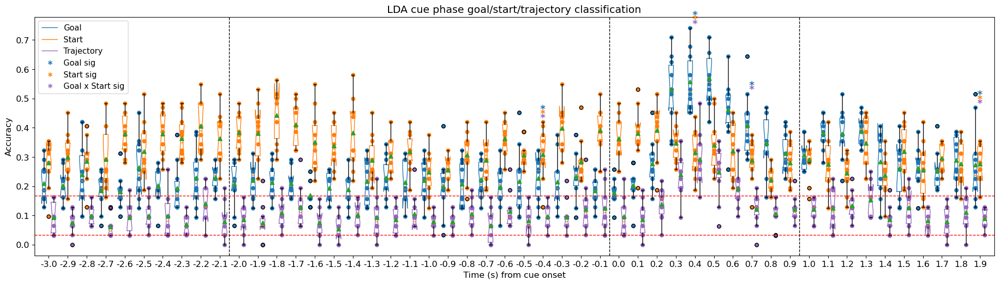

In [2577]:
plt.figure(figsize=(24, 6))
plt.title(f'LDA cue phase goal/start/trajectory classification')

# Plot as series of boxplots
bar_width = 0.25
bp1 = plt.boxplot(lda_goal_accuracy_iti_cue_timebins.T, positions=np.arange(1, num_timebins_ext+1)-bar_width, widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C0'}, flierprops={'marker': 'o', 'markersize': 5})
bp2 = plt.boxplot(lda_start_accuracy_iti_cue_timebins.T, positions=np.arange(1, num_timebins_ext+1), widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C1'}, flierprops={'marker': 'o', 'markersize': 5})
bp3 = plt.boxplot(lda_traj_accuracy_iti_cue_timebins.T, positions=np.arange(1, num_timebins_ext+1)+bar_width, widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C4'}, flierprops={'marker': 'o', 'markersize': 5})
topcaps1 = [cap.get_ydata()[0] for i, cap in enumerate(bp1['caps']) if i%2==1]
topcaps2 = [cap.get_ydata()[0] for i, cap in enumerate(bp2['caps']) if i%2==1]
topcaps3 = [cap.get_ydata()[0] for i, cap in enumerate(bp3['caps']) if i%2==1]
topcaps = [max(caps) for caps in zip(topcaps1, topcaps2, topcaps3)]
for k in range(num_timebins_ext):
    plt.scatter(np.ones_like(lda_goal_accuracy_iti_cue_timebins[k,:]) + k - bar_width, lda_goal_accuracy_iti_cue_timebins[k,:], s=25, color='C0')
    plt.scatter(np.ones_like(lda_start_accuracy_iti_cue_timebins[k,:]) + k, lda_start_accuracy_iti_cue_timebins[k,:], s=25, color='C1')
    plt.scatter(np.ones_like(lda_traj_accuracy_iti_cue_timebins[k,:]) + k + bar_width, lda_traj_accuracy_iti_cue_timebins[k,:], s=25, color='C4')
    p_vals = linear_multivar_glm_param_sigtest[k,:]
    offset = 0
    if p_vals[3] < sig_lvl: # Start x Goal interaction effect significance
        plt.annotate('*', xy=(k+1+bar_width/2, topcaps[k]+0.005), xytext=(k+1, topcaps[k]+0.005), horizontalalignment='center', fontsize=14, fontweight='bold', color='C4')
        offset += 1
    if p_vals[1] < sig_lvl: # Start effect significance
        plt.annotate('*', xy=(k+1+bar_width/2, topcaps[k]+0.005+0.015*offset), xytext=(k+1, topcaps[k]+0.005+0.015*offset), horizontalalignment='center', fontsize=14, fontweight='bold', color='C1')
        offset += 1
    if p_vals[2] < sig_lvl: # Goal effect significance
        plt.annotate('*', xy=(k+1+bar_width/2, topcaps[k]+0.005+0.015*offset), xytext=(k+1, topcaps[k]+0.005+0.015*offset), horizontalalignment='center', fontsize=14, fontweight='bold', color='C0')

plt.axhline(y=1/6, color='r', linewidth=1, linestyle='--')
plt.axhline(y=1/30, color='r', linewidth=1, linestyle='--')
plt.axvline(x=10.5, color='k', linewidth=1, linestyle='--')
plt.axvline(x=30.5, color='k', linewidth=1, linestyle='--')
plt.axvline(x=40.5, color='k', linewidth=1, linestyle='--')
plt.xticks(np.arange(1, num_timebins_ext+1), labels=[f'{n:.1f}' for n in np.concatenate([np.arange(-3, 0, 0.1), np.arange(0, 2, 0.1)])])
plt.xlabel('Time (s) from cue onset')
plt.ylabel('Accuracy')
plt.legend([bp1['boxes'][0], bp2['boxes'][0], bp3['boxes'][0], Line2D([0], [0], marker='$\u2217$', color='C0', markersize=7, markeredgewidth=0.3, linestyle='None'),\
            Line2D([0], [0], marker='$\u2217$', color='C1', markersize=7, markeredgewidth=0.3, linestyle='None'), Line2D([0], [0], marker='$\u2217$', color='C4', markersize=7, markeredgewidth=0.3, linestyle='None')],\
            ['Goal', 'Start', 'Trajectory', 'Goal sig', 'Start sig', 'Goal x Start sig'], loc='upper left', fontsize=11)

Multivariate Linear Regression, (x, y) position encoding

In [2578]:
poster_coordinates = {1: (-5, -7.5), 2: (-7.5, 5), 3: (7.5, -5), 4: (5, 7.5), 5: (5, 2.5), 6: (-5, -2.5)}

def design_matrix(traj):
    # traj is tuple of (start, goal), start & goal are 1-indexed
    s, g = traj
    sx, sy = poster_coordinates[s]
    gx, gy = poster_coordinates[g]

    # Layout of design matrix:
    # intercept + sx + sy + (sx * sy) + gx + gy + (gx * gy) + (sx * gx) + (sy * gy) + ((sx * sy) * (gx * gy))
    dm = np.ones((num_all_cells, 10))
    dm[:,1] = sx
    dm[:,2] = sy
    dm[:,3] = sx * sy
    dm[:,4] = gx
    dm[:,5] = gy
    dm[:,6] = gx * gy
    dm[:,7] = sx * gx
    dm[:,8] = sy * gy
    dm[:,9] = sx * sy * gx * gy
    return dm

In [2579]:
# Fit multivar linear model to all data
dm = list()
for trial in range(num_trials):
    dm.append(design_matrix(combined_trajectories_iti_cue[trial]))
dm = np.concatenate(dm)

linear_glm_multivar_models_v2 = list()
for timebin in range(num_timebins_ext):
    timebin_model = sm.OLS(combined_spikerates_iti_cue_zscored[:,timebin,:].flatten(), dm).fit()
    linear_glm_multivar_models_v2.append(timebin_model.summary())

In [2580]:
dict(enumerate(linear_glm_multivar_models_v2))

{0: <class 'statsmodels.iolib.summary.Summary'>
 """
                             OLS Regression Results                            
 Dep. Variable:                      y   R-squared:                       0.000
 Model:                            OLS   Adj. R-squared:                  0.000
 Method:                 Least Squares   F-statistic:                     1.922
 Date:                Tue, 09 Apr 2024   Prob (F-statistic):             0.0443
 Time:                        10:34:08   Log-Likelihood:            -2.3409e+05
 No. Observations:               73162   AIC:                         4.682e+05
 Df Residuals:                   73152   BIC:                         4.683e+05
 Df Model:                           9                                         
 Covariance Type:            nonrobust                                         
                  coef    std err          t      P>|t|      [0.025      0.975]
 ------------------------------------------------------------------

In [2581]:
# Column indexing is: (0) intercept, (1) start x, (2) start y, (3) start, (4) goal x, (5) goal y, (6) goal, (7) trajectory x, (8) trajectory y, (9) trajectory
linear_multivar_glm_param_sigtest_v2 = np.array([list(map(float, [row[4] for row in summary.tables[1].data[1:]])) for summary in linear_glm_multivar_models_v2])

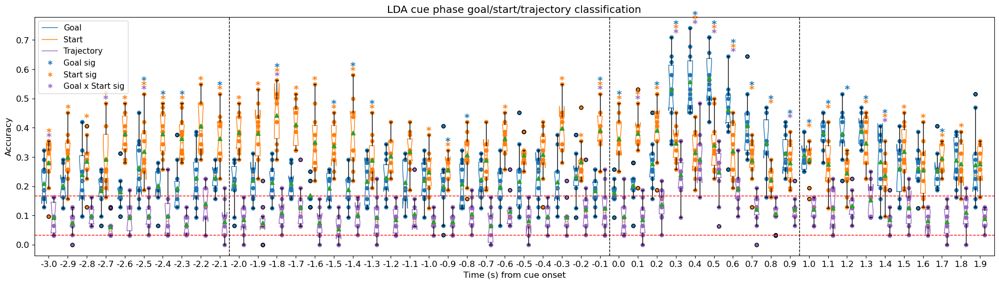

In [2582]:
plt.figure(figsize=(24, 6))
plt.title(f'LDA cue phase goal/start/trajectory classification')

# Plot as series of boxplots
bar_width = 0.25
bp1 = plt.boxplot(lda_goal_accuracy_iti_cue_timebins.T, positions=np.arange(1, num_timebins_ext+1)-bar_width, widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C0'}, flierprops={'marker': 'o', 'markersize': 5})
bp2 = plt.boxplot(lda_start_accuracy_iti_cue_timebins.T, positions=np.arange(1, num_timebins_ext+1), widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C1'}, flierprops={'marker': 'o', 'markersize': 5})
bp3 = plt.boxplot(lda_traj_accuracy_iti_cue_timebins.T, positions=np.arange(1, num_timebins_ext+1)+bar_width, widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C4'}, flierprops={'marker': 'o', 'markersize': 5})
topcaps1 = [cap.get_ydata()[0] for i, cap in enumerate(bp1['caps']) if i%2==1]
topcaps2 = [cap.get_ydata()[0] for i, cap in enumerate(bp2['caps']) if i%2==1]
topcaps3 = [cap.get_ydata()[0] for i, cap in enumerate(bp3['caps']) if i%2==1]
topcaps = [max(caps) for caps in zip(topcaps1, topcaps2, topcaps3)]
for k in range(num_timebins_ext):
    plt.scatter(np.ones_like(lda_goal_accuracy_iti_cue_timebins[k,:]) + k - bar_width, lda_goal_accuracy_iti_cue_timebins[k,:], s=25, color='C0')
    plt.scatter(np.ones_like(lda_start_accuracy_iti_cue_timebins[k,:]) + k, lda_start_accuracy_iti_cue_timebins[k,:], s=25, color='C1')
    plt.scatter(np.ones_like(lda_traj_accuracy_iti_cue_timebins[k,:]) + k + bar_width, lda_traj_accuracy_iti_cue_timebins[k,:], s=25, color='C4')
    p_vals = linear_multivar_glm_param_sigtest_v2[k,:]
    offset = 0
    if (p_vals[7] < sig_lvl) or (p_vals[8] < sig_lvl) or (p_vals[9] < sig_lvl): # Start x Goal interaction effect significance
        plt.annotate('*', xy=(k+1+bar_width/2, topcaps[k]+0.005), xytext=(k+1, topcaps[k]+0.005), horizontalalignment='center', fontsize=14, fontweight='bold', color='C4')
        offset += 1
    if (p_vals[1] < sig_lvl) or (p_vals[2] < sig_lvl) or (p_vals[3] < sig_lvl): # Start effect significance
        plt.annotate('*', xy=(k+1+bar_width/2, topcaps[k]+0.005+0.015*offset), xytext=(k+1, topcaps[k]+0.005+0.015*offset), horizontalalignment='center', fontsize=14, fontweight='bold', color='C1')
        offset += 1
    if (p_vals[4] < sig_lvl) or (p_vals[5] < sig_lvl) or (p_vals[6] < sig_lvl): # Goal effect significance
        plt.annotate('*', xy=(k+1+bar_width/2, topcaps[k]+0.005+0.015*offset), xytext=(k+1, topcaps[k]+0.005+0.015*offset), horizontalalignment='center', fontsize=14, fontweight='bold', color='C0')

plt.axhline(y=1/6, color='r', linewidth=1, linestyle='--')
plt.axhline(y=1/30, color='r', linewidth=1, linestyle='--')
plt.axvline(x=10.5, color='k', linewidth=1, linestyle='--')
plt.axvline(x=30.5, color='k', linewidth=1, linestyle='--')
plt.axvline(x=40.5, color='k', linewidth=1, linestyle='--')
plt.xticks(np.arange(1, num_timebins_ext+1), labels=[f'{n:.1f}' for n in np.concatenate([np.arange(-3, 0, 0.1), np.arange(0, 2, 0.1)])])
plt.xlabel('Time (s) from cue onset')
plt.ylabel('Accuracy')
plt.legend([bp1['boxes'][0], bp2['boxes'][0], bp3['boxes'][0], Line2D([0], [0], marker='$\u2217$', color='C0', markersize=7, markeredgewidth=0.3, linestyle='None'),\
            Line2D([0], [0], marker='$\u2217$', color='C1', markersize=7, markeredgewidth=0.3, linestyle='None'), Line2D([0], [0], marker='$\u2217$', color='C4', markersize=7, markeredgewidth=0.3, linestyle='None')],\
            ['Goal', 'Start', 'Trajectory', 'Goal sig', 'Start sig', 'Goal x Start sig'], loc='upper left', fontsize=11)

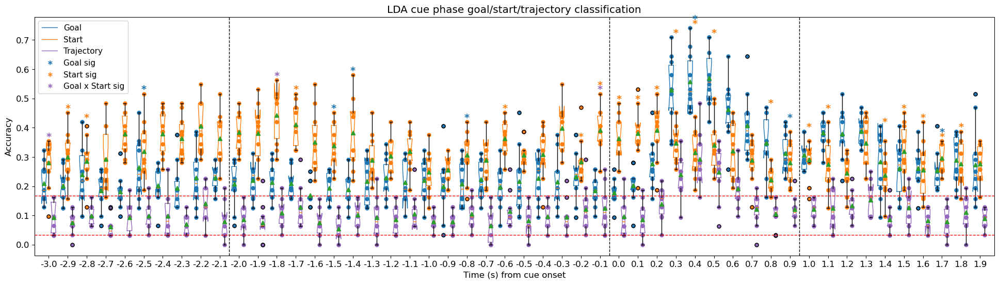

In [2583]:
plt.figure(figsize=(24, 6))
plt.title(f'LDA cue phase goal/start/trajectory classification')

# Plot as series of boxplots
bar_width = 0.25
bp1 = plt.boxplot(lda_goal_accuracy_iti_cue_timebins.T, positions=np.arange(1, num_timebins_ext+1)-bar_width, widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C0'}, flierprops={'marker': 'o', 'markersize': 5})
bp2 = plt.boxplot(lda_start_accuracy_iti_cue_timebins.T, positions=np.arange(1, num_timebins_ext+1), widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C1'}, flierprops={'marker': 'o', 'markersize': 5})
bp3 = plt.boxplot(lda_traj_accuracy_iti_cue_timebins.T, positions=np.arange(1, num_timebins_ext+1)+bar_width, widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C4'}, flierprops={'marker': 'o', 'markersize': 5})
topcaps1 = [cap.get_ydata()[0] for i, cap in enumerate(bp1['caps']) if i%2==1]
topcaps2 = [cap.get_ydata()[0] for i, cap in enumerate(bp2['caps']) if i%2==1]
topcaps3 = [cap.get_ydata()[0] for i, cap in enumerate(bp3['caps']) if i%2==1]
topcaps = [max(caps) for caps in zip(topcaps1, topcaps2, topcaps3)]
for k in range(num_timebins_ext):
    plt.scatter(np.ones_like(lda_goal_accuracy_iti_cue_timebins[k,:]) + k - bar_width, lda_goal_accuracy_iti_cue_timebins[k,:], s=25, color='C0')
    plt.scatter(np.ones_like(lda_start_accuracy_iti_cue_timebins[k,:]) + k, lda_start_accuracy_iti_cue_timebins[k,:], s=25, color='C1')
    plt.scatter(np.ones_like(lda_traj_accuracy_iti_cue_timebins[k,:]) + k + bar_width, lda_traj_accuracy_iti_cue_timebins[k,:], s=25, color='C4')
    p_vals = linear_multivar_glm_param_sigtest_v2[k,:]
    offset = 0
    if p_vals[9] < sig_lvl: # Start x Goal interaction effect significance
        plt.annotate('*', xy=(k+1+bar_width/2, topcaps[k]+0.005), xytext=(k+1, topcaps[k]+0.005), horizontalalignment='center', fontsize=14, fontweight='bold', color='C4')
        offset += 1
    if p_vals[3] < sig_lvl: # Start effect significance
        plt.annotate('*', xy=(k+1+bar_width/2, topcaps[k]+0.005+0.015*offset), xytext=(k+1, topcaps[k]+0.005+0.015*offset), horizontalalignment='center', fontsize=14, fontweight='bold', color='C1')
        offset += 1
    if p_vals[6] < sig_lvl: # Goal effect significance
        plt.annotate('*', xy=(k+1+bar_width/2, topcaps[k]+0.005+0.015*offset), xytext=(k+1, topcaps[k]+0.005+0.015*offset), horizontalalignment='center', fontsize=14, fontweight='bold', color='C0')

plt.axhline(y=1/6, color='r', linewidth=1, linestyle='--')
plt.axhline(y=1/30, color='r', linewidth=1, linestyle='--')
plt.axvline(x=10.5, color='k', linewidth=1, linestyle='--')
plt.axvline(x=30.5, color='k', linewidth=1, linestyle='--')
plt.axvline(x=40.5, color='k', linewidth=1, linestyle='--')
plt.xticks(np.arange(1, num_timebins_ext+1), labels=[f'{n:.1f}' for n in np.concatenate([np.arange(-3, 0, 0.1), np.arange(0, 2, 0.1)])])
plt.xlabel('Time (s) from cue onset')
plt.ylabel('Accuracy')
plt.legend([bp1['boxes'][0], bp2['boxes'][0], bp3['boxes'][0], Line2D([0], [0], marker='$\u2217$', color='C0', markersize=7, markeredgewidth=0.3, linestyle='None'),\
            Line2D([0], [0], marker='$\u2217$', color='C1', markersize=7, markeredgewidth=0.3, linestyle='None'), Line2D([0], [0], marker='$\u2217$', color='C4', markersize=7, markeredgewidth=0.3, linestyle='None')],\
            ['Goal', 'Start', 'Trajectory', 'Goal sig', 'Start sig', 'Goal x Start sig'], loc='upper left', fontsize=11)

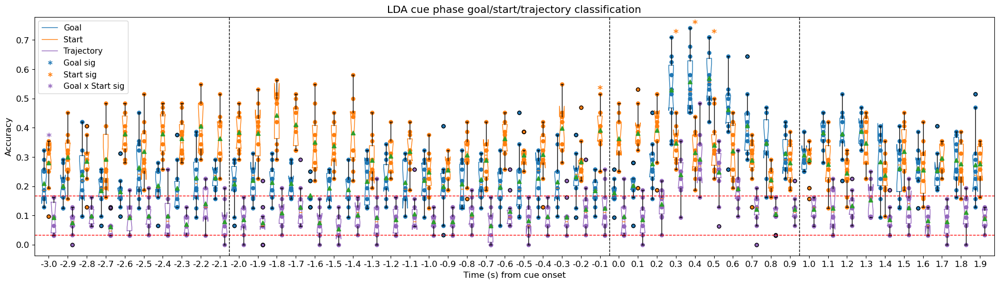

In [2584]:
plt.figure(figsize=(24, 6))
plt.title(f'LDA cue phase goal/start/trajectory classification')

# Plot as series of boxplots
bar_width = 0.25
bp1 = plt.boxplot(lda_goal_accuracy_iti_cue_timebins.T, positions=np.arange(1, num_timebins_ext+1)-bar_width, widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C0'}, flierprops={'marker': 'o', 'markersize': 5})
bp2 = plt.boxplot(lda_start_accuracy_iti_cue_timebins.T, positions=np.arange(1, num_timebins_ext+1), widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C1'}, flierprops={'marker': 'o', 'markersize': 5})
bp3 = plt.boxplot(lda_traj_accuracy_iti_cue_timebins.T, positions=np.arange(1, num_timebins_ext+1)+bar_width, widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C4'}, flierprops={'marker': 'o', 'markersize': 5})
topcaps1 = [cap.get_ydata()[0] for i, cap in enumerate(bp1['caps']) if i%2==1]
topcaps2 = [cap.get_ydata()[0] for i, cap in enumerate(bp2['caps']) if i%2==1]
topcaps3 = [cap.get_ydata()[0] for i, cap in enumerate(bp3['caps']) if i%2==1]
topcaps = [max(caps) for caps in zip(topcaps1, topcaps2, topcaps3)]
for k in range(num_timebins_ext):
    plt.scatter(np.ones_like(lda_goal_accuracy_iti_cue_timebins[k,:]) + k - bar_width, lda_goal_accuracy_iti_cue_timebins[k,:], s=25, color='C0')
    plt.scatter(np.ones_like(lda_start_accuracy_iti_cue_timebins[k,:]) + k, lda_start_accuracy_iti_cue_timebins[k,:], s=25, color='C1')
    plt.scatter(np.ones_like(lda_traj_accuracy_iti_cue_timebins[k,:]) + k + bar_width, lda_traj_accuracy_iti_cue_timebins[k,:], s=25, color='C4')
    p_vals = linear_multivar_glm_param_sigtest_v2[k,:]
    offset = 0
    if (p_vals[7] < sig_lvl) and (p_vals[8] < sig_lvl) and (p_vals[9] < sig_lvl): # Start x Goal interaction effect significance
        plt.annotate('*', xy=(k+1+bar_width/2, topcaps[k]+0.005), xytext=(k+1, topcaps[k]+0.005), horizontalalignment='center', fontsize=14, fontweight='bold', color='C4')
        offset += 1
    if (p_vals[1] < sig_lvl) and (p_vals[2] < sig_lvl) and (p_vals[3] < sig_lvl): # Start effect significance
        plt.annotate('*', xy=(k+1+bar_width/2, topcaps[k]+0.005+0.015*offset), xytext=(k+1, topcaps[k]+0.005+0.015*offset), horizontalalignment='center', fontsize=14, fontweight='bold', color='C1')
        offset += 1
    if (p_vals[4] < sig_lvl) and (p_vals[5] < sig_lvl) and (p_vals[6] < sig_lvl): # Goal effect significance
        plt.annotate('*', xy=(k+1+bar_width/2, topcaps[k]+0.005+0.015*offset), xytext=(k+1, topcaps[k]+0.005+0.015*offset), horizontalalignment='center', fontsize=14, fontweight='bold', color='C0')

plt.axhline(y=1/6, color='r', linewidth=1, linestyle='--')
plt.axhline(y=1/30, color='r', linewidth=1, linestyle='--')
plt.axvline(x=10.5, color='k', linewidth=1, linestyle='--')
plt.axvline(x=30.5, color='k', linewidth=1, linestyle='--')
plt.axvline(x=40.5, color='k', linewidth=1, linestyle='--')
plt.xticks(np.arange(1, num_timebins_ext+1), labels=[f'{n:.1f}' for n in np.concatenate([np.arange(-3, 0, 0.1), np.arange(0, 2, 0.1)])])
plt.xlabel('Time (s) from cue onset')
plt.ylabel('Accuracy')
plt.legend([bp1['boxes'][0], bp2['boxes'][0], bp3['boxes'][0], Line2D([0], [0], marker='$\u2217$', color='C0', markersize=7, markeredgewidth=0.3, linestyle='None'),\
            Line2D([0], [0], marker='$\u2217$', color='C1', markersize=7, markeredgewidth=0.3, linestyle='None'), Line2D([0], [0], marker='$\u2217$', color='C4', markersize=7, markeredgewidth=0.3, linestyle='None')],\
            ['Goal', 'Start', 'Trajectory', 'Goal sig', 'Start sig', 'Goal x Start sig'], loc='upper left', fontsize=11)

Single cell level multivariate linear regression

In [61]:
def design_matrix(traj):
    # traj is num_trials x 2 array of (start, goal), start & goal are 1-indexed
    s, g = traj[:,0], traj[:,1]
    t = np.array(list(map(lambda x: trajectory_indexing[tuple(x)] / 29, traj)))
    s = (s - 1) / 5
    g = (g - 1) / 5

    dm = np.ones((traj.shape[0], 4))
    dm[:,1] = s
    dm[:,2] = g
    dm[:,3] = t
    return dm

In [62]:
# Fit multivar linear model to all data
# Dimensions for list: cells x timebins
dm = design_matrix(combined_trajectories_iti_cue)
linear_glm_multivar_models_v3 = list()
for cell in range(num_all_cells):
    cell_models = list()
    for timebin in range(num_timebins_ext):
        timebin_model = sm.OLS(combined_spikerates_iti_cue_zscored[:,timebin,cell], dm).fit()
        cell_models.append(timebin_model)
    linear_glm_multivar_models_v3.append(cell_models)

In [63]:
def design_matrix(traj):
    # traj is num_trials x 2 array of (start, goal), start & goal are 1-indexed
    s, g = traj[:,0] / 6, traj[:,1] / 6
    dm = np.ones((traj.shape[0], 4))
    dm[:,1] = s
    dm[:,2] = g
    dm[:,3] = s * g
    return dm

# Order starts/goals for each cell according to firing rate preference
def ordered_labels(rates, trajs):
    # rates: trials x timebins shaped array of firing rates
    # trajs: trials x (start, goal) array of trajectory labels
    # keep start & goal 1-indexed
    rates_by_starts, rates_by_goals = {i+1: list() for i in range(num_goals)}, {i+1: list() for i in range(num_goals)}
    for i, (s, g) in enumerate(trajs):
        rates_by_starts[s].append(rates[i])
        rates_by_goals[g].append(rates[i])
    for key, value in rates_by_starts.items():
        rates_by_starts[key] = np.max(np.mean(np.stack(value), axis=0))
    rates_by_starts = np.array(list(rates_by_starts.values()))
    for key, value in rates_by_goals.items():
        rates_by_goals[key] = np.max(np.mean(np.stack(value), axis=0))
    rates_by_goals = np.array(list(rates_by_goals.values()))
    # return tuple of (ordered start labels, ordered goal labels)
    return np.argsort(rates_by_starts)+1, np.argsort(rates_by_goals)+1

In [64]:
# Fit multivar linear model to all data
# Array of start/goal label orderings for all cells, last axis indexing: (0) start, (1) goal
cell_ordered_labels = np.empty((num_all_cells, num_goals, 2), dtype=int)
# Dimensions for list of model fits: cells x timebins
linear_glm_multivar_models_v3 = list()
for cell in range(num_all_cells):
    # Re-ordering start and goal labels
    start_order, goal_order = ordered_labels(combined_spikerates_iti_cue_zscored[:,:,cell], combined_trajectories_iti_cue)
    cell_ordered_labels[cell,:,0] = start_order
    cell_ordered_labels[cell,:,1] = goal_order
    start_order = {val: idx for idx, val in enumerate(start_order, start=1)}
    goal_order = {val: idx for idx, val in enumerate(goal_order, start=1)}
    combined_trajectories_iti_cue_ordered = np.array([[start_order[s], goal_order[g]] for (s, g) in combined_trajectories_iti_cue])
    # Generate design matrix and fit models for all timebins for this cell
    dm_cell = design_matrix(combined_trajectories_iti_cue_ordered)
    cell_models = list()
    for timebin in range(num_timebins_ext):
        timebin_model = sm.OLS(combined_spikerates_iti_cue_zscored[:,timebin,cell], dm_cell).fit()
        cell_models.append(timebin_model)
    linear_glm_multivar_models_v3.append(cell_models)

In [65]:
# Significance testing for fitted coefficients for all cells, all timebins
linear_multivar_glm_param_sigtest_v3 = np.array([[model.pvalues for model in cell] for cell in linear_glm_multivar_models_v3])
linear_multivar_glm_param_sigtest_v3 = linear_multivar_glm_param_sigtest_v3 < sig_lvl / num_timebins_ext

# r-squared values for model fits for all cells, all timebins
linear_multivar_glm_rsquared_v3 = np.array([[model.rsquared for model in cell] for cell in linear_glm_multivar_models_v3])
linear_multivar_glm_rsquared_v3 = np.nan_to_num(linear_multivar_glm_rsquared_v3)

# Selectivity (by parameter test) for each cell across all timebins
def selectivity_type(arr):
    return arr[1] + arr[2] * 2 + arr[3] * 4
cell_selectivity = np.array([[selectivity_type(timebin) for timebin in cell] for cell in linear_multivar_glm_param_sigtest_v3])
selectivity_labels = ['none', 's', 'g', 'sg', 't', 'st', 'gt', 'sgt']

/Users/jcheng/miniconda3/envs/decoding/lib/python3.10/site-packages/statsmodels/regression/linear_model.py:1736: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - self.ssr/self.centered_tss


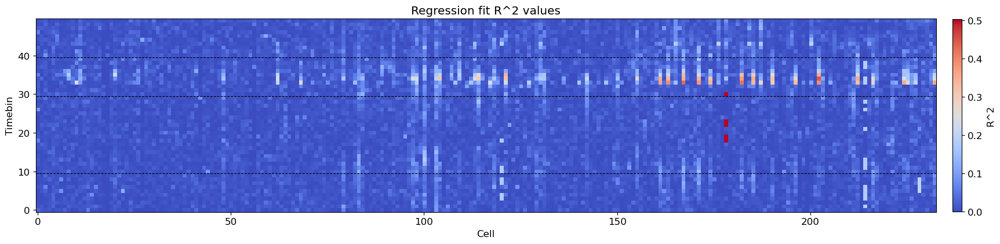

In [66]:
fig, ax = plt.subplots(figsize=(24, 6))
plt.title('Regression fit R^2 values')

im = ax.imshow(linear_multivar_glm_rsquared_v3.T, cmap='coolwarm', vmin=0, origin='lower')
plt.colorbar(im, ax=ax, label='R^2', shrink=0.72, pad=0.015)
ax.set_xlabel('Cell')
ax.set_ylabel('Timebin')

ax.axhline(y=9.5, linewidth=0.8, linestyle='--', color='k')
ax.axhline(y=29.5, linewidth=0.8, linestyle='--', color='k')
ax.axhline(y=39.5, linewidth=0.8, linestyle='--', color='k')

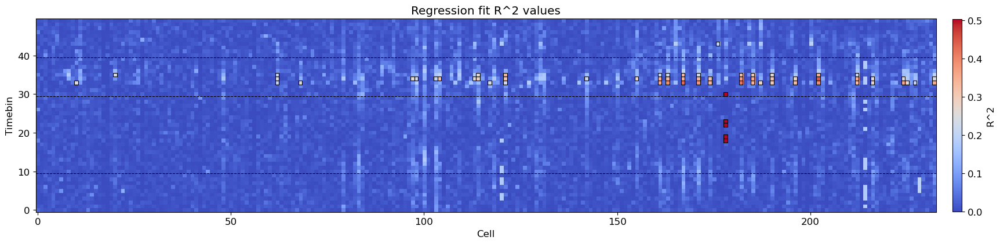

In [67]:
rsquared_threshold = 0.2
# rsquared_good_cells = np.unique(np.where(linear_multivar_glm_rsquared_v3 > rsquared_threshold)[0])
rsquared_good_samples = np.array(np.where(linear_multivar_glm_rsquared_v3 > rsquared_threshold)).T

fig, ax = plt.subplots(figsize=(24, 6))
plt.title('Regression fit R^2 values')

im = ax.imshow(linear_multivar_glm_rsquared_v3.T, cmap='coolwarm', vmin=0, origin='lower')
plt.colorbar(im, ax=ax, label='R^2', shrink=0.72, pad=0.015)
ax.set_xlabel('Cell')
ax.set_ylabel('Timebin')

# for c in rsquared_good_cells:
#     ax.add_patch(Rectangle((c-0.5, -0.5), 1, num_timebins_ext, linewidth=0.8, linestyle='--', edgecolor='k', facecolor='none'))
for i, j in rsquared_good_samples:
    ax.add_patch(Rectangle((i-0.5, j-0.5), 1, 1, linewidth=0.8, linestyle='-', edgecolor='k', facecolor='none'))
ax.axhline(y=9.5, linewidth=0.8, linestyle='--', color='k')
ax.axhline(y=29.5, linewidth=0.8, linestyle='--', color='k')
ax.axhline(y=39.5, linewidth=0.8, linestyle='--', color='k')

In [ ]:
rsquared_good_cells = np.unique(np.where(linear_multivar_glm_rsquared_v3 > rsquared_threshold)[0])
[all_cell_labels[c] for c in rsquared_good_cells]

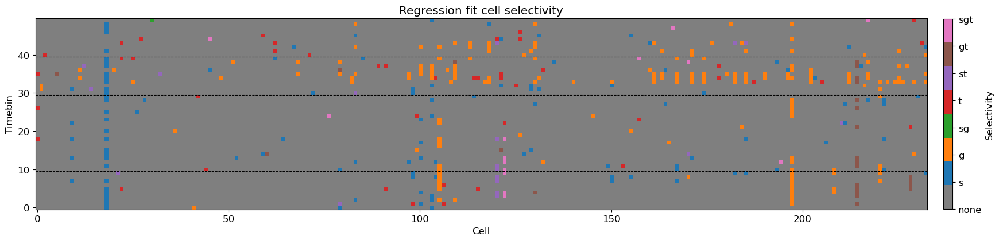

In [69]:
fig, ax = plt.subplots(figsize=(24, 6))
plt.title('Regression fit cell selectivity')

custom_cmap = ListedColormap(['tab:grey', 'tab:blue', 'tab:orange', 'tab:green', 'tab:red', 'tab:purple', 'tab:brown', 'tab:pink'])
im = ax.imshow(cell_selectivity.T, cmap=custom_cmap, origin='lower')
cbar = plt.colorbar(im, ax=ax, label='Selectivity', shrink=0.72, pad=0.015)
cbar.set_ticks(np.arange(8), labels=selectivity_labels)
ax.set_xlabel('Cell')
ax.set_ylabel('Timebin')

ax.axhline(y=9.5, linewidth=0.8, linestyle='--', color='k')
ax.axhline(y=29.5, linewidth=0.8, linestyle='--', color='k')
ax.axhline(y=39.5, linewidth=0.8, linestyle='--', color='k')

In [70]:
# place_cell_indexes = sorted([all_cell_labels.index(cell) for cell in place_cell_labels if cell in all_cell_labels])
# view_cell_indexes = sorted([all_cell_labels.index(cell) for cell in view_cell_labels if cell in all_cell_labels])
pv_cell_indexes = sorted([all_cell_labels.index(cell) for cell in pv_cell_labels if cell in all_cell_labels])

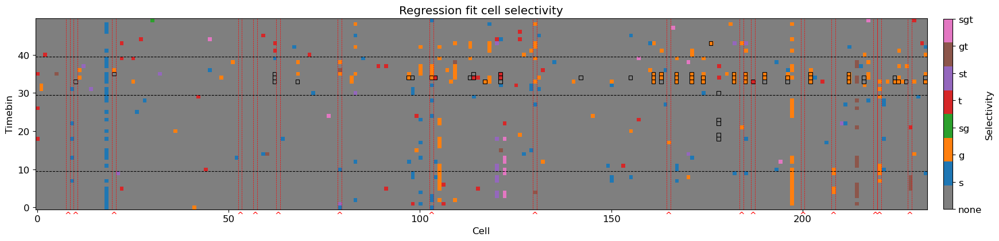

In [410]:
fig, ax = plt.subplots(figsize=(24, 6))
plt.title('Regression fit cell selectivity')

custom_cmap = ListedColormap(['tab:grey', 'tab:blue', 'tab:orange', 'tab:green', 'tab:red', 'tab:purple', 'tab:brown', 'tab:pink'])
im = ax.imshow(cell_selectivity.T, cmap=custom_cmap, origin='lower')
cbar = plt.colorbar(im, ax=ax, label='Selectivity', shrink=0.72, pad=0.015)
cbar.set_ticks(np.arange(8), labels=selectivity_labels)
ax.set_xlabel('Cell')
ax.set_ylabel('Timebin')

# for c in rsquared_good_cells:
#     ax.add_patch(Rectangle((c-0.5, -0.5), 1, num_timebins_ext, linewidth=0.8, linestyle='--', edgecolor='k', facecolor='none'))
for i, j in rsquared_good_samples:
    ax.add_patch(Rectangle((i-0.5, j-0.5), 1, 1, linewidth=0.8, linestyle='-', edgecolor='k', facecolor='none'))
ax.axhline(y=9.5, linewidth=0.8, linestyle='--', color='k')
ax.axhline(y=29.5, linewidth=0.8, linestyle='--', color='k')
ax.axhline(y=39.5, linewidth=0.8, linestyle='--', color='k')

# Add annotations for place and view cells
# for cell in place_cell_indexes:
#     ax.text(cell, -1, '^', fontsize=10, color='tab:red', ha='center', va='top')
# for cell in view_cell_indexes:
#     ax.text(cell, -1, '^', fontsize=10, color='tab:red', ha='center', va='top')
for cell in pv_cell_indexes:
    ax.add_patch(Rectangle((cell-0.5, -0.5), 1, num_timebins_ext, linewidth=0.5, linestyle='--', edgecolor='r', facecolor='none'))
    ax.text(cell, -1, '^', fontsize=10, color='r', ha='center', va='top')

'20180810ch86c2'

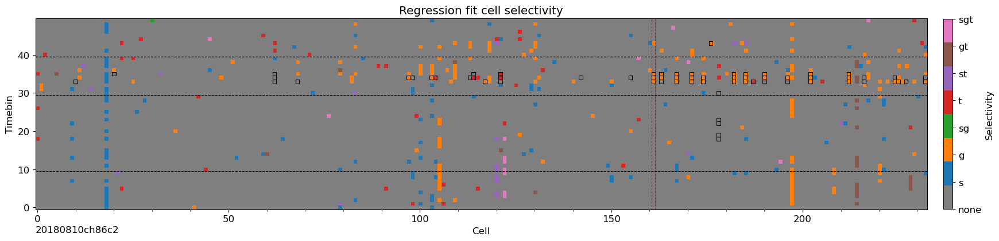

In [473]:
fig, ax = plt.subplots(figsize=(24, 6))
plt.title('Regression fit cell selectivity')

custom_cmap = ListedColormap(['tab:grey', 'tab:blue', 'tab:orange', 'tab:green', 'tab:red', 'tab:purple', 'tab:brown', 'tab:pink'])
im = ax.imshow(cell_selectivity.T, cmap=custom_cmap, origin='lower')
cbar = plt.colorbar(im, ax=ax, label='Selectivity', shrink=0.72, pad=0.015)
cbar.set_ticks(np.arange(8), labels=selectivity_labels)
ax.set_xlabel('Cell')
ax.set_ylabel('Timebin')
ax.xaxis.set_minor_locator(plt.MultipleLocator(10))

ax.axhline(y=9.5, linewidth=0.8, linestyle='--', color='k')
ax.axhline(y=29.5, linewidth=0.8, linestyle='--', color='k')
ax.axhline(y=39.5, linewidth=0.8, linestyle='--', color='k')
for i, j in rsquared_good_samples:
    ax.add_patch(Rectangle((i-0.5, j-0.5), 1, 1, linewidth=0.8, linestyle='-', edgecolor='k', facecolor='none'))
 
cell = 161
patch = ax.add_patch(Rectangle((cell-0.5, -0.5), 1, num_timebins_ext, linewidth=0.8, linestyle='--', edgecolor='r', facecolor='none'))
text = ax.text(0, -0.12, f'{all_cell_labels[cell]}', transform=ax.transAxes)

# # Define the slider's axes and parameters
# ax_slider = plt.axes([0.15, 0.1, 0.63, 0.03], facecolor='lightgoldenrodyellow')  # (left, bottom, width, height)
# slider = Slider(ax_slider, 'Cell', 0, num_all_cells, valinit=cell, valstep=1)

# # Define a function to update the patch position based on the slider value
# def update(val):
#     pos = slider.val  # Get the slider value
#     patch.set_x(pos)  # Update the x position of the patch
#     text.set_text(f'{all_cell_labels[int(pos)]}')  # Update the text annotation
#     fig.canvas.draw_idle()  # Redraw the figure

# # Link the slider to the update function
# slider.on_changed(update)

# # Add a text annotation next to the slider
# text = ax.text(0, -0.12, f'{all_cell_labels[int(slider.val)]}', transform=ax.transAxes)

In [ ]:
def selectivity_type(arr):
    res = ''
    if arr[1]:
        res += 's'
    if arr[2]:
        res += 'g'
    if arr[3]:
        res += 't'
    while len(res) < 3:
        res = ' ' + res
    return res

cell_selectivity = [[selectivity_type(timebin) for timebin in cell] for cell in linear_multivar_glm_param_sigtest_v3]
cell_selectivity = [list(row) for row in zip(*cell_selectivity)]

for cell in cell_selectivity[::-1]:
    print(cell)

Marginal distributions

In [323]:
# Plot regression fit condensed across all goals (plotting starts against FR)
for cell in range(num_all_cells):
    def regression_eqn(s, g, frame):
        # s and g are 1-indexed start and goal respectively
        params = linear_glm_multivar_models_v3[cell][frame].params
        s = s / 6
        g = g / 6
        return params[0] + params[1] * s + params[2] * g + params[3] * s * g

    fig = plt.figure(figsize=(8, 6))
    ax = plt.gca()
    ax.set_title(f'Regression fit for cell {all_cell_labels[cell]} | t = {-3:.1f}s')

    # Marginal distribution across goals (x-axis is start)
    sc = ax.scatter(combined_trajectories_iti_cue_ordered[:,0], combined_spikerates_iti_cue_zscored[:,0,cell], color='C3')
    lines = list()
    x_axis, y_axis = np.meshgrid(np.linspace(1, 6, 6), np.linspace(1, 6, 6))
    model_pred = np.zeros((num_goals, num_goals, num_timebins_ext))
    for t in range(num_timebins_ext):
        for i in range(num_goals):
            for j in range(num_goals):
                model_pred[i,j,t] = regression_eqn(x_axis[i,j], y_axis[i,j], t)
    for g in range(num_goals):
        lines.extend(ax.plot(np.arange(1, num_goals+1), model_pred[:,g,0], color='C0', alpha=0.5))

    ax.set_xlabel('Start')
    ax.set_ylabel('z-scored FR')
    ax.set_xticks(np.arange(1, num_goals+1), labels=cell_ordered_labels[cell,:,0])
    ax_lims = [min([np.round(np.percentile(combined_spikerates_iti_cue_zscored[:,frame,cell].flatten(), 0), 1) for frame in range(num_timebins_ext)]),\
                max([np.round(np.percentile(combined_spikerates_iti_cue_zscored[:,frame,cell].flatten(), 100), 1) for frame in range(num_timebins_ext)])]
    if ax_lims[0] < ax_lims[1]:
        ax_lims[0], ax_lims[1] = ax_lims[0] - 0.05 * (ax_lims[1] - ax_lims[0]), ax_lims[1] + 0.05 * (ax_lims[1] - ax_lims[0])
        ax.set_ylim(ax_lims)
    else:
        ax_lims = ax.get_ylim()
    txt = ax.text(0.85, -0.13, f'sel: {selectivity_labels[cell_selectivity[cell,0]]}\nr_sq: {linear_multivar_glm_rsquared_v3[cell,0]:.3f}', transform=ax.transAxes)

    def update(frame):
        sc.set_offsets(np.column_stack([combined_trajectories_iti_cue_ordered[:,0], combined_spikerates_iti_cue_zscored[:,frame,cell]]))
        for g in range(num_goals):
            lines[g].set_data(np.arange(1, num_goals+1), model_pred[:,g,frame])
        ax.set_title(f'Regression fit for cell {all_cell_labels[cell]} | t = {0.1 * frame - 3:.1f}s')
        txt.set_text(f'sel: {selectivity_labels[cell_selectivity[cell,frame]]}\nr_sq: {linear_multivar_glm_rsquared_v3[cell,frame]:.3f}')

    ani = FuncAnimation(fig, update, frames=num_timebins_ext, interval=1000, blit=False, repeat=True)
    HTML(ani.to_html5_video())

    if to_save:
        if not os.path.exists(figsave_dir):
            os.makedirs(figsave_dir)
        ani.save(f'{figsave_dir}/mlr_fits/start_marginal/mlr_fit_{all_cell_labels[cell]}.mp4', writer='ffmpeg')
    plt.close()

In [324]:
# Plot regression fit condensed across all starts (plotting goals against FR)
for cell in range(num_all_cells):
    def regression_eqn(s, g, frame):
        # s and g are 1-indexed start and goal respectively
        params = linear_glm_multivar_models_v3[cell][frame].params
        s = s / 6
        g = g / 6
        return params[0] + params[1] * s + params[2] * g + params[3] * s * g

    fig = plt.figure(figsize=(8, 6))
    ax = plt.gca()
    ax.set_title(f'Regression fit for cell {all_cell_labels[cell]} | t = {-3:.1f}s')

    # Marginal distribution across starts (x-axis is goal)
    sc = ax.scatter(combined_trajectories_iti_cue_ordered[:,1], combined_spikerates_iti_cue_zscored[:,0,cell], color='C3')
    lines = list()
    x_axis, y_axis = np.meshgrid(np.linspace(1, 6, 6), np.linspace(1, 6, 6))
    model_pred = np.zeros_like(x_axis)
    for i in range(num_goals):
        for j in range(num_goals):
            model_pred[i,j] = regression_eqn(x_axis[i,j], y_axis[i,j], 0)
    for s in range(num_goals):
        lines.extend(ax.plot(np.arange(1, num_goals+1), model_pred[s,:,0], color='C0', alpha=0.5))

    ax.set_xlabel('Goal')
    ax.set_ylabel('z-scored FR')
    ax.set_xticks(np.arange(1, num_goals+1), labels=cell_ordered_labels[cell,:,1])
    ax_lims = [min([np.round(np.percentile(combined_spikerates_iti_cue_zscored[:,frame,cell].flatten(), 0), 1) for frame in range(num_timebins_ext)]),\
                max([np.round(np.percentile(combined_spikerates_iti_cue_zscored[:,frame,cell].flatten(), 100), 1) for frame in range(num_timebins_ext)])]
    if ax_lims[0] < ax_lims[1]:
        ax_lims[0], ax_lims[1] = ax_lims[0] - 0.05 * (ax_lims[1] - ax_lims[0]), ax_lims[1] + 0.05 * (ax_lims[1] - ax_lims[0])
        ax.set_ylim(ax_lims)
    else:
        ax_lims = ax.get_ylim()
    txt = ax.text(0.85, -0.13, f'sel: {selectivity_labels[cell_selectivity[cell,0]]}\nr_sq: {linear_multivar_glm_rsquared_v3[cell,0]:.3f}', transform=ax.transAxes)

    def update(frame):
        sc.set_offsets(np.column_stack([combined_trajectories_iti_cue_ordered[:,1], combined_spikerates_iti_cue_zscored[:,frame,cell]]))
        for s in range(num_goals):
            lines[s].set_data(np.arange(1, num_goals+1), model_pred[s,:,frame])
        ax.set_title(f'Regression fit for cell {all_cell_labels[cell]} | t = {0.1 * frame - 3:.1f}s')
        txt.set_text(f'sel: {selectivity_labels[cell_selectivity[cell,frame]]}\nr_sq: {linear_multivar_glm_rsquared_v3[cell,frame]:.3f}')

    ani = FuncAnimation(fig, update, frames=num_timebins_ext, interval=1000, blit=False, repeat=True)
    HTML(ani.to_html5_video())

    if to_save:
        if not os.path.exists(figsave_dir):
            os.makedirs(figsave_dir)
        ani.save(f'{figsave_dir}/mlr_fits/goal_marginal/mlr_fit_{all_cell_labels[cell]}.mp4', writer='ffmpeg')
    plt.close()

Full 3D space

In [326]:
# Plot regression fit against data points for each cell and timebin
for cell in range(num_all_cells):
    frame = 0
    # def regression_eqn(s, g, frame):
    #     # s and g are 1-indexed start and goal respectively
    #     params = linear_glm_multivar_models_v3[cell][frame].params
    #     if s == g:
    #         t = (trajectory_indexing.get((s-1, g), 0) + trajectory_indexing.get((s+1, g), 29)) / (2 * 29)
    #     else:
    #         t = trajectory_indexing[(s, g)] / 29
    #     s = (s - 1) / 5
    #     g = (g - 1) / 5
    #     return params[0] + params[1] * s + params[2] * g + params[3] * t
    def regression_eqn(s, g, frame):
        # s and g are 1-indexed start and goal respectively
        params = linear_glm_multivar_models_v3[cell][frame].params
        s = s / 6
        g = g / 6
        return params[0] + params[1] * s + params[2] * g + params[3] * s * g

    fig = plt.figure(figsize=(16, 12))
    ax = fig.add_subplot(1, 1, 1, projection='3d')
    ax.set_title(f'Regression fit for cell {all_cell_labels[cell]} | t = {0.1 * frame - 3:.1f}s', x=0.52, y=0.94)

    x_axis, y_axis = np.meshgrid(np.linspace(1, 6, 6), np.linspace(1, 6, 6))
    model_pred = np.zeros((num_goals, num_goals, num_timebins_ext))
    for t in range(num_timebins_ext):
        for i in range(num_goals):
            for j in range(num_goals):
                model_pred[i,j,t] = regression_eqn(x_axis[i,j], y_axis[i,j], t)
    surf = ax.plot_surface(x_axis, y_axis, model_pred[:,:,frame], alpha=0.8, color='tab:blue')

    start_order = {val: idx for idx, val in enumerate(cell_ordered_labels[cell,:,0], start=1)}
    goal_order = {val: idx for idx, val in enumerate(cell_ordered_labels[cell,:,1], start=1)}
    combined_trajectories_iti_cue_ordered = np.array([[start_order[s], goal_order[g]] for (s, g) in combined_trajectories_iti_cue])
    sc = ax.scatter(combined_trajectories_iti_cue_ordered[:,0], combined_trajectories_iti_cue_ordered[:,1], combined_spikerates_iti_cue_zscored[:,frame,cell], color='C3')

    ax.view_init(elev=15, azim=-55)
    ax.set_xlabel('Start')
    ax.set_ylabel('Goal')
    ax.set_zlabel('z-scored FR')
    ax.set_xticks(np.arange(1, num_goals+1), labels=cell_ordered_labels[cell,:,0])
    ax.set_yticks(np.arange(1, num_goals+1), labels=cell_ordered_labels[cell,:,1])
    ax_lims = [min([np.round(np.percentile(combined_spikerates_iti_cue_zscored[:,frame,cell].flatten(), 1), 1) for frame in range(num_timebins_ext)]),\
                max([np.round(np.percentile(combined_spikerates_iti_cue_zscored[:,frame,cell].flatten(), 99), 1) for frame in range(num_timebins_ext)])]
    if ax_lims[0] < ax_lims[1]:
        ax_lims[0], ax_lims[1] = ax_lims[0] - 0.05 * (ax_lims[1] - ax_lims[0]), ax_lims[1] + 0.05 * (ax_lims[1] - ax_lims[0])
        ax.set_zlim(ax_lims)
    else:
        ax_lims = ax.get_zlim()
    txt = ax.text(6, 6, 1.15*(ax_lims[1]-ax_lims[0])+ax_lims[0], f'sel: {selectivity_labels[cell_selectivity[cell,frame]]}\nr_sq: {linear_multivar_glm_rsquared_v3[cell,frame]:.3f}')

    def update(frame):
        sc._offsets3d = (combined_trajectories_iti_cue_ordered[:,0], combined_trajectories_iti_cue_ordered[:,1], combined_spikerates_iti_cue_zscored[:,frame,cell])
        global surf
        surf.remove()
        surf = ax.plot_surface(x_axis, y_axis, model_pred[:,:,frame], alpha=0.8, color='tab:blue')
        ax.set_title(f'Regression fit for cell {all_cell_labels[cell]} | t = {0.1 * frame - 3:.1f}s', x=0.5, y=0.94)
        txt.set_text(f'sel: {selectivity_labels[cell_selectivity[cell,frame]]}\nr_sq: {linear_multivar_glm_rsquared_v3[cell,frame]:.3f}')

    ani = FuncAnimation(fig, update, frames=num_timebins_ext, interval=1000, blit=False, repeat=True)
    HTML(ani.to_html5_video())

    if to_save:
        if not os.path.exists(figsave_dir):
            os.makedirs(figsave_dir)
        ani.save(f'{figsave_dir}/mlr_fits/mlr_fit_{all_cell_labels[cell]}.mp4', writer='ffmpeg')
    plt.close()

In [3248]:
# Plot regression fit against data points for each cell and timebin
for cell in range(num_all_cells):
    frame = 0
    # def regression_eqn(s, g, frame):
    #     # s and g are 1-indexed start and goal respectively
    #     params = linear_glm_multivar_models_v3[cell][frame].params
    #     if s == g:
    #         t = (trajectory_indexing.get((s-1, g), 0) + trajectory_indexing.get((s+1, g), 29)) / (2 * 29)
    #     else:
    #         t = trajectory_indexing[(s, g)] / 29
    #     s = (s - 1) / 5
    #     g = (g - 1) / 5
    #     return params[0] + params[1] * s + params[2] * g + params[3] * t
    def regression_eqn(s, g, frame):
        # s and g are 1-indexed start and goal respectively
        params = linear_glm_multivar_models_v3[cell][frame].params
        s = s / 6
        g = g / 6
        return params[0] + params[1] * s + params[2] * g + params[3] * s * g

    fig = plt.figure(figsize=(16, 12))
    ax = fig.add_subplot(1, 1, 1, projection='3d')
    ax.set_title(f'Regression fit for cell {all_cell_labels[cell]} | t = {0.1 * frame - 3:.1f}s', x=0.52, y=0.94)

    x_axis, y_axis = np.meshgrid(np.linspace(1, 6, 6), np.linspace(1, 6, 6))
    model_pred = np.zeros((num_goals, num_goals, num_timebins_ext))
    for t in range(num_timebins_ext):
        for i in range(num_goals):
            for j in range(num_goals):
                model_pred[i,j,t] = regression_eqn(x_axis[i,j], y_axis[i,j], t)
    surf = ax.plot_surface(x_axis, y_axis, model_pred[:,:,frame], alpha=0.8, color='tab:blue')

    start_order = {val: idx for idx, val in enumerate(cell_ordered_labels[cell,:,0], start=1)}
    goal_order = {val: idx for idx, val in enumerate(cell_ordered_labels[cell,:,1], start=1)}
    combined_trajectories_iti_cue_ordered = np.array([[start_order[s], goal_order[g]] for (s, g) in combined_trajectories_iti_cue])
    bar = ax.bar3d(combined_trajectories_iti_cue_ordered[:,0], combined_trajectories_iti_cue_ordered[:,1], ax_lims[0], 0.3, 0.3, combined_spikerates_iti_cue_zscored[:,frame,cell], color='C3', alpha=0.3)

    ax.view_init(elev=15, azim=-55)
    ax.set_xlabel('Start')
    ax.set_ylabel('Goal')
    ax.set_zlabel('z-scored FR')
    ax.set_xticks(np.arange(1, num_goals+1), labels=cell_ordered_labels[cell,:,0])
    ax.set_yticks(np.arange(1, num_goals+1), labels=cell_ordered_labels[cell,:,1])
    ax_lims = [min([np.round(np.percentile(combined_spikerates_iti_cue_zscored[:,frame,cell].flatten(), 1), 1) for frame in range(num_timebins_ext)]),\
        max([np.round(np.percentile(combined_spikerates_iti_cue_zscored[:,frame,cell].flatten(), 99), 1) for frame in range(num_timebins_ext)])]
    if ax_lims[0] < ax_lims[1]:
        ax_lims[0], ax_lims[1] = ax_lims[0] - 0.05 * (ax_lims[1] - ax_lims[0]), ax_lims[1] + 0.05 * (ax_lims[1] - ax_lims[0])
        ax.set_zlim(ax_lims)
    else:
        ax_lims = ax.get_zlim()
    txt = ax.text(6, 6, 1.15*(ax_lims[1]-ax_lims[0])+ax_lims[0], f'sel: {selectivity_labels[cell_selectivity[cell,frame]]}\nr_sq: {linear_multivar_glm_rsquared_v3[cell,frame]:.3f}')

    def update(frame):
        global surf, bar
        surf.remove()
        surf = ax.plot_surface(x_axis, y_axis, model_pred[:,:,frame], alpha=0.8, color='tab:blue')
        bar.remove()
        bar = ax.bar3d(combined_trajectories_iti_cue_ordered[:,0], combined_trajectories_iti_cue_ordered[:,1], ax_lims[0], 0.3, 0.3, combined_spikerates_iti_cue_zscored[:,frame,cell], color='C3', alpha=0.3)
        ax.set_title(f'Regression fit for cell {all_cell_labels[cell]} | t = {0.1 * frame - 3:.1f}s', x=0.5, y=0.94)
        txt.set_text(f'sel: {selectivity_labels[cell_selectivity[cell,frame]]}\nr_sq: {linear_multivar_glm_rsquared_v3[cell,frame]:.3f}')

    ani = FuncAnimation(fig, update, frames=num_timebins_ext, interval=1000, blit=False, repeat=True)
    HTML(ani.to_html5_video())

    if to_save:
        if not os.path.exists(figsave_dir):
            os.makedirs(figsave_dir)
        ani.save(f'{figsave_dir}/mlr_fits/bars/mlr_fit_{all_cell_labels[cell]}.mp4', writer='ffmpeg')
    plt.close()

Single cell level multivariate linear regression, but with trial-type averaged responses

In [407]:
def design_matrix(traj):
    # traj is num_trials x 2 array of (start, goal), start & goal are 1-indexed
    s, g = traj[:,0] / 6, traj[:,1] / 6
    dm = np.ones((traj.shape[0], 4))
    dm[:,1] = s
    dm[:,2] = g
    dm[:,3] = s * g
    return dm

# Order starts/goals for each cell according to firing rate preference
def ordered_labels(rates, trajs):
    # rates: trials x timebins shaped array of firing rates
    # trajs: trials x (start, goal) array of trajectory labels
    # keep start & goal 1-indexed
    rates_by_starts, rates_by_goals = {i+1: list() for i in range(num_goals)}, {i+1: list() for i in range(num_goals)}
    for i, (s, g) in enumerate(trajs):
        rates_by_starts[s].append(rates[i])
        rates_by_goals[g].append(rates[i])
    for key, value in rates_by_starts.items():
        rates_by_starts[key] = np.max(np.mean(np.stack(value), axis=0))
    rates_by_starts = np.array(list(rates_by_starts.values()))
    for key, value in rates_by_goals.items():
        rates_by_goals[key] = np.max(np.mean(np.stack(value), axis=0))
    rates_by_goals = np.array(list(rates_by_goals.values()))
    # return tuple of (ordered start labels, ordered goal labels)
    return np.argsort(rates_by_starts)+1, np.argsort(rates_by_goals)+1

In [408]:
# Get trial-type averaged, then z-scored firing rates
combined_spikerates_iti_cue_trialavg = np.empty((len(trajectories), num_timebins_ext, num_all_cells))
combined_trajectories_iti_cue_trialavg = np.empty((len(trajectories), 2))

trial = 0
for s in range(num_goals):
    for g in range(num_goals-1):
        combined_spikerates_iti_cue_trialavg[trial,:,:] = combined_spikerates_iti_cue_per_traj_trialavg[:,s,g,:].T
        combined_trajectories_iti_cue_trialavg[trial] = combined_dpc_traj_labels[s,g,:].astype(int) + 1
        trial += 1

combined_spikerates_iti_cue_trialavg_zscored = (combined_spikerates_iti_cue_trialavg - np.mean(np.mean(combined_spikerates_iti_cue_trialavg, axis=0), axis=0)) /\
    np.std(np.std(combined_spikerates_iti_cue_trialavg, axis=0), axis=0)

In [409]:
# Fit multivar linear model to all data
# Array of start/goal label orderings for all cells, last axis indexing: (0) start, (1) goal
cell_ordered_labels = np.empty((num_all_cells, num_goals, 2), dtype=int)
# Dimensions for list of model fits: cells x timebins
linear_glm_multivar_models_v4 = list()
for cell in range(num_all_cells):
    # Re-ordering start and goal labels
    start_order, goal_order = ordered_labels(combined_spikerates_iti_cue_trialavg_zscored[:,:,cell], combined_trajectories_iti_cue_trialavg)
    cell_ordered_labels[cell,:,0] = start_order
    cell_ordered_labels[cell,:,1] = goal_order
    start_order = {val: idx for idx, val in enumerate(start_order, start=1)}
    goal_order = {val: idx for idx, val in enumerate(goal_order, start=1)}
    combined_trajectories_iti_cue_trialavg_ordered = np.array([[start_order[s], goal_order[g]] for (s, g) in combined_trajectories_iti_cue_trialavg])
    # Generate design matrix and fit models for all timebins for this cell
    dm_cell = design_matrix(combined_trajectories_iti_cue_trialavg_ordered)
    cell_models = list()
    for timebin in range(num_timebins_ext):
        timebin_model = sm.OLS(combined_spikerates_iti_cue_trialavg_zscored[:,timebin,cell], dm_cell).fit()
        cell_models.append(timebin_model)
    linear_glm_multivar_models_v4.append(cell_models)

In [410]:
# Significance testing for fitted coefficients for all cells, all timebins
linear_multivar_glm_param_sigtest_v4 = np.array([[model.pvalues for model in cell] for cell in linear_glm_multivar_models_v4])
linear_multivar_glm_param_sigtest_v4 = linear_multivar_glm_param_sigtest_v4 < sig_lvl / num_timebins_ext

# r-squared values for model fits for all cells, all timebins
linear_multivar_glm_rsquared_v4 = np.array([[model.rsquared for model in cell] for cell in linear_glm_multivar_models_v4])
linear_multivar_glm_rsquared_v4 = np.nan_to_num(linear_multivar_glm_rsquared_v4)

# Selectivity (by parameter test) for each cell across all timebins
def selectivity_type(arr):
    return arr[1] + arr[2] * 2 + arr[3] * 4
cell_selectivity = np.array([[selectivity_type(timebin) for timebin in cell] for cell in linear_multivar_glm_param_sigtest_v4])
selectivity_labels = ['none', 's', 'g', 'sg', 't', 'st', 'gt', 'sgt']

/Users/jcheng/miniconda3/envs/decoding/lib/python3.10/site-packages/statsmodels/regression/linear_model.py:1736: RuntimeWarning: divide by zero encountered in double_scalars
  return 1 - self.ssr/self.centered_tss


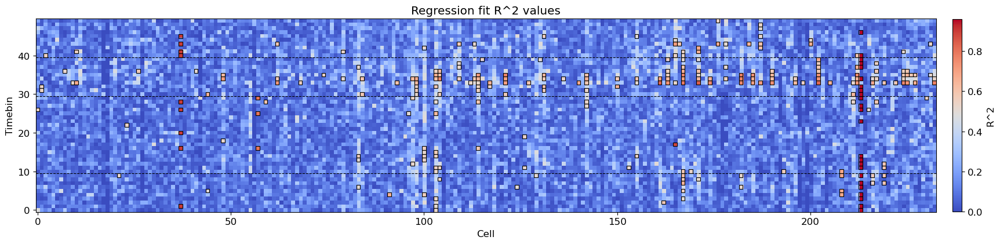

In [412]:
rsquared_threshold = 0.5
# rsquared_good_cells = np.unique(np.where(linear_multivar_glm_rsquared_v4 > rsquared_threshold)[0])
rsquared_good_samples = np.array(np.where(linear_multivar_glm_rsquared_v4 > rsquared_threshold)).T

fig, ax = plt.subplots(figsize=(24, 6))
plt.title('Regression fit R^2 values')

im = ax.imshow(linear_multivar_glm_rsquared_v4.T, cmap='coolwarm', vmin=0, origin='lower')
plt.colorbar(im, ax=ax, label='R^2', shrink=0.72, pad=0.015)
ax.set_xlabel('Cell')
ax.set_ylabel('Timebin')

# for c in rsquared_good_cells:
#     ax.add_patch(Rectangle((c-0.5, -0.5), 1, num_timebins_ext, linewidth=0.8, linestyle='--', edgecolor='k', facecolor='none'))
for i, j in rsquared_good_samples:
    ax.add_patch(Rectangle((i-0.5, j-0.5), 1, 1, linewidth=0.8, linestyle='-', edgecolor='k', facecolor='none'))
ax.axhline(y=9.5, linewidth=0.8, linestyle='--', color='k')
ax.axhline(y=29.5, linewidth=0.8, linestyle='--', color='k')
ax.axhline(y=39.5, linewidth=0.8, linestyle='--', color='k')

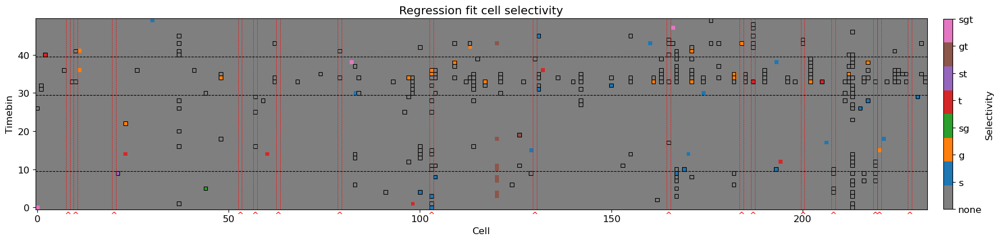

In [413]:
fig, ax = plt.subplots(figsize=(24, 6))
plt.title('Regression fit cell selectivity')

custom_cmap = ListedColormap(['tab:grey', 'tab:blue', 'tab:orange', 'tab:green', 'tab:red', 'tab:purple', 'tab:brown', 'tab:pink'])
im = ax.imshow(cell_selectivity.T, cmap=custom_cmap, origin='lower')
cbar = plt.colorbar(im, ax=ax, label='Selectivity', shrink=0.72, pad=0.015)
cbar.set_ticks(np.arange(8), labels=selectivity_labels)
ax.set_xlabel('Cell')
ax.set_ylabel('Timebin')

# for c in rsquared_good_cells:
#     ax.add_patch(Rectangle((c-0.5, -0.5), 1, num_timebins_ext, linewidth=0.8, linestyle='--', edgecolor='k', facecolor='none'))
for i, j in rsquared_good_samples:
    ax.add_patch(Rectangle((i-0.5, j-0.5), 1, 1, linewidth=0.8, linestyle='-', edgecolor='k', facecolor='none'))
ax.axhline(y=9.5, linewidth=0.8, linestyle='--', color='k')
ax.axhline(y=29.5, linewidth=0.8, linestyle='--', color='k')
ax.axhline(y=39.5, linewidth=0.8, linestyle='--', color='k')

# Add annotations for place and view cells
# for cell in place_cell_indexes:
#     ax.text(cell, -1, '^', fontsize=10, color='tab:red', ha='center', va='top')
# for cell in view_cell_indexes:
#     ax.text(cell, -1, '^', fontsize=10, color='tab:red', ha='center', va='top')
for cell in pv_cell_indexes:
    ax.add_patch(Rectangle((cell-0.5, -0.5), 1, num_timebins_ext, linewidth=0.5, linestyle='--', edgecolor='r', facecolor='none'))
    ax.text(cell, -1, '^', fontsize=10, color='r', ha='center', va='top')

In [414]:
# Plot regression fit against data points for each cell and timebin
for cell in range(num_all_cells):
    frame = 0
    # def regression_eqn(s, g, frame):
    #     # s and g are 1-indexed start and goal respectively
    #     params = linear_glm_multivar_models_v3[cell][frame].params
    #     if s == g:
    #         t = (trajectory_indexing.get((s-1, g), 0) + trajectory_indexing.get((s+1, g), 29)) / (2 * 29)
    #     else:
    #         t = trajectory_indexing[(s, g)] / 29
    #     s = (s - 1) / 5
    #     g = (g - 1) / 5
    #     return params[0] + params[1] * s + params[2] * g + params[3] * t
    def regression_eqn(s, g, frame):
        # s and g are 1-indexed start and goal respectively
        params = linear_glm_multivar_models_v4[cell][frame].params
        s = s / 6
        g = g / 6
        return params[0] + params[1] * s + params[2] * g + params[3] * s * g

    fig = plt.figure(figsize=(16, 12))
    ax = fig.add_subplot(1, 1, 1, projection='3d')
    ax.set_title(f'Regression fit for cell {all_cell_labels[cell]} | t = {0.1 * frame - 3:.1f}s', x=0.52, y=0.94)

    x_axis, y_axis = np.meshgrid(np.linspace(1, 6, 6), np.linspace(1, 6, 6))
    model_pred = np.zeros((num_goals, num_goals, num_timebins_ext))
    for t in range(num_timebins_ext):
        for i in range(num_goals):
            for j in range(num_goals):
                model_pred[i,j,t] = regression_eqn(x_axis[i,j], y_axis[i,j], t)
    surf = ax.plot_surface(x_axis, y_axis, model_pred[:,:,frame], alpha=0.8, color='tab:blue')

    start_order = {val: idx for idx, val in enumerate(cell_ordered_labels[cell,:,0], start=1)}
    goal_order = {val: idx for idx, val in enumerate(cell_ordered_labels[cell,:,1], start=1)}
    combined_trajectories_iti_cue_trialavg_ordered = np.array([[start_order[s], goal_order[g]] for (s, g) in combined_trajectories_iti_cue_trialavg])
    sc = ax.scatter(combined_trajectories_iti_cue_trialavg_ordered[:,0], combined_trajectories_iti_cue_trialavg_ordered[:,1], combined_spikerates_iti_cue_trialavg_zscored[:,frame,cell], color='C3')

    ax.view_init(elev=15, azim=-55)
    ax.set_xlabel('Start')
    ax.set_ylabel('Goal')
    ax.set_zlabel('z-scored FR')
    ax.set_xticks(np.arange(1, num_goals+1), labels=cell_ordered_labels[cell,:,0])
    ax.set_yticks(np.arange(1, num_goals+1), labels=cell_ordered_labels[cell,:,1])
    ax_lims = [min([np.round(np.percentile(combined_spikerates_iti_cue_trialavg_zscored[:,frame,cell].flatten(), 1), 1) for frame in range(num_timebins_ext)]),\
                max([np.round(np.percentile(combined_spikerates_iti_cue_trialavg_zscored[:,frame,cell].flatten(), 99), 1) for frame in range(num_timebins_ext)])]
    if ax_lims[0] < ax_lims[1]:
        ax_lims[0], ax_lims[1] = ax_lims[0] - 0.05 * (ax_lims[1] - ax_lims[0]), ax_lims[1] + 0.05 * (ax_lims[1] - ax_lims[0])
        ax.set_zlim(ax_lims)
    else:
        ax_lims = ax.get_zlim()
    txt = ax.text(6, 6, 1.15*(ax_lims[1]-ax_lims[0])+ax_lims[0], f'sel: {selectivity_labels[cell_selectivity[cell,frame]]}\nr_sq: {linear_multivar_glm_rsquared_v4[cell,frame]:.3f}')

    def update(frame):
        sc._offsets3d = (combined_trajectories_iti_cue_trialavg_ordered[:,0], combined_trajectories_iti_cue_trialavg_ordered[:,1], combined_spikerates_iti_cue_trialavg_zscored[:,frame,cell])
        global surf
        surf.remove()
        surf = ax.plot_surface(x_axis, y_axis, model_pred[:,:,frame], alpha=0.8, color='tab:blue')
        ax.set_title(f'Regression fit for cell {all_cell_labels[cell]} | t = {0.1 * frame - 3:.1f}s', x=0.5, y=0.94)
        txt.set_text(f'sel: {selectivity_labels[cell_selectivity[cell,frame]]}\nr_sq: {linear_multivar_glm_rsquared_v4[cell,frame]:.3f}')

    ani = FuncAnimation(fig, update, frames=num_timebins_ext, interval=1000, blit=False, repeat=True)
    HTML(ani.to_html5_video())

    if to_save:
        if not os.path.exists(figsave_dir):
            os.makedirs(figsave_dir)
        ani.save(f'{figsave_dir}/mlr_fits/trialavg/mlr_fit_{all_cell_labels[cell]}.mp4', writer='ffmpeg')
    plt.close()

Single cell level multivariate poisson regression

In [54]:
def design_matrix(traj):
    # traj is num_trials x 2 array of (start, goal), start & goal are 1-indexed
    s, g = traj[:,0] / 6, traj[:,1] / 6
    dm = np.ones((traj.shape[0], 3))
    dm[:,0] = s
    dm[:,1] = g
    dm[:,2] = s * g
    return dm

# Order starts/goals for each cell according to firing rate preference
def ordered_labels(rates, trajs):
    # rates: trials x timebins shaped array of firing rates
    # trajs: trials x (start, goal) array of trajectory labels
    # keep start & goal 1-indexed
    rates_by_starts, rates_by_goals = {i+1: list() for i in range(num_goals)}, {i+1: list() for i in range(num_goals)}
    for i, (s, g) in enumerate(trajs):
        rates_by_starts[s].append(rates[i])
        rates_by_goals[g].append(rates[i])
    for key, value in rates_by_starts.items():
        rates_by_starts[key] = np.max(np.mean(np.stack(value), axis=0))
    rates_by_starts = np.array(list(rates_by_starts.values()))
    for key, value in rates_by_goals.items():
        rates_by_goals[key] = np.max(np.mean(np.stack(value), axis=0))
    rates_by_goals = np.array(list(rates_by_goals.values()))
    # return tuple of (ordered start labels, ordered goal labels)
    return np.argsort(rates_by_starts)+1, np.argsort(rates_by_goals)+1

In [55]:
# Normalize (z-score) firing rates within each cell, and offset by min value in each cell to ensure non-negativity
combined_spikerates_iti_cue_zscored_offset = combined_spikerates_iti_cue_zscored - np.min(np.min(combined_spikerates_iti_cue_zscored, axis=0), axis=0)

In [56]:
# Fit multivar poisson model to all data
very_small_num = 1e-9
# Array of start/goal label orderings for all cells, last axis indexing: (0) start, (1) goal
cell_ordered_labels = np.empty((num_all_cells, num_goals, 2), dtype=int)
# Dimensions for list: cells x timebins
poisson_glm_multivar_models = list()
poisson_glm_cells = list()
for cell in range(num_all_cells):
    # Re-ordering start and goal labels
    # start_order, goal_order = ordered_labels(combined_spikerates_iti_cue[:,:,cell], combined_trajectories_iti_cue)
    start_order, goal_order = ordered_labels(combined_spikerates_iti_cue_zscored_offset[:,:,cell], combined_trajectories_iti_cue)
    cell_ordered_labels[cell,:,0] = start_order
    cell_ordered_labels[cell,:,1] = goal_order
    start_order = {val: idx for idx, val in enumerate(start_order, start=1)}
    goal_order = {val: idx for idx, val in enumerate(goal_order, start=1)}
    combined_trajectories_iti_cue_ordered = np.array([[start_order[s], goal_order[g]] for (s, g) in combined_trajectories_iti_cue])
    # Generate design matrix and fit models for all timebins for this cell
    dm_cell = design_matrix(combined_trajectories_iti_cue_ordered)
    cell_models = list()
    try:
        for timebin in range(num_timebins_ext):
            # timebin_model = sm.GLM(combined_spikerates_iti_cue[:,timebin,cell]+very_small_num, dm_cell, family=sm.families.Poisson()).fit()
            timebin_model = sm.GLM(combined_spikerates_iti_cue_zscored_offset[:,timebin,cell]+very_small_num, dm_cell, family=sm.families.Poisson()).fit()
            cell_models.append(timebin_model)
        poisson_glm_multivar_models.append(cell_models)
        poisson_glm_cells.append(all_cell_labels[cell])
    except ValueError:
        continue
num_poisson_cells = len(poisson_glm_cells)

/Users/jcheng/miniconda3/envs/decoding/lib/python3.10/site-packages/statsmodels/genmod/families/links.py:516: RuntimeWarning: overflow encountered in exp
  return np.exp(z)
/Users/jcheng/miniconda3/envs/decoding/lib/python3.10/site-packages/statsmodels/genmod/families/family.py:426: RuntimeWarning: divide by zero encountered in true_divide
  endog_mu = self._clean(endog / mu)
/Users/jcheng/miniconda3/envs/decoding/lib/python3.10/site-packages/statsmodels/genmod/families/family.py:132: RuntimeWarning: invalid value encountered in multiply
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
/Users/jcheng/miniconda3/envs/decoding/lib/python3.10/site-packages/statsmodels/genmod/families/family.py:132: RuntimeWarning: divide by zero encountered in true_divide
  return 1. / (self.link.deriv(mu)**2 * self.variance(mu))
/Users/jcheng/miniconda3/envs/decoding/lib/python3.10/site-packages/statsmodels/genmod/generalized_linear_model.py:1211: RuntimeWarning: invalid value encountered in mul

In [60]:
num_poisson_cells

185

In [57]:
# Significance testing for fitted coefficients for all cells, all timebins
poisson_multivar_glm_param_sigtest = np.array([[model.pvalues for model in cell] for cell in poisson_glm_multivar_models])
poisson_multivar_glm_param_sigtest = poisson_multivar_glm_param_sigtest < sig_lvl / num_timebins_ext

# Pseudo r-squared values for model fits for all cells, all timebins
poisson_multivar_glm_prsquared = np.array([[model.pseudo_rsquared() for model in cell] for cell in poisson_glm_multivar_models])
poisson_multivar_glm_prsquared = np.nan_to_num(poisson_multivar_glm_prsquared)

# Selectivity (by parameter test) for each cell across all timebins
def selectivity_type(arr):
    return arr[0] + arr[1] * 2 + arr[2] * 4
cell_selectivity = np.array([[selectivity_type(timebin) for timebin in cell] for cell in poisson_multivar_glm_param_sigtest])
selectivity_labels = ['none', 's', 'g', 'sg', 't', 'st', 'gt', 'sgt']

/Users/jcheng/miniconda3/envs/decoding/lib/python3.10/site-packages/statsmodels/genmod/generalized_linear_model.py:1767: RuntimeWarning: overflow encountered in exp
  prsq = 1 - np.exp((self.llnull - self.llf) * (2 / self.nobs))


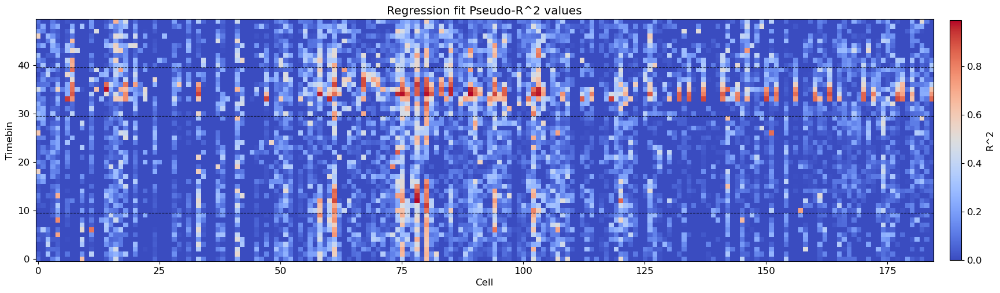

In [58]:
fig, ax = plt.subplots(figsize=(24, 6))
plt.title('Regression fit Pseudo-R^2 values')

im = ax.imshow(poisson_multivar_glm_prsquared.T, cmap='coolwarm', vmin=0, origin='lower')
plt.colorbar(im, ax=ax, label='Pseudo-R^2', shrink=0.9, pad=0.015)
ax.set_xlabel('Cell')
ax.set_ylabel('Timebin')

ax.axhline(y=9.5, linewidth=0.8, linestyle='--', color='k')
ax.axhline(y=29.5, linewidth=0.8, linestyle='--', color='k')
ax.axhline(y=39.5, linewidth=0.8, linestyle='--', color='k')

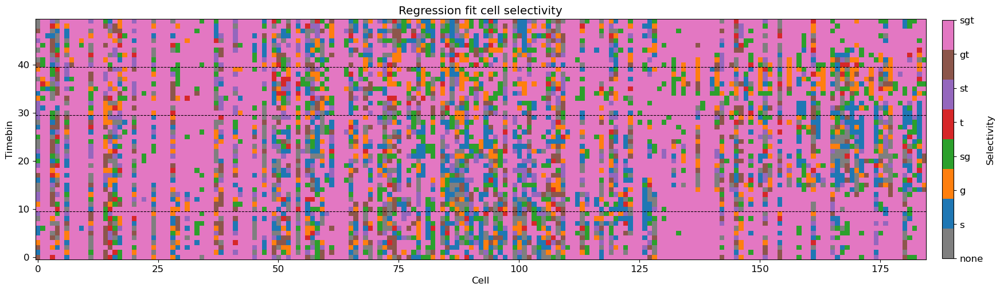

In [59]:
fig, ax = plt.subplots(figsize=(24, 6))
plt.title('Regression fit cell selectivity')

custom_cmap = ListedColormap(['tab:grey', 'tab:blue', 'tab:orange', 'tab:green', 'tab:red', 'tab:purple', 'tab:brown', 'tab:pink'])
im = ax.imshow(cell_selectivity.T, cmap=custom_cmap, origin='lower')
cbar = plt.colorbar(im, ax=ax, label='Selectivity', shrink=0.9, pad=0.015)
cbar.set_ticks(np.arange(8), labels=selectivity_labels)
ax.set_xlabel('Cell')
ax.set_ylabel('Timebin')

ax.axhline(y=9.5, linewidth=0.8, linestyle='--', color='k')
ax.axhline(y=29.5, linewidth=0.8, linestyle='--', color='k')
ax.axhline(y=39.5, linewidth=0.8, linestyle='--', color='k')

Marginal distributions

In [422]:
# Plot regression fit condensed across all goals (plotting starts against FR)
for cell in range(num_poisson_cells):
    def regression_eqn(s, g, frame):
        # s and g are 1-indexed start and goal respectively
        params = poisson_glm_multivar_models[cell][frame].params
        s = s / 6
        g = g / 6
        return np.exp(params[0] * s + params[1] * g + params[2] * s * g)

    fig = plt.figure(figsize=(8, 6))
    ax = plt.gca()
    ax.set_title(f'Regression fit for cell {poisson_glm_cells[cell]} | t = {-3:.1f}s')

    # Marginal distribution across goals (x-axis is start)
    sc = ax.scatter(combined_trajectories_iti_cue_ordered[:,0], combined_spikerates_iti_cue_zscored_offset[:,0,cell], color='C3')
    lines = list()
    x_axis, y_axis = np.meshgrid(np.linspace(1, 6, 6), np.linspace(1, 6, 6))
    model_pred = np.zeros((num_goals, num_goals, num_timebins_ext))
    for t in range(num_timebins_ext):
        for i in range(num_goals):
            for j in range(num_goals):
                model_pred[i,j,t] = regression_eqn(x_axis[i,j], y_axis[i,j], t)
    for g in range(num_goals):
        lines.extend(ax.plot(np.arange(1, num_goals+1), model_pred[:,g,0], color='C0', alpha=0.5))

    ax.set_xlabel('Start')
    ax.set_ylabel('non-neg z-scored FR')
    ax.set_xticks(np.arange(1, num_goals+1), labels=cell_ordered_labels[cell,:,0])
    ax_lims = [min(min([np.round(np.percentile(combined_spikerates_iti_cue_zscored_offset[:,frame,cell].flatten(), 0), 1) for frame in range(num_timebins_ext)]),\
                min([np.round(np.min(model_pred[:,:,frame].flatten()), 1) for frame in range(num_timebins_ext)])),\
                max(max([np.round(np.percentile(combined_spikerates_iti_cue_zscored_offset[:,frame,cell].flatten(), 100), 1) for frame in range(num_timebins_ext)]),\
                max([np.round(np.max(model_pred[:,:,frame].flatten()), 1) for frame in range(num_timebins_ext)]))]
    if ax_lims[0] < ax_lims[1]:
        ax_lims[0], ax_lims[1] = ax_lims[0] - 0.05 * (ax_lims[1] - ax_lims[0]), ax_lims[1] + 0.05 * (ax_lims[1] - ax_lims[0])
        ax.set_ylim(ax_lims)
    else:
        ax_lims = ax.get_ylim()
    txt = ax.text(0.85, -0.13, f'sel: {selectivity_labels[cell_selectivity[cell,0]]}\npr_sq: {poisson_multivar_glm_prsquared[cell,0]:.3f}', transform=ax.transAxes)

    def update(frame):
        sc.set_offsets(np.column_stack([combined_trajectories_iti_cue_ordered[:,0], combined_spikerates_iti_cue_zscored_offset[:,frame,cell]]))
        for g in range(num_goals):
            lines[g].set_data(np.arange(1, num_goals+1), model_pred[:,g,frame])
        ax.set_title(f'Regression fit for cell {poisson_glm_cells[cell]} | t = {0.1 * frame - 3:.1f}s')
        txt.set_text(f'sel: {selectivity_labels[cell_selectivity[cell,frame]]}\npr_sq: {poisson_multivar_glm_prsquared[cell,frame]:.3f}')

    ani = FuncAnimation(fig, update, frames=num_timebins_ext, interval=1000, blit=False, repeat=True)
    HTML(ani.to_html5_video())

    if to_save:
        if not os.path.exists(figsave_dir):
            os.makedirs(figsave_dir)
        ani.save(f'{figsave_dir}/mpr_fits/start_marginal/mpr_fit_{poisson_glm_cells[cell]}.mp4', writer='ffmpeg')
    plt.close()

In [423]:
# Plot regression fit condensed across all starts (plotting goals against FR)
for cell in range(num_poisson_cells):
    def regression_eqn(s, g, frame):
        # s and g are 1-indexed start and goal respectively
        params = poisson_glm_multivar_models[cell][frame].params
        s = s / 6
        g = g / 6
        return np.exp(params[0] * s + params[1] * g + params[2] * s * g)

    fig = plt.figure(figsize=(8, 6))
    ax = plt.gca()
    ax.set_title(f'Regression fit for cell {poisson_glm_cells[cell]} | t = {-3:.1f}s')

    # Marginal distribution across starts (x-axis is goal)
    sc = ax.scatter(combined_trajectories_iti_cue_ordered[:,1], combined_spikerates_iti_cue_zscored_offset[:,0,cell], color='C3')
    lines = list()
    x_axis, y_axis = np.meshgrid(np.linspace(1, 6, 6), np.linspace(1, 6, 6))
    model_pred = np.zeros((num_goals, num_goals, num_timebins_ext))
    for t in range(num_timebins_ext):
        for i in range(num_goals):
            for j in range(num_goals):
                model_pred[i,j,t] = regression_eqn(x_axis[i,j], y_axis[i,j], t)
    for s in range(num_goals):
        lines.extend(ax.plot(np.arange(1, num_goals+1), model_pred[s,:,0], color='C0', alpha=0.5))

    ax.set_xlabel('Goal')
    ax.set_ylabel('non-neg z-scored FR')
    ax.set_xticks(np.arange(1, num_goals+1), labels=cell_ordered_labels[cell,:,1])
    ax_lims = [min(min([np.round(np.percentile(combined_spikerates_iti_cue_zscored_offset[:,frame,cell].flatten(), 0), 1) for frame in range(num_timebins_ext)]),\
                min([np.round(np.min(model_pred[:,:,frame].flatten()), 1) for frame in range(num_timebins_ext)])),\
                max(max([np.round(np.percentile(combined_spikerates_iti_cue_zscored_offset[:,frame,cell].flatten(), 100), 1) for frame in range(num_timebins_ext)]),\
                max([np.round(np.max(model_pred[:,:,frame].flatten()), 1) for frame in range(num_timebins_ext)]))]
    if ax_lims[0] < ax_lims[1]:
        ax_lims[0], ax_lims[1] = ax_lims[0] - 0.05 * (ax_lims[1] - ax_lims[0]), ax_lims[1] + 0.05 * (ax_lims[1] - ax_lims[0])
        ax.set_ylim(ax_lims)
    else:
        ax_lims = ax.get_ylim()
    txt = ax.text(0.85, -0.13, f'sel: {selectivity_labels[cell_selectivity[cell,0]]}\npr_sq: {poisson_multivar_glm_prsquared[cell,0]:.3f}', transform=ax.transAxes)

    def update(frame):
        sc.set_offsets(np.column_stack([combined_trajectories_iti_cue_ordered[:,1], combined_spikerates_iti_cue_zscored_offset[:,frame,cell]]))
        for s in range(num_goals):
            lines[s].set_data(np.arange(1, num_goals+1), model_pred[s,:,frame])
        ax.set_title(f'Regression fit for cell {poisson_glm_cells[cell]} | t = {0.1 * frame - 3:.1f}s')
        txt.set_text(f'sel: {selectivity_labels[cell_selectivity[cell,frame]]}\npr_sq: {poisson_multivar_glm_prsquared[cell,frame]:.3f}')

    ani = FuncAnimation(fig, update, frames=num_timebins_ext, interval=1000, blit=False, repeat=True)
    HTML(ani.to_html5_video())

    if to_save:
        if not os.path.exists(figsave_dir):
            os.makedirs(figsave_dir)
        ani.save(f'{figsave_dir}/mpr_fits/goal_marginal/mpr_fit_{poisson_glm_cells[cell]}.mp4', writer='ffmpeg')
    plt.close()

Full 3D space

In [419]:
# Plot regression fit against data points for each cell and timebin
for cell in range(num_poisson_cells):
    frame = 0
    # def regression_eqn(s, g, frame):
    #     # s and g are 1-indexed start and goal respectively
    #     params = linear_glm_multivar_models_v3[cell][frame].params
    #     if s == g:
    #         t = (trajectory_indexing.get((s-1, g), 0) + trajectory_indexing.get((s+1, g), 29)) / (2 * 29)
    #     else:
    #         t = trajectory_indexing[(s, g)] / 29
    #     s = (s - 1) / 5
    #     g = (g - 1) / 5
    #     return params[0] + params[1] * s + params[2] * g + params[3] * t
    def regression_eqn(s, g, frame):
        # s and g are 1-indexed start and goal respectively
        params = poisson_glm_multivar_models[cell][frame].params
        s = s / 6
        g = g / 6
        return np.exp(params[0] * s + params[1] * g + params[2] * s * g)

    fig = plt.figure(figsize=(16, 12))
    ax = fig.add_subplot(1, 1, 1, projection='3d')
    ax.set_title(f'Regression fit for cell {poisson_glm_cells[cell]} | t = {0.1 * frame - 3:.1f}s', x=0.52, y=0.94)

    x_axis, y_axis = np.meshgrid(np.linspace(1, 6, 6), np.linspace(1, 6, 6))
    model_pred = np.zeros((num_goals, num_goals, num_timebins_ext))
    for t in range(num_timebins_ext):
        for i in range(num_goals):
            for j in range(num_goals):
                model_pred[i,j,t] = regression_eqn(x_axis[i,j], y_axis[i,j], t)
    surf = ax.plot_surface(x_axis, y_axis, model_pred[:,:,frame], alpha=0.8, color='tab:blue')

    start_order = {val: idx for idx, val in enumerate(cell_ordered_labels[cell,:,0], start=1)}
    goal_order = {val: idx for idx, val in enumerate(cell_ordered_labels[cell,:,1], start=1)}
    combined_trajectories_iti_cue_ordered = np.array([[start_order[s], goal_order[g]] for (s, g) in combined_trajectories_iti_cue])
    sc = ax.scatter(combined_trajectories_iti_cue_ordered[:,0], combined_trajectories_iti_cue_ordered[:,1], combined_spikerates_iti_cue_zscored_offset[:,frame,cell], color='C3')

    ax.view_init(elev=15, azim=-55)
    ax.set_xlabel('Start')
    ax.set_ylabel('Goal')
    # ax.set_zlabel('Firing rate (Hz)')
    ax.set_zlabel('non-neg z-scored FR')
    ax.set_xticks(np.arange(1, num_goals+1), labels=cell_ordered_labels[cell,:,0])
    ax.set_yticks(np.arange(1, num_goals+1), labels=cell_ordered_labels[cell,:,1])
    ax_lims = [min(min([np.round(np.percentile(combined_spikerates_iti_cue_zscored_offset[:,frame,cell].flatten(), 0), 1) for frame in range(num_timebins_ext)]),\
                min([np.round(np.min(model_pred[:,:,frame].flatten()), 1) for frame in range(num_timebins_ext)])),\
                max(max([np.round(np.percentile(combined_spikerates_iti_cue_zscored_offset[:,frame,cell].flatten(), 100), 1) for frame in range(num_timebins_ext)]),\
                max([np.round(np.max(model_pred[:,:,frame].flatten()), 1) for frame in range(num_timebins_ext)]))]
    if ax_lims[0] < ax_lims[1]:
        ax_lims[0], ax_lims[1] = ax_lims[0] - 0.05 * (ax_lims[1] - ax_lims[0]), ax_lims[1] + 0.05 * (ax_lims[1] - ax_lims[0])
        ax.set_zlim(ax_lims)
    else:
        ax_lims = ax.get_zlim()
    txt = ax.text(6, 6, 1.15*(ax_lims[1]-ax_lims[0])+ax_lims[0], f'sel: {selectivity_labels[cell_selectivity[cell,frame]]}\npr_sq: {poisson_multivar_glm_prsquared[cell,frame]:.3f}')

    def update(frame):
        sc._offsets3d = (combined_trajectories_iti_cue_ordered[:,0], combined_trajectories_iti_cue_ordered[:,1], combined_spikerates_iti_cue_zscored_offset[:,frame,cell])
        global surf
        surf.remove()
        surf = ax.plot_surface(x_axis, y_axis, model_pred[:,:,frame], alpha=0.8, color='tab:blue')
        ax.set_title(f'Regression fit for cell {poisson_glm_cells[cell]} | t = {0.1 * frame - 3:.1f}s', x=0.5, y=0.94)
        txt.set_text(f'sel: {selectivity_labels[cell_selectivity[cell,frame]]}\npr_sq: {poisson_multivar_glm_prsquared[cell,frame]:.3f}')

    ani = FuncAnimation(fig, update, frames=num_timebins_ext, interval=1000, blit=False, repeat=True)
    HTML(ani.to_html5_video())

    if to_save:
        if not os.path.exists(figsave_dir):
            os.makedirs(figsave_dir)
        ani.save(f'{figsave_dir}/mpr_fits/mpr_fit_{poisson_glm_cells[cell]}.mp4', writer='ffmpeg')
    plt.close()

Single cell level multivariate logistic regression

In [355]:
def design_matrix(traj):
    # traj is num_trials x 2 array of (start, goal), start & goal are 1-indexed
    s, g = traj[:,0] / 6, traj[:,1] / 6
    dm = np.ones((traj.shape[0], 3))
    dm[:,0] = s
    dm[:,1] = g
    dm[:,2] = s * g
    return dm

# Order starts/goals for each cell according to firing rate preference
def ordered_labels(rates, trajs):
    # rates: trials x timebins shaped array of firing rates
    # trajs: trials x (start, goal) array of trajectory labels
    # keep start & goal 1-indexed
    rates_by_starts, rates_by_goals = {i+1: list() for i in range(num_goals)}, {i+1: list() for i in range(num_goals)}
    for i, (s, g) in enumerate(trajs):
        rates_by_starts[s].append(rates[i])
        rates_by_goals[g].append(rates[i])
    for key, value in rates_by_starts.items():
        rates_by_starts[key] = np.max(np.mean(np.stack(value), axis=0))
    rates_by_starts = np.array(list(rates_by_starts.values()))
    for key, value in rates_by_goals.items():
        rates_by_goals[key] = np.max(np.mean(np.stack(value), axis=0))
    rates_by_goals = np.array(list(rates_by_goals.values()))
    # return tuple of (ordered start labels, ordered goal labels)
    return np.argsort(rates_by_starts)+1, np.argsort(rates_by_goals)+1

In [352]:
# Min-max scale firing rates within each cell
combined_spikerates_iti_cue_minmax = (combined_spikerates_iti_cue - np.min(np.min(combined_spikerates_iti_cue, axis=0), axis=0)) /\
    (np.max(np.max(combined_spikerates_iti_cue, axis=0), axis=0) - np.min(np.min(combined_spikerates_iti_cue, axis=0), axis=0))

In [356]:
# Fit multivar logistic model to all data
# Array of start/goal label orderings for all cells, last axis indexing: (0) start, (1) goal
cell_ordered_labels = np.empty((num_all_cells, num_goals, 2), dtype=int)
# Dimensions for list: cells x timebins
logistic_glm_multivar_models = list()
logistic_glm_cells = list()
for cell in range(num_all_cells):
    # Re-ordering start and goal labels
    start_order, goal_order = ordered_labels(combined_spikerates_iti_cue_minmax[:,:,cell], combined_trajectories_iti_cue)
    cell_ordered_labels[cell,:,0] = start_order
    cell_ordered_labels[cell,:,1] = goal_order
    start_order = {val: idx for idx, val in enumerate(start_order, start=1)}
    goal_order = {val: idx for idx, val in enumerate(goal_order, start=1)}
    combined_trajectories_iti_cue_ordered = np.array([[start_order[s], goal_order[g]] for (s, g) in combined_trajectories_iti_cue])
    # Generate design matrix and fit models for all timebins for this cell
    dm_cell = design_matrix(combined_trajectories_iti_cue_ordered)
    cell_models = list()
    try:
        for timebin in range(num_timebins_ext):
            timebin_model = sm.GLM(combined_spikerates_iti_cue_minmax[:,timebin,cell], dm_cell, family=sm.families.Binomial()).fit()
            cell_models.append(timebin_model)
        logistic_glm_multivar_models.append(cell_models)
        logistic_glm_cells.append(all_cell_labels[cell])
    except ValueError:
        continue
num_logistic_cells = len(logistic_glm_cells)

PerfectSeparationError: Perfect separation detected, results not available

In [ ]:
num_logistic_cells

#### Demixed PCA Response Trajectories

In [49]:
# Map start goal, end goal to array indexes
traj_to_idxs = dict()
for i in range(1, num_goals+1):
    k = 0
    for j in range(1, num_goals+1):
        if i == j:
            continue
        traj_to_idxs[(i, j)] = (i-1, k)
        k += 1

In [475]:
'''
# Get all trials and trial average population responses per start goal - end goal trajectory
# Formatted into an array of (k trials x n cells x st goal x ed goal x t time windows)
max_trials_per_traj = max(map(len, combined_spikerates_cue_per_traj.values()))
combined_spikerates_cue_per_traj_trials = np.zeros((max_trials_per_traj, num_all_cells, num_goals, num_goals-1, 10))
combined_spikerates_cue_per_traj_trialavg = np.zeros((num_all_cells, num_goals, num_goals-1, 10))

for traj, responses in combined_spikerates_cue_per_traj.items():
    st, ed = traj_to_idxs[traj]
    n_trials = len(combined_spikerates_cue_per_traj[traj])
    combined_spikerates_cue_per_traj_trials[:n_trials,:,st,ed,:] = np.stack(combined_spikerates_cue_per_traj[traj], axis=0).transpose((0,2,1))
    bootstrap_trials = np.random.randint(0, n_trials, max_trials_per_traj - n_trials)
    combined_spikerates_cue_per_traj_trials[n_trials:,:,st,ed,:] = combined_spikerates_cue_per_traj_trials[bootstrap_trials,:,st,ed,:]
    # combined_spikerates_cue_per_traj_trials[n_trials:,:,st,ed,:] = np.nan
    combined_spikerates_cue_per_traj_trialavg[:,st,ed,:] = np.mean(combined_spikerates_cue_per_traj_trials[:n_trials,:,st,ed,:])

# Fill same start - end goal entries with NaNs
# for i in range(num_goals):
#     combined_spikerates_cue_per_traj_trialavg[:,:,i,i] = np.nan
'''

# Get all trials and trial average population responses per goal
# Formatted into an array of (k trials x n cells x g goal x t time windows)
max_trials_per_traj = max(map(len, combined_spikerates_cue_per_traj.values()))
combined_spikerates_cue_per_traj_trials = np.zeros((max_trials_per_traj, num_all_cells, num_goals, 10))
combined_spikerates_cue_per_traj_trialavg = np.zeros((num_all_cells, num_goals, 10))

for traj, responses in combined_spikerates_cue_per_traj.items():
    g = traj[1] - 1
    n_trials = len(combined_spikerates_cue_per_traj[traj])
    combined_spikerates_cue_per_traj_trials[:n_trials,:,g,:] = np.stack(combined_spikerates_cue_per_traj[traj], axis=0).transpose((0,2,1))
    bootstrap_trials = np.random.randint(0, n_trials, max_trials_per_traj - n_trials)
    combined_spikerates_cue_per_traj_trials[n_trials:,:,g,:] = combined_spikerates_cue_per_traj_trials[bootstrap_trials,:,g,:]
    combined_spikerates_cue_per_traj_trialavg[:,g,:] = np.mean(combined_spikerates_cue_per_traj_trials[:n_trials,:,g,:])

In [476]:
dpca = dPCA.dPCA(labels='gt', n_components=3, regularizer='auto')
# dpca.n_trials = 10
dpca.protect = ['t']

combined_dpcspikerates_cue_per_traj = dpca.fit_transform(combined_spikerates_cue_per_traj_trialavg, combined_spikerates_cue_per_traj_trials)

You chose to determine the regularization parameter automatically. This can
                    take substantial time and grows linearly with the number of crossvalidation
                    folds. The latter can be set by changing self.n_trials (default = 3). Similarly,
                    use self.protect to set the list of axes that are not supposed to get to get shuffled
                    (e.g. upon splitting the data into test- and training, time-points should always
                    be drawn from the same trial, i.e. self.protect = ['t']). This can significantly
                    speed up the code.
Start optimizing regularization.
Starting trial  1 / 3
Starting trial  2 / 3
Starting trial  3 / 3
Optimized regularization, optimal lambda =  1.0541350399999994e-06
Regularization will be fixed; to compute the optimal                    parameter again on the next fit, please                    set opt_regularizer_flag to True.


In [358]:
combined_dpcspikerates_cue_per_traj['gt'].shape

(3, 6, 10)

In [ ]:
# dPCA plots for cue responses between different trajectories, mean of each group of points
fig = plt.figure(figsize=(18, 12))
plt.rcParams['font.size'] = 14
plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1, wspace=0.2, hspace=0.1)
plt.suptitle(f'Pseudopopulation response trajectories across cue phase - {popl_name}', fontsize=20, y=0.95)
colours = ['#ff3333', '#0033ff', '#1e8449', '#9333ff', '#ffac33', '#33e6e6']
# plot_data = combined_dpcspikerates_cue_per_traj['se']

for i in range(num_goals):
    ax = fig.add_subplot(3, 4, 2*i+1, projection='3d')
    ax.set_title(f'Starting at goal #{i+1}', fontsize=16, x=0.56, y=1.02)
    for j in range(num_goals):
        if j == i:
            continue
        # data = plot_data[:,i,j,:]
        # ix, jx = traj_to_idxs[(i+1, j+1)]
        # data = combined_dpcspikerates_cue_per_traj['et'][:,ix,jx,:]
        data = combined_dpcspikerates_cue_per_traj['g'][:,j,:]
        for k in range(data.shape[1]-1):
            ax.plot(data[0,k:k+2], data[1,k:k+2], data[2,k:k+2], linestyle='--', linewidth=1.5, color=colours[j])
        ax.scatter(data[0,0], data[1,0], data[2,0], marker='.', color=colours[j], s=100, label=j+1)
        ax.scatter(data[0,-1], data[1,-1], data[2,-1], marker='x', color=colours[j], s=50)
    ax.legend(loc=(-0.12, 0.5))

    ax = fig.add_subplot(3, 4, 2*i+2, projection='3d')
    ax.set_title(f'Ending at goal #{i+1}', fontsize=16, x=0.56, y=1.02)
    for j in range(num_goals):
        if j == i:
            continue
        # data = plot_data[:,j,i,:]
        # ix, jx = traj_to_idxs[(i+1, j+1)]
        # data = combined_dpcspikerates_cue_per_traj['st'][:,jx,ix,:]
        data = combined_dpcspikerates_cue_per_traj['g'][:,i,:]
        for k in range(data.shape[1]-1):
            ax.plot(data[0,k:k+2], data[1,k:k+2], data[2,k:k+2], linestyle='--', linewidth=1.5, color=colours[j])
        ax.scatter(data[0,0], data[1,0], data[2,0], marker='.', color=colours[j], s=100, label=j+1)
        ax.scatter(data[0,-1], data[1,-1], data[2,-1], marker='x', color=colours[j], s=50)
    ax.legend(loc=(-0.12, 0.5))

Inter-trial interval + Cue phase

In [50]:
# Get all trials and trial average population responses per goal
# Formatted into an array of (k trials x n cells x s start x g goal x t time windows)
# Note: 6 start positions, 5 goal positions (excludes the same goal position as start position)
max_trials_per_traj = max(map(len, combined_spikerates_iti_cue_per_traj.values()))
combined_spikerates_iti_cue_per_traj_trials = np.zeros((max_trials_per_traj, num_all_cells, num_goals, num_goals-1, num_timebins_ext))
combined_spikerates_iti_cue_per_traj_trialavg = np.zeros((num_all_cells, num_goals, num_goals-1, num_timebins_ext))

for traj, responses in combined_spikerates_iti_cue_per_traj.items():
    s = traj[0] - 1
    g = traj[1] - 1
    if g > s:
        g -= 1
    n_trials = len(combined_spikerates_iti_cue_per_traj[traj])
    combined_spikerates_iti_cue_per_traj_trials[:n_trials,:,s,g,:] = np.stack(combined_spikerates_iti_cue_per_traj[traj], axis=0).transpose((0,2,1))
    np.random.seed(0)
    bootstrap_trials = np.random.randint(0, n_trials, max_trials_per_traj - n_trials)
    combined_spikerates_iti_cue_per_traj_trials[n_trials:,:,s,g,:] = combined_spikerates_iti_cue_per_traj_trials[bootstrap_trials,:,s,g,:]
    combined_spikerates_iti_cue_per_traj_trialavg[:,s,g,:] = np.mean(combined_spikerates_iti_cue_per_traj_trials[:n_trials,:,s,g,:], axis=0)

In [99]:
dpca = dPCA.dPCA(labels='sgt', regularizer='auto')
# dpca.n_trials = 5
dpca.protect = ['t']

combined_dpcspikerates_iti_cue_per_traj = dpca.fit_transform(combined_spikerates_iti_cue_per_traj_trialavg, combined_spikerates_iti_cue_per_traj_trials)

You chose to determine the regularization parameter automatically. This can
                    take substantial time and grows linearly with the number of crossvalidation
                    folds. The latter can be set by changing self.n_trials (default = 3). Similarly,
                    use self.protect to set the list of axes that are not supposed to get to get shuffled
                    (e.g. upon splitting the data into test- and training, time-points should always
                    be drawn from the same trial, i.e. self.protect = ['t']). This can significantly
                    speed up the code.
Start optimizing regularization.
Starting trial  1 / 3


Starting trial  2 / 3
Starting trial  3 / 3
Optimized regularization, optimal lambda =  8.366825542528468e-05
Regularization will be fixed; to compute the optimal                    parameter again on the next fit, please                    set opt_regularizer_flag to True.


In [51]:
combined_dpcspikerates_iti_cue_per_traj = dict()
dpca = dPCA.dPCA(labels='sg', regularizer='auto')
# dpca.n_trials = 5
dpca.protect = []

for timebin in range(num_timebins_ext):
    timebin_dpcs = dpca.fit_transform(combined_spikerates_iti_cue_per_traj_trialavg[:,:,:,timebin], combined_spikerates_iti_cue_per_traj_trials[:,:,:,:,timebin])
    for key, arr in timebin_dpcs.items():
        if key not in combined_dpcspikerates_iti_cue_per_traj:
            combined_dpcspikerates_iti_cue_per_traj[key] = [arr]
        else:
            combined_dpcspikerates_iti_cue_per_traj[key].append(arr)
    
for key, arr in combined_dpcspikerates_iti_cue_per_traj.items():
    combined_dpcspikerates_iti_cue_per_traj[key] = np.stack(arr, axis=-1)

You chose to determine the regularization parameter automatically. This can
                    take substantial time and grows linearly with the number of crossvalidation
                    folds. The latter can be set by changing self.n_trials (default = 3). Similarly,
                    use self.protect to set the list of axes that are not supposed to get to get shuffled
                    (e.g. upon splitting the data into test- and training, time-points should always
                    be drawn from the same trial, i.e. self.protect = ['t']). This can significantly
                    speed up the code.
Start optimizing regularization.
Starting trial  1 / 3
Starting trial  2 / 3
Starting trial  3 / 3
Optimized regularization, optimal lambda =  0.009297222253682942
Regularization will be fixed; to compute the optimal                    parameter again on the next fit, please                    set opt_regularizer_flag to True.


In [52]:
# Calculate separation between component 1 dPCs for each marginalization across time
combined_dpcspikerates_iti_cue_per_traj_vrc = {key: np.zeros(num_timebins_ext) for key in combined_dpcspikerates_iti_cue_per_traj.keys()}

# Make arrays of same shape as dpcspikerates with start and goal labels
combined_dpc_start_labels = np.zeros((num_goals, num_goals-1))
combined_dpc_goal_labels = np.zeros((num_goals, num_goals-1))
# combined_dpc_traj_labels = np.zeros((num_goals, num_goals-1))
for s in range(num_goals):
    for g in range(num_goals-1):
        if g >= s:
            gi = g + 1
        else:
            gi = g
        combined_dpc_start_labels[s,g] = s
        combined_dpc_goal_labels[s,g] = gi 
        # combined_dpc_traj_labels[s,g] = trajectory_indexing[(s+1, gi+1)]

scaler = MinMaxScaler()
for timebin in range(num_timebins_ext):
    # Start marginalization
    combined_dpcspikerates_iti_cue_per_traj_vrc['s'][timebin] = calinski_harabasz_score(combined_dpcspikerates_iti_cue_per_traj['s'][0,:,:,timebin].flatten().reshape(-1,1), combined_dpc_start_labels.flatten())
    # Goal marginalization
    combined_dpcspikerates_iti_cue_per_traj_vrc['g'][timebin] = calinski_harabasz_score(combined_dpcspikerates_iti_cue_per_traj['g'][0,:,:,timebin].flatten().reshape(-1,1), combined_dpc_goal_labels.flatten())
    # Start x Goal marginalization - calculate separation according to grouping by goal
    # combined_dpcspikerates_iti_cue_per_traj_vrc['sg'][timebin] = calinski_harabasz_score(combined_dpcspikerates_iti_cue_per_traj['sg'][0,:,:,timebin].flatten().reshape(-1,1), combined_dpc_goal_labels.flatten())

# combined_dpcspikerates_iti_cue_per_traj_vrc['s'] = scaler.fit_transform(combined_dpcspikerates_iti_cue_per_traj_vrc['s'].reshape(-1,1)).flatten()
# combined_dpcspikerates_iti_cue_per_traj_vrc['g'] = scaler.fit_transform(combined_dpcspikerates_iti_cue_per_traj_vrc['g'].reshape(-1,1)).flatten()
# combined_dpcspikerates_iti_cue_per_traj_vrc['sg'] = scaler.fit_transform(combined_dpcspikerates_iti_cue_per_traj_vrc['sg'].reshape(-1,1)).flatten()

In [53]:
# Row indices for arrays: (0)-(5) within cluster var for start/goal 1-6, (6) within cluster var (sum of rows 0 - 5), (7) between cluster var
dpc_cluster_var_start = np.empty((num_goals+2, num_timebins_ext))
dpc_cluster_var_goal = np.empty((num_goals+2, num_timebins_ext))
dpc_cluster_var_sg = np.zeros((2, num_timebins_ext))

for timebin in range(num_timebins_ext):
    # Group into clusters
    # Dimensions for each cluster: num_goals x data points per cluster
    start_clusters = combined_dpcspikerates_iti_cue_per_traj['s'][0,:,:,timebin]
    goal_clusters = [list() for _ in range(num_goals)]
    sg_clusters = combined_dpcspikerates_iti_cue_per_traj['sg'][0,:,:,timebin].flatten()
    for i, row in enumerate(combined_dpc_goal_labels):
        for j, g in enumerate(row):
            g = int(g)
            goal_clusters[g].append(combined_dpcspikerates_iti_cue_per_traj['g'][0,:,:,timebin][i,j])
    goal_clusters = np.array(goal_clusters)

    # Calculate cluster means and overall mean
    start_clusters_mean = np.mean(start_clusters, axis=1)
    start_overall_mean = np.mean(start_clusters_mean)
    goal_clusters_mean = np.mean(goal_clusters, axis=1)
    goal_overall_mean = np.mean(goal_clusters_mean)
    sg_overall_mean = np.mean(sg_clusters)

    # Calculate within and between cluster distances
    for goal in range(num_goals):
        dpc_cluster_var_start[goal,timebin] = np.dot(start_clusters[goal] - start_clusters_mean[goal], start_clusters[goal] - start_clusters_mean[goal])
        dpc_cluster_var_goal[goal,timebin] = np.dot(goal_clusters[goal] - goal_clusters_mean[goal], goal_clusters[goal] - goal_clusters_mean[goal])
    dpc_cluster_var_start[-2,timebin] = np.sum(dpc_cluster_var_start[:num_goals,timebin])
    dpc_cluster_var_goal[-2,timebin] = np.sum(dpc_cluster_var_goal[:num_goals,timebin])
    dpc_cluster_var_start[-1,timebin] = np.dot(start_clusters_mean - start_overall_mean, start_clusters_mean - start_overall_mean) * start_clusters.shape[1]
    dpc_cluster_var_goal[-1,timebin] = np.dot(goal_clusters_mean - goal_overall_mean, goal_clusters_mean - goal_overall_mean) * goal_clusters.shape[1]
    dpc_cluster_var_sg[-1,timebin] = np.dot(sg_clusters - sg_overall_mean, sg_clusters - sg_overall_mean)

    combined_dpcspikerates_iti_cue_per_traj_vrc['sg'][timebin] = dpc_cluster_var_sg[-1,timebin] / (len(trajectories) - 1)

# scaler = MinMaxScaler()
# dpc_cluster_var_goal = scaler.fit_transform(dpc_cluster_var_goal)
# dpc_cluster_var_start = scaler.fit_transform(dpc_cluster_var_start)
# dpc_cluster_var_sg = scaler.fit_transform(dpc_cluster_var_sg)

Text(0.5, 0, 'Time(s) from cue onset')

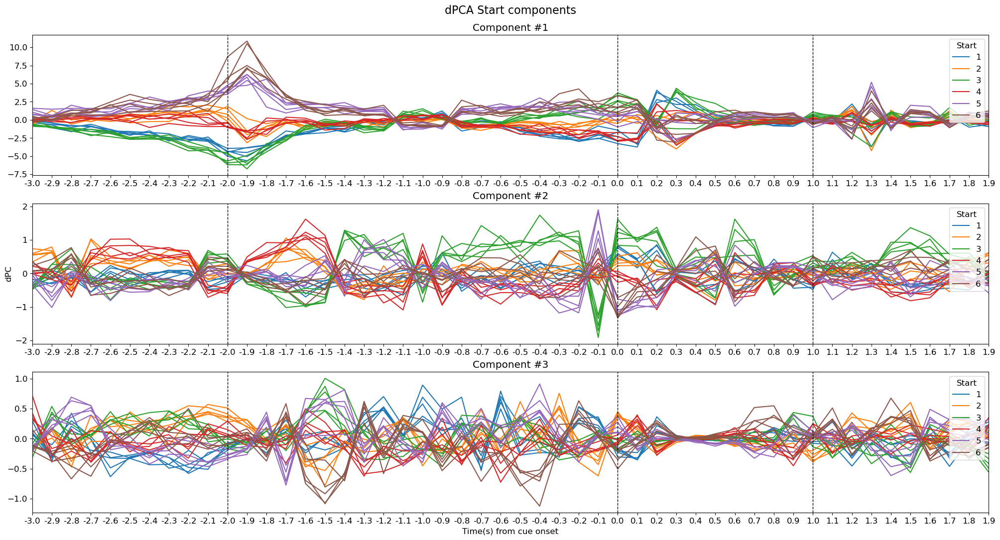

In [3095]:
fig, axes = plt.subplots(3, 1, figsize=(24, 12))
plt.subplots_adjust(0.1, 0.1, 0.9, 0.9, wspace=0.1, hspace=0.2)
plt.suptitle('dPCA Start components', y=0.95, fontsize=16)

for c in range(3):
    axes[c].set_title(f'Component #{c+1}')
    for s in range(num_goals):
        for g in range(num_goals-1):
            axes[c].plot(np.arange(num_timebins_ext), combined_dpcspikerates_iti_cue_per_traj['s'][c,s,g], color=f'C{s}', label=f'{s+1}')
    axes[c].axvline(x=10, color='k', linewidth=1, linestyle='--')
    axes[c].axvline(x=30, color='k', linewidth=1, linestyle='--')
    axes[c].axvline(x=40, color='k', linewidth=1, linestyle='--')
    axes[c].set_xlim([0, num_timebins_ext-1])
    axes[c].set_xticks(np.arange(num_timebins_ext), labels=[f'{n:.1f}' for n in np.arange(-3, 2, 0.1)])
    axes[c].legend([Line2D([0],[0], color=f'C{s}') for s in range(num_goals)], [f'{s+1}' for s in range(num_goals)], title='Start', loc='upper right')

axes[1].set_ylabel('dPC')
axes[-1].set_xlabel('Time(s) from cue onset')

In [193]:
np.sum(dpc_cluster_var_start[:num_goals,:], axis=0).shape

(50,)

Text(0.5, 0, 'Time(s) from cue onset')

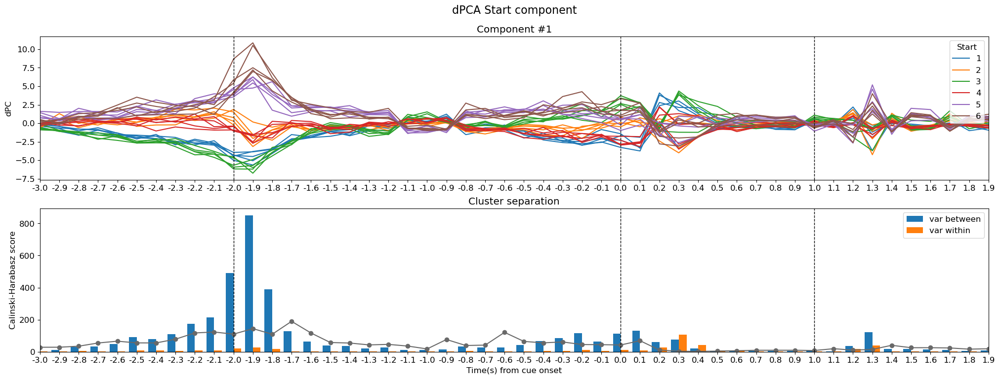

In [246]:
fig, axes = plt.subplots(2, 1, figsize=(24, 8))
plt.subplots_adjust(0.1, 0.1, 0.9, 0.9, wspace=0.1, hspace=0.2)
plt.suptitle('dPCA Start component', y=0.98, fontsize=16)

axes[0].set_title('Component #1')
for s in range(num_goals):
    for g in range(num_goals-1):
        axes[0].plot(np.arange(num_timebins_ext), combined_dpcspikerates_iti_cue_per_traj['s'][0,s,g], color=f'C{s}', label=f'{s+1}')
axes[0].axvline(x=10, color='k', linewidth=1, linestyle='--')
axes[0].axvline(x=30, color='k', linewidth=1, linestyle='--')
axes[0].axvline(x=40, color='k', linewidth=1, linestyle='--')
axes[0].set_xlim([0, num_timebins_ext-1])
axes[0].set_xticks(np.arange(num_timebins_ext), labels=[f'{n:.1f}' for n in np.arange(-3, 2, 0.1)])
axes[0].legend([Line2D([0],[0], color=f'C{s}') for s in range(num_goals)], [f'{s+1}' for s in range(num_goals)], title='Start', loc='upper right')

bar_width = 0.4
axes[1].set_title('Cluster separation')
axes[1].plot(np.arange(num_timebins_ext), combined_dpcspikerates_iti_cue_per_traj_vrc['s'], marker='o', color='dimgrey')
axes[1].bar(np.arange(num_timebins_ext)-bar_width/2, dpc_cluster_var_start[-1,:], width=bar_width, label='var between')
axes[1].bar(np.arange(num_timebins_ext)+bar_width/2, dpc_cluster_var_start[-2,:], width=bar_width, label='var within')
axes[1].axvline(x=10, color='k', linewidth=1, linestyle='--')
axes[1].axvline(x=30, color='k', linewidth=1, linestyle='--')
axes[1].axvline(x=40, color='k', linewidth=1, linestyle='--')
axes[1].set_xlim([0, num_timebins_ext-1])
axes[1].set_xticks(np.arange(num_timebins_ext), labels=[f'{n:.1f}' for n in np.arange(-3, 2, 0.1)])
axes[1].legend(loc='upper right')

axes[0].set_ylabel('dPC')
axes[1].set_ylabel('Calinski-Harabasz score')
axes[1].set_xlabel('Time(s) from cue onset')

Text(0.5, 0, 'Time(s) from cue onset')

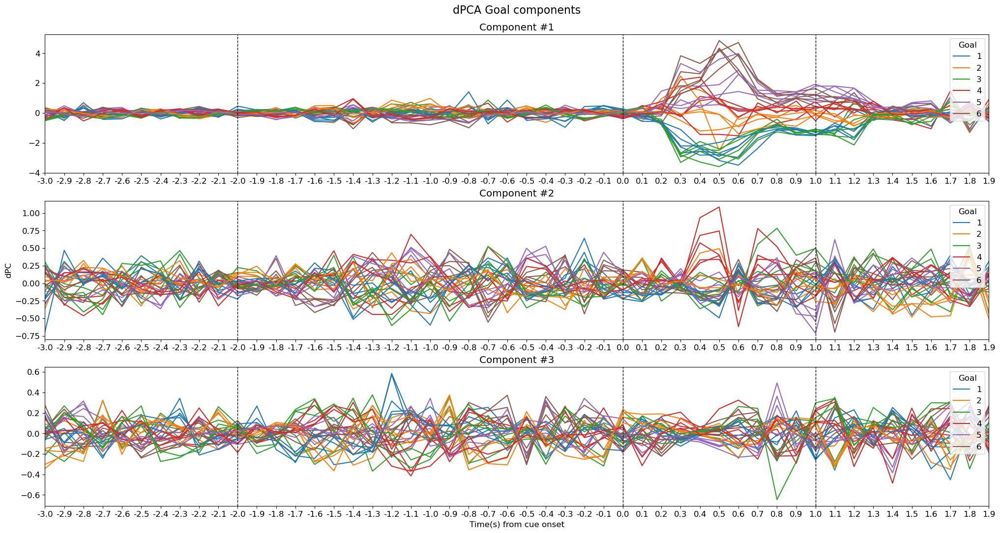

In [3094]:
fig, axes = plt.subplots(3, 1, figsize=(24, 12))
plt.subplots_adjust(0.1, 0.1, 0.9, 0.9, wspace=0.1, hspace=0.2)
plt.suptitle('dPCA Goal components', y=0.95, fontsize=16)

for c in range(3):
    axes[c].set_title(f'Component #{c+1}')
    for s in range(num_goals):
        for g in range(num_goals-1):
            if g >= s:
                gi = g + 1
            else:
                gi = g
            axes[c].plot(np.arange(num_timebins_ext), combined_dpcspikerates_iti_cue_per_traj['g'][c,s,g], color=f'C{gi}', label=f'{gi+1}')
    axes[c].axvline(x=10, color='k', linewidth=1, linestyle='--')
    axes[c].axvline(x=30, color='k', linewidth=1, linestyle='--')
    axes[c].axvline(x=40, color='k', linewidth=1, linestyle='--')
    axes[c].set_xlim([0, num_timebins_ext-1])
    axes[c].set_xticks(np.arange(num_timebins_ext), labels=[f'{n:.1f}' for n in np.arange(-3, 2, 0.1)])
    axes[c].legend([Line2D([0],[0], color=f'C{s}') for s in range(num_goals)], [f'{s+1}' for s in range(num_goals)], title='Goal', loc='upper right')

axes[1].set_ylabel('dPC')
axes[-1].set_xlabel('Time(s) from cue onset')

Text(0.5, 0, 'Time(s) from cue onset')

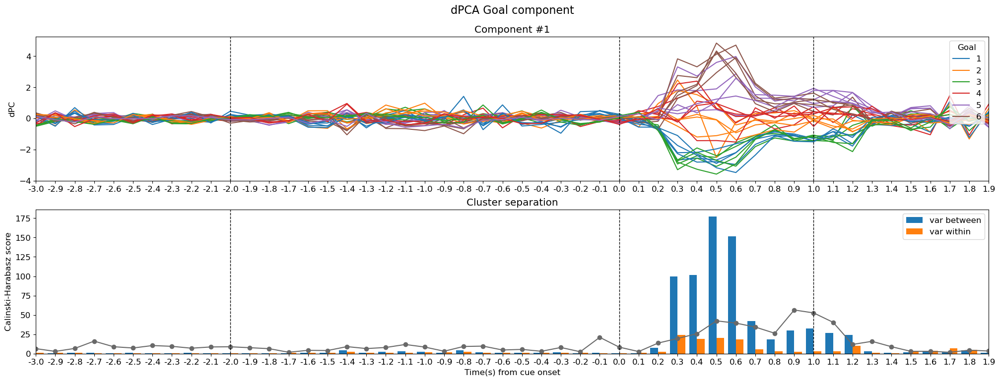

In [248]:
fig, axes = plt.subplots(2, 1, figsize=(24, 8))
plt.subplots_adjust(0.1, 0.1, 0.9, 0.9, wspace=0.1, hspace=0.2)
plt.suptitle('dPCA Goal component', y=0.98, fontsize=16)

axes[0].set_title('Component #1')
for s in range(num_goals):
    for g in range(num_goals-1):
        if g >= s:
            gi = g + 1
        else:
            gi = g
        axes[0].plot(np.arange(num_timebins_ext), combined_dpcspikerates_iti_cue_per_traj['g'][0,s,g], color=f'C{gi}', label=f'{gi+1}')
axes[0].axvline(x=10, color='k', linewidth=1, linestyle='--')
axes[0].axvline(x=30, color='k', linewidth=1, linestyle='--')
axes[0].axvline(x=40, color='k', linewidth=1, linestyle='--')
axes[0].set_xlim([0, num_timebins_ext-1])
axes[0].set_xticks(np.arange(num_timebins_ext), labels=[f'{n:.1f}' for n in np.arange(-3, 2, 0.1)])
axes[0].legend([Line2D([0],[0], color=f'C{s}') for s in range(num_goals)], [f'{s+1}' for s in range(num_goals)], title='Goal', loc='upper right')

bar_width = 0.4
axes[1].set_title('Cluster separation')
axes[1].plot(np.arange(num_timebins_ext), combined_dpcspikerates_iti_cue_per_traj_vrc['g'], marker='o', color='dimgrey')
axes[1].bar(np.arange(num_timebins_ext)-bar_width/2, dpc_cluster_var_goal[-1,:], width=bar_width, label='var between')
axes[1].bar(np.arange(num_timebins_ext)+bar_width/2, dpc_cluster_var_goal[-2,:], width=bar_width, label='var within')
axes[1].axvline(x=10, color='k', linewidth=1, linestyle='--')
axes[1].axvline(x=30, color='k', linewidth=1, linestyle='--')
axes[1].axvline(x=40, color='k', linewidth=1, linestyle='--')
axes[1].set_xlim([0, num_timebins_ext-1])
axes[1].set_xticks(np.arange(num_timebins_ext), labels=[f'{n:.1f}' for n in np.arange(-3, 2, 0.1)])
axes[1].legend(loc='upper right')

axes[0].set_ylabel('dPC')
axes[1].set_ylabel('Calinski-Harabasz score')
axes[1].set_xlabel('Time(s) from cue onset')

Text(0.5, 0, 'Time(s) from cue onset')

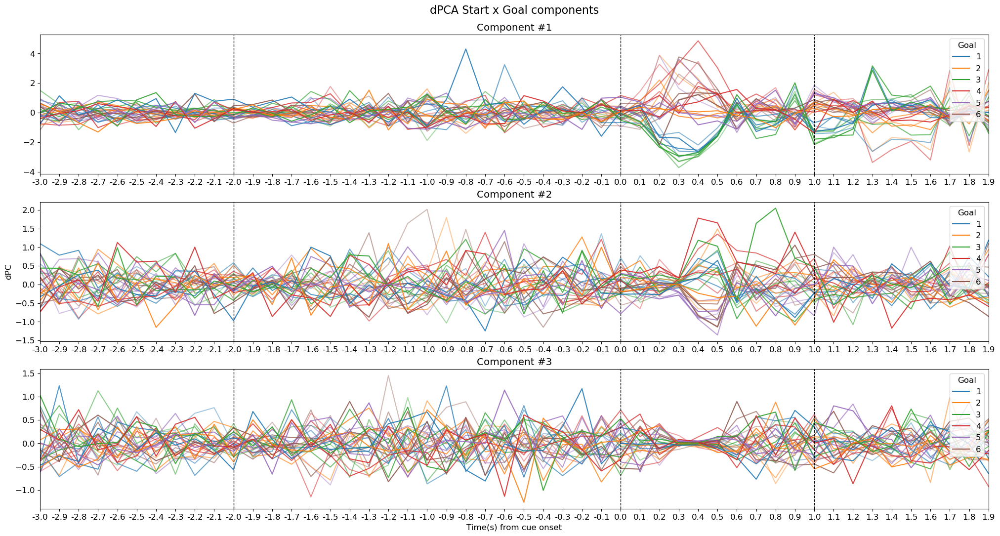

In [3093]:
fig, axes = plt.subplots(3, 1, figsize=(24, 12))
plt.subplots_adjust(0.1, 0.1, 0.9, 0.9, wspace=0.1, hspace=0.2)
plt.suptitle('dPCA Start x Goal components', y=0.95, fontsize=16)

for c in range(3):
    axes[c].set_title(f'Component #{c+1}')
    for s in range(num_goals):
        for g in range(num_goals-1):
            if g >= s:
                gi = g + 1
            else:
                gi = g
            if s > gi:
                si = s - 1
            else:
                si = s
            axes[c].plot(np.arange(num_timebins_ext), combined_dpcspikerates_iti_cue_per_traj['sg'][c,s,g], color=f'C{gi}', alpha=0.6*(si/5)+0.4, label=f'{gi+1}')
    axes[c].axvline(x=10, color='k', linewidth=1, linestyle='--')
    axes[c].axvline(x=30, color='k', linewidth=1, linestyle='--')
    axes[c].axvline(x=40, color='k', linewidth=1, linestyle='--')
    axes[c].set_xlim([0, num_timebins_ext-1])
    axes[c].set_xticks(np.arange(num_timebins_ext), labels=[f'{n:.1f}' for n in np.arange(-3, 2, 0.1)])
    axes[c].legend([Line2D([0],[0], color=f'C{s}') for s in range(num_goals)], [f'{s+1}' for s in range(num_goals)], title='Goal', loc='upper right')

axes[1].set_ylabel('dPC')
axes[-1].set_xlabel('Time(s) from cue onset')

Text(0.5, 0, 'Time(s) from cue onset')

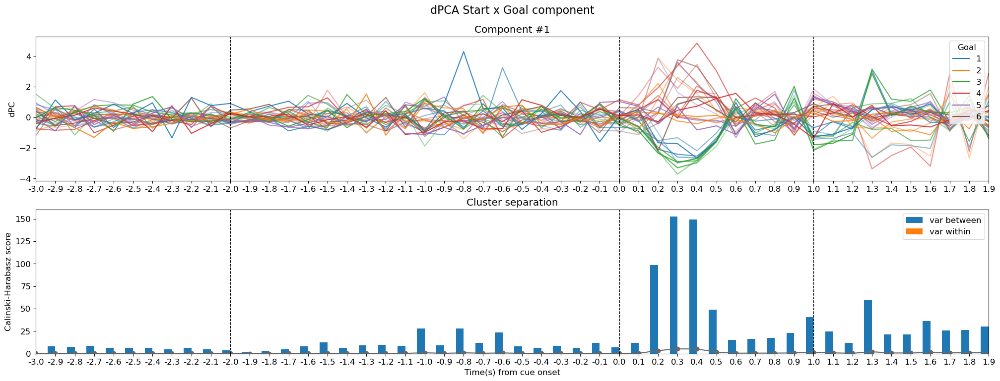

In [350]:
fig, axes = plt.subplots(2, 1, figsize=(24, 8))
plt.subplots_adjust(0.1, 0.1, 0.9, 0.9, wspace=0.1, hspace=0.2)
plt.suptitle('dPCA Start x Goal component', y=0.98, fontsize=16)

axes[0].set_title('Component #1')
for s in range(num_goals):
    for g in range(num_goals-1):
        if g >= s:
            gi = g + 1
        else:
            gi = g
        if s > gi:
            si = s - 1
        else:
            si = s
        axes[0].plot(np.arange(num_timebins_ext), combined_dpcspikerates_iti_cue_per_traj['sg'][0,s,g], color=f'C{gi}', alpha=0.6*(si/5)+0.4, label=f'{gi+1}')
axes[0].axvline(x=10, color='k', linewidth=1, linestyle='--')
axes[0].axvline(x=30, color='k', linewidth=1, linestyle='--')
axes[0].axvline(x=40, color='k', linewidth=1, linestyle='--')
axes[0].set_xlim([0, num_timebins_ext-1])
axes[0].set_xticks(np.arange(num_timebins_ext), labels=[f'{n:.1f}' for n in np.arange(-3, 2, 0.1)])
axes[0].legend([Line2D([0],[0], color=f'C{s}') for s in range(num_goals)], [f'{s+1}' for s in range(num_goals)], title='Goal', loc='upper right')

bar_width = 0.4
axes[1].set_title('Cluster separation')
axes[1].plot(np.arange(num_timebins_ext), combined_dpcspikerates_iti_cue_per_traj_vrc['sg'], marker='o', color='dimgrey')
axes[1].bar(np.arange(num_timebins_ext)-bar_width/2, dpc_cluster_var_sg[-1,:], width=bar_width, label='var between')
axes[1].bar(np.arange(num_timebins_ext)+bar_width/2, dpc_cluster_var_sg[-2,:], width=bar_width, label='var within')
axes[1].axvline(x=10, color='k', linewidth=1, linestyle='--')
axes[1].axvline(x=30, color='k', linewidth=1, linestyle='--')
axes[1].axvline(x=40, color='k', linewidth=1, linestyle='--')
axes[1].set_xlim([0, num_timebins_ext-1])
axes[1].set_xticks(np.arange(num_timebins_ext), labels=[f'{n:.1f}' for n in np.arange(-3, 2, 0.1)])
axes[1].legend(loc='upper right')

axes[0].set_ylabel('dPC')
axes[1].set_ylabel('Calinski-Harabasz score')
axes[1].set_xlabel('Time(s) from cue onset')

Text(0.5, 0, 'Time(s) from cue onset')

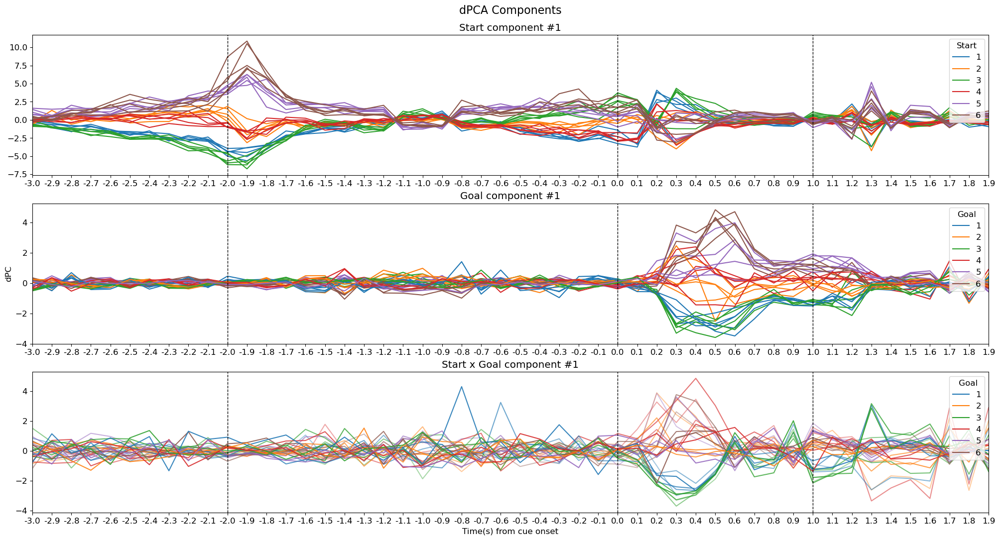

In [3092]:
fig, axes = plt.subplots(3, 1, figsize=(24, 12))
plt.subplots_adjust(0.1, 0.1, 0.9, 0.9, wspace=0.1, hspace=0.2)
plt.suptitle('dPCA Components', y=0.95, fontsize=16)

components = ['s', 'g', 'sg']
component_labels = ['Start', 'Goal', 'Start x Goal']

for s in range(num_goals):
        for g in range(num_goals-1):
            if g >= s:
                gi = g + 1
            else:
                gi = g
            if s > gi:
                si = s - 1
            else:
                si = s
            axes[0].plot(np.arange(num_timebins_ext), combined_dpcspikerates_iti_cue_per_traj['s'][0,s,g], color=f'C{s}', label=f'{s+1}')
            axes[1].plot(np.arange(num_timebins_ext), combined_dpcspikerates_iti_cue_per_traj['g'][0,s,g], color=f'C{gi}', label=f'{gi+1}')
            axes[2].plot(np.arange(num_timebins_ext), combined_dpcspikerates_iti_cue_per_traj['sg'][0,s,g], color=f'C{gi}', alpha=0.6*(si/5)+0.4, label=f'{gi+1}')

for c in range(3):
    axes[c].set_title(f'{component_labels[c]} component #1')
    axes[c].axvline(x=10, color='k', linewidth=1, linestyle='--')
    axes[c].axvline(x=30, color='k', linewidth=1, linestyle='--')
    axes[c].axvline(x=40, color='k', linewidth=1, linestyle='--')
    axes[c].set_xlim([0, num_timebins_ext-1])
    axes[c].set_xticks(np.arange(num_timebins_ext), labels=[f'{n:.1f}' for n in np.arange(-3, 2, 0.1)])
    axes[c].legend([Line2D([0],[0], color=f'C{s}') for s in range(num_goals)], [f'{s+1}' for s in range(num_goals)], title=component_labels[c][-5:], loc='upper right')

axes[1].set_ylabel('dPC')
axes[-1].set_xlabel('Time(s) from cue onset')

Text(0.5, 0, 'Time(s) from cue onset')

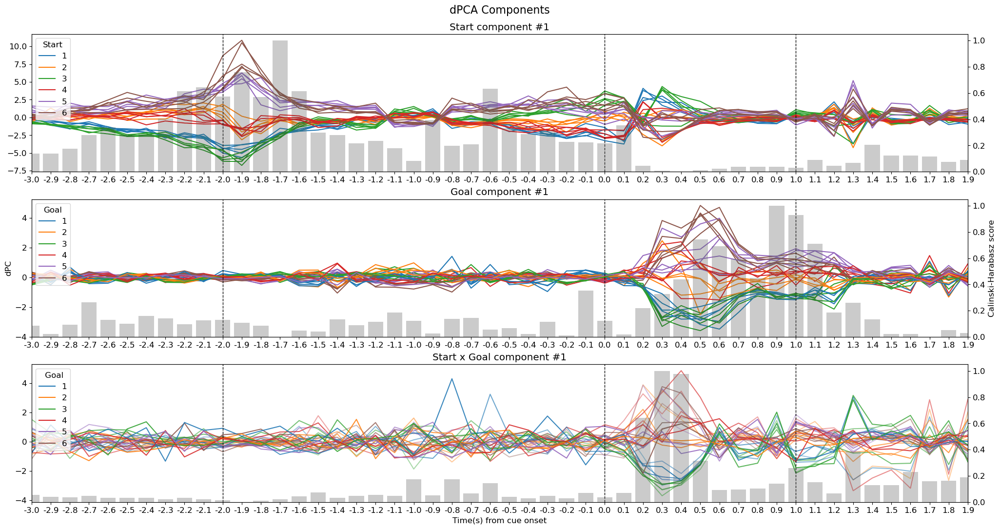

In [351]:
fig, axes = plt.subplots(3, 1, figsize=(24, 12))
plt.subplots_adjust(0.1, 0.1, 0.9, 0.9, wspace=0.1, hspace=0.2)
plt.suptitle('dPCA Components', y=0.95, fontsize=16)

axes2 = np.empty_like(axes)
for c, ax in enumerate(axes):
    axes2[c] = ax.twinx()

components = ['s', 'g', 'sg']
component_labels = ['Start', 'Goal', 'Start x Goal']
scaler = MinMaxScaler()

for s in range(num_goals):
        for g in range(num_goals-1):
            if g >= s:
                gi = g + 1
            else:
                gi = g
            if s > gi:
                si = s - 1
            else:
                si = s
            axes[0].plot(np.arange(num_timebins_ext), combined_dpcspikerates_iti_cue_per_traj['s'][0,s,g], color=f'C{s}', label=f'{s+1}')
            axes[1].plot(np.arange(num_timebins_ext), combined_dpcspikerates_iti_cue_per_traj['g'][0,s,g], color=f'C{gi}', label=f'{gi+1}')
            axes[2].plot(np.arange(num_timebins_ext), combined_dpcspikerates_iti_cue_per_traj['sg'][0,s,g], color=f'C{gi}', alpha=0.6*(si/5)+0.4, label=f'{gi+1}')
            # axes2[0].plot(np.arange(num_timebins_ext), scaler.fit_transform(combined_dpcspikerates_iti_cue_per_traj_vrc['s'].reshape(-1,1)).flatten(), linestyle='--', linewidth=0.8, color='tab:grey', alpha=0.2)
            # axes2[1].plot(np.arange(num_timebins_ext), scaler.fit_transform(combined_dpcspikerates_iti_cue_per_traj_vrc['g'].reshape(-1,1)).flatten(), linestyle='--', linewidth=0.8, color='tab:grey', alpha=0.2)
            # axes2[2].plot(np.arange(num_timebins_ext), scaler.fit_transform(combined_dpcspikerates_iti_cue_per_traj_vrc['sg'].reshape(-1,1)).flatten(), linestyle='--', linewidth=0.8, color='tab:grey', alpha=0.2)
            axes2[0].bar(np.arange(num_timebins_ext), scaler.fit_transform(combined_dpcspikerates_iti_cue_per_traj_vrc['s'].reshape(-1,1)).flatten(), width=0.8, color='tab:grey', alpha=0.01)
            axes2[1].bar(np.arange(num_timebins_ext), scaler.fit_transform(combined_dpcspikerates_iti_cue_per_traj_vrc['g'].reshape(-1,1)).flatten(), width=0.8, color='tab:grey', alpha=0.01)
            axes2[2].bar(np.arange(num_timebins_ext), scaler.fit_transform(combined_dpcspikerates_iti_cue_per_traj_vrc['sg'].reshape(-1,1)).flatten(), width=0.8, color='tab:grey', alpha=0.01)

for c in range(3):
    axes[c].set_title(f'{component_labels[c]} component #1')
    axes[c].axvline(x=10, color='k', linewidth=1, linestyle='--')
    axes[c].axvline(x=30, color='k', linewidth=1, linestyle='--')
    axes[c].axvline(x=40, color='k', linewidth=1, linestyle='--')
    axes[c].set_xlim([0, num_timebins_ext-1])
    axes[c].set_xticks(np.arange(num_timebins_ext), labels=[f'{n:.1f}' for n in np.arange(-3, 2, 0.1)])
    axes[c].legend([Line2D([0],[0], color=f'C{s}') for s in range(num_goals)], [f'{s+1}' for s in range(num_goals)], title=component_labels[c][-5:], loc='upper left')

axes[1].set_ylabel('dPC')
axes2[1].set_ylabel('Calinski-Harabasz score')
axes[-1].set_xlabel('Time(s) from cue onset')

50ms time bins across inter-trial interval + cue phase

In [3076]:
# Get all trials and trial average population responses per goal
# Formatted into an array of (k trials x n cells x s start x g goal x t time windows)
# Note: 6 start positions, 5 goal positions (excludes the same goal position as start position)
max_trials_per_traj = max(map(len, combined_spikerates_iti_cue_per_traj_50ms.values()))
combined_spikerates_iti_cue_per_traj_50ms_trials = np.zeros((max_trials_per_traj, num_all_cells, num_goals, num_goals-1, num_timebins_ext_50ms))
combined_spikerates_iti_cue_per_traj_50ms_trialavg = np.zeros((num_all_cells, num_goals, num_goals-1, num_timebins_ext_50ms))

for traj, responses in combined_spikerates_iti_cue_per_traj_50ms.items():
    s = traj[0] - 1
    g = traj[1] - 1
    if g > s:
        g -= 1
    n_trials = len(combined_spikerates_iti_cue_per_traj_50ms[traj])
    combined_spikerates_iti_cue_per_traj_50ms_trials[:n_trials,:,s,g,:] = np.stack(combined_spikerates_iti_cue_per_traj_50ms[traj], axis=0).transpose((0,2,1))
    np.random.seed(0)
    bootstrap_trials = np.random.randint(0, n_trials, max_trials_per_traj - n_trials)
    combined_spikerates_iti_cue_per_traj_50ms_trials[n_trials:,:,s,g,:] = combined_spikerates_iti_cue_per_traj_50ms_trials[bootstrap_trials,:,s,g,:]
    combined_spikerates_iti_cue_per_traj_50ms_trialavg[:,s,g,:] = np.mean(combined_spikerates_iti_cue_per_traj_50ms_trials[:n_trials,:,s,g,:], axis=0)

In [3077]:
combined_dpcspikerates_iti_cue_per_traj_50ms = dict()
dpca = dPCA.dPCA(labels='sg', regularizer='auto')
# dpca.n_trials = 5
dpca.protect = []

for timebin in range(num_timebins_ext_50ms):
    timebin_dpcs = dpca.fit_transform(combined_spikerates_iti_cue_per_traj_50ms_trialavg[:,:,:,timebin], combined_spikerates_iti_cue_per_traj_50ms_trials[:,:,:,:,timebin])
    for key, arr in timebin_dpcs.items():
        if key not in combined_dpcspikerates_iti_cue_per_traj_50ms:
            combined_dpcspikerates_iti_cue_per_traj_50ms[key] = [arr]
        else:
            combined_dpcspikerates_iti_cue_per_traj_50ms[key].append(arr)
    
for key, arr in combined_dpcspikerates_iti_cue_per_traj_50ms.items():
    combined_dpcspikerates_iti_cue_per_traj_50ms[key] = np.stack(arr, axis=-1)

You chose to determine the regularization parameter automatically. This can
                    take substantial time and grows linearly with the number of crossvalidation
                    folds. The latter can be set by changing self.n_trials (default = 3). Similarly,
                    use self.protect to set the list of axes that are not supposed to get to get shuffled
                    (e.g. upon splitting the data into test- and training, time-points should always
                    be drawn from the same trial, i.e. self.protect = ['t']). This can significantly
                    speed up the code.
Start optimizing regularization.
Starting trial  1 / 3
Starting trial  2 / 3
Starting trial  3 / 3
Optimized regularization, optimal lambda =  0.2689264815224247
Regularization will be fixed; to compute the optimal                    parameter again on the next fit, please                    set opt_regularizer_flag to True.


In [ ]:
fig, axes = plt.subplots(3, 1, figsize=(24, 12))
plt.subplots_adjust(0.1, 0.1, 0.9, 0.9, wspace=0.1, hspace=0.2)
plt.suptitle('dPCA Start components', y=0.95, fontsize=16)

for c in range(3):
    axes[c].set_title(f'Component #{c+1}')
    for s in range(num_goals):
        for g in range(num_goals-1):
            axes[c].plot(np.arange(num_timebins_ext_50ms), combined_dpcspikerates_iti_cue_per_traj_50ms['s'][c,s,g], color=f'C{s}', label=f'{s+1}')
    axes[c].axvline(x=20, color='k', linewidth=1, linestyle='--')
    axes[c].axvline(x=60, color='k', linewidth=1, linestyle='--')
    axes[c].axvline(x=80, color='k', linewidth=1, linestyle='--')
    axes[c].set_xlim([0, num_timebins_ext_50ms-1])
    axes[c].set_xticks(np.arange(0, num_timebins_ext_50ms, 2), labels=[f'{n:.1f}' for n in np.arange(-3, 2, 0.1)])
    axes[c].legend([Line2D([0],[0], color=f'C{s}') for s in range(num_goals)], [f'{s+1}' for s in range(num_goals)], title='Start', loc='upper right')

axes[1].set_ylabel('dPC')
axes[-1].set_xlabel('Time(s) from cue onset')

In [ ]:
fig, axes = plt.subplots(3, 1, figsize=(24, 12))
plt.subplots_adjust(0.1, 0.1, 0.9, 0.9, wspace=0.1, hspace=0.2)
plt.suptitle('dPCA Goal components', y=0.95, fontsize=16)

for c in range(3):
    axes[c].set_title(f'Component #{c+1}')
    for s in range(num_goals):
        for g in range(num_goals-1):
            if g >= s:
                gi = g + 1
            else:
                gi = g
            axes[c].plot(np.arange(num_timebins_ext_50ms), combined_dpcspikerates_iti_cue_per_traj_50ms['g'][c,s,g], color=f'C{gi}', label=f'{gi+1}')
    axes[c].axvline(x=20, color='k', linewidth=1, linestyle='--')
    axes[c].axvline(x=60, color='k', linewidth=1, linestyle='--')
    axes[c].axvline(x=80, color='k', linewidth=1, linestyle='--')
    axes[c].set_xlim([0, num_timebins_ext_50ms-1])
    axes[c].set_xticks(np.arange(0, num_timebins_ext_50ms, 2), labels=[f'{n:.1f}' for n in np.arange(-3, 2, 0.1)])
    axes[c].legend([Line2D([0],[0], color=f'C{s}') for s in range(num_goals)], [f'{s+1}' for s in range(num_goals)], title='Goal', loc='upper right')

axes[1].set_ylabel('dPC')
axes[-1].set_xlabel('Time(s) from cue onset')

In [ ]:
fig, axes = plt.subplots(3, 1, figsize=(24, 12))
plt.subplots_adjust(0.1, 0.1, 0.9, 0.9, wspace=0.1, hspace=0.2)
plt.suptitle('dPCA Start x Goal components', y=0.95, fontsize=16)

for c in range(3):
    axes[c].set_title(f'Component #{c+1}')
    for s in range(num_goals):
        for g in range(num_goals-1):
            if g >= s:
                gi = g + 1
            else:
                gi = g
            if s > gi:
                si = s - 1
            else:
                si = s
            axes[c].plot(np.arange(num_timebins_ext_50ms), combined_dpcspikerates_iti_cue_per_traj_50ms['sg'][c,s,g], color=f'C{gi}', alpha=0.6*(si/5)+0.4, label=f'{gi+1}')
    axes[c].axvline(x=20, color='k', linewidth=1, linestyle='--')
    axes[c].axvline(x=60, color='k', linewidth=1, linestyle='--')
    axes[c].axvline(x=80, color='k', linewidth=1, linestyle='--')
    axes[c].set_xlim([0, num_timebins_ext_50ms-1])
    axes[c].set_xticks(np.arange(0, num_timebins_ext_50ms, 2), labels=[f'{n:.1f}' for n in np.arange(-3, 2, 0.1)])
    axes[c].legend([Line2D([0],[0], color=f'C{s}') for s in range(num_goals)], [f'{s+1}' for s in range(num_goals)], title='Goal', loc='upper right')

axes[1].set_ylabel('dPC')
axes[-1].set_xlabel('Time(s) from cue onset')

In [ ]:
fig, axes = plt.subplots(3, 1, figsize=(24, 12))
plt.subplots_adjust(0.1, 0.1, 0.9, 0.9, wspace=0.1, hspace=0.2)
plt.suptitle('dPCA Components', y=0.95, fontsize=16)

components = ['s', 'g', 'sg']
component_labels = ['Start', 'Goal', 'Start x Goal']

for s in range(num_goals):
        for g in range(num_goals-1):
            if g >= s:
                gi = g + 1
            else:
                gi = g
            if s > gi:
                si = s - 1
            else:
                si = s
            axes[0].plot(np.arange(num_timebins_ext_50ms), combined_dpcspikerates_iti_cue_per_traj_50ms['s'][0,s,g], color=f'C{s}', label=f'{s+1}')
            axes[1].plot(np.arange(num_timebins_ext_50ms), combined_dpcspikerates_iti_cue_per_traj_50ms['g'][0,s,g], color=f'C{gi}', label=f'{gi+1}')
            axes[2].plot(np.arange(num_timebins_ext_50ms), combined_dpcspikerates_iti_cue_per_traj_50ms['sg'][0,s,g], color=f'C{gi}', alpha=0.6*(si/5)+0.4, label=f'{gi+1}')

for c in range(3):
    axes[c].set_title(f'{component_labels[c]} component #1')
    axes[c].axvline(x=20, color='k', linewidth=1, linestyle='--')
    axes[c].axvline(x=60, color='k', linewidth=1, linestyle='--')
    axes[c].axvline(x=80, color='k', linewidth=1, linestyle='--')
    axes[c].set_xlim([0, num_timebins_ext_50ms-1])
    axes[c].set_xticks(np.arange(0, num_timebins_ext_50ms, 2), labels=[f'{n:.1f}' for n in np.arange(-3, 2, 0.1)])
    axes[c].legend([Line2D([0],[0], color=f'C{s}') for s in range(num_goals)], [f'{s+1}' for s in range(num_goals)], title=component_labels[c][-5:], loc='upper right')

axes[1].set_ylabel('dPC')
axes[-1].set_xlabel('Time(s) from cue onset')

200ms time bins across inter-trial interval + cue phase

In [3066]:
# Generate spikerates for 200ms time bins
num_timebins_ext_200ms = 25
combined_spikerates_iti_cue_200ms = np.empty((num_trials, num_timebins_ext_200ms, num_all_cells))
for timebin in range(num_timebins_ext_200ms):
    combined_spikerates_iti_cue_200ms[:,timebin,:] = (combined_spikerates_iti_cue[:,2*timebin,:] + combined_spikerates_iti_cue[:,2*timebin+1,:]) / 2
combined_spikerates_iti_cue_per_traj_200ms = group_by_trajectory(combined_spikerates_iti_cue_200ms, combined_trajectories_iti_cue)

In [3074]:
# Get all trials and trial average population responses per goal
# Formatted into an array of (k trials x n cells x s start x g goal x t time windows)
# Note: 6 start positions, 5 goal positions (excludes the same goal position as start position)
max_trials_per_traj = max(map(len, combined_spikerates_iti_cue_per_traj_200ms.values()))
combined_spikerates_iti_cue_per_traj_200ms_trials = np.zeros((max_trials_per_traj, num_all_cells, num_goals, num_goals-1, num_timebins_ext_200ms))
combined_spikerates_iti_cue_per_traj_200ms_trialavg = np.zeros((num_all_cells, num_goals, num_goals-1, num_timebins_ext_200ms))

for traj, responses in combined_spikerates_iti_cue_per_traj_200ms.items():
    s = traj[0] - 1
    g = traj[1] - 1
    if g > s:
        g -= 1
    n_trials = len(combined_spikerates_iti_cue_per_traj_200ms[traj])
    combined_spikerates_iti_cue_per_traj_200ms_trials[:n_trials,:,s,g,:] = np.stack(combined_spikerates_iti_cue_per_traj_200ms[traj], axis=0).transpose((0,2,1))
    np.random.seed(0)
    bootstrap_trials = np.random.randint(0, n_trials, max_trials_per_traj - n_trials)
    combined_spikerates_iti_cue_per_traj_200ms_trials[n_trials:,:,s,g,:] = combined_spikerates_iti_cue_per_traj_200ms_trials[bootstrap_trials,:,s,g,:]
    combined_spikerates_iti_cue_per_traj_200ms_trialavg[:,s,g,:] = np.mean(combined_spikerates_iti_cue_per_traj_200ms_trials[:n_trials,:,s,g,:], axis=0)

In [3075]:
combined_dpcspikerates_iti_cue_per_traj_200ms = dict()
dpca = dPCA.dPCA(labels='sg', regularizer='auto')
# dpca.n_trials = 5
dpca.protect = []

for timebin in range(num_timebins_ext_200ms):
    timebin_dpcs = dpca.fit_transform(combined_spikerates_iti_cue_per_traj_200ms_trialavg[:,:,:,timebin], combined_spikerates_iti_cue_per_traj_200ms_trials[:,:,:,:,timebin])
    for key, arr in timebin_dpcs.items():
        if key not in combined_dpcspikerates_iti_cue_per_traj_200ms:
            combined_dpcspikerates_iti_cue_per_traj_200ms[key] = [arr]
        else:
            combined_dpcspikerates_iti_cue_per_traj_200ms[key].append(arr)
    
for key, arr in combined_dpcspikerates_iti_cue_per_traj_200ms.items():
    combined_dpcspikerates_iti_cue_per_traj_200ms[key] = np.stack(arr, axis=-1)

You chose to determine the regularization parameter automatically. This can
                    take substantial time and grows linearly with the number of crossvalidation
                    folds. The latter can be set by changing self.n_trials (default = 3). Similarly,
                    use self.protect to set the list of axes that are not supposed to get to get shuffled
                    (e.g. upon splitting the data into test- and training, time-points should always
                    be drawn from the same trial, i.e. self.protect = ['t']). This can significantly
                    speed up the code.
Start optimizing regularization.
Starting trial  1 / 3
Starting trial  2 / 3
Starting trial  3 / 3
Optimized regularization, optimal lambda =  0.006640873038344959
Regularization will be fixed; to compute the optimal                    parameter again on the next fit, please                    set opt_regularizer_flag to True.


In [ ]:
fig, axes = plt.subplots(3, 1, figsize=(24, 12))
plt.subplots_adjust(0.1, 0.1, 0.9, 0.9, wspace=0.1, hspace=0.2)
plt.suptitle('dPCA Start components', y=0.95, fontsize=16)

for c in range(3):
    axes[c].set_title(f'Component #{c+1}')
    for s in range(num_goals):
        for g in range(num_goals-1):
            axes[c].plot(np.arange(num_timebins_ext_200ms), combined_dpcspikerates_iti_cue_per_traj_200ms['s'][c,s,g], color=f'C{s}', label=f'{s+1}')
    axes[c].axvline(x=5, color='k', linewidth=1, linestyle='--')
    axes[c].axvline(x=15, color='k', linewidth=1, linestyle='--')
    axes[c].axvline(x=20, color='k', linewidth=1, linestyle='--')
    axes[c].set_xlim([0, num_timebins_ext_200ms-1])
    axes[c].set_xticks(np.arange(num_timebins_ext_200ms), labels=[f'{n:.1f}' for n in np.arange(-3, 2, 0.2)])
    axes[c].legend([Line2D([0],[0], color=f'C{s}') for s in range(num_goals)], [f'{s+1}' for s in range(num_goals)], title='Start', loc='upper right')

axes[1].set_ylabel('dPC')
axes[-1].set_xlabel('Time(s) from cue onset')

In [ ]:
fig, axes = plt.subplots(3, 1, figsize=(24, 12))
plt.subplots_adjust(0.1, 0.1, 0.9, 0.9, wspace=0.1, hspace=0.2)
plt.suptitle('dPCA Goal components', y=0.95, fontsize=16)

for c in range(3):
    axes[c].set_title(f'Component #{c+1}')
    for s in range(num_goals):
        for g in range(num_goals-1):
            if g >= s:
                gi = g + 1
            else:
                gi = g
            axes[c].plot(np.arange(num_timebins_ext_200ms), combined_dpcspikerates_iti_cue_per_traj_200ms['g'][c,s,g], color=f'C{gi}', label=f'{gi+1}')
    axes[c].axvline(x=5, color='k', linewidth=1, linestyle='--')
    axes[c].axvline(x=15, color='k', linewidth=1, linestyle='--')
    axes[c].axvline(x=20, color='k', linewidth=1, linestyle='--')
    axes[c].set_xlim([0, num_timebins_ext_200ms-1])
    axes[c].set_xticks(np.arange(num_timebins_ext_200ms), labels=[f'{n:.1f}' for n in np.arange(-3, 2, 0.2)])
    axes[c].legend([Line2D([0],[0], color=f'C{s}') for s in range(num_goals)], [f'{s+1}' for s in range(num_goals)], title='Goal', loc='upper right')

axes[1].set_ylabel('dPC')
axes[-1].set_xlabel('Time(s) from cue onset')

In [ ]:
fig, axes = plt.subplots(3, 1, figsize=(24, 12))
plt.subplots_adjust(0.1, 0.1, 0.9, 0.9, wspace=0.1, hspace=0.2)
plt.suptitle('dPCA Start x Goal components', y=0.95, fontsize=16)

for c in range(3):
    axes[c].set_title(f'Component #{c+1}')
    for s in range(num_goals):
        for g in range(num_goals-1):
            if g >= s:
                gi = g + 1
            else:
                gi = g
            if s > gi:
                si = s - 1
            else:
                si = s
            axes[c].plot(np.arange(num_timebins_ext_200ms), combined_dpcspikerates_iti_cue_per_traj_200ms['sg'][c,s,g], color=f'C{gi}', alpha=0.6*(si/5)+0.4, label=f'{gi+1}')
    axes[c].axvline(x=5, color='k', linewidth=1, linestyle='--')
    axes[c].axvline(x=15, color='k', linewidth=1, linestyle='--')
    axes[c].axvline(x=20, color='k', linewidth=1, linestyle='--')
    axes[c].set_xlim([0, num_timebins_ext_200ms-1])
    axes[c].set_xticks(np.arange(num_timebins_ext_200ms), labels=[f'{n:.1f}' for n in np.arange(-3, 2, 0.2)])
    axes[c].legend([Line2D([0],[0], color=f'C{s}') for s in range(num_goals)], [f'{s+1}' for s in range(num_goals)], title='Goal', loc='upper right')

axes[1].set_ylabel('dPC')
axes[-1].set_xlabel('Time(s) from cue onset')

In [ ]:
fig, axes = plt.subplots(3, 1, figsize=(24, 12))
plt.subplots_adjust(0.1, 0.1, 0.9, 0.9, wspace=0.1, hspace=0.2)
plt.suptitle('dPCA Components', y=0.95, fontsize=16)

components = ['s', 'g', 'sg']
component_labels = ['Start', 'Goal', 'Start x Goal']

for s in range(num_goals):
        for g in range(num_goals-1):
            if g >= s:
                gi = g + 1
            else:
                gi = g
            if s > gi:
                si = s - 1
            else:
                si = s
            axes[0].plot(np.arange(num_timebins_ext_200ms), combined_dpcspikerates_iti_cue_per_traj_200ms['s'][0,s,g], color=f'C{s}', label=f'{s+1}')
            axes[1].plot(np.arange(num_timebins_ext_200ms), combined_dpcspikerates_iti_cue_per_traj_200ms['g'][0,s,g], color=f'C{gi}', label=f'{gi+1}')
            axes[2].plot(np.arange(num_timebins_ext_200ms), combined_dpcspikerates_iti_cue_per_traj_200ms['sg'][0,s,g], color=f'C{gi}', alpha=0.6*(si/5)+0.4, label=f'{gi+1}')

for c in range(3):
    axes[c].set_title(f'{component_labels[c]} component #1')
    axes[c].axvline(x=5, color='k', linewidth=1, linestyle='--')
    axes[c].axvline(x=15, color='k', linewidth=1, linestyle='--')
    axes[c].axvline(x=20, color='k', linewidth=1, linestyle='--')
    axes[c].set_xlim([0, num_timebins_ext_200ms-1])
    axes[c].set_xticks(np.arange(num_timebins_ext_200ms), labels=[f'{n:.1f}' for n in np.arange(-3, 2, 0.2)])
    axes[c].legend([Line2D([0],[0], color=f'C{s}') for s in range(num_goals)], [f'{s+1}' for s in range(num_goals)], title=component_labels[c][-5:], loc='upper right')

axes[1].set_ylabel('dPC')
axes[-1].set_xlabel('Time(s) from cue onset')

Comparison of different time window sizes (50ms, 100ms, 200ms)

Text(0.5, 0, 'Time(s) from cue onset')

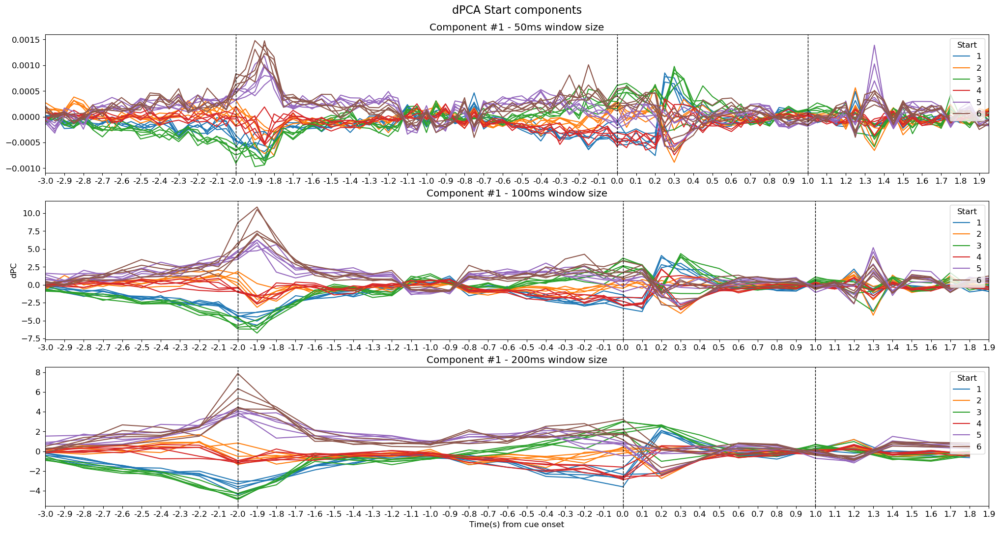

In [3111]:
fig, axes = plt.subplots(3, 1, figsize=(24, 12))
plt.subplots_adjust(0.1, 0.1, 0.9, 0.9, wspace=0.1, hspace=0.2)
plt.suptitle('dPCA Start components', y=0.95, fontsize=16)

axes[0].set_title('Component #1 - 50ms window size')
axes[1].set_title('Component #1 - 100ms window size')
axes[2].set_title('Component #1 - 200ms window size')

for s in range(num_goals):
    for g in range(num_goals-1):
        axes[0].plot(np.arange(num_timebins_ext_50ms), combined_dpcspikerates_iti_cue_per_traj_50ms['s'][0,s,g], color=f'C{s}', label=f'{s+1}')
        axes[1].plot(np.arange(num_timebins_ext), combined_dpcspikerates_iti_cue_per_traj['s'][0,s,g], color=f'C{s}', label=f'{s+1}')
        axes[2].plot(np.arange(num_timebins_ext_200ms), combined_dpcspikerates_iti_cue_per_traj_200ms['s'][0,s,g], color=f'C{s}', label=f'{s+1}')

axes[0].axvline(x=20, color='k', linewidth=1, linestyle='--')
axes[0].axvline(x=60, color='k', linewidth=1, linestyle='--')
axes[0].axvline(x=80, color='k', linewidth=1, linestyle='--')
axes[0].set_xlim([0, num_timebins_ext_50ms-1])
axes[0].set_xticks(np.arange(0, num_timebins_ext_50ms, 2), labels=[f'{n:.1f}' for n in np.arange(-3, 2, 0.1)])

axes[1].axvline(x=10, color='k', linewidth=1, linestyle='--')
axes[1].axvline(x=30, color='k', linewidth=1, linestyle='--')
axes[1].axvline(x=40, color='k', linewidth=1, linestyle='--')
axes[1].set_xlim([0, num_timebins_ext-1])
axes[1].set_xticks(np.arange(num_timebins_ext), labels=[f'{n:.1f}' for n in np.arange(-3, 2, 0.1)])

axes[2].axvline(x=5, color='k', linewidth=1, linestyle='--')
axes[2].axvline(x=15, color='k', linewidth=1, linestyle='--')
axes[2].axvline(x=20, color='k', linewidth=1, linestyle='--')
axes[2].set_xlim([0, num_timebins_ext_200ms-1])
axes[2].set_xticks(np.arange(0, num_timebins_ext_200ms, 0.5), labels=[f'{n:.1f}' for n in np.arange(-3, 2, 0.1)])

for c in range(3):
    axes[c].legend([Line2D([0],[0], color=f'C{s}') for s in range(num_goals)], [f'{s+1}' for s in range(num_goals)], title='Start', loc='upper right')

axes[1].set_ylabel('dPC')
axes[-1].set_xlabel('Time(s) from cue onset')

Text(0.5, 0, 'Time(s) from cue onset')

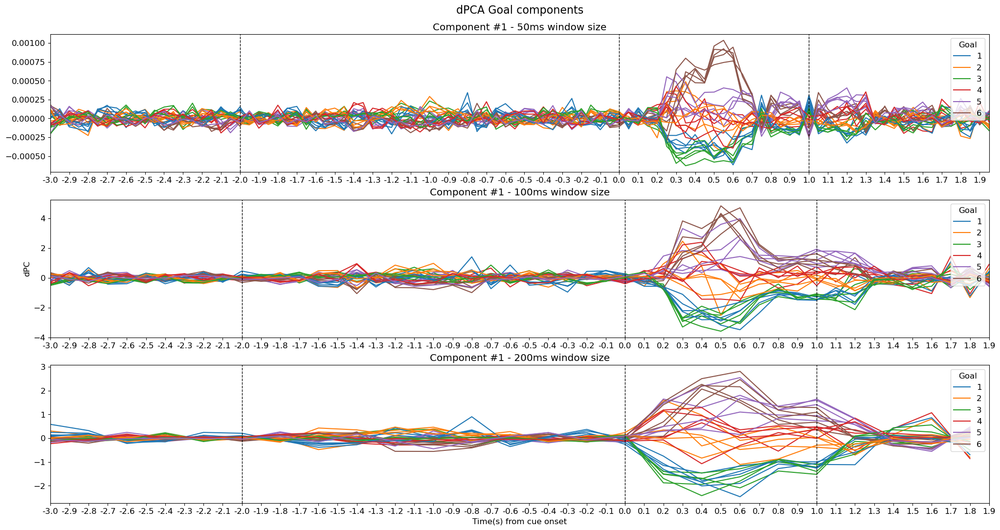

In [3112]:
fig, axes = plt.subplots(3, 1, figsize=(24, 12))
plt.subplots_adjust(0.1, 0.1, 0.9, 0.9, wspace=0.1, hspace=0.2)
plt.suptitle('dPCA Goal components', y=0.95, fontsize=16)

axes[0].set_title('Component #1 - 50ms window size')
axes[1].set_title('Component #1 - 100ms window size')
axes[2].set_title('Component #1 - 200ms window size')

for s in range(num_goals):
    for g in range(num_goals-1):
        if g >= s:
            gi = g + 1
        else:
            gi = g
        axes[0].plot(np.arange(num_timebins_ext_50ms), combined_dpcspikerates_iti_cue_per_traj_50ms['g'][0,s,g], color=f'C{gi}', label=f'{gi+1}')
        axes[1].plot(np.arange(num_timebins_ext), combined_dpcspikerates_iti_cue_per_traj['g'][0,s,g], color=f'C{gi}', label=f'{gi+1}')
        axes[2].plot(np.arange(num_timebins_ext_200ms), combined_dpcspikerates_iti_cue_per_traj_200ms['g'][0,s,g], color=f'C{gi}', label=f'{gi+1}')

axes[0].axvline(x=20, color='k', linewidth=1, linestyle='--')
axes[0].axvline(x=60, color='k', linewidth=1, linestyle='--')
axes[0].axvline(x=80, color='k', linewidth=1, linestyle='--')
axes[0].set_xlim([0, num_timebins_ext_50ms-1])
axes[0].set_xticks(np.arange(0, num_timebins_ext_50ms, 2), labels=[f'{n:.1f}' for n in np.arange(-3, 2, 0.1)])

axes[1].axvline(x=10, color='k', linewidth=1, linestyle='--')
axes[1].axvline(x=30, color='k', linewidth=1, linestyle='--')
axes[1].axvline(x=40, color='k', linewidth=1, linestyle='--')
axes[1].set_xlim([0, num_timebins_ext-1])
axes[1].set_xticks(np.arange(num_timebins_ext), labels=[f'{n:.1f}' for n in np.arange(-3, 2, 0.1)])

axes[2].axvline(x=5, color='k', linewidth=1, linestyle='--')
axes[2].axvline(x=15, color='k', linewidth=1, linestyle='--')
axes[2].axvline(x=20, color='k', linewidth=1, linestyle='--')
axes[2].set_xlim([0, num_timebins_ext_200ms-1])
axes[2].set_xticks(np.arange(0, num_timebins_ext_200ms, 0.5), labels=[f'{n:.1f}' for n in np.arange(-3, 2, 0.1)])

for c in range(3):
    axes[c].legend([Line2D([0],[0], color=f'C{s}') for s in range(num_goals)], [f'{s+1}' for s in range(num_goals)], title='Goal', loc='upper right')

axes[1].set_ylabel('dPC')
axes[-1].set_xlabel('Time(s) from cue onset')

Text(0.5, 0, 'Time(s) from cue onset')

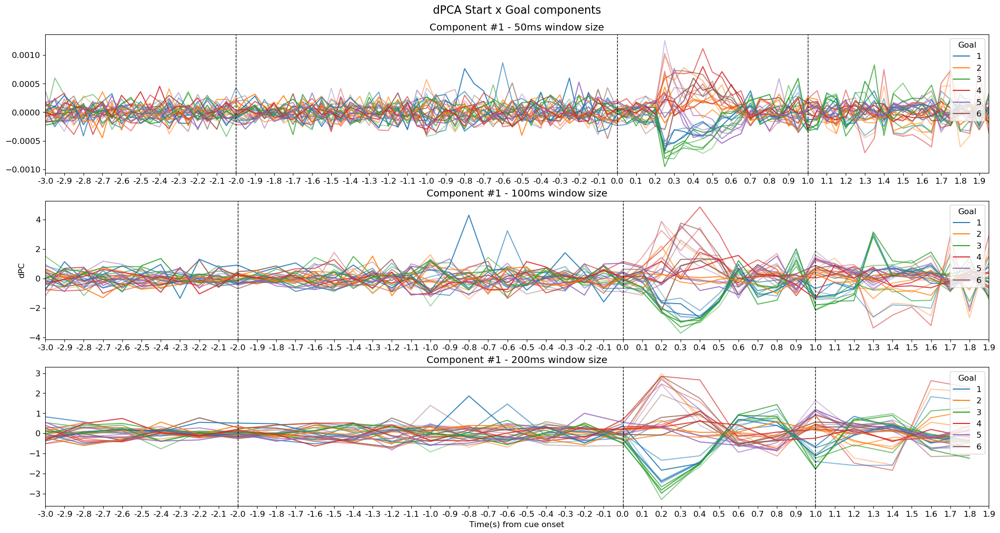

In [3114]:
fig, axes = plt.subplots(3, 1, figsize=(24, 12))
plt.subplots_adjust(0.1, 0.1, 0.9, 0.9, wspace=0.1, hspace=0.2)
plt.suptitle('dPCA Start x Goal components', y=0.95, fontsize=16)

axes[0].set_title('Component #1 - 50ms window size')
axes[1].set_title('Component #1 - 100ms window size')
axes[2].set_title('Component #1 - 200ms window size')

for s in range(num_goals):
    for g in range(num_goals-1):
        if g >= s:
            gi = g + 1
        else:
            gi = g
        if s > gi:
            si = s - 1
        else:
            si = s
        axes[0].plot(np.arange(num_timebins_ext_50ms), combined_dpcspikerates_iti_cue_per_traj_50ms['sg'][0,s,g], color=f'C{gi}', alpha=0.6*(si/5)+0.4, label=f'{gi+1}')
        axes[1].plot(np.arange(num_timebins_ext), combined_dpcspikerates_iti_cue_per_traj['sg'][0,s,g], color=f'C{gi}', alpha=0.6*(si/5)+0.4, label=f'{gi+1}')
        axes[2].plot(np.arange(num_timebins_ext_200ms), combined_dpcspikerates_iti_cue_per_traj_200ms['sg'][0,s,g], color=f'C{gi}', alpha=0.6*(si/5)+0.4, label=f'{gi+1}')

axes[0].axvline(x=20, color='k', linewidth=1, linestyle='--')
axes[0].axvline(x=60, color='k', linewidth=1, linestyle='--')
axes[0].axvline(x=80, color='k', linewidth=1, linestyle='--')
axes[0].set_xlim([0, num_timebins_ext_50ms-1])
axes[0].set_xticks(np.arange(0, num_timebins_ext_50ms, 2), labels=[f'{n:.1f}' for n in np.arange(-3, 2, 0.1)])

axes[1].axvline(x=10, color='k', linewidth=1, linestyle='--')
axes[1].axvline(x=30, color='k', linewidth=1, linestyle='--')
axes[1].axvline(x=40, color='k', linewidth=1, linestyle='--')
axes[1].set_xlim([0, num_timebins_ext-1])
axes[1].set_xticks(np.arange(num_timebins_ext), labels=[f'{n:.1f}' for n in np.arange(-3, 2, 0.1)])

axes[2].axvline(x=5, color='k', linewidth=1, linestyle='--')
axes[2].axvline(x=15, color='k', linewidth=1, linestyle='--')
axes[2].axvline(x=20, color='k', linewidth=1, linestyle='--')
axes[2].set_xlim([0, num_timebins_ext_200ms-1])
axes[2].set_xticks(np.arange(0, num_timebins_ext_200ms, 0.5), labels=[f'{n:.1f}' for n in np.arange(-3, 2, 0.1)])

for c in range(3):
    axes[c].legend([Line2D([0],[0], color=f'C{s}') for s in range(num_goals)], [f'{s+1}' for s in range(num_goals)], title='Goal', loc='upper right')

axes[1].set_ylabel('dPC')
axes[-1].set_xlabel('Time(s) from cue onset')

#### Simulated dataset for dPCA testing

In [751]:
class CellSimulation:
    def __init__(self, start, goal, active, noise, base=0, sel='none'):
        self.start_sel = start
        self.goal_sel = goal
        self.active_rate = active
        self.var_rate = noise
        self.base_rate = base
        self.sel_type = sel

    def firing_rate(self, start, goal, activity=1):
        if (self.start_sel == start) or (self.goal_sel == goal):
            rate = activity * (self.active_rate - self.base_rate) + self.base_rate
            # rate = activity * self.active_rate
        else:
            rate = self.base_rate
            # rate = 0
        return abs(np.random.normal(rate, self.var_rate))


class CellSimulationV2(CellSimulation):
    def __init__(self, start, goal, active, noise, base=0, sel='sg'):
        super().__init__(start, goal, active, noise, base, sel)
        self.interaction = lambda x, y: x + y
    
    def var_firing_rate(self, activity=1):
        return activity * (self.active_rate - self.base_rate) + self.base_rate
    
    def firing_rate(self, start, goal, activity):
        if (self.start_sel == start) and (self.goal_sel == goal):
            rate = self.interaction(self.var_firing_rate(activity[0]), self.var_firing_rate(activity[1]))
        elif self.start_sel == start:
            rate = self.var_firing_rate(activity[0])
        elif self.goal_sel == goal:
            rate = self.var_firing_rate(activity[1])
        else:
            rate = self.base_rate
        return abs(np.random.normal(rate, self.var_rate))


class CellSimulationV3(CellSimulationV2):
    def __init__(self, start, goal, active, noise, base=0, sel='sg'):
        super().__init__(start, goal, active, noise, base, sel)
        self.interaction = lambda x, y: min(x, y)
    
    def firing_rate(self, start, goal, activity):
        if (self.start_sel == start) and (self.goal_sel == goal):
            rate = self.interaction(self.var_firing_rate(activity[0]), self.var_firing_rate(activity[1]))
        else:
            rate = self.base_rate
        return abs(np.random.normal(rate, self.var_rate))


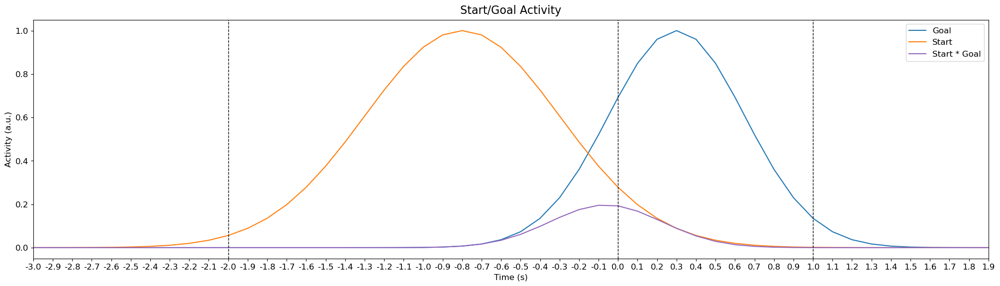

In [763]:
scaler = MinMaxScaler()
# start_sel_activity = scaler.fit_transform(savgol_filter(np.mean(lda_start_accuracy_iti_cue_timebins, axis=1), 21, 5).reshape(-1,1)).flatten()
# goal_sel_activity = scaler.fit_transform(savgol_filter(np.mean(lda_goal_accuracy_iti_cue_timebins, axis=1), 21, 5).reshape(-1,1)).flatten()
simulated_timebins = np.arange(-3, 2, 0.1)
# start_sel_activity = np.exp(-0.5 * ((simulated_timebins - (-2)) / 0.2) ** 2)
start_sel_activity = np.exp(-0.5 * ((simulated_timebins - (-0.8)) / 0.5) ** 2)
# goal_sel_activity = np.exp(-0.5 * ((simulated_timebins - (0.5)) / 0.2) ** 2)
goal_sel_activity = np.exp(-0.5 * ((simulated_timebins - (0.3)) / 0.35) ** 2)
traj_sel_activity = start_sel_activity * goal_sel_activity

fig, axes = plt.subplots(1, 1, figsize=(24, 6))
plt.subplots_adjust(0.1, 0.1, 0.9, 0.9, wspace=0.1, hspace=0.2)
plt.suptitle('Start/Goal Activity', y=0.95, fontsize=16)

axes.plot(np.arange(num_timebins_ext), goal_sel_activity, color=f'C0', label=f'Goal')
axes.plot(np.arange(num_timebins_ext), start_sel_activity, color=f'C1', label=f'Start')
axes.plot(np.arange(num_timebins_ext), traj_sel_activity, color=f'C4', label=f'Start * Goal')

axes.axvline(x=10, color='k', linewidth=1, linestyle='--')
axes.axvline(x=30, color='k', linewidth=1, linestyle='--')
axes.axvline(x=40, color='k', linewidth=1, linestyle='--')
axes.set_xlim([0, num_timebins_ext-1])
axes.set_xticks(np.arange(num_timebins_ext), labels=[f'{n:.1f}' for n in np.arange(-3, 2, 0.1)])
axes.set_xlabel('Time (s)')
axes.set_ylabel('Activity (a.u.)')
axes.legend(loc='upper right')

In [764]:
# Assemble simulated dataset with {num_sel_cells} selective cell(s) per start/goal
simulated_cells_list = list()
# base_fr_range, active_fr_range = [1, 2], [8, 12]  # will be multiplied by 0.1
base_fr_range, noise_fr_range, active_fr_range = [0, 2], [3, 6], [4, 8]  # will be multiplied by 0.1

### Run this block if simulating singly-selective cells
num_sel_cells, nonsel_cell_ratio = 5, 0.5
for i in range(num_goals):
    for _ in range(num_sel_cells):
        base_fr = 0.1 * np.random.randint(base_fr_range[0], base_fr_range[1])
        noise_fr = 0.1 * np.random.randint(noise_fr_range[0], noise_fr_range[1])
        active_fr = 0.1 * np.random.randint(active_fr_range[0], active_fr_range[1])
        simulated_cells_list.append(CellSimulation(i, -1, active_fr, noise_fr, base_fr, 's'))
    for _ in range(num_sel_cells):
        base_fr = 0.1 * np.random.randint(base_fr_range[0], base_fr_range[1])
        noise_fr = 0.1 * np.random.randint(noise_fr_range[0], noise_fr_range[1])
        active_fr = 0.1 * np.random.randint(active_fr_range[0], active_fr_range[1])
        simulated_cells_list.append(CellSimulation(-1, i, active_fr, noise_fr, base_fr, 'g'))
num_nonsel_cells = int(2 * num_goals * num_sel_cells * nonsel_cell_ratio)
        
### Run this block if simulating mixed-selective cells
# num_sel_cells, nonsel_cell_ratio = 2, 0.5
# for i in range(num_goals):
#     for j in range(num_goals):
#         if i == j:
#             continue
#         for _ in range(num_sel_cells):
#             base_fr = 0.1 * np.random.randint(base_fr_range[0], base_fr_range[1])
#             noise_fr = 0.1 * np.random.randint(noise_fr_range[0], noise_fr_range[1])
#             active_fr = 0.1 * np.random.randint(active_fr_range[0], active_fr_range[1])
#             # simulated_cells_list.append(CellSimulationV2(i, j, active_fr, noise_fr, base_fr, 'sg'))
#             # simulated_cells_list.append(CellSimulationV3(i, j, active_fr, noise_fr, base_fr, 'sg'))
# num_nonsel_cells = int(num_goals * (num_goals-1) * num_sel_cells * nonsel_cell_ratio)

for i in range(num_nonsel_cells):
    cell_mean_fr = 0.1 * np.random.randint(base_fr_range[0], active_fr_range[1])
    simulated_cells_list.append(CellSimulation(-1, -1, cell_mean_fr, cell_mean_fr))
num_sim_cells = len(simulated_cells_list)
num_sim_trials, num_sim_timebins = 10, num_timebins_ext

simulated_spikerates_iti_cue_per_traj_trials = np.zeros((num_sim_trials, num_sim_cells, num_goals, num_goals-1, num_sim_timebins))
for s in range(num_goals):
    for g in range(num_goals-1):
        gi = g + 1 if g >= s else g
        for c, cell in enumerate(simulated_cells_list):
            if cell.sel_type == 'sg':  # mixed (start & goal) selective cell
                timebin_activity = np.stack([start_sel_activity, goal_sel_activity], axis=-1)
            elif cell.sel_type == 's':  # start selective cell
                timebin_activity = start_sel_activity
            elif cell.sel_type == 'g':  # goal selective cell
                timebin_activity = goal_sel_activity
            else:
                timebin_activity = np.zeros(num_sim_timebins)
            for n in range(num_sim_trials):
                for t, activity in enumerate(timebin_activity):
                    simulated_spikerates_iti_cue_per_traj_trials[n,c,s,g,t] = cell.firing_rate(s,gi,activity)
                simulated_spikerates_iti_cue_per_traj_trials[n,c,s,g,:] = savgol_filter(simulated_spikerates_iti_cue_per_traj_trials[n,c,s,g,:], 5, 3)
# for g in range(num_goals):
#     for s in range(num_goals-1):
#         si = s + 1 if s >= g else s
#         for c, cell in enumerate(simulated_cells_list):
#             if cell.sel_type == 'sg':  # mixed (start & goal) selective cell
#                 timebin_activity = np.stack([start_sel_activity, goal_sel_activity], axis=-1)
#             elif cell.sel_type == 's':  # start selective cell
#                 timebin_activity = start_sel_activity
#             elif cell.sel_type == 'g':  # goal selective cell
#                 timebin_activity = goal_sel_activity
#             else:
#                 timebin_activity = np.zeros(num_sim_timebins)
#             for n in range(num_sim_trials):
#                 for t, activity in enumerate(timebin_activity):
#                     simulated_spikerates_iti_cue_per_traj_trials[n,c,g,s,t] = cell.firing_rate(si,g,activity)
#                 simulated_spikerates_iti_cue_per_traj_trials[n,c,g,s,:] = savgol_filter(simulated_spikerates_iti_cue_per_traj_trials[n,c,g,s,:], 5, 3)

simulated_spikerates_iti_cue_per_traj_trialavg = np.mean(simulated_spikerates_iti_cue_per_traj_trials, axis=0)

In [765]:
simulated_dpcspikerates_iti_cue_per_traj = dict()
dpca = dPCA.dPCA(labels='sg', regularizer='auto')
# dpca = dPCA.dPCA(labels='gs', regularizer='auto')
# dpca.n_trials = 5
dpca.protect = []

for timebin in range(num_sim_timebins):
    timebin_dpcs = dpca.fit_transform(simulated_spikerates_iti_cue_per_traj_trialavg[:,:,:,timebin], simulated_spikerates_iti_cue_per_traj_trials[:,:,:,:,timebin])
    for key, arr in timebin_dpcs.items():
        if key not in simulated_dpcspikerates_iti_cue_per_traj:
            simulated_dpcspikerates_iti_cue_per_traj[key] = [arr]
        else:
            simulated_dpcspikerates_iti_cue_per_traj[key].append(arr)
    
for key, arr in simulated_dpcspikerates_iti_cue_per_traj.items():
    simulated_dpcspikerates_iti_cue_per_traj[key] = np.stack(arr, axis=-1)

You chose to determine the regularization parameter automatically. This can
                    take substantial time and grows linearly with the number of crossvalidation
                    folds. The latter can be set by changing self.n_trials (default = 3). Similarly,
                    use self.protect to set the list of axes that are not supposed to get to get shuffled
                    (e.g. upon splitting the data into test- and training, time-points should always
                    be drawn from the same trial, i.e. self.protect = ['t']). This can significantly
                    speed up the code.
Start optimizing regularization.
Starting trial  1 / 3


Starting trial  2 / 3
Starting trial  3 / 3
Optimized regularization, optimal lambda =  0.2689264815224247
Regularization will be fixed; to compute the optimal                    parameter again on the next fit, please                    set opt_regularizer_flag to True.


In [766]:
# Calculate separation between first 3 dPCs for each marginalization across time
simulated_dpcspikerates_iti_cue_per_traj_vrc = {key: np.zeros((3, num_sim_timebins)) for key in simulated_dpcspikerates_iti_cue_per_traj.keys()}
for component in range(3):
    for timebin in range(num_sim_timebins):
        # Start marginalization
        simulated_dpcspikerates_iti_cue_per_traj_vrc['s'][component,timebin] = calinski_harabasz_score(simulated_dpcspikerates_iti_cue_per_traj['s'][component,:,:,timebin].flatten().reshape(-1,1), combined_dpc_start_labels.flatten())
        # simulated_dpcspikerates_iti_cue_per_traj_vrc['s'][component,timebin] = calinski_harabasz_score(simulated_dpcspikerates_iti_cue_per_traj['s'][component,:,:,timebin].flatten().reshape(-1,1), combined_dpc_goal_labels.flatten())
        # Goal marginalization
        simulated_dpcspikerates_iti_cue_per_traj_vrc['g'][component,timebin] = calinski_harabasz_score(simulated_dpcspikerates_iti_cue_per_traj['g'][component,:,:,timebin].flatten().reshape(-1,1), combined_dpc_goal_labels.flatten())
        # simulated_dpcspikerates_iti_cue_per_traj_vrc['g'][component,timebin] = calinski_harabasz_score(simulated_dpcspikerates_iti_cue_per_traj['g'][component,:,:,timebin].flatten().reshape(-1,1), combined_dpc_start_labels.flatten())
        # Start x Goal marginalization - calculate separation treating each {start, goal} tuple as its own cluster
        sg_clusters = simulated_dpcspikerates_iti_cue_per_traj['sg'][component,:,:,timebin].flatten()
        # sg_clusters = simulated_dpcspikerates_iti_cue_per_traj['gs'][component,:,:,timebin].flatten()
        sg_overall_mean = np.mean(sg_clusters)
        simulated_dpcspikerates_iti_cue_per_traj_vrc['sg'][component,timebin] = np.dot(sg_clusters - sg_overall_mean, sg_clusters - sg_overall_mean) / (len(trajectories) - 1)
        # simulated_dpcspikerates_iti_cue_per_traj_vrc['gs'][component,timebin] = np.dot(sg_clusters - sg_overall_mean, sg_clusters - sg_overall_mean) / (len(trajectories) - 1)

scaler = MinMaxScaler()
for component in range(3):
    simulated_dpcspikerates_iti_cue_per_traj_vrc['s'][component] = scaler.fit_transform(simulated_dpcspikerates_iti_cue_per_traj_vrc['s'][component].reshape(-1,1)).flatten()
    simulated_dpcspikerates_iti_cue_per_traj_vrc['g'][component] = scaler.fit_transform(simulated_dpcspikerates_iti_cue_per_traj_vrc['g'][component].reshape(-1,1)).flatten()
    simulated_dpcspikerates_iti_cue_per_traj_vrc['sg'][component] = scaler.fit_transform(simulated_dpcspikerates_iti_cue_per_traj_vrc['sg'][component].reshape(-1,1)).flatten()
    # simulated_dpcspikerates_iti_cue_per_traj_vrc['gs'][component] = scaler.fit_transform(simulated_dpcspikerates_iti_cue_per_traj_vrc['gs'][component].reshape(-1,1)).flatten()

Text(0.5, 0, 'Time(s) from cue onset')

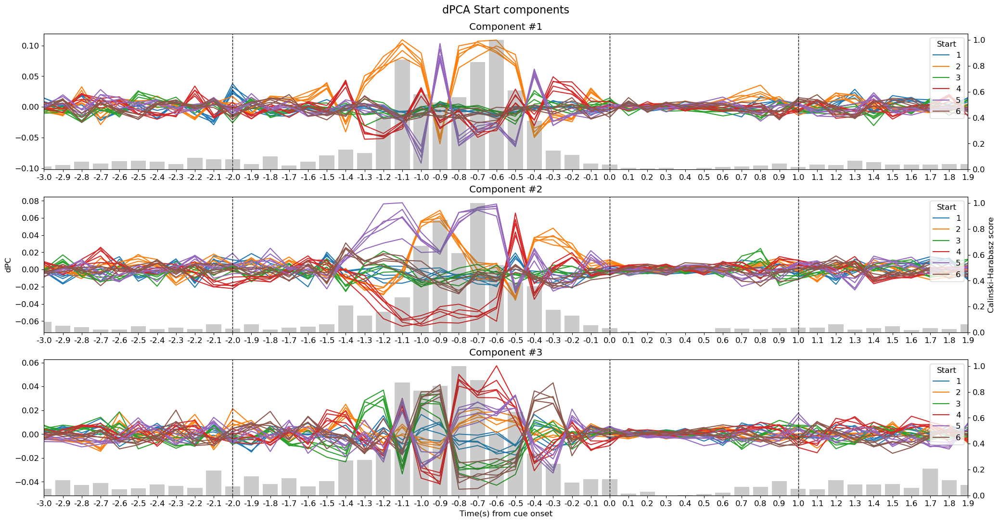

In [767]:
fig, axes = plt.subplots(3, 1, figsize=(24, 12))
plt.subplots_adjust(0.1, 0.1, 0.9, 0.9, wspace=0.1, hspace=0.2)
plt.suptitle('dPCA Start components', y=0.95, fontsize=16)
axes2 = np.empty_like(axes)
for c, ax in enumerate(axes):
    axes2[c] = ax.twinx()

for c in range(3):
    axes[c].set_title(f'Component #{c+1}')
    for s in range(num_goals):
        for g in range(num_goals-1):
            axes[c].plot(np.arange(num_sim_timebins), simulated_dpcspikerates_iti_cue_per_traj['s'][c,s,g], color=f'C{s}', label=f'{s+1}')
            axes2[c].bar(np.arange(num_sim_timebins), simulated_dpcspikerates_iti_cue_per_traj_vrc['s'][c], width=0.8, color='tab:grey', alpha=0.01)
    # for g in range(num_goals):
    #     for s in range(num_goals-1):
    #         si = s + 1 if s >= g else s
    #         axes[c].plot(np.arange(num_sim_timebins), simulated_dpcspikerates_iti_cue_per_traj['s'][c,g,s], color=f'C{si}', label=f'{s+1}')
    #         axes2[c].bar(np.arange(num_sim_timebins), simulated_dpcspikerates_iti_cue_per_traj_vrc['s'][c], width=0.8, color='tab:grey', alpha=0.01)

    axes[c].axvline(x=10, color='k', linewidth=1, linestyle='--')
    axes[c].axvline(x=30, color='k', linewidth=1, linestyle='--')
    axes[c].axvline(x=40, color='k', linewidth=1, linestyle='--')
    axes[c].set_xlim([0, num_sim_timebins-1])
    axes[c].set_xticks(np.arange(num_sim_timebins), labels=[f'{n:.1f}' for n in np.arange(-3, 2, 0.1)])
    axes[c].legend([Line2D([0],[0], color=f'C{s}') for s in range(num_goals)], [f'{s+1}' for s in range(num_goals)], title='Start', loc='upper right')

axes[1].set_ylabel('dPC')
axes2[1].set_ylabel('Calinski-Harabasz score')
axes[-1].set_xlabel('Time(s) from cue onset')

Text(0.5, 0, 'Time(s) from cue onset')

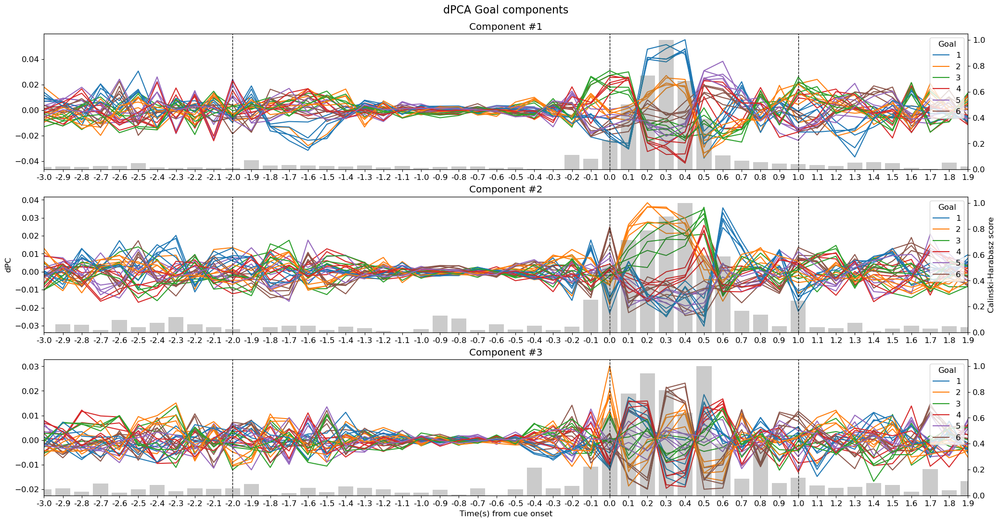

In [768]:
fig, axes = plt.subplots(3, 1, figsize=(24, 12))
plt.subplots_adjust(0.1, 0.1, 0.9, 0.9, wspace=0.1, hspace=0.2)
plt.suptitle('dPCA Goal components', y=0.95, fontsize=16)
axes2 = np.empty_like(axes)
for c, ax in enumerate(axes):
    axes2[c] = ax.twinx()

for c in range(3):
    axes[c].set_title(f'Component #{c+1}')
    for s in range(num_goals):
        for g in range(num_goals-1):
            gi = g + 1 if g >= s else g
            axes[c].plot(np.arange(num_sim_timebins), simulated_dpcspikerates_iti_cue_per_traj['g'][c,s,g], color=f'C{gi}', label=f'{gi+1}')
            axes2[c].bar(np.arange(num_sim_timebins), simulated_dpcspikerates_iti_cue_per_traj_vrc['g'][c], width=0.8, color='tab:grey', alpha=0.01)
    # for g in range(num_goals):
    #     for s in range(num_goals-1):
    #         axes[c].plot(np.arange(num_sim_timebins), simulated_dpcspikerates_iti_cue_per_traj['g'][c,g,s], color=f'C{g}', label=f'{g+1}')
    #         axes2[c].bar(np.arange(num_sim_timebins), simulated_dpcspikerates_iti_cue_per_traj_vrc['g'][c], width=0.8, color='tab:grey', alpha=0.01)
    
    axes[c].axvline(x=10, color='k', linewidth=1, linestyle='--')
    axes[c].axvline(x=30, color='k', linewidth=1, linestyle='--')
    axes[c].axvline(x=40, color='k', linewidth=1, linestyle='--')
    axes[c].set_xlim([0, num_sim_timebins-1])
    axes[c].set_xticks(np.arange(num_sim_timebins), labels=[f'{n:.1f}' for n in np.arange(-3, 2, 0.1)])
    axes[c].legend([Line2D([0],[0], color=f'C{g}') for g in range(num_goals)], [f'{g+1}' for g in range(num_goals)], title='Goal', loc='upper right')

axes[1].set_ylabel('dPC')
axes2[1].set_ylabel('Calinski-Harabasz score')
axes[-1].set_xlabel('Time(s) from cue onset')

Text(0.5, 0, 'Time(s) from cue onset')

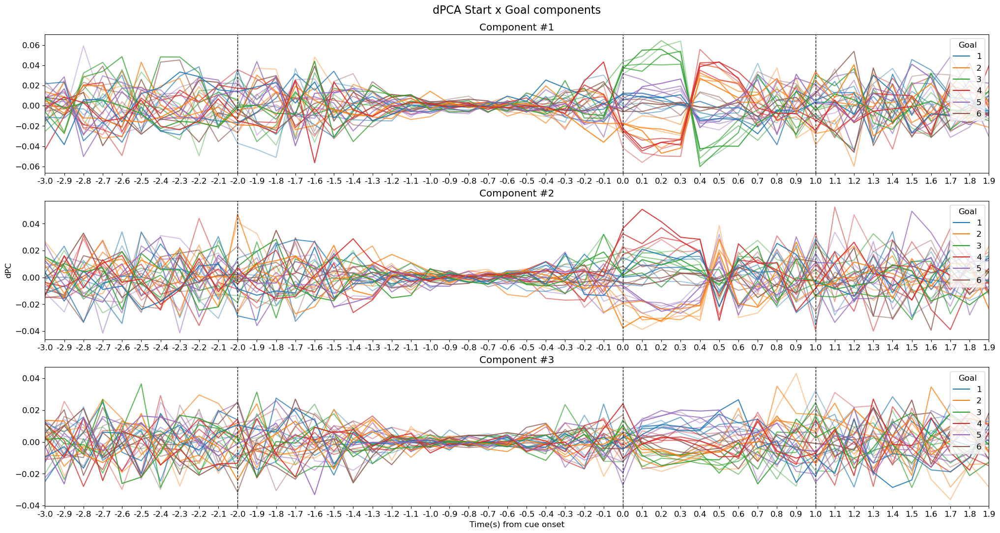

In [769]:
fig, axes = plt.subplots(3, 1, figsize=(24, 12))
plt.subplots_adjust(0.1, 0.1, 0.9, 0.9, wspace=0.1, hspace=0.2)
plt.suptitle('dPCA Start x Goal components', y=0.95, fontsize=16)
# axes2 = np.empty_like(axes)
# for c, ax in enumerate(axes):
#     axes2[c] = ax.twinx()

for c in range(3):
    axes[c].set_title(f'Component #{c+1}')
    for s in range(num_goals):
        for g in range(num_goals-1):
            gi = g + 1 if g >= s else g
            si = s - 1 if s > gi else s
            axes[c].plot(np.arange(num_sim_timebins), simulated_dpcspikerates_iti_cue_per_traj['sg'][c,s,g], color=f'C{gi}', alpha=0.6*(si/5)+0.4, label=f'{gi+1}')
            # axes2[c].bar(np.arange(num_sim_timebins), simulated_dpcspikerates_iti_cue_per_traj_vrc['sg'][c], width=0.8, color='tab:grey', alpha=0.01)
    # for g in range(num_goals):
    #     for s in range(num_goals-1):
    #         si = s + 1 if s >= g else s
    #         gi = g - 1 if g > si else g
    #         axes[c].plot(np.arange(num_sim_timebins), simulated_dpcspikerates_iti_cue_per_traj['gs'][c,g,s], color=f'C{gi}', alpha=0.6*(si/5)+0.4, label=f'{gi+1}')

    axes[c].axvline(x=10, color='k', linewidth=1, linestyle='--')
    axes[c].axvline(x=30, color='k', linewidth=1, linestyle='--')
    axes[c].axvline(x=40, color='k', linewidth=1, linestyle='--')
    axes[c].set_xlim([0, num_sim_timebins-1])
    axes[c].set_xticks(np.arange(num_sim_timebins), labels=[f'{n:.1f}' for n in np.arange(-3, 2, 0.1)])
    axes[c].legend([Line2D([0],[0], color=f'C{g}') for g in range(num_goals)], [f'{g+1}' for g in range(num_goals)], title='Goal', loc='upper right')

axes[1].set_ylabel('dPC')
# axes2[1].set_ylabel('Calinski-Harabasz score')
axes[-1].set_xlabel('Time(s) from cue onset')

In [ ]:
fig, axes = plt.subplots(3, 1, figsize=(24, 12))
plt.subplots_adjust(0.1, 0.1, 0.9, 0.9, wspace=0.1, hspace=0.2)
plt.suptitle('dPCA Components', y=0.95, fontsize=16)
axes2 = np.empty_like(axes)
for c, ax in enumerate(axes):
    axes2[c] = ax.twinx()

components = ['s', 'g', 'sg']
component_labels = ['Start', 'Goal', 'Start x Goal']

for s in range(num_goals):
        for g in range(num_goals-1):
            gi = g + 1 if g >= s else g
            si = s - 1 if s > gi else s
            axes[0].plot(np.arange(num_sim_timebins), simulated_dpcspikerates_iti_cue_per_traj['s'][0,s,g], color=f'C{s}', label=f'{s+1}')
            axes[1].plot(np.arange(num_sim_timebins), simulated_dpcspikerates_iti_cue_per_traj['g'][0,s,g], color=f'C{gi}', label=f'{gi+1}')
            axes[2].plot(np.arange(num_sim_timebins), simulated_dpcspikerates_iti_cue_per_traj['sg'][0,s,g], color=f'C{gi}', alpha=0.6*(si/5)+0.4, label=f'{gi+1}')
            axes2[0].bar(np.arange(num_sim_timebins), simulated_dpcspikerates_iti_cue_per_traj_vrc['s'][0], width=0.8, color='tab:grey', alpha=0.01)
            axes2[1].bar(np.arange(num_sim_timebins), simulated_dpcspikerates_iti_cue_per_traj_vrc['g'][0], width=0.8, color='tab:grey', alpha=0.01)
            axes2[2].bar(np.arange(num_sim_timebins), simulated_dpcspikerates_iti_cue_per_traj_vrc['sg'][0], width=0.8, color='tab:grey', alpha=0.01)

for c in range(3):
    axes[c].set_title(f'{component_labels[c]} component #1')
    axes[c].axvline(x=10, color='k', linewidth=1, linestyle='--')
    axes[c].axvline(x=30, color='k', linewidth=1, linestyle='--')
    axes[c].axvline(x=40, color='k', linewidth=1, linestyle='--')
    axes[c].set_xlim([0, num_sim_timebins-1])
    axes[c].set_xticks(np.arange(num_sim_timebins), labels=[f'{n:.1f}' for n in np.arange(-3, 2, 0.1)])
    axes[c].legend([Line2D([0],[0], color=f'C{s}') for s in range(num_goals)], [f'{s+1}' for s in range(num_goals)], title=component_labels[c][-5:], loc='upper right')

axes[1].set_ylabel('dPC')
axes2[1].set_ylabel('Calinski-Harabasz score')
axes[-1].set_xlabel('Time(s) from cue onset')

Try running LDA decoding on simulated dataset

In [770]:
# Assemble simulated session data
num_sim_trials_sess = num_sim_trials * num_goals * (num_goals - 1)
combined_dpc_traj_labels = np.stack([combined_dpc_start_labels, combined_dpc_goal_labels], axis=-1)
simulated_spikerates_iti_cue = np.empty((num_sim_trials_sess, num_sim_timebins, num_sim_cells))
simulated_trajectories_iti_cue = np.empty((num_sim_trials_sess, 2))

trial = 0
for n in range(num_sim_trials):
    for s in range(num_goals):
        for g in range(num_goals-1):
            simulated_spikerates_iti_cue[trial,:,:] = simulated_spikerates_iti_cue_per_traj_trials[n,:,s,g,:].T
            simulated_trajectories_iti_cue[trial] = combined_dpc_traj_labels[s,g,:].astype(int) + 1
            trial += 1

# Shuffle order of trials in simulated session data
np.random.seed(0)
shuffle_index = np.random.permutation(simulated_spikerates_iti_cue.shape[0])
simulated_spikerates_iti_cue = simulated_spikerates_iti_cue[shuffle_index]
simulated_trajectories_iti_cue = simulated_trajectories_iti_cue[shuffle_index,:]

In [771]:
# Performance accuracy of LDA model across individual 100ms time windows of cue phase population responses
k_fold = 10
lda_goal_accuracy_iti_cue_sim = np.zeros((num_sim_timebins, k_fold))
lda_goal_confusion_iti_cue_sim = np.zeros((num_sim_timebins, num_goals, num_goals))
lda_start_accuracy_iti_cue_sim = np.zeros((num_sim_timebins, k_fold))
lda_start_confusion_iti_cue_sim = np.zeros((num_sim_timebins, num_goals, num_goals))
lda_traj_accuracy_iti_cue_sim = np.zeros((num_sim_timebins, k_fold))
lda_traj_confusion_iti_cue_sim = np.zeros((num_sim_timebins, len(trajectories), len(trajectories)))
simulated_traj_idxs_iti_cue = np.array(list(map(lambda x: trajectory_indexing[tuple(x)], simulated_trajectories_iti_cue)))

for k in range(num_sim_timebins):
    for i in range(k_fold):
        # Goal
        X_train, X_test, y_train, y_test = train_test_split(simulated_spikerates_iti_cue[:,k,:], simulated_trajectories_iti_cue[:,1], (i, k_fold))
        lda = LinearDiscriminantAnalysis()
        lda.fit(X_train, y_train)
        y_pred = lda.predict(X_test)
        lda_goal_accuracy_iti_cue_sim[k,i] = prediction_accuracy(y_pred, y_test)
        lda_goal_confusion_iti_cue_sim[k,:,:] += confusion_matrix(y_pred, y_test, num_goals)

        # Start
        X_train, X_test, y_train, y_test = train_test_split(simulated_spikerates_iti_cue[:,k,:], simulated_trajectories_iti_cue[:,0], (i, k_fold))
        lda = LinearDiscriminantAnalysis()
        lda.fit(X_train, y_train)
        y_pred = lda.predict(X_test)
        lda_start_accuracy_iti_cue_sim[k,i] = prediction_accuracy(y_pred, y_test)
        lda_start_confusion_iti_cue_sim[k,:,:] += confusion_matrix(y_pred, y_test, num_goals)

        # Trajectory
        X_train, X_test, y_train, y_test = train_test_split(simulated_spikerates_iti_cue[:,k,:], simulated_traj_idxs_iti_cue, (i, k_fold))
        lda = LinearDiscriminantAnalysis()
        lda.fit(X_train, y_train)
        y_pred = lda.predict(X_test)
        lda_traj_accuracy_iti_cue_sim[k,i] = prediction_accuracy(y_pred, y_test)
        lda_traj_confusion_iti_cue_sim[k,:,:] += confusion_matrix(y_pred+1, y_test+1, len(trajectories))

In [772]:
# Significance testing for decoding performance
lda_goal_sigtest_iti_cue_sim = np.empty((num_sim_timebins, 2))
lda_start_sigtest_iti_cue_sim = np.empty((num_sim_timebins, 2))
lda_traj_sigtest_iti_cue_sim = np.empty((num_sim_timebins, 2))
chance_lvl = 1/6

for t in range(num_timebins_ext):
    ## Using (non-parametric) mann-whitney u-tests
    # Goal perf above chance
    u_stat, p_val = mannwhitneyu(lda_goal_accuracy_iti_cue_sim[t,:], k_fold*[chance_lvl], alternative='greater')
    lda_goal_sigtest_iti_cue_sim[t,:] = np.array([u_stat, p_val])
    # Start perf above chance
    u_stat, p_val = mannwhitneyu(lda_start_accuracy_iti_cue_sim[t,:], k_fold*[chance_lvl], alternative='greater')
    lda_start_sigtest_iti_cue_sim[t,:] = np.array([u_stat, p_val])
    # Traj perf above chance
    u_stat, p_val = mannwhitneyu(lda_traj_accuracy_iti_cue_sim[t,:], k_fold*[chance_lvl/5], alternative='greater')
    lda_traj_sigtest_iti_cue_sim[t,:] = np.array([u_stat, p_val])
sig_lvl = 0.05

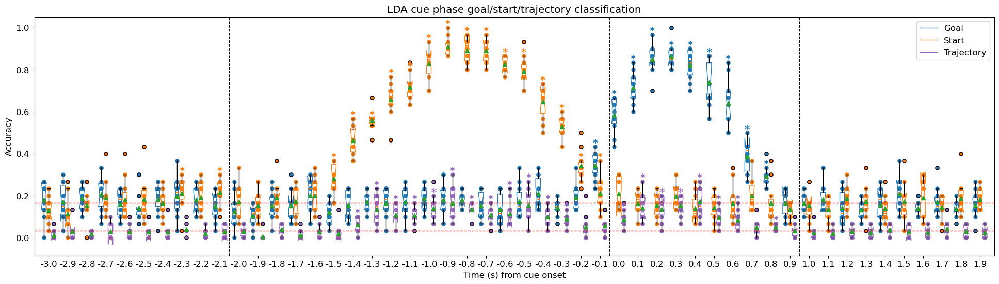

In [773]:
plt.figure(figsize=(24, 6))
plt.title(f'LDA cue phase goal/start/trajectory classification')

# Plot as series of boxplots
bar_width = 0.25
bp1 = plt.boxplot(lda_goal_accuracy_iti_cue_sim.T, positions=np.arange(1, num_sim_timebins+1)-bar_width, widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C0'}, flierprops={'marker': 'o', 'markersize': 5})
bp2 = plt.boxplot(lda_start_accuracy_iti_cue_sim.T, positions=np.arange(1, num_sim_timebins+1), widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C1'}, flierprops={'marker': 'o', 'markersize': 5})
bp3 = plt.boxplot(lda_traj_accuracy_iti_cue_sim.T, positions=np.arange(1, num_sim_timebins+1)+bar_width, widths=bar_width, showmeans=True, notch=True, boxprops={'color': 'C4'}, flierprops={'marker': 'o', 'markersize': 5})
topcaps1 = [cap.get_ydata()[0] for i, cap in enumerate(bp1['caps']) if i%2==1]
topcaps2 = [cap.get_ydata()[0] for i, cap in enumerate(bp2['caps']) if i%2==1]
topcaps3 = [cap.get_ydata()[0] for i, cap in enumerate(bp3['caps']) if i%2==1]
for k in range(num_sim_timebins):
    plt.scatter(np.ones_like(lda_goal_accuracy_iti_cue_sim[k,:]) + k - bar_width, lda_goal_accuracy_iti_cue_sim[k,:], s=25, color='C0')
    p_val = lda_goal_sigtest_iti_cue_sim[k,1]
    if p_val < sig_lvl:
        plt.annotate('*', xy=(k+1-bar_width/2, topcaps1[k]+0.005), xytext=(k+1-bar_width, topcaps1[k]+0.005), horizontalalignment='center', fontsize=14, fontweight='bold', color='C0')
    plt.scatter(np.ones_like(lda_start_accuracy_iti_cue_sim[k,:]) + k, lda_start_accuracy_iti_cue_sim[k,:], s=25, color='C1')
    p_val = lda_start_sigtest_iti_cue_sim[k,1]
    if p_val < sig_lvl:
        plt.annotate('*', xy=(k+1+bar_width/2, topcaps2[k]+0.005), xytext=(k+1, topcaps2[k]+0.005), horizontalalignment='center', fontsize=14, fontweight='bold', color='C1')
    plt.scatter(np.ones_like(lda_traj_accuracy_iti_cue_sim[k,:]) + k + bar_width, lda_traj_accuracy_iti_cue_sim[k,:], s=25, color='C4')
    p_val = lda_traj_sigtest_iti_cue_sim[k,1]
    if p_val < sig_lvl:
        plt.annotate('*', xy=(k+1+bar_width/2, topcaps3[k]+0.005), xytext=(k+1+bar_width, topcaps3[k]+0.005), horizontalalignment='center', fontsize=14, fontweight='bold', color='C4')

plt.axhline(y=1/6, color='r', linewidth=1, linestyle='--')
plt.axhline(y=1/30, color='r', linewidth=1, linestyle='--')
plt.axvline(x=10.5, color='k', linewidth=1, linestyle='--')
plt.axvline(x=30.5, color='k', linewidth=1, linestyle='--')
plt.axvline(x=40.5, color='k', linewidth=1, linestyle='--')
plt.xticks(np.arange(1, num_timebins_ext+1), labels=[f'{n:.1f}' for n in np.concatenate([np.arange(-3, 0, 0.1), np.arange(0, 2, 0.1)])])
plt.xlabel('Time (s) from cue onset')
plt.ylabel('Accuracy')
plt.legend([bp1['boxes'][0], bp2['boxes'][0], bp3['boxes'][0]], ['Goal', 'Start', 'Trajectory'])

Try fitting multivariate linear regression to simulated dataset

In [779]:
def design_matrix(traj):
    # traj is num_trials x 2 array of (start, goal), start & goal are 1-indexed
    s, g = traj[:,0] / 6, traj[:,1] / 6
    dm = np.ones((traj.shape[0], 4))
    dm[:,1] = s
    dm[:,2] = g
    dm[:,3] = s * g
    return dm

# Order starts/goals for each cell according to firing rate preference
def ordered_labels(rates, trajs):
    # rates: trials x timebins shaped array of firing rates
    # trajs: trials x (start, goal) array of trajectory labels
    # keep start & goal 1-indexed
    rates_by_starts, rates_by_goals = {i+1: list() for i in range(num_goals)}, {i+1: list() for i in range(num_goals)}
    for i, (s, g) in enumerate(trajs):
        rates_by_starts[s].append(rates[i])
        rates_by_goals[g].append(rates[i])
    for key, value in rates_by_starts.items():
        rates_by_starts[key] = np.max(np.mean(np.stack(value), axis=0))
    rates_by_starts = np.array(list(rates_by_starts.values()))
    for key, value in rates_by_goals.items():
        rates_by_goals[key] = np.max(np.mean(np.stack(value), axis=0))
    rates_by_goals = np.array(list(rates_by_goals.values()))
    # return tuple of (ordered start labels, ordered goal labels)
    return np.argsort(rates_by_starts)+1, np.argsort(rates_by_goals)+1

In [780]:
# Normalize (z-score) firing rates within each cell
simulated_spikerates_iti_cue_zscored = (simulated_spikerates_iti_cue - np.mean(np.mean(simulated_spikerates_iti_cue, axis=0), axis=0)) / np.std(np.std(simulated_spikerates_iti_cue, axis=0), axis=0)

/var/folders/x9/1nq85w8s11l0sv1yqg3364200000h2/T/ipykernel_1815/3636790595.py:2: RuntimeWarning: invalid value encountered in true_divide
  simulated_spikerates_iti_cue_zscored = (simulated_spikerates_iti_cue - np.mean(np.mean(simulated_spikerates_iti_cue, axis=0), axis=0)) / np.std(np.std(simulated_spikerates_iti_cue, axis=0), axis=0)


In [781]:
# Fit multivar linear model to all data
# Array of start/goal label orderings for all cells, last axis indexing: (0) start, (1) goal
cell_ordered_labels = np.empty((num_sim_cells, num_goals, 2), dtype=int)
# Dimensions for list of model fits: cells x timebins
linear_glm_multivar_models_sim = list()
for cell in range(num_sim_cells):
    # Re-ordering start and goal labels
    start_order, goal_order = ordered_labels(simulated_spikerates_iti_cue_zscored[:,:,cell], simulated_trajectories_iti_cue)
    cell_ordered_labels[cell,:,0] = start_order
    cell_ordered_labels[cell,:,1] = goal_order
    start_order = {val: idx for idx, val in enumerate(start_order, start=1)}
    goal_order = {val: idx for idx, val in enumerate(goal_order, start=1)}
    simulated_trajectories_iti_cue_ordered = np.array([[start_order[s], goal_order[g]] for (s, g) in simulated_trajectories_iti_cue])
    # Generate design matrix and fit models for all timebins for this cell
    dm_cell = design_matrix(simulated_trajectories_iti_cue_ordered)
    cell_models = list()
    for timebin in range(num_sim_timebins):
        timebin_model = sm.OLS(simulated_spikerates_iti_cue_zscored[:,timebin,cell], dm_cell).fit()
        cell_models.append(timebin_model)
    linear_glm_multivar_models_sim.append(cell_models)

In [782]:
# Significance testing for fitted coefficients for all cells, all timebins
linear_multivar_glm_param_sigtest_sim = np.array([[model.pvalues for model in cell] for cell in linear_glm_multivar_models_sim])
linear_multivar_glm_param_sigtest_sim = linear_multivar_glm_param_sigtest_sim < sig_lvl / num_sim_timebins

# r-squared values for model fits for all cells, all timebins
linear_multivar_glm_rsquared_sim = np.array([[model.rsquared for model in cell] for cell in linear_glm_multivar_models_sim])
linear_multivar_glm_rsquared_sim = np.nan_to_num(linear_multivar_glm_rsquared_sim)

# Selectivity (by parameter test) for each cell across all timebins
def selectivity_type(arr):
    return arr[1] + arr[2] * 2 + arr[3] * 4
sim_cell_selectivity = np.array([[selectivity_type(timebin) for timebin in cell] for cell in linear_multivar_glm_param_sigtest_sim])
selectivity_labels = ['none', 's', 'g', 'sg', 't', 'st', 'gt', 'sgt']

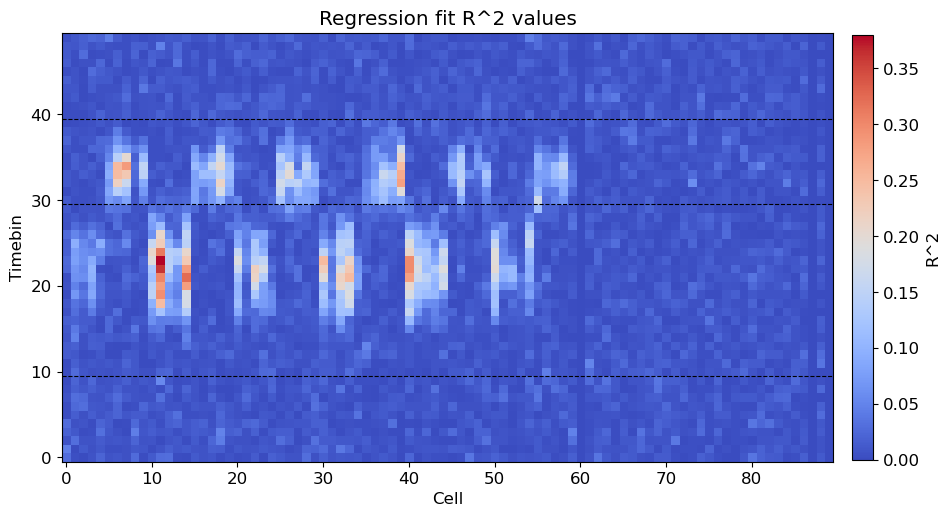

In [783]:
fig, ax = plt.subplots(figsize=(12, 6))
plt.title('Regression fit R^2 values')

im = ax.imshow(linear_multivar_glm_rsquared_sim.T, cmap='coolwarm', vmin=0, origin='lower')
plt.colorbar(im, ax=ax, label='R^2', shrink=0.92, pad=0.02)
ax.set_xlabel('Cell')
ax.set_ylabel('Timebin')

ax.axhline(y=9.5, linewidth=0.8, linestyle='--', color='k')
ax.axhline(y=29.5, linewidth=0.8, linestyle='--', color='k')
ax.axhline(y=39.5, linewidth=0.8, linestyle='--', color='k')

# rsquared_threshold = 0.25
# rsquared_good_samples = np.array(np.where(linear_multivar_glm_rsquared_sim > rsquared_threshold)).T
# for i, j in rsquared_good_samples:
#     ax.add_patch(Rectangle((i-0.5, j-0.5), 1, 1, linewidth=0.8, linestyle='-', edgecolor='k', facecolor='none'))
# ax.axhline(y=9.5, linewidth=0.8, linestyle='--', color='k')
# ax.axhline(y=29.5, linewidth=0.8, linestyle='--', color='k')
# ax.axhline(y=39.5, linewidth=0.8, linestyle='--', color='k')

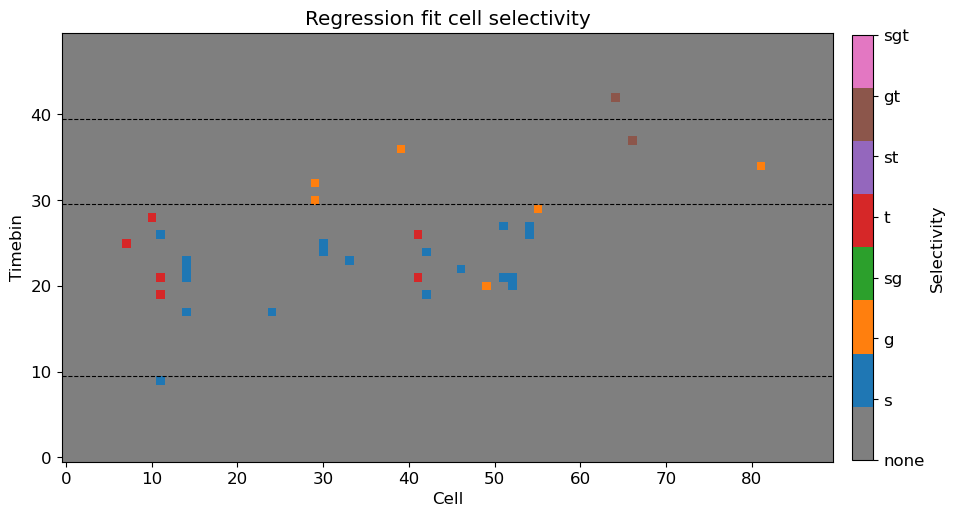

In [784]:
fig, ax = plt.subplots(figsize=(12, 6))
plt.title('Regression fit cell selectivity')

custom_cmap = ListedColormap(['tab:grey', 'tab:blue', 'tab:orange', 'tab:green', 'tab:red', 'tab:purple', 'tab:brown', 'tab:pink'])
im = ax.imshow(sim_cell_selectivity.T, cmap=custom_cmap, origin='lower', vmin=0, vmax=7)
cbar = plt.colorbar(im, ax=ax, label='Selectivity', shrink=0.92, pad=0.02)
cbar.set_ticks(np.arange(8), labels=selectivity_labels)
ax.set_xlabel('Cell')
ax.set_ylabel('Timebin')

ax.axhline(y=9.5, linewidth=0.8, linestyle='--', color='k')
ax.axhline(y=29.5, linewidth=0.8, linestyle='--', color='k')
ax.axhline(y=39.5, linewidth=0.8, linestyle='--', color='k')

In [559]:
# Plot regression fit against data points for each cell and timebin
for cell in range(num_sim_cells):
    def regression_eqn(s, g, frame):
        # s and g are 1-indexed start and goal respectively
        params = linear_glm_multivar_models_sim[cell][frame].params
        s = s / 6
        g = g / 6
        return params[0] + params[1] * s + params[2] * g + params[3] * s * g

    frame = 0
    fig = plt.figure(figsize=(16, 12))
    ax = fig.add_subplot(1, 1, 1, projection='3d')
    ax.set_title(f'Regression fit for simulated cell #{cell} | t = {0.1 * frame - 3:.1f}s', x=0.52, y=0.94)

    x_axis, y_axis = np.meshgrid(np.linspace(1, 6, 6), np.linspace(1, 6, 6))
    model_pred = np.zeros((num_goals, num_goals, num_sim_timebins))
    for t in range(num_sim_timebins):
        for i in range(num_goals):
            for j in range(num_goals):
                model_pred[i,j,t] = regression_eqn(x_axis[i,j], y_axis[i,j], t)
    surf = ax.plot_surface(x_axis, y_axis, model_pred[:,:,frame], alpha=0.8, color='tab:blue')

    start_order = {val: idx for idx, val in enumerate(cell_ordered_labels[cell,:,0], start=1)}
    goal_order = {val: idx for idx, val in enumerate(cell_ordered_labels[cell,:,1], start=1)}
    simulated_trajectories_iti_cue_ordered = np.array([[start_order[s], goal_order[g]] for (s, g) in simulated_trajectories_iti_cue])
    sc = ax.scatter(simulated_trajectories_iti_cue_ordered[:,0], simulated_trajectories_iti_cue_ordered[:,1], simulated_spikerates_iti_cue_zscored[:,frame,cell], color='C3')

    ax.view_init(elev=15, azim=-55)
    ax.set_xlabel('Start')
    ax.set_ylabel('Goal')
    ax.set_zlabel('z-scored FR')
    ax.set_xticks(np.arange(1, num_goals+1), labels=cell_ordered_labels[cell,:,0])
    ax.set_yticks(np.arange(1, num_goals+1), labels=cell_ordered_labels[cell,:,1])
    ax_lims = [min([np.round(np.percentile(simulated_spikerates_iti_cue_zscored[:,frame,cell].flatten(), 1), 1) for frame in range(num_sim_timebins)]),\
                max([np.round(np.percentile(simulated_spikerates_iti_cue_zscored[:,frame,cell].flatten(), 99), 1) for frame in range(num_sim_timebins)])]
    if ax_lims[0] < ax_lims[1]:
        ax_lims[0], ax_lims[1] = ax_lims[0] - 0.05 * (ax_lims[1] - ax_lims[0]), ax_lims[1] + 0.05 * (ax_lims[1] - ax_lims[0])
        ax.set_zlim(ax_lims)
    else:
        ax_lims = ax.get_zlim()
    txt = ax.text(6, 6, 1.15*(ax_lims[1]-ax_lims[0])+ax_lims[0], f'sel: {selectivity_labels[sim_cell_selectivity[cell,frame]]}\nr_sq: {linear_multivar_glm_rsquared_sim[cell,frame]:.3f}')

    def update(frame):
        sc._offsets3d = (simulated_trajectories_iti_cue_ordered[:,0], simulated_trajectories_iti_cue_ordered[:,1], simulated_spikerates_iti_cue_zscored[:,frame,cell])
        global surf
        surf.remove()
        surf = ax.plot_surface(x_axis, y_axis, model_pred[:,:,frame], alpha=0.8, color='tab:blue')
        ax.set_title(f'Regression fit for simulated cell #{cell} | t = {0.1 * frame - 3:.1f}s', x=0.5, y=0.94)
        txt.set_text(f'sel: {selectivity_labels[sim_cell_selectivity[cell,frame]]}\nr_sq: {linear_multivar_glm_rsquared_sim[cell,frame]:.3f}')

    ani = FuncAnimation(fig, update, frames=num_sim_timebins, interval=1000, blit=False, repeat=True)
    HTML(ani.to_html5_video())

    if to_save:
        if not os.path.exists(figsave_dir):
            os.makedirs(figsave_dir)
        ani.save(f'{figsave_dir}/sim_cells/mlr_fits/mlr_fit_cell{cell}.mp4', writer='ffmpeg')
    plt.close()

Try fitting multivariate poisson regression to simulated dataset

In [379]:
def design_matrix(traj):
    # traj is num_trials x 2 array of (start, goal), start & goal are 1-indexed
    s, g = traj[:,0] / 6, traj[:,1] / 6
    dm = np.ones((traj.shape[0], 3))
    dm[:,0] = s
    dm[:,1] = g
    dm[:,2] = s * g
    return dm

# Order starts/goals for each cell according to firing rate preference
def ordered_labels(rates, trajs):
    # rates: trials x timebins shaped array of firing rates
    # trajs: trials x (start, goal) array of trajectory labels
    # keep start & goal 1-indexed
    rates_by_starts, rates_by_goals = {i+1: list() for i in range(num_goals)}, {i+1: list() for i in range(num_goals)}
    for i, (s, g) in enumerate(trajs):
        rates_by_starts[s].append(rates[i])
        rates_by_goals[g].append(rates[i])
    for key, value in rates_by_starts.items():
        rates_by_starts[key] = np.max(np.mean(np.stack(value), axis=0))
    rates_by_starts = np.array(list(rates_by_starts.values()))
    for key, value in rates_by_goals.items():
        rates_by_goals[key] = np.max(np.mean(np.stack(value), axis=0))
    rates_by_goals = np.array(list(rates_by_goals.values()))
    # return tuple of (ordered start labels, ordered goal labels)
    return np.argsort(rates_by_starts)+1, np.argsort(rates_by_goals)+1

In [380]:
# Normalize (z-score) firing rates within each cell, and offset by min value in each cell to ensure non-negativity
simulated_spikerates_iti_cue_zscored_offset = simulated_spikerates_iti_cue_zscored - np.min(np.min(simulated_spikerates_iti_cue_zscored, axis=0), axis=0)

In [381]:
# Fit multivar linear model to all data
# Array of start/goal label orderings for all cells, last axis indexing: (0) start, (1) goal
cell_ordered_labels = np.empty((num_sim_cells, num_goals, 2), dtype=int)
# Dimensions for list of model fits: cells x timebins
poisson_glm_multivar_models_sim = list()
for cell in range(num_sim_cells):
    # Re-ordering start and goal labels
    start_order, goal_order = ordered_labels(simulated_spikerates_iti_cue_zscored_offset[:,:,cell], simulated_trajectories_iti_cue)
    cell_ordered_labels[cell,:,0] = start_order
    cell_ordered_labels[cell,:,1] = goal_order
    start_order = {val: idx for idx, val in enumerate(start_order, start=1)}
    goal_order = {val: idx for idx, val in enumerate(goal_order, start=1)}
    simulated_trajectories_iti_cue_ordered = np.array([[start_order[s], goal_order[g]] for (s, g) in simulated_trajectories_iti_cue])
    # Generate design matrix and fit models for all timebins for this cell
    dm_cell = design_matrix(simulated_trajectories_iti_cue_ordered)
    cell_models = list()
    for timebin in range(num_sim_timebins):
        timebin_model = sm.GLM(simulated_spikerates_iti_cue_zscored_offset[:,timebin,cell], dm_cell, family=sm.families.Poisson()).fit()
        cell_models.append(timebin_model)
    poisson_glm_multivar_models_sim.append(cell_models)

In [382]:
# Significance testing for fitted coefficients for all cells, all timebins
poisson_multivar_glm_param_sigtest_sim = np.array([[model.pvalues for model in cell] for cell in poisson_glm_multivar_models_sim])
poisson_multivar_glm_param_sigtest_sim = poisson_multivar_glm_param_sigtest_sim < sig_lvl / num_sim_timebins

# Pseudo r-squared values for model fits for all cells, all timebins
poisson_multivar_glm_prsquared_sim = np.array([[model.pseudo_rsquared() for model in cell] for cell in poisson_glm_multivar_models_sim])
poisson_multivar_glm_prsquared_sim = np.nan_to_num(poisson_multivar_glm_prsquared_sim)

# Selectivity (by parameter test) for each cell across all timebins
def selectivity_type(arr):
    return arr[0] + arr[1] * 2 + arr[2] * 4
sim_cell_selectivity = np.array([[selectivity_type(timebin) for timebin in cell] for cell in poisson_multivar_glm_param_sigtest_sim])
selectivity_labels = ['none', 's', 'g', 'sg', 't', 'st', 'gt', 'sgt']

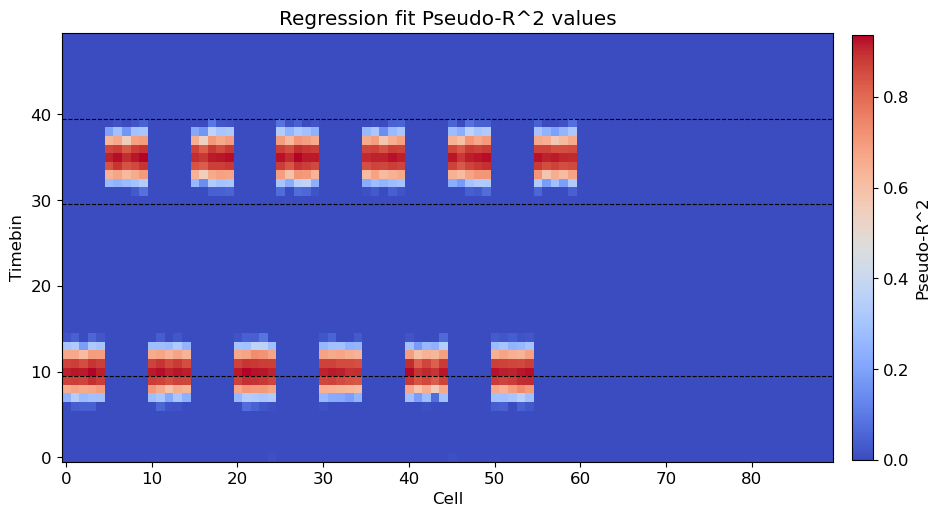

In [385]:
fig, ax = plt.subplots(figsize=(12, 6))
plt.title('Regression fit Pseudo-R^2 values')

im = ax.imshow(poisson_multivar_glm_prsquared_sim.T, cmap='coolwarm', vmin=0, origin='lower')
plt.colorbar(im, ax=ax, label='Pseudo-R^2', shrink=0.92, pad=0.02)
ax.set_xlabel('Cell')
ax.set_ylabel('Timebin')

ax.axhline(y=9.5, linewidth=0.8, linestyle='--', color='k')
ax.axhline(y=29.5, linewidth=0.8, linestyle='--', color='k')
ax.axhline(y=39.5, linewidth=0.8, linestyle='--', color='k')

# rsquared_threshold = 0.25
# rsquared_good_samples = np.array(np.where(linear_multivar_glm_rsquared_sim > rsquared_threshold)).T
# for i, j in rsquared_good_samples:
#     ax.add_patch(Rectangle((i-0.5, j-0.5), 1, 1, linewidth=0.8, linestyle='-', edgecolor='k', facecolor='none'))
# ax.axhline(y=9.5, linewidth=0.8, linestyle='--', color='k')
# ax.axhline(y=29.5, linewidth=0.8, linestyle='--', color='k')
# ax.axhline(y=39.5, linewidth=0.8, linestyle='--', color='k')

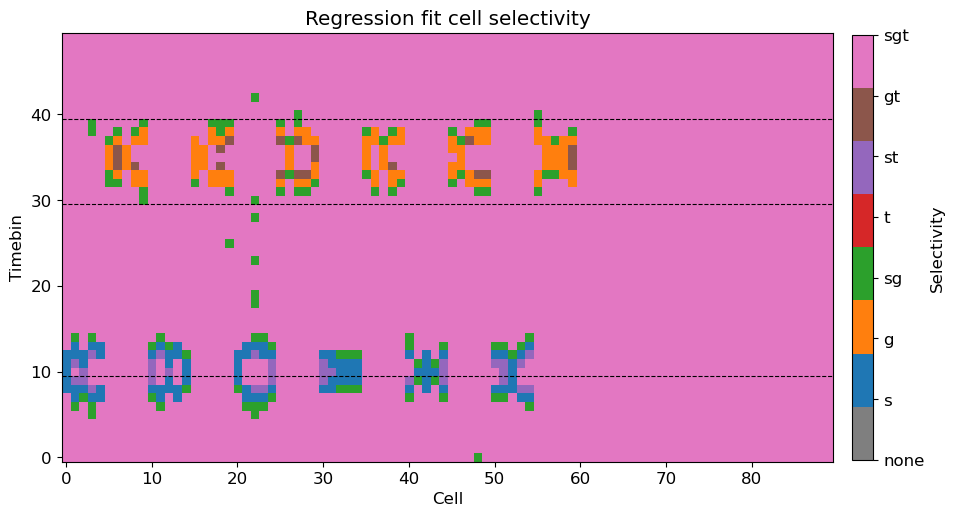

In [386]:
fig, ax = plt.subplots(figsize=(12, 6))
plt.title('Regression fit cell selectivity')

custom_cmap = ListedColormap(['tab:grey', 'tab:blue', 'tab:orange', 'tab:green', 'tab:red', 'tab:purple', 'tab:brown', 'tab:pink'])
im = ax.imshow(sim_cell_selectivity.T, cmap=custom_cmap, origin='lower', vmin=0, vmax=7)
cbar = plt.colorbar(im, ax=ax, label='Selectivity', shrink=0.92, pad=0.02)
cbar.set_ticks(np.arange(8), labels=selectivity_labels)
ax.set_xlabel('Cell')
ax.set_ylabel('Timebin')

ax.axhline(y=9.5, linewidth=0.8, linestyle='--', color='k')
ax.axhline(y=29.5, linewidth=0.8, linestyle='--', color='k')
ax.axhline(y=39.5, linewidth=0.8, linestyle='--', color='k')

In [388]:
# Plot regression fit against data points for each cell and timebin
for cell in range(num_sim_cells):
    def regression_eqn(s, g, frame):
        # s and g are 1-indexed start and goal respectively
        params = poisson_glm_multivar_models_sim[cell][frame].params
        s = s / 6
        g = g / 6
        return np.exp(params[0] * s + params[1] * g + params[2] * s * g)

    frame = 0
    fig = plt.figure(figsize=(16, 12))
    ax = fig.add_subplot(1, 1, 1, projection='3d')
    ax.set_title(f'Regression fit for simulated cell #{cell} | t = {0.1 * frame - 3:.1f}s', x=0.52, y=0.94)

    x_axis, y_axis = np.meshgrid(np.linspace(1, 6, 6), np.linspace(1, 6, 6))
    model_pred = np.zeros((num_goals, num_goals, num_sim_timebins))
    for t in range(num_sim_timebins):
        for i in range(num_goals):
            for j in range(num_goals):
                model_pred[i,j,t] = regression_eqn(x_axis[i,j], y_axis[i,j], t)
    surf = ax.plot_surface(x_axis, y_axis, model_pred[:,:,frame], alpha=0.8, color='tab:blue')

    start_order = {val: idx for idx, val in enumerate(cell_ordered_labels[cell,:,0], start=1)}
    goal_order = {val: idx for idx, val in enumerate(cell_ordered_labels[cell,:,1], start=1)}
    simulated_trajectories_iti_cue_ordered = np.array([[start_order[s], goal_order[g]] for (s, g) in simulated_trajectories_iti_cue])
    sc = ax.scatter(simulated_trajectories_iti_cue_ordered[:,0], simulated_trajectories_iti_cue_ordered[:,1], simulated_spikerates_iti_cue_zscored_offset[:,frame,cell], color='C3')

    ax.view_init(elev=15, azim=-55)
    ax.set_xlabel('Start')
    ax.set_ylabel('Goal')
    ax.set_zlabel('z-scored FR')
    ax.set_xticks(np.arange(1, num_goals+1), labels=cell_ordered_labels[cell,:,0])
    ax.set_yticks(np.arange(1, num_goals+1), labels=cell_ordered_labels[cell,:,1])
    # ax_lims = [min([np.round(np.percentile(simulated_spikerates_iti_cue_zscored_offset[:,frame,cell].flatten(), 1), 1) for frame in range(num_sim_timebins)]),\
    #             max([np.round(np.percentile(simulated_spikerates_iti_cue_zscored_offset[:,frame,cell].flatten(), 99), 1) for frame in range(num_sim_timebins)])]
    ax_lims = [min(min([np.round(np.percentile(simulated_spikerates_iti_cue_zscored_offset[:,frame,cell].flatten(), 0), 1) for frame in range(num_sim_timebins)]),\
            min([np.round(np.min(model_pred[:,:,frame].flatten()), 1) for frame in range(num_sim_timebins)])),\
            max(max([np.round(np.percentile(simulated_spikerates_iti_cue_zscored_offset[:,frame,cell].flatten(), 100), 1) for frame in range(num_sim_timebins)]),\
            max([np.round(np.max(model_pred[:,:,frame].flatten()), 1) for frame in range(num_sim_timebins)]))]
    if ax_lims[0] < ax_lims[1]:
        ax_lims[0], ax_lims[1] = ax_lims[0] - 0.05 * (ax_lims[1] - ax_lims[0]), ax_lims[1] + 0.05 * (ax_lims[1] - ax_lims[0])
        ax.set_zlim(ax_lims)
    else:
        ax_lims = ax.get_zlim()
    txt = ax.text(6, 6, 1.15*(ax_lims[1]-ax_lims[0])+ax_lims[0], f'sel: {selectivity_labels[sim_cell_selectivity[cell,frame]]}\nr_sq: {poisson_multivar_glm_prsquared_sim[cell,frame]:.3f}')

    def update(frame):
        sc._offsets3d = (simulated_trajectories_iti_cue_ordered[:,0], simulated_trajectories_iti_cue_ordered[:,1], simulated_spikerates_iti_cue_zscored_offset[:,frame,cell])
        global surf
        surf.remove()
        surf = ax.plot_surface(x_axis, y_axis, model_pred[:,:,frame], alpha=0.8, color='tab:blue')
        ax.set_title(f'Regression fit for simulated cell #{cell} | t = {0.1 * frame - 3:.1f}s', x=0.5, y=0.94)
        txt.set_text(f'sel: {selectivity_labels[sim_cell_selectivity[cell,frame]]}\nr_sq: {poisson_multivar_glm_prsquared_sim[cell,frame]:.3f}')

    ani = FuncAnimation(fig, update, frames=num_sim_timebins, interval=1000, blit=False, repeat=True)
    HTML(ani.to_html5_video())

    if to_save:
        if not os.path.exists(figsave_dir):
            os.makedirs(figsave_dir)
        ani.save(f'{figsave_dir}/sim_cells/mpr_fits/mpr_fit_cell{cell}.mp4', writer='ffmpeg')
    plt.close()

#### ISOMAP Response Trajectories

In [211]:
# Fit PCA to all trials in session
n_dims = 3
iso = Isomap(n_components=n_dims)
combined_isospikerates_cue = iso.fit_transform(np.vstack(combined_spikerates_cue))

# Regroup into trajectories for plotting
num_timebins = 10
combined_isospikerates_cue_per_traj = [[np.empty((0, num_timebins, n_dims)) for i in range(num_goals)] for j in range(num_goals)]
for k, (i, j) in enumerate(combined_trajectories_cue):
    i -= 1
    j -= 1
    combined_isospikerates_cue_per_traj[i][j] = np.concatenate([combined_isospikerates_cue_per_traj[i][j], combined_isospikerates_cue[num_timebins*k:num_timebins*(k+1),:].reshape(-1, num_timebins, n_dims)])

# # Fit PCA within each group of same starting/same ending goal
# n_dims = 3
# iso = Isomap(n_components=n_dims)
# combined_isospikerates_cue_start_goals, combined_isospikerates_cue_end_goals = list(), list()
# for i in range(num_goals):
#     iso_start_goals = iso.fit_transform(np.vstack(combined_spikerates_cue_start_goals[i]))
#     iso_end_goals = iso.fit_transform(np.vstack(combined_spikerates_cue_end_goals[i]))
#     combined_isospikerates_cue_start_goals.append(np.array([iso_start_goals[10*j:10*(j+1),:] for j in range(iso_start_goals.shape[0]//10)]))
#     combined_isospikerates_cue_end_goals.append(np.array([iso_end_goals[10*j:10*(j+1),:] for j in range(iso_end_goals.shape[0]//10)]))

# # Regroup into trajectories for plotting
# combined_isospikerates_cue_per_traj = [[np.empty((0, 10, 3)) for i in range(num_goals)] for j in range(num_goals)]
# for i in range(num_goals):
#     for j, data in enumerate(combined_isospikerates_cue_start_goals[i]):
#         data = data.reshape(-1, 10, n_dims)
#         if n_dims < 3:
#             data = np.concatenate([data, np.zeros((data.shape[0], data.shape[1], 3-n_dims))], axis=2)
#         k = combined_start_goals_labels[i][j] - 1
#         combined_isospikerates_cue_per_traj[i][k] = np.concatenate([combined_isospikerates_cue_per_traj[i][k], data], axis=0)

# Plot the average response per trajectory
combined_isospikerates_cue_per_traj_avg = [[np.empty((0, 10, 3)) for i in range(num_goals)] for j in range(num_goals)]
for i in range(num_goals):
    for j, data in enumerate(combined_isospikerates_cue_per_traj[i]):
        if i == j:
            continue
        data = np.mean(data, axis=0).reshape(-1, 10, 3)
        combined_isospikerates_cue_per_traj_avg[i][j] = np.concatenate([combined_isospikerates_cue_per_traj_avg[i][j], data], axis=0)

# Subtract the first frame from all subsequent frames to get the displacement from start
combined_isospikerates_cue_per_traj_ref = [[combined_isospikerates_cue_per_traj_avg[i][j][:,0,:] for j in range(num_goals)] for i in range(num_goals)]
combined_isospikerates_cue_per_traj_start = [[combined_isospikerates_cue_per_traj_avg[i][j].copy() for j in range(num_goals)] for i in range(num_goals)]
for i in range(num_goals):
    for j in range(num_goals):
        if i == j:
            continue
        combined_isospikerates_cue_per_traj_start[i][j] -= combined_isospikerates_cue_per_traj_ref[i][j]

# Subtract the last frame from all previous frames to get the displacement from end
combined_isospikerates_cue_per_traj_ref = [[combined_isospikerates_cue_per_traj_avg[i][j][:,-1,:] for j in range(num_goals)] for i in range(num_goals)]
combined_isospikerates_cue_per_traj_end = [[combined_isospikerates_cue_per_traj_avg[i][j].copy() for j in range(num_goals)] for i in range(num_goals)]
for i in range(num_goals):
    for j in range(num_goals):
        if i == j:
            continue
        combined_isospikerates_cue_per_traj_end[i][j] -= combined_isospikerates_cue_per_traj_ref[i][j]

# Calculate Frechet distances between each group
frechet = DiscreteFrechet(euclidean_distance)
combined_isospikerates_cue_per_traj_frechdist = [[dict(), dict()] for _ in range(num_goals)]
for i in range(num_goals):
    traj_pairs = list(range(num_goals))
    traj_pairs.remove(i)
    traj_pairs = list(combinations(traj_pairs, 2))
    for (j1, j2) in traj_pairs:
        combined_isospikerates_cue_per_traj_frechdist[i][0][(j1, j2)] = frechet.distance(combined_isospikerates_cue_per_traj_avg[i][j1][0,:,:], combined_isospikerates_cue_per_traj_avg[i][j2][0,:,:])
        combined_isospikerates_cue_per_traj_frechdist[i][1][(j1, j2)] = frechet.distance(combined_isospikerates_cue_per_traj_avg[j1][i][0,:,:], combined_isospikerates_cue_per_traj_avg[j2][i][0,:,:])

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


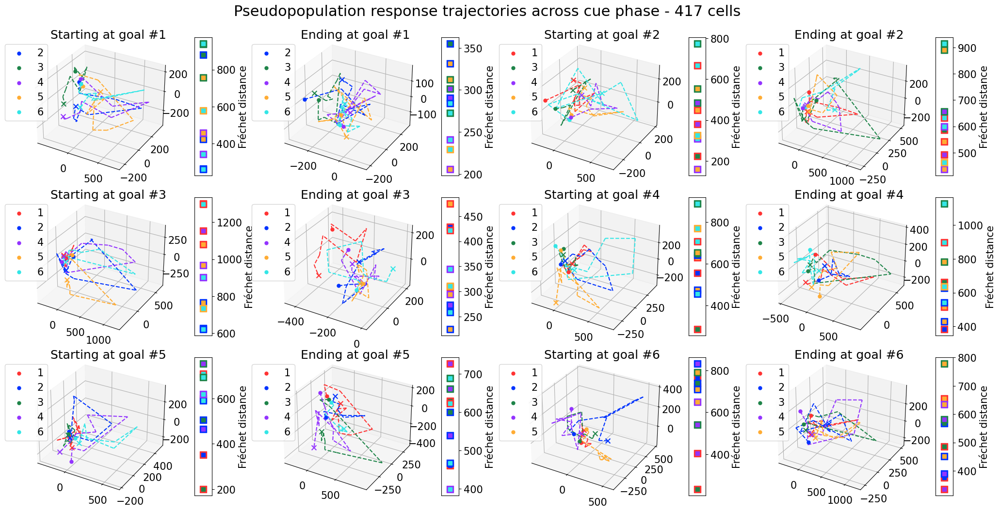

In [212]:
# Plots in ISOMAP space for cue responses between different trajectories, mean of each group of points
fig = plt.figure(figsize=(24, 12))
outer_gs = GridSpec(3, 4)
plt.rcParams['font.size'] = 15
plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1, wspace=0.3, hspace=0.1)
plt.suptitle(f'Pseudopopulation response trajectories across cue phase - {popl_name}', fontsize=22, y=0.95)
colours = ['#ff3333', '#0033ff', '#1e8449', '#9333ff', '#ffac33', '#33e6e6']

for i in range(num_goals):
    inner_gs = outer_gs[2*i].subgridspec(1, 2, wspace=0.2, width_ratios=[9, 1])
    ax1 = fig.add_subplot(inner_gs[0], projection='3d')
    ax1.set_title(f'Starting at goal #{i+1}', fontsize=18, x=0.56, y=1.02)
    for j, data in enumerate(combined_isospikerates_cue_per_traj_avg[i]):
        if data.shape[0] > 0:
            for k in range(data.shape[1]-1):
                ax1.plot(data[0,k:k+2,0], data[0,k:k+2,1], data[0,k:k+2,2], linestyle='--', linewidth=1.5, color=colours[j])
            ax1.scatter(data[0,0,0], data[0,0,1], data[0,0,2], marker='.', color=colours[j], s=100, label=j+1)
            ax1.scatter(data[0,-1,0], data[0,-1,1], data[0,-1,2], marker='x', color=colours[j], s=50)
    ax1.legend(loc=(-0.15, 0.4))

    ax2 = fig.add_subplot(inner_gs[1])
    ax2.set_box_aspect(8)
    for (a, b), val in combined_isospikerates_cue_per_traj_frechdist[i][0].items():
        ax2.scatter(0, val, marker='s', s=100, color=colours[a], linewidth=1)
        ax2.scatter(0, val, marker='s', s=40, color=colours[b], linewidth=1)
        #ax2.annotate(f'({a+1}, {b+1})', (0, val), textcoords="offset points", xytext=(-5, 5), ha='right', va='center', fontsize=10, rotation=15)
    ax2.set_xticks([])
    #ax2.set_xlim([-2,1])
    ax2.set_ylabel('Fréchet distance')
    ax2.yaxis.tick_right()
    ax2.yaxis.set_label_position("right")
    #ax2.yaxis.set_major_formatter(StrMethodFormatter('{x:,.0f}'))

    inner_gs = outer_gs[2*i+1].subgridspec(1, 2, wspace=0.2, width_ratios=[9, 1])
    ax1 = fig.add_subplot(inner_gs[0], projection='3d')
    ax1.set_title(f'Ending at goal #{i+1}', fontsize=18, x=0.56, y=1.02)
    for j in range(num_goals):
        data = combined_isospikerates_cue_per_traj_avg[j][i]
        if data.shape[0] > 0:
            for k in range(data.shape[1]-1):
                ax1.plot(data[0,k:k+2,0], data[0,k:k+2,1], data[0,k:k+2,2], linestyle='--', linewidth=1.5, color=colours[j])
            ax1.scatter(data[0,0,0], data[0,0,1], data[0,0,2], marker='.', color=colours[j], s=100, label=j+1)
            ax1.scatter(data[0,-1,0], data[0,-1,1], data[0,-1,2], marker='x', color=colours[j], s=50)
    ax1.legend(loc=(-0.15, 0.4))

    ax2 = fig.add_subplot(inner_gs[1])
    ax2.set_box_aspect(8)
    for (a, b), val in combined_isospikerates_cue_per_traj_frechdist[i][1].items():
        ax2.scatter(0, val, marker='s', s=100, color=colours[a], linewidth=1)
        ax2.scatter(0, val, marker='s', s=40, color=colours[b], linewidth=1)
        #ax2.annotate(f'({a+1}, {b+1})', (0, val), textcoords="offset points", xytext=(-5, 5), ha='right', va='center', fontsize=10, rotation=15)
    ax2.set_xticks([])
    #ax2.set_xlim([-2,1])
    ax2.set_ylabel('Fréchet distance')
    ax2.yaxis.tick_right()
    ax2.yaxis.set_label_position("right")
    #ax2.yaxis.set_major_formatter(StrMethodFormatter('{x:,.0f}'))

if to_save:
    if not os.path.exists(figsave_dir):
        os.makedirs(figsave_dir)
    plt.savefig(f'{figsave_dir}/isotraj_{save_name}.eps', bbox_inches='tight')

/var/folders/x9/1nq85w8s11l0sv1yqg3364200000h2/T/ipykernel_26761/3346066820.py:26: UserWarning: Attempting to set identical bottom == top == 0 results in singular transformations; automatically expanding.
  ax.set_zlim(ax_lims[2][0], ax_lims[2][1])
/var/folders/x9/1nq85w8s11l0sv1yqg3364200000h2/T/ipykernel_26761/3346066820.py:45: UserWarning: Attempting to set identical bottom == top == 0 results in singular transformations; automatically expanding.
  ax.set_zlim(ax_lims[2][0], ax_lims[2][1])


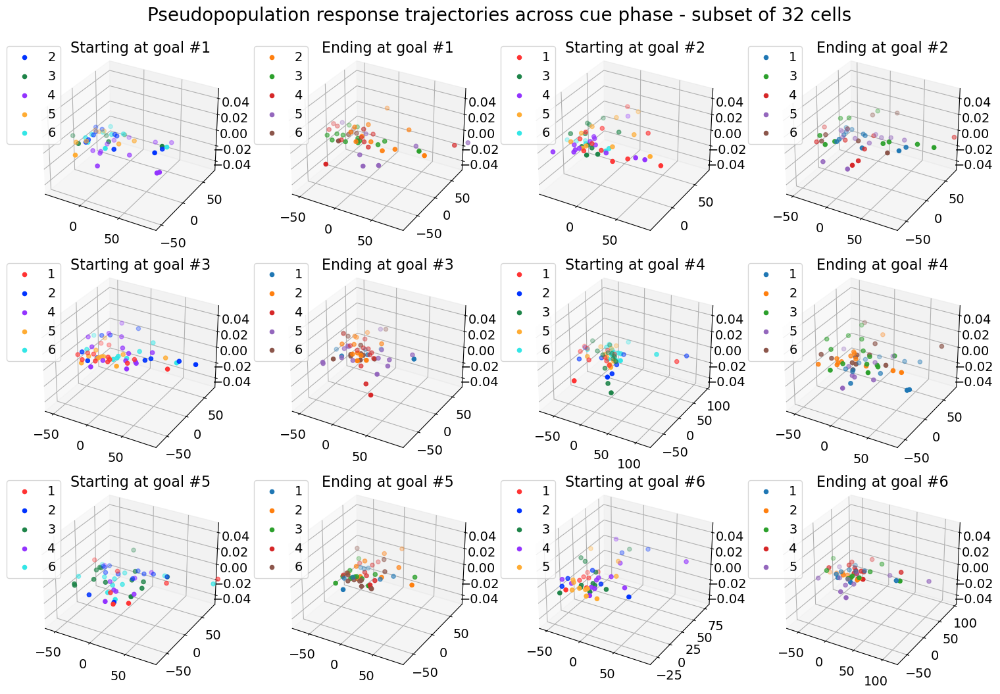

In [131]:
# Plots in ISOMAP space for cue responses between different trajectories
fig = plt.figure(figsize=(18, 12))
plt.rcParams['font.size'] = 14
plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1, wspace=0.2, hspace=0.1)
plt.suptitle(f'Pseudopopulation response trajectories across cue phase - {popl_name}', fontsize=20, y=0.95)
colours = ['#ff3333', '#0033ff', '#1e8449', '#9333ff', '#ffac33', '#33e6e6']

sc_plots = dict()
for i in range(num_goals):
    ax = fig.add_subplot(3, 4, 2*i+1, projection='3d')
    ax.set_title(f'Starting at goal #{i+1}', fontsize=16, x=0.56, y=1.02)
    ax_lims = [[0, 0] for _ in range(3)]
    for j, data in enumerate(combined_isospikerates_cue_per_traj[i]):
        if data.shape[0] > 0:
            sc = ax.scatter(data[:,0,0], data[:,0,1], data[:,0,2], color=colours[j], label=j+1)
            sc_plots[(i, j, 0)] = sc
            ax_lims[0][0] = min(ax_lims[0][0], np.percentile(data[:,:,0], 1, axis=None))
            ax_lims[0][1] = max(ax_lims[0][1], np.percentile(data[:,:,0], 99, axis=None))
            ax_lims[1][0] = min(ax_lims[1][0], np.percentile(data[:,:,1], 1, axis=None))
            ax_lims[1][1] = max(ax_lims[1][1], np.percentile(data[:,:,1], 99, axis=None))
            ax_lims[2][0] = min(ax_lims[2][0], np.percentile(data[:,:,2], 1, axis=None))
            ax_lims[2][1] = max(ax_lims[2][1], np.percentile(data[:,:,2], 99, axis=None))
    ax.legend(loc=(-0.12, 0.5))
    ax.set_xlim(ax_lims[0][0], ax_lims[0][1])
    ax.set_ylim(ax_lims[1][0], ax_lims[1][1])
    ax.set_zlim(ax_lims[2][0], ax_lims[2][1])

    ax = fig.add_subplot(3, 4, 2*i+2, projection='3d')
    ax.set_title(f'Ending at goal #{i+1}', fontsize=16, x=0.56, y=1.02)
    ax_lims = [[0, 0] for _ in range(3)]
    for j in range(num_goals):
        data = combined_isospikerates_cue_per_traj[j][i]
        if data.shape[0] > 0:
            sc = ax.scatter(data[:,0,0], data[:,0,1], data[:,0,2], color=f'C{j}', label=j+1)
            sc_plots[(i, j, 1)] = sc
            ax_lims[0][0] = min(ax_lims[0][0], np.percentile(data[:,:,0], 1, axis=None))
            ax_lims[0][1] = max(ax_lims[0][1], np.percentile(data[:,:,0], 99, axis=None))
            ax_lims[1][0] = min(ax_lims[1][0], np.percentile(data[:,:,1], 1, axis=None))
            ax_lims[1][1] = max(ax_lims[1][1], np.percentile(data[:,:,1], 99, axis=None))
            ax_lims[2][0] = min(ax_lims[2][0], np.percentile(data[:,:,2], 1, axis=None))
            ax_lims[2][1] = max(ax_lims[2][1], np.percentile(data[:,:,2], 99, axis=None))
    ax.legend(loc=(-0.12, 0.5))
    ax.set_xlim(ax_lims[0][0], ax_lims[0][1])
    ax.set_ylim(ax_lims[1][0], ax_lims[1][1])
    ax.set_zlim(ax_lims[2][0], ax_lims[2][1])

def update(frame):
    for i in range(num_goals):
        for j in range(num_goals):
            data = combined_isospikerates_cue_per_traj[i][j]
            if data.shape[0] > 0:
                sc_plots[(i, j, 0)]._offsets3d = (data[:,frame,0], data[:,frame,1], data[:,frame,2])
            data = combined_isospikerates_cue_per_traj[j][i]
            if data.shape[0] > 0:
                sc_plots[(i, j, 1)]._offsets3d = (data[:,frame,0], data[:,frame,1], data[:,frame,2])

ani = FuncAnimation(fig, update, frames=10, interval=500, blit=False, repeat=True)
HTML(ani.to_html5_video())

if to_save:
    if not os.path.exists(figsave_dir):
        os.makedirs(figsave_dir)
    ani.save(f'{figsave_dir}/isotraj_{save_name}.mp4', writer='ffmpeg')